## Lecture-03 Gradient Descent and Dymanic Programming

In this week, we need complete following tasks:
+ Re-review the course online programming; 
+ Choose 1 - 2 books which you interested and keep reading; 
+ Answer the review questions
+ Prepare the basic requirement of our 1st project. 

### Part I Review the online programming. 

In [3]:
from collections import defaultdict
import functools
from sklearn.datasets import load_boston
import matplotlib.pyplot as plt
import numpy as np

# Gradient Descent for Boston Hous Price 

In [5]:
data = load_boston()

In [10]:
features = data['data']
price = data['target']
feature_names = data['feature_names']

In [11]:
feature_names[5]

'RM'

In [23]:
room = features[:,5]

In [27]:
features.shape, room.shape, price.shape

((506, 13), (506,), (506,))

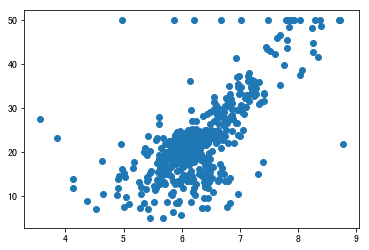

In [29]:
plt.scatter(room, price)

In [45]:
def get_loss(y, y_hat):
    return np.mean(np.abs(y-y_hat))

In [46]:
def get_estimate(k, b, x):
    return k*x+b

$$ \hat{y} = k*x+b $$
$$ loss = \frac{1}{n}\sum{|y - \hat{y}|} $$
$$ \frac{d(loss)}{d(k)} = \begin{cases}
     y - \hat{y} < 0 & x \\
     y - \hat{y} > 0 & -x
     \end{cases} $$
$$ \frac{d(loss)}{d(b)} = \begin{cases}
     y - \hat{y} < 0 & 1 \\
     y - \hat{y} > 0 & -1
     \end{cases} $$     

In [50]:
def get_gradients(k, b):
    k_gradient = 0
    b_gradient = 0
    n = room.size
    for i in range(n):
        if price[i] - estimate(k, b, room[i]) < 0:
            k_gradient += room[i]/n
            b_gradient += 1/n
        else:
            k_gradient -= room[i]/n
            b_gradient -= 1/n
    return (k_gradient, b_gradient)

In [55]:
iterations = 2000
step = 0.1
best_loss = float('inf')
k = np.random.random()*100 - 200
b = np.random.random()*100 - 200
for i in range(iterations):
    price_estimate = get_estimate(k, b, room)
    loss = get_loss(price, price_estimate)
    if best_loss > loss:
        best_loss = loss
        print(i, k, b, best_loss)
    k_b_gradients = get_gradients(k, b)
    k -= k_b_gradients[0]*step
    b -= k_b_gradients[1]*step
    

0 -130.33388901811534 -130.68649002383881 972.3201371084876
1 -129.70542557938018 -130.58649002383882 968.2704741702191
2 -129.076962140645 -130.48649002383883 964.2208112319508
3 -128.44849870190984 -130.38649002383883 960.1711482936824
4 -127.82003526317466 -130.28649002383884 956.121485355414
5 -127.19157182443948 -130.18649002383884 952.0718224171453
6 -126.5631083857043 -130.08649002383885 948.022159478877
7 -125.93464494696912 -129.98649002383885 943.9724965406085
8 -125.30618150823393 -129.88649002383886 939.9228336023401
9 -124.67771806949875 -129.78649002383887 935.8731706640715
10 -124.04925463076357 -129.68649002383887 931.8235077258032
11 -123.42079119202839 -129.58649002383888 927.7738447875346
12 -122.79232775329321 -129.48649002383888 923.7241818492662
13 -122.16386431455803 -129.3864900238389 919.6745189109977
14 -121.53540087582284 -129.2864900238389 915.6248559727292
15 -120.90693743708766 -129.1864900238389 911.5751930344609
16 -120.27847399835248 -129.0864900238389 

249 20.38997007279391 -106.63392085387966 7.274742937986708
250 20.388831535244503 -106.62720148629073 7.274278476301242
251 20.387692997695094 -106.6204821187018 7.273814014615776
252 20.386554460145685 -106.61376275111287 7.273349552930311
253 20.385415922596277 -106.60704338352394 7.272885091244845
254 20.384277385046868 -106.60032401593502 7.272420629559378
255 20.38313884749746 -106.59360464834609 7.2719561678739115
256 20.38200030994805 -106.58688528075716 7.271491706188447
257 20.380861772398642 -106.58016591316823 7.271027244502981
258 20.379723234849234 -106.5734465455793 7.270562782817513
259 20.378584697299825 -106.56672717799037 7.270098321132049
260 20.377446159750416 -106.56000781040144 7.269633859446584
261 20.376307622201008 -106.55328844281252 7.269169397761117
262 20.3751690846516 -106.54656907522359 7.268704936075652
263 20.37403054710219 -106.53984970763466 7.268240474390185
264 20.372892009552782 -106.53313034004573 7.26777712857328
265 20.37428983563974 -106.52601

453 20.186506041173107 -105.26119358115302 7.180339603131841
454 20.18562521113358 -105.2544742135641 7.179880345508304
455 20.184744381094053 -105.24775484597517 7.179421087884766
456 20.183863551054525 -105.24103547838624 7.178962327278469
457 20.18022857081737 -105.2347113677143 7.178504872020591
458 20.179347740777843 -105.22799200012537 7.178045614397054
459 20.178466910738315 -105.22127263253644 7.177586356773517
460 20.177586080698788 -105.21455326494751 7.17712709914998
461 20.17670525065926 -105.20783389735858 7.176667841526442
462 20.175824420619733 -105.20111452976965 7.1762085839029055
463 20.174943590580206 -105.19439516218073 7.1757493262793695
464 20.17406276054068 -105.1876757945918 7.175290068655831
465 20.17318193050115 -105.18095642700287 7.174830811032295
466 20.172301100461624 -105.17423705941394 7.174371553408759
467 20.171420270422097 -105.16751769182501 7.173912295785221
468 20.17053944038257 -105.16079832423608 7.173453038161684
469 20.169658610343042 -105.1540

657 19.9700617723981 -103.89637144676642 7.086727164636122
658 19.967025606390195 -103.89004733609448 7.0863076046292734
659 19.968763353425768 -103.88293271158855 7.085837861995086
660 19.965727187417862 -103.87660860091661 7.0853740523202235
661 19.967464934453435 -103.86949397641068 7.084948559354051
662 19.96442876844553 -103.86316986573874 7.084456432555867
663 19.961392602437623 -103.8568457550668 7.084043324168321
664 19.963130349473197 -103.84973113056087 7.083567129914831
665 19.96009418346529 -103.84340701988893 7.083109771859271
666 19.961831930500864 -103.836292395383 7.0826778272737965
667 19.958795764492958 -103.82996828471106 7.0821973461078045
668 19.958378175560153 -103.82324891712213 7.081748081539603
669 19.955342009552247 -103.81692480645019 7.081308242573546
670 19.95707975658782 -103.80981018194426 7.080858778898567
671 19.954043590579914 -103.80348607127232 7.080398064288841
672 19.95362600164711 -103.79676670368339 7.079944821475722
673 19.953208412714304 -103.7

874 19.745346159750007 -102.45961255348615 6.989289406234281
875 19.745170468050404 -102.45289318589722 6.988837598550598
876 19.7449947763508 -102.4461738183083 6.9883861129468094
877 19.742193788208507 -102.43984970763636 6.987955929520462
878 19.742018096508904 -102.43313034004743 6.987504121836776
879 19.7418424048093 -102.4264109724585 6.987052314153091
880 19.741666713109698 -102.41969160486957 6.986635061381894
881 19.73636256291207 -102.41376275111463 6.986206626185446
882 19.738570270421953 -102.4066481266087 6.985718627025891
883 19.73839457872235 -102.39992875901977 6.985289792231072
884 19.733090428524722 -102.39399990526483 6.984872813068151
885 19.735298136034604 -102.3868852807589 6.984384939898691
886 19.735122444335 -102.38016591316998 6.9839445230802495
887 19.729818294137374 -102.37423705941504 6.983538999950856
888 19.732026001647256 -102.3671224349091 6.98305125277149
889 19.731850309947653 -102.36040306732018 6.982604998232384
890 19.729171456192713 -102.354078956

1083 19.528862167655415 -101.0837232254234 6.896469749787035
1084 19.526225606390593 -101.07739911475146 6.896028427797689
1085 19.52604991469099 -101.07067974716253 6.895576620114004
1086 19.525874222991387 -101.0639603795736 6.895141146551943
1087 19.523237661726565 -101.05763626890166 6.894695239968244
1088 19.523061970026962 -101.05091690131273 6.894243432284558
1089 19.52288627832736 -101.0441975337238 6.893817869002383
1090 19.51793469729969 -101.03826867996887 6.893411843032754
1091 19.520422641963723 -101.03115405546293 6.892922704034095
1092 19.5177860806989 -101.024829944791 6.892481284483468
1093 19.517610388999298 -101.01811057720207 6.892029476799784
1094 19.517434697299695 -101.01139120961314 6.891602890571615
1095 19.512483116272026 -101.0054623558582 6.891213428577363
1096 19.51497106093606 -100.99834773135227 6.890707572870199
1097 19.51001947990839 -100.99241887759733 6.890346727986043
1098 19.512507424572423 -100.9853042530914 6.889816133805439
1099 19.51233173287282

1284 19.318058807971507 -99.77147026099644 6.808591282514345
1285 19.31830722694384 -99.76475089340751 6.8081424335086345
1286 19.316019282279807 -99.75842678273557 6.80771990983238
1287 19.31626770125214 -99.75170741514664 6.807270886288713
1288 19.313979756588108 -99.7453833044747 6.806848537150412
1289 19.31422817556044 -99.73866393688577 6.806399339068792
1290 19.311940230896408 -99.73233982621383 6.8059771644684455
1291 19.31218864986874 -99.7256204586249 6.805527791848868
1292 19.309900705204708 -99.71929634795296 6.8051057917864775
1293 19.31014912417704 -99.71257698036403 6.804656244628945
1294 19.307861179513008 -99.7062528696921 6.804234419104512
1295 19.30810959848534 -99.69953350210317 6.803784697409024
1296 19.305821653821308 -99.69320939143122 6.803363046422546
1297 19.30607007279364 -99.6864900238423 6.8029131501891005
1298 19.30378212812961 -99.68016591317036 6.802491673740579
1299 19.30403054710194 -99.67344654558143 6.80204160296918
1300 19.30174260243791 -99.66712243

1489 19.111983116271865 -98.4358971384669 6.719502669262305
1490 19.109948926548544 -98.42957302779496 6.719090189080227
1491 19.112954262516922 -98.42245840328903 6.718672543733864
1492 19.1109200727936 -98.41613429261709 6.7182312206976516
1493 19.10888588307028 -98.40981018194515 6.717789897661437
1494 19.106851693346957 -98.4034860712732 6.717348574625223
1495 19.104817503623636 -98.39716196060127 6.716938479849883
1496 19.107822839592014 -98.39004733609534 6.716518449096781
1497 19.105788649868693 -98.3837232254234 6.716077126060567
1498 19.10375446014537 -98.37739911475146 6.7156358030243535
1499 19.10172027042205 -98.37107500407951 6.715194479988139
1500 19.099686080698728 -98.36475089340757 6.714786770619539
1501 19.102691416667106 -98.35763626890164 6.714364354459699
1502 19.100657226943785 -98.3513121582297 6.713923031423485
1503 19.098623037220463 -98.34498804755776 6.7134817083872695
1504 19.09658884749714 -98.33866393688582 6.713040385351055
1505 19.09455465777382 -98.3323

1696 18.906933116271958 -97.10704338352586 6.632166913990654
1697 18.90812224670674 -97.10032401593693 6.631772383097363
1698 18.90415604117314 -97.094395162182 6.631350056550294
1699 18.905345171607923 -97.08767579459307 6.630914008218516
1700 18.903875013505157 -97.08135168392113 6.6304924508121355
1701 18.90240485540239 -97.07502757324919 6.6300708934057555
1702 18.900934697299625 -97.06870346257725 6.629662042794416
1703 18.902123827734407 -97.06198409498832 6.6292613556293505
1704 18.89815762220081 -97.05605524123338 6.628845185354057
1705 18.89934675263559 -97.04933587364445 6.62840131657703
1706 18.895380547101993 -97.04340701988951 6.628028327913697
1707 18.896569677536775 -97.03668765230059 6.6275626885938355
1708 18.897758807971556 -97.02996828471166 6.627190059404211
1709 18.89379260243796 -97.02403943095672 6.626745831153477
1710 18.89498173287274 -97.01732006336779 6.626330020351891
1711 18.891015527339142 -97.01139120961285 6.625928973713117
1712 18.892204657773924 -97.00

1903 18.69887560639053 -95.78807105151009 6.54601547533159
1904 18.697655250659306 -95.78174694083815 6.545603961156679
1905 18.698844381094087 -95.77502757324922 6.545222521312156
1906 18.69512797793203 -95.76909871949428 6.544807069693108
1907 18.701396159750214 -95.76158883807136 6.544520592739612
1908 18.69767975658816 -95.75565998431642 6.544030963146509
1909 18.693963353426103 -95.74973113056149 6.543541333553405
1910 18.690246950264047 -95.74380227680655 6.543213288531866
1911 18.69651513208223 -95.73629239538363 6.54283940498086
1912 18.692798728920174 -95.73036354162869 6.5423497753877555
1913 18.68908232575812 -95.72443468787375 6.54187152840616
1914 18.687861970026894 -95.71811057720181 6.541456691967142
1915 18.68664161429567 -95.71178646652987 6.541044309922458
1916 18.68796394631148 -95.70506709894094 6.540670306281849
1917 18.684247543149425 -95.699138245186 6.540235263926292
1918 18.6881062388016 -95.69202362068008 6.539902265693807
1919 18.684389835639543 -95.686094766

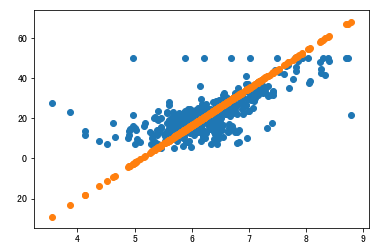

In [56]:
plt.scatter(room, price)
plt.scatter(room, 18.60618153524425*room+-95.1789801424193)

# DP and Decorator for Cutting Problems

In [60]:
original_price = [1, 5, 8, 9, 10, 17, 17, 20, 24, 30, 35]

In [61]:
price = defaultdict(int)

In [62]:
for i, val in enumerate(original_price):
    price[i+1] = val

In [63]:
price

defaultdict(int,
            {1: 1,
             2: 5,
             3: 8,
             4: 9,
             5: 10,
             6: 17,
             7: 17,
             8: 20,
             9: 24,
             10: 30,
             11: 35})

In [6]:
def r(n):
        total = max([price[n]] + [r(n-i) + r(i) for i in range(1, n)])
        if not n in len_price:
            print(n, total)
        len_price[n] = total
        return total

In [7]:
len_price = {}
%time r(15)

1 1
2 5
3 8
4 10
5 13
6 17
7 18
8 22
9 25
10 30
11 35
12 36
13 40
14 43
15 45
Wall time: 4.43 s


45

In [44]:
def r3(n):
    len_price3 = {}
    for i in range(0, n+1):
        len_price3[i] = max([price[i]] + [len_price3[i-j] + price[j] for j in range(1, min(i, len(original_price)))])
    return len_price3[n]

In [43]:
%timeit r3(20)

43.1 µs ± 587 ns per loop (mean ± std. dev. of 7 runs, 10000 loops each)


In [10]:
def r2(n):
        total = max([price[n]] + [r2(n-i) + price[i] for i in range(1, min(n, len(original_price)))])
        if not n in len_price2:
            print(n, total)
        len_price2[n] = total
        return total

In [54]:
len_price2 = {}
%timeit r2(20)

1 1
2 5
3 8
4 10
5 13
6 17
7 18
8 22
9 25
10 30
11 35
12 36
13 40
14 43
15 45
16 48
17 52
18 53
19 57
20 60
672 ms ± 6.16 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [12]:
call_times = defaultdict(int)

In [13]:
def log(func):
    """parm func is a function"""
    @functools.wraps(func)
    def wrap(*args, **kw):
        call_times[func.__name__] += 1
        print('call {} with {} times'.format(func.__name__, call_times[func.__name__]))
        return func(*args, **kw)
    return wrap

In [14]:
def incr(x, step = 1):
    x += step
    return x

In [15]:
incr1 = log(incr)

In [16]:
incr1(1, 3)

call incr with 1 times


4

In [17]:
incr1.__name__

'incr'

In [21]:
@log
def decr(x, step = 1):
    x -= step
    return x

In [22]:
decr(10)

call decr with 1 times


9

In [23]:
decr(10)

call decr with 2 times


9

In [98]:
cut_solutions = {}
def memo(func):
    @functools.wraps(func)
    def wrap(args):
        if not args in cut_solutions:
            cut_solutions[args] = func(args)
        return cut_solutions[args]
    return wrap
                

In [99]:
@memo
def r4(n):
    return max([([0, n], price[n])] + [([i, n-i], r4(n-i)[1] + price[i]) for i in range(1, min(n, len(original_price)))], key = lambda x: x[1])

In [102]:
%time r4(30)

Wall time: 0 ns


([3, 27], 90)

In [114]:
def parse_solutions(length, solutions):
    left = solutions[length][0][0]
    right = solutions[length][0][1]
    if left == 0:
        return [right]
    return parse_solutions(left, solutions) + parse_solutions(right, solutions)
        

In [129]:
def parse_solutions2(length, solutions):
    candidate = [length]
    res = []
    while candidate:
        next = candidate.pop(0)
        left = solutions[next][0][0]
        right = solutions[next][0][1]
        if left == 0:
            res = res + [right]
            continue
        candidate = candidate + [left] +[right]
    return res

In [115]:
parse_solutions(30, cut_solutions)

[3, 6, 10, 11]

In [130]:
parse_solutions2(30, cut_solutions)

[3, 6, 10, 11]

In [113]:
cut_solutions[30]

([3, 27], 90)

# Edit Distance

In [24]:
edit_solutions = {}
def memo2(func):
    @functools.wraps(func)
    def wrap(*args):
        if args:
            args_key = ','.join(repr(arg) for arg in args)
        if not args_key in edit_solutions:
            edit_solutions[args_key] = func(*args)
        return edit_solutions[args_key]
    return wrap

In [25]:
@memo2
def edit_distance(str1, str2):
    if not str1 and not str2:
        return [[''],0]
    elif not str1:
        return [['ADD {}'.format(str2)], len(str2)]
    elif not str2:
        return [['DEC {}'.format(str1)], len(str1)]
    elif str1[0] == str2[0]:
        return edit_distance(str1[1:], str2[1:])
    else:
        tmp = edit_distance(str1[1:], str2[1:])
        res =  [[['SUB {} -> {}'.format(str1[0], str2[0]), tmp[0][0]], 1+tmp[1]]] 
                                    
        tmp = edit_distance(str1[1:], str2)   
        res.append([['DEC {}'.format(str1[0]), tmp[0][0]], 1+tmp[1]]) 
                                             
        tmp = edit_distance(str1, str2[1:])   
        res.append([['ADD {}'.format(str2[0]), tmp[0][0]], 1+tmp[1]])                                   
        return min(res, key = lambda x: x[1])

In [26]:
tmps = [['add'],0]
tmp01 = [tmps]
tmp01.append([['sdf'],2])
tmps[0][0], tmps[1], min(tmp01, key = lambda x: x[1])

('add', 0, [['add'], 0])

In [27]:
edit_distance('ABEF', 'ABCDEF')

[['ADD C', 'ADD D'], 2]

In [28]:
edit_distance('ABCDE', 'ABCCEF')

[['SUB D -> C', 'ADD F'], 2]

In [29]:
edit_distance('ATCGGAA', 'ATCGGGA')

[['SUB A -> G', ''], 1]

In [30]:
edit_solutions

{"'','EF'": [['ADD EF'], 2],
 "'','DEF'": [['ADD DEF'], 3],
 "'','F'": [['ADD F'], 1],
 "'',''": [[''], 0],
 "'F','F'": [[''], 0],
 "'F','EF'": [['ADD E', ''], 1],
 "'F','DEF'": [['ADD D', 'ADD E'], 2],
 "'','CDEF'": [['ADD CDEF'], 4],
 "'F','CDEF'": [['ADD C', 'ADD D'], 3],
 "'EF','EF'": [[''], 0],
 "'EF','DEF'": [['ADD D', ''], 1],
 "'EF','CDEF'": [['ADD C', 'ADD D'], 2],
 "'BEF','BCDEF'": [['ADD C', 'ADD D'], 2],
 "'ABEF','ABCDEF'": [['ADD C', 'ADD D'], 2],
 "'E','EF'": [['ADD F'], 1],
 "'','CEF'": [['ADD CEF'], 3],
 "'E','CEF'": [['ADD C', 'ADD F'], 2],
 "'E',''": [['DEC E'], 1],
 "'E','F'": [['SUB E -> F', ''], 1],
 "'DE',''": [['DEC DE'], 2],
 "'DE','F'": [['SUB D -> F', 'DEC E'], 2],
 "'DE','EF'": [['SUB D -> E', 'SUB E -> F'], 2],
 "'DE','CEF'": [['SUB D -> C', 'ADD F'], 2],
 "'CDE','CCEF'": [['SUB D -> C', 'ADD F'], 2],
 "'BCDE','BCCEF'": [['SUB D -> C', 'ADD F'], 2],
 "'ABCDE','ABCCEF'": [['SUB D -> C', 'ADD F'], 2],
 "'A','A'": [[''], 0],
 "'','A'": [['ADD A'], 1],
 "'','GA'

### Part 2: change loss function from $loss = \frac{1}{n}\sum{(y_i - \hat(y_i))^2}$ to $loss = \frac{1}{n}\sum{|y_i - \hat{y_i}|}$, and using your mathmatical knowledge to get the right partial formual. Implemen the gradient descent code.

### Part 3: Finish the Solution Parse Part of Edit-Distance

### Part 4 Choose 1 - 2 books to keep reading: 

+ SICP, Structure and Interpretation of Computer Programming. 
+ Introduction to Algorithms 
+ Artificial Intelligence A Modern Approach (3rd Edition) 
+ Code Complete 2 
+ Programming Pearls 
+ Deep Learning
+ 黑客与画家
+ 数学之美
+ Fluent Python
+ Hands on Tensorflow
+ Conference: NIPS_ ICML_ ICLR_ ACL_ AAAI

> most books you may find in our github: https://github.com/Computing-Intelligence/References

## Part 5-1: review machine learning

1. Why do we use Derivative / Gredient to fit a target function?¶

Ans: it can make the fit close to target for every step

2. In the words 'Gredient Descent', what's the Gredient and what's the Descent?¶

Ans: Gredient means slewing rate, Descent means the lower direction


3. What's the advantages of the 3rd gradient descent method compared to the previous methods?

Ans: fast

4. Using the simple words to describe: What's the machine leanring.¶

Ans: Computer can improve performace on the specific task through study from experience 

### Part 5: Answer following questions: 

1. Why do we need dynamic programming? What's the difference of dynamic programming and previous talked `search` problme? 

Ans: Because the simple recursion takes too much time. Dp can avoid repeating the excution on the same sub problems of the target. 

2. Why do we still need dynamic programming? Why not we train a machine learning to fit a function which could get the `right` answer based on inputs?

Ans: Choose the simplest way for each specific case.

3. Can you catch up at least 3 problems which could solved by Dynamic Programming? 

Ans: shortest path, resource allocation, inventory management,sort

4. Can you catch up at least 3 problems wich could sloved by Edit Distance? 

Ans: automatic spelling correction, quantify the similarity of DNA sequences, recommendations the similar  

5. Please summarize the three main features of Dynamic Programming, and make a concise explain for each feature. 

1.Optimal Substructure: If an optimal solution contains optimal sub solutions then a problem exhibits optimal substructure;
2.Overlapping subproblems: When a recursive algorithm would visit the same subproblems repeatedly, then a problem has overlapping subproblems;
3.Memoization:Use of table to store solutions of subproblems 

6. What's the disadvantages of Dynamic Programming? (You may need search by yourself in Internet)

Ans: No general formation of Dynamic Program is available; every problem has to be solving in its own way; Dividing problem in sub problem and storing inter mediate results consumes memory.
    

## Part 6 Preparation of Project-01

1. Using python Flask or Bottle to finish your first simple web app:
> https://bottlepy.org/

2. Learn what's the SQL, and try some simple SQL operations:
> https://www.w3schools.com/sql/sql_intro.asp

3. Learn what's the HTML ( *ONLY* need to know the basic things)
> https://getbootstrap.com/; https://www.w3schools.com/html/

### (Optinal) Finish the k-person-salesman problem:

In [1]:
import random
import matplotlib.pylab as plt
from collections import defaultdict
import functools

In [68]:
latitudes = [random.randint(-100, 100) for _ in range(15)]
longitude = [random.randint(-100, 100) for _ in range(15)]

In [69]:
points = {}
for i,v in enumerate(latitudes):
    points[i] = (v, longitude[i])

In [70]:
points

{0: (-1, 70),
 1: (31, 8),
 2: (78, -61),
 3: (-72, 5),
 4: (94, -37),
 5: (67, -50),
 6: (-58, 77),
 7: (52, -38),
 8: (26, 92),
 9: (59, -81),
 10: (70, -4),
 11: (-60, -81),
 12: (85, 44),
 13: (-51, -41),
 14: (-64, 89)}

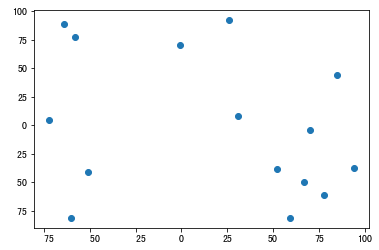

In [71]:
plt.scatter(latitudes, longitude)

In [72]:
def get_distance(x, y):
    return sum([(x[i]-y[i])**2 for i in range(2)])**0.5

In [73]:
def remove_list_node(ll, node):
    return [val for val in ll if not node == val]

In [74]:
tsp_solutions = {}
def memo3(func):
    @functools.wraps(func)
    def wrap(*args):
        if args:
            args_key = ','.join(repr(arg) for arg in args)
        if not args_key in tsp_solutions:
            tsp_solutions[args_key] = func(*args)
        else:
            print('call func with {}'.format(args_key))
        return tsp_solutions[args_key]
    return wrap

In [75]:
path = []
@memo3
def tsp2(start, locations):
    global path
    path.append(start)
    if not locations:
        return (get_distance(points[start], points[path[0]]), [path[0]])
    return min([(get_distance(points[start], points[val]) + tsp2(val, remove_list_node(locations, val))[0], [val]+tsp2(val, remove_list_node(locations, val))[1]) for val in locations], key= lambda x: x[0])

In [76]:
locations = points.keys()
start = 0
locations_r = remove_list_node(locations, start)
tsp2(start, locations_r)

call func with 14,[]
call func with 13,[14]
call func with 13,[]
call func with 14,[13]
call func with 12,[13, 14]
call func with 14,[]
call func with 14,[]
call func with 12,[14]
call func with 12,[]
call func with 14,[12]
call func with 13,[12, 14]
call func with 13,[]
call func with 13,[]
call func with 12,[13]
call func with 12,[]
call func with 12,[]
call func with 13,[12]
call func with 14,[12, 13]
call func with 11,[12, 13, 14]
call func with 13,[14]
call func with 13,[14]
call func with 14,[13]
call func with 14,[13]
call func with 11,[13, 14]
call func with 14,[]
call func with 14,[]
call func with 11,[14]
call func with 11,[]
call func with 14,[11]
call func with 13,[11, 14]
call func with 13,[]
call func with 13,[]
call func with 11,[13]
call func with 11,[]
call func with 11,[]
call func with 13,[11]
call func with 14,[11, 13]
call func with 12,[11, 13, 14]
call func with 12,[14]
call func with 12,[14]
call func with 14,[12]
call func with 14,[12]
call func with 11,[12, 14]

call func with 13,[8, 10, 11, 12]
call func with 14,[8, 10, 11, 12, 13]
call func with 9,[8, 10, 11, 12, 13, 14]
call func with 9,[11, 12, 13, 14]
call func with 9,[11, 12, 13, 14]
call func with 11,[9, 12, 13, 14]
call func with 11,[9, 12, 13, 14]
call func with 12,[9, 11, 13, 14]
call func with 12,[9, 11, 13, 14]
call func with 13,[9, 11, 12, 14]
call func with 13,[9, 11, 12, 14]
call func with 14,[9, 11, 12, 13]
call func with 14,[9, 11, 12, 13]
call func with 8,[9, 11, 12, 13, 14]
call func with 8,[11, 12, 13, 14]
call func with 8,[11, 12, 13, 14]
call func with 11,[8, 12, 13, 14]
call func with 11,[8, 12, 13, 14]
call func with 12,[8, 11, 13, 14]
call func with 12,[8, 11, 13, 14]
call func with 13,[8, 11, 12, 14]
call func with 13,[8, 11, 12, 14]
call func with 14,[8, 11, 12, 13]
call func with 14,[8, 11, 12, 13]
call func with 9,[8, 11, 12, 13, 14]
call func with 9,[12, 13, 14]
call func with 9,[12, 13, 14]
call func with 12,[9, 13, 14]
call func with 12,[9, 13, 14]
call func wit

call func with 7,[14]
call func with 7,[14]
call func with 14,[7]
call func with 14,[7]
call func with 12,[7, 14]
call func with 12,[]
call func with 12,[]
call func with 7,[12]
call func with 7,[]
call func with 7,[]
call func with 12,[7]
call func with 14,[7, 12]
call func with 13,[7, 12, 14]
call func with 12,[13]
call func with 12,[13]
call func with 13,[12]
call func with 13,[12]
call func with 7,[12, 13]
call func with 7,[13]
call func with 7,[13]
call func with 13,[7]
call func with 13,[7]
call func with 12,[7, 13]
call func with 7,[12]
call func with 7,[12]
call func with 12,[7]
call func with 12,[7]
call func with 13,[7, 12]
call func with 14,[7, 12, 13]
call func with 11,[7, 12, 13, 14]
call func with 11,[13, 14]
call func with 11,[13, 14]
call func with 13,[11, 14]
call func with 13,[11, 14]
call func with 14,[11, 13]
call func with 14,[11, 13]
call func with 7,[11, 13, 14]
call func with 7,[13, 14]
call func with 7,[13, 14]
call func with 13,[7, 14]
call func with 13,[7, 14

call func with 14,[7, 10, 12]
call func with 9,[7, 10, 12, 14]
call func with 7,[9, 12, 14]
call func with 7,[9, 12, 14]
call func with 9,[7, 12, 14]
call func with 9,[7, 12, 14]
call func with 12,[7, 9, 14]
call func with 12,[7, 9, 14]
call func with 14,[7, 9, 12]
call func with 14,[7, 9, 12]
call func with 10,[7, 9, 12, 14]
call func with 7,[9, 10, 14]
call func with 7,[9, 10, 14]
call func with 9,[7, 10, 14]
call func with 9,[7, 10, 14]
call func with 10,[7, 9, 14]
call func with 10,[7, 9, 14]
call func with 14,[7, 9, 10]
call func with 14,[7, 9, 10]
call func with 12,[7, 9, 10, 14]
call func with 9,[10, 12]
call func with 9,[10, 12]
call func with 10,[9, 12]
call func with 10,[9, 12]
call func with 12,[9, 10]
call func with 12,[9, 10]
call func with 7,[9, 10, 12]
call func with 7,[10, 12]
call func with 7,[10, 12]
call func with 10,[7, 12]
call func with 10,[7, 12]
call func with 12,[7, 10]
call func with 12,[7, 10]
call func with 9,[7, 10, 12]
call func with 7,[9, 12]
call func wi

call func with 7,[8, 10]
call func with 7,[8, 10]
call func with 8,[7, 10]
call func with 8,[7, 10]
call func with 10,[7, 8]
call func with 10,[7, 8]
call func with 12,[7, 8, 10]
call func with 14,[7, 8, 10, 12]
call func with 13,[7, 8, 10, 12, 14]
call func with 8,[10, 12, 13]
call func with 8,[10, 12, 13]
call func with 10,[8, 12, 13]
call func with 10,[8, 12, 13]
call func with 12,[8, 10, 13]
call func with 12,[8, 10, 13]
call func with 13,[8, 10, 12]
call func with 13,[8, 10, 12]
call func with 7,[8, 10, 12, 13]
call func with 7,[10, 12, 13]
call func with 7,[10, 12, 13]
call func with 10,[7, 12, 13]
call func with 10,[7, 12, 13]
call func with 12,[7, 10, 13]
call func with 12,[7, 10, 13]
call func with 13,[7, 10, 12]
call func with 13,[7, 10, 12]
call func with 8,[7, 10, 12, 13]
call func with 7,[8, 12, 13]
call func with 7,[8, 12, 13]
call func with 8,[7, 12, 13]
call func with 8,[7, 12, 13]
call func with 12,[7, 8, 13]
call func with 12,[7, 8, 13]
call func with 13,[7, 8, 12]
ca

call func with 13,[8, 9, 10, 12, 14]
call func with 14,[8, 9, 10, 12, 13]
call func with 14,[8, 9, 10, 12, 13]
call func with 7,[8, 9, 10, 12, 13, 14]
call func with 7,[9, 10, 12, 13, 14]
call func with 7,[9, 10, 12, 13, 14]
call func with 9,[7, 10, 12, 13, 14]
call func with 9,[7, 10, 12, 13, 14]
call func with 10,[7, 9, 12, 13, 14]
call func with 10,[7, 9, 12, 13, 14]
call func with 12,[7, 9, 10, 13, 14]
call func with 12,[7, 9, 10, 13, 14]
call func with 13,[7, 9, 10, 12, 14]
call func with 13,[7, 9, 10, 12, 14]
call func with 14,[7, 9, 10, 12, 13]
call func with 14,[7, 9, 10, 12, 13]
call func with 8,[7, 9, 10, 12, 13, 14]
call func with 7,[8, 10, 12, 13, 14]
call func with 7,[8, 10, 12, 13, 14]
call func with 8,[7, 10, 12, 13, 14]
call func with 8,[7, 10, 12, 13, 14]
call func with 10,[7, 8, 12, 13, 14]
call func with 10,[7, 8, 12, 13, 14]
call func with 12,[7, 8, 10, 13, 14]
call func with 12,[7, 8, 10, 13, 14]
call func with 13,[7, 8, 10, 12, 14]
call func with 13,[7, 8, 10, 12,

call func with 14,[6, 11, 13]
call func with 12,[6, 11, 13, 14]
call func with 11,[12, 14]
call func with 11,[12, 14]
call func with 12,[11, 14]
call func with 12,[11, 14]
call func with 14,[11, 12]
call func with 14,[11, 12]
call func with 6,[11, 12, 14]
call func with 6,[12, 14]
call func with 6,[12, 14]
call func with 12,[6, 14]
call func with 12,[6, 14]
call func with 14,[6, 12]
call func with 14,[6, 12]
call func with 11,[6, 12, 14]
call func with 6,[11, 14]
call func with 6,[11, 14]
call func with 11,[6, 14]
call func with 11,[6, 14]
call func with 14,[6, 11]
call func with 14,[6, 11]
call func with 12,[6, 11, 14]
call func with 11,[12]
call func with 11,[12]
call func with 12,[11]
call func with 12,[11]
call func with 6,[11, 12]
call func with 6,[12]
call func with 6,[12]
call func with 12,[6]
call func with 12,[6]
call func with 11,[6, 12]
call func with 6,[11]
call func with 6,[11]
call func with 11,[6]
call func with 11,[6]
call func with 12,[6, 11]
call func with 14,[6, 11, 

call func with 6,[9, 10, 13]
call func with 6,[9, 10, 13]
call func with 9,[6, 10, 13]
call func with 9,[6, 10, 13]
call func with 10,[6, 9, 13]
call func with 10,[6, 9, 13]
call func with 13,[6, 9, 10]
call func with 13,[6, 9, 10]
call func with 12,[6, 9, 10, 13]
call func with 6,[9, 10, 12]
call func with 6,[9, 10, 12]
call func with 9,[6, 10, 12]
call func with 9,[6, 10, 12]
call func with 10,[6, 9, 12]
call func with 10,[6, 9, 12]
call func with 12,[6, 9, 10]
call func with 12,[6, 9, 10]
call func with 13,[6, 9, 10, 12]
call func with 14,[6, 9, 10, 12, 13]
call func with 11,[6, 9, 10, 12, 13, 14]
call func with 9,[10, 11, 13, 14]
call func with 9,[10, 11, 13, 14]
call func with 10,[9, 11, 13, 14]
call func with 10,[9, 11, 13, 14]
call func with 11,[9, 10, 13, 14]
call func with 11,[9, 10, 13, 14]
call func with 13,[9, 10, 11, 14]
call func with 13,[9, 10, 11, 14]
call func with 14,[9, 10, 11, 13]
call func with 14,[9, 10, 11, 13]
call func with 6,[9, 10, 11, 13, 14]
call func with 

call func with 8,[6, 10, 11, 13, 14]
call func with 6,[8, 11, 13, 14]
call func with 6,[8, 11, 13, 14]
call func with 8,[6, 11, 13, 14]
call func with 8,[6, 11, 13, 14]
call func with 11,[6, 8, 13, 14]
call func with 11,[6, 8, 13, 14]
call func with 13,[6, 8, 11, 14]
call func with 13,[6, 8, 11, 14]
call func with 14,[6, 8, 11, 13]
call func with 14,[6, 8, 11, 13]
call func with 10,[6, 8, 11, 13, 14]
call func with 6,[8, 10, 13, 14]
call func with 6,[8, 10, 13, 14]
call func with 8,[6, 10, 13, 14]
call func with 8,[6, 10, 13, 14]
call func with 10,[6, 8, 13, 14]
call func with 10,[6, 8, 13, 14]
call func with 13,[6, 8, 10, 14]
call func with 13,[6, 8, 10, 14]
call func with 14,[6, 8, 10, 13]
call func with 14,[6, 8, 10, 13]
call func with 11,[6, 8, 10, 13, 14]
call func with 8,[10, 11, 14]
call func with 8,[10, 11, 14]
call func with 10,[8, 11, 14]
call func with 10,[8, 11, 14]
call func with 11,[8, 10, 14]
call func with 11,[8, 10, 14]
call func with 14,[8, 10, 11]
call func with 14,[

call func with 6,[8, 9, 13, 14]
call func with 8,[6, 9, 13, 14]
call func with 8,[6, 9, 13, 14]
call func with 9,[6, 8, 13, 14]
call func with 9,[6, 8, 13, 14]
call func with 13,[6, 8, 9, 14]
call func with 13,[6, 8, 9, 14]
call func with 14,[6, 8, 9, 13]
call func with 14,[6, 8, 9, 13]
call func with 10,[6, 8, 9, 13, 14]
call func with 8,[9, 10, 14]
call func with 8,[9, 10, 14]
call func with 9,[8, 10, 14]
call func with 9,[8, 10, 14]
call func with 10,[8, 9, 14]
call func with 10,[8, 9, 14]
call func with 14,[8, 9, 10]
call func with 14,[8, 9, 10]
call func with 6,[8, 9, 10, 14]
call func with 6,[9, 10, 14]
call func with 6,[9, 10, 14]
call func with 9,[6, 10, 14]
call func with 9,[6, 10, 14]
call func with 10,[6, 9, 14]
call func with 10,[6, 9, 14]
call func with 14,[6, 9, 10]
call func with 14,[6, 9, 10]
call func with 8,[6, 9, 10, 14]
call func with 6,[8, 10, 14]
call func with 6,[8, 10, 14]
call func with 8,[6, 10, 14]
call func with 8,[6, 10, 14]
call func with 10,[6, 8, 14]
cal

call func with 7,[6, 13, 14]
call func with 7,[6, 13, 14]
call func with 13,[6, 7, 14]
call func with 13,[6, 7, 14]
call func with 14,[6, 7, 13]
call func with 14,[6, 7, 13]
call func with 11,[6, 7, 13, 14]
call func with 7,[11, 14]
call func with 7,[11, 14]
call func with 11,[7, 14]
call func with 11,[7, 14]
call func with 14,[7, 11]
call func with 14,[7, 11]
call func with 6,[7, 11, 14]
call func with 6,[11, 14]
call func with 6,[11, 14]
call func with 11,[6, 14]
call func with 11,[6, 14]
call func with 14,[6, 11]
call func with 14,[6, 11]
call func with 7,[6, 11, 14]
call func with 6,[7, 14]
call func with 6,[7, 14]
call func with 7,[6, 14]
call func with 7,[6, 14]
call func with 14,[6, 7]
call func with 14,[6, 7]
call func with 11,[6, 7, 14]
call func with 7,[11]
call func with 7,[11]
call func with 11,[7]
call func with 11,[7]
call func with 6,[7, 11]
call func with 6,[11]
call func with 6,[11]
call func with 11,[6]
call func with 11,[6]
call func with 7,[6, 11]
call func with 6,[

call func with 6,[9, 12, 13]
call func with 9,[6, 12, 13]
call func with 9,[6, 12, 13]
call func with 12,[6, 9, 13]
call func with 12,[6, 9, 13]
call func with 13,[6, 9, 12]
call func with 13,[6, 9, 12]
call func with 7,[6, 9, 12, 13]
call func with 6,[7, 12, 13]
call func with 6,[7, 12, 13]
call func with 7,[6, 12, 13]
call func with 7,[6, 12, 13]
call func with 12,[6, 7, 13]
call func with 12,[6, 7, 13]
call func with 13,[6, 7, 12]
call func with 13,[6, 7, 12]
call func with 9,[6, 7, 12, 13]
call func with 6,[7, 9, 13]
call func with 6,[7, 9, 13]
call func with 7,[6, 9, 13]
call func with 7,[6, 9, 13]
call func with 9,[6, 7, 13]
call func with 9,[6, 7, 13]
call func with 13,[6, 7, 9]
call func with 13,[6, 7, 9]
call func with 12,[6, 7, 9, 13]
call func with 6,[7, 9, 12]
call func with 6,[7, 9, 12]
call func with 7,[6, 9, 12]
call func with 7,[6, 9, 12]
call func with 9,[6, 7, 12]
call func with 9,[6, 7, 12]
call func with 12,[6, 7, 9]
call func with 12,[6, 7, 9]
call func with 13,[6,

call func with 12,[6, 9, 10, 11, 14]
call func with 14,[6, 9, 10, 11, 12]
call func with 14,[6, 9, 10, 11, 12]
call func with 7,[6, 9, 10, 11, 12, 14]
call func with 6,[7, 10, 11, 12, 14]
call func with 6,[7, 10, 11, 12, 14]
call func with 7,[6, 10, 11, 12, 14]
call func with 7,[6, 10, 11, 12, 14]
call func with 10,[6, 7, 11, 12, 14]
call func with 10,[6, 7, 11, 12, 14]
call func with 11,[6, 7, 10, 12, 14]
call func with 11,[6, 7, 10, 12, 14]
call func with 12,[6, 7, 10, 11, 14]
call func with 12,[6, 7, 10, 11, 14]
call func with 14,[6, 7, 10, 11, 12]
call func with 14,[6, 7, 10, 11, 12]
call func with 9,[6, 7, 10, 11, 12, 14]
call func with 6,[7, 9, 11, 12, 14]
call func with 6,[7, 9, 11, 12, 14]
call func with 7,[6, 9, 11, 12, 14]
call func with 7,[6, 9, 11, 12, 14]
call func with 9,[6, 7, 11, 12, 14]
call func with 9,[6, 7, 11, 12, 14]
call func with 11,[6, 7, 9, 12, 14]
call func with 11,[6, 7, 9, 12, 14]
call func with 12,[6, 7, 9, 11, 14]
call func with 12,[6, 7, 9, 11, 14]
call 

call func with 14,[6, 7, 8]
call func with 10,[6, 7, 8, 14]
call func with 7,[8, 10]
call func with 7,[8, 10]
call func with 8,[7, 10]
call func with 8,[7, 10]
call func with 10,[7, 8]
call func with 10,[7, 8]
call func with 6,[7, 8, 10]
call func with 6,[8, 10]
call func with 6,[8, 10]
call func with 8,[6, 10]
call func with 8,[6, 10]
call func with 10,[6, 8]
call func with 10,[6, 8]
call func with 7,[6, 8, 10]
call func with 6,[7, 10]
call func with 6,[7, 10]
call func with 7,[6, 10]
call func with 7,[6, 10]
call func with 10,[6, 7]
call func with 10,[6, 7]
call func with 8,[6, 7, 10]
call func with 6,[7, 8]
call func with 6,[7, 8]
call func with 7,[6, 8]
call func with 7,[6, 8]
call func with 8,[6, 7]
call func with 8,[6, 7]
call func with 10,[6, 7, 8]
call func with 14,[6, 7, 8, 10]
call func with 13,[6, 7, 8, 10, 14]
call func with 7,[8, 10, 13]
call func with 7,[8, 10, 13]
call func with 8,[7, 10, 13]
call func with 8,[7, 10, 13]
call func with 10,[7, 8, 13]
call func with 10,[7,

call func with 14,[7, 8, 9, 12]
call func with 14,[7, 8, 9, 12]
call func with 6,[7, 8, 9, 12, 14]
call func with 6,[8, 9, 12, 14]
call func with 6,[8, 9, 12, 14]
call func with 8,[6, 9, 12, 14]
call func with 8,[6, 9, 12, 14]
call func with 9,[6, 8, 12, 14]
call func with 9,[6, 8, 12, 14]
call func with 12,[6, 8, 9, 14]
call func with 12,[6, 8, 9, 14]
call func with 14,[6, 8, 9, 12]
call func with 14,[6, 8, 9, 12]
call func with 7,[6, 8, 9, 12, 14]
call func with 6,[7, 9, 12, 14]
call func with 6,[7, 9, 12, 14]
call func with 7,[6, 9, 12, 14]
call func with 7,[6, 9, 12, 14]
call func with 9,[6, 7, 12, 14]
call func with 9,[6, 7, 12, 14]
call func with 12,[6, 7, 9, 14]
call func with 12,[6, 7, 9, 14]
call func with 14,[6, 7, 9, 12]
call func with 14,[6, 7, 9, 12]
call func with 8,[6, 7, 9, 12, 14]
call func with 6,[7, 8, 12, 14]
call func with 6,[7, 8, 12, 14]
call func with 7,[6, 8, 12, 14]
call func with 7,[6, 8, 12, 14]
call func with 8,[6, 7, 12, 14]
call func with 8,[6, 7, 12, 14]

call func with 6,[7, 8, 9, 12, 14]
call func with 7,[6, 8, 9, 12, 14]
call func with 7,[6, 8, 9, 12, 14]
call func with 8,[6, 7, 9, 12, 14]
call func with 8,[6, 7, 9, 12, 14]
call func with 9,[6, 7, 8, 12, 14]
call func with 9,[6, 7, 8, 12, 14]
call func with 12,[6, 7, 8, 9, 14]
call func with 12,[6, 7, 8, 9, 14]
call func with 14,[6, 7, 8, 9, 12]
call func with 14,[6, 7, 8, 9, 12]
call func with 10,[6, 7, 8, 9, 12, 14]
call func with 6,[7, 8, 9, 10, 14]
call func with 6,[7, 8, 9, 10, 14]
call func with 7,[6, 8, 9, 10, 14]
call func with 7,[6, 8, 9, 10, 14]
call func with 8,[6, 7, 9, 10, 14]
call func with 8,[6, 7, 9, 10, 14]
call func with 9,[6, 7, 8, 10, 14]
call func with 9,[6, 7, 8, 10, 14]
call func with 10,[6, 7, 8, 9, 14]
call func with 10,[6, 7, 8, 9, 14]
call func with 14,[6, 7, 8, 9, 10]
call func with 14,[6, 7, 8, 9, 10]
call func with 12,[6, 7, 8, 9, 10, 14]
call func with 7,[8, 9, 10, 12]
call func with 7,[8, 9, 10, 12]
call func with 8,[7, 9, 10, 12]
call func with 8,[7, 

call func with 13,[5]
call func with 13,[5]
call func with 11,[5, 13]
call func with 5,[11]
call func with 5,[11]
call func with 11,[5]
call func with 11,[5]
call func with 13,[5, 11]
call func with 14,[5, 11, 13]
call func with 12,[5, 11, 13, 14]
call func with 11,[12, 14]
call func with 11,[12, 14]
call func with 12,[11, 14]
call func with 12,[11, 14]
call func with 14,[11, 12]
call func with 14,[11, 12]
call func with 5,[11, 12, 14]
call func with 5,[12, 14]
call func with 5,[12, 14]
call func with 12,[5, 14]
call func with 12,[5, 14]
call func with 14,[5, 12]
call func with 14,[5, 12]
call func with 11,[5, 12, 14]
call func with 5,[11, 14]
call func with 5,[11, 14]
call func with 11,[5, 14]
call func with 11,[5, 14]
call func with 14,[5, 11]
call func with 14,[5, 11]
call func with 12,[5, 11, 14]
call func with 11,[12]
call func with 11,[12]
call func with 12,[11]
call func with 12,[11]
call func with 5,[11, 12]
call func with 5,[12]
call func with 5,[12]
call func with 12,[5]
call

call func with 5,[9, 12, 13]
call func with 9,[5, 12, 13]
call func with 9,[5, 12, 13]
call func with 12,[5, 9, 13]
call func with 12,[5, 9, 13]
call func with 13,[5, 9, 12]
call func with 13,[5, 9, 12]
call func with 10,[5, 9, 12, 13]
call func with 5,[9, 10, 13]
call func with 5,[9, 10, 13]
call func with 9,[5, 10, 13]
call func with 9,[5, 10, 13]
call func with 10,[5, 9, 13]
call func with 10,[5, 9, 13]
call func with 13,[5, 9, 10]
call func with 13,[5, 9, 10]
call func with 12,[5, 9, 10, 13]
call func with 5,[9, 10, 12]
call func with 5,[9, 10, 12]
call func with 9,[5, 10, 12]
call func with 9,[5, 10, 12]
call func with 10,[5, 9, 12]
call func with 10,[5, 9, 12]
call func with 12,[5, 9, 10]
call func with 12,[5, 9, 10]
call func with 13,[5, 9, 10, 12]
call func with 14,[5, 9, 10, 12, 13]
call func with 11,[5, 9, 10, 12, 13, 14]
call func with 9,[10, 11, 13, 14]
call func with 9,[10, 11, 13, 14]
call func with 10,[9, 11, 13, 14]
call func with 10,[9, 11, 13, 14]
call func with 11,[9

call func with 10,[5, 11, 13, 14]
call func with 10,[5, 11, 13, 14]
call func with 11,[5, 10, 13, 14]
call func with 11,[5, 10, 13, 14]
call func with 13,[5, 10, 11, 14]
call func with 13,[5, 10, 11, 14]
call func with 14,[5, 10, 11, 13]
call func with 14,[5, 10, 11, 13]
call func with 8,[5, 10, 11, 13, 14]
call func with 5,[8, 11, 13, 14]
call func with 5,[8, 11, 13, 14]
call func with 8,[5, 11, 13, 14]
call func with 8,[5, 11, 13, 14]
call func with 11,[5, 8, 13, 14]
call func with 11,[5, 8, 13, 14]
call func with 13,[5, 8, 11, 14]
call func with 13,[5, 8, 11, 14]
call func with 14,[5, 8, 11, 13]
call func with 14,[5, 8, 11, 13]
call func with 10,[5, 8, 11, 13, 14]
call func with 5,[8, 10, 13, 14]
call func with 5,[8, 10, 13, 14]
call func with 8,[5, 10, 13, 14]
call func with 8,[5, 10, 13, 14]
call func with 10,[5, 8, 13, 14]
call func with 10,[5, 8, 13, 14]
call func with 13,[5, 8, 10, 14]
call func with 13,[5, 8, 10, 14]
call func with 14,[5, 8, 10, 13]
call func with 14,[5, 8, 10

call func with 10,[5, 8, 13, 14]
call func with 10,[5, 8, 13, 14]
call func with 13,[5, 8, 10, 14]
call func with 13,[5, 8, 10, 14]
call func with 14,[5, 8, 10, 13]
call func with 14,[5, 8, 10, 13]
call func with 9,[5, 8, 10, 13, 14]
call func with 5,[8, 9, 13, 14]
call func with 5,[8, 9, 13, 14]
call func with 8,[5, 9, 13, 14]
call func with 8,[5, 9, 13, 14]
call func with 9,[5, 8, 13, 14]
call func with 9,[5, 8, 13, 14]
call func with 13,[5, 8, 9, 14]
call func with 13,[5, 8, 9, 14]
call func with 14,[5, 8, 9, 13]
call func with 14,[5, 8, 9, 13]
call func with 10,[5, 8, 9, 13, 14]
call func with 8,[9, 10, 14]
call func with 8,[9, 10, 14]
call func with 9,[8, 10, 14]
call func with 9,[8, 10, 14]
call func with 10,[8, 9, 14]
call func with 10,[8, 9, 14]
call func with 14,[8, 9, 10]
call func with 14,[8, 9, 10]
call func with 5,[8, 9, 10, 14]
call func with 5,[9, 10, 14]
call func with 5,[9, 10, 14]
call func with 9,[5, 10, 14]
call func with 9,[5, 10, 14]
call func with 10,[5, 9, 14]
c

call func with 11,[5, 13, 14]
call func with 13,[5, 11, 14]
call func with 13,[5, 11, 14]
call func with 14,[5, 11, 13]
call func with 14,[5, 11, 13]
call func with 7,[5, 11, 13, 14]
call func with 5,[7, 13, 14]
call func with 5,[7, 13, 14]
call func with 7,[5, 13, 14]
call func with 7,[5, 13, 14]
call func with 13,[5, 7, 14]
call func with 13,[5, 7, 14]
call func with 14,[5, 7, 13]
call func with 14,[5, 7, 13]
call func with 11,[5, 7, 13, 14]
call func with 7,[11, 14]
call func with 7,[11, 14]
call func with 11,[7, 14]
call func with 11,[7, 14]
call func with 14,[7, 11]
call func with 14,[7, 11]
call func with 5,[7, 11, 14]
call func with 5,[11, 14]
call func with 5,[11, 14]
call func with 11,[5, 14]
call func with 11,[5, 14]
call func with 14,[5, 11]
call func with 14,[5, 11]
call func with 7,[5, 11, 14]
call func with 5,[7, 14]
call func with 5,[7, 14]
call func with 7,[5, 14]
call func with 7,[5, 14]
call func with 14,[5, 7]
call func with 14,[5, 7]
call func with 11,[5, 7, 14]
cal

call func with 9,[7, 12, 13]
call func with 9,[7, 12, 13]
call func with 12,[7, 9, 13]
call func with 12,[7, 9, 13]
call func with 13,[7, 9, 12]
call func with 13,[7, 9, 12]
call func with 5,[7, 9, 12, 13]
call func with 5,[9, 12, 13]
call func with 5,[9, 12, 13]
call func with 9,[5, 12, 13]
call func with 9,[5, 12, 13]
call func with 12,[5, 9, 13]
call func with 12,[5, 9, 13]
call func with 13,[5, 9, 12]
call func with 13,[5, 9, 12]
call func with 7,[5, 9, 12, 13]
call func with 5,[7, 12, 13]
call func with 5,[7, 12, 13]
call func with 7,[5, 12, 13]
call func with 7,[5, 12, 13]
call func with 12,[5, 7, 13]
call func with 12,[5, 7, 13]
call func with 13,[5, 7, 12]
call func with 13,[5, 7, 12]
call func with 9,[5, 7, 12, 13]
call func with 5,[7, 9, 13]
call func with 5,[7, 9, 13]
call func with 7,[5, 9, 13]
call func with 7,[5, 9, 13]
call func with 9,[5, 7, 13]
call func with 9,[5, 7, 13]
call func with 13,[5, 7, 9]
call func with 13,[5, 7, 9]
call func with 12,[5, 7, 9, 13]
call func 

call func with 12,[5, 7, 8]
call func with 14,[5, 7, 8, 12]
call func with 13,[5, 7, 8, 12, 14]
call func with 7,[8, 12, 13]
call func with 7,[8, 12, 13]
call func with 8,[7, 12, 13]
call func with 8,[7, 12, 13]
call func with 12,[7, 8, 13]
call func with 12,[7, 8, 13]
call func with 13,[7, 8, 12]
call func with 13,[7, 8, 12]
call func with 5,[7, 8, 12, 13]
call func with 5,[8, 12, 13]
call func with 5,[8, 12, 13]
call func with 8,[5, 12, 13]
call func with 8,[5, 12, 13]
call func with 12,[5, 8, 13]
call func with 12,[5, 8, 13]
call func with 13,[5, 8, 12]
call func with 13,[5, 8, 12]
call func with 7,[5, 8, 12, 13]
call func with 5,[7, 12, 13]
call func with 5,[7, 12, 13]
call func with 7,[5, 12, 13]
call func with 7,[5, 12, 13]
call func with 12,[5, 7, 13]
call func with 12,[5, 7, 13]
call func with 13,[5, 7, 12]
call func with 13,[5, 7, 12]
call func with 8,[5, 7, 12, 13]
call func with 5,[7, 8, 13]
call func with 5,[7, 8, 13]
call func with 7,[5, 8, 13]
call func with 7,[5, 8, 13]


call func with 8,[5, 7, 10, 14]
call func with 5,[7, 8, 14]
call func with 5,[7, 8, 14]
call func with 7,[5, 8, 14]
call func with 7,[5, 8, 14]
call func with 8,[5, 7, 14]
call func with 8,[5, 7, 14]
call func with 14,[5, 7, 8]
call func with 14,[5, 7, 8]
call func with 10,[5, 7, 8, 14]
call func with 7,[8, 10]
call func with 7,[8, 10]
call func with 8,[7, 10]
call func with 8,[7, 10]
call func with 10,[7, 8]
call func with 10,[7, 8]
call func with 5,[7, 8, 10]
call func with 5,[8, 10]
call func with 5,[8, 10]
call func with 8,[5, 10]
call func with 8,[5, 10]
call func with 10,[5, 8]
call func with 10,[5, 8]
call func with 7,[5, 8, 10]
call func with 5,[7, 10]
call func with 5,[7, 10]
call func with 7,[5, 10]
call func with 7,[5, 10]
call func with 10,[5, 7]
call func with 10,[5, 7]
call func with 8,[5, 7, 10]
call func with 5,[7, 8]
call func with 5,[7, 8]
call func with 7,[5, 8]
call func with 7,[5, 8]
call func with 8,[5, 7]
call func with 8,[5, 7]
call func with 10,[5, 7, 8]
call f

call func with 7,[8, 9, 12, 14]
call func with 7,[8, 9, 12, 14]
call func with 8,[7, 9, 12, 14]
call func with 8,[7, 9, 12, 14]
call func with 9,[7, 8, 12, 14]
call func with 9,[7, 8, 12, 14]
call func with 12,[7, 8, 9, 14]
call func with 12,[7, 8, 9, 14]
call func with 14,[7, 8, 9, 12]
call func with 14,[7, 8, 9, 12]
call func with 5,[7, 8, 9, 12, 14]
call func with 5,[8, 9, 12, 14]
call func with 5,[8, 9, 12, 14]
call func with 8,[5, 9, 12, 14]
call func with 8,[5, 9, 12, 14]
call func with 9,[5, 8, 12, 14]
call func with 9,[5, 8, 12, 14]
call func with 12,[5, 8, 9, 14]
call func with 12,[5, 8, 9, 14]
call func with 14,[5, 8, 9, 12]
call func with 14,[5, 8, 9, 12]
call func with 7,[5, 8, 9, 12, 14]
call func with 5,[7, 9, 12, 14]
call func with 5,[7, 9, 12, 14]
call func with 7,[5, 9, 12, 14]
call func with 7,[5, 9, 12, 14]
call func with 9,[5, 7, 12, 14]
call func with 9,[5, 7, 12, 14]
call func with 12,[5, 7, 9, 14]
call func with 12,[5, 7, 9, 14]
call func with 14,[5, 7, 9, 12]
ca

call func with 10,[5, 7, 8, 12, 14]
call func with 10,[5, 7, 8, 12, 14]
call func with 12,[5, 7, 8, 10, 14]
call func with 12,[5, 7, 8, 10, 14]
call func with 14,[5, 7, 8, 10, 12]
call func with 14,[5, 7, 8, 10, 12]
call func with 9,[5, 7, 8, 10, 12, 14]
call func with 5,[7, 8, 9, 12, 14]
call func with 5,[7, 8, 9, 12, 14]
call func with 7,[5, 8, 9, 12, 14]
call func with 7,[5, 8, 9, 12, 14]
call func with 8,[5, 7, 9, 12, 14]
call func with 8,[5, 7, 9, 12, 14]
call func with 9,[5, 7, 8, 12, 14]
call func with 9,[5, 7, 8, 12, 14]
call func with 12,[5, 7, 8, 9, 14]
call func with 12,[5, 7, 8, 9, 14]
call func with 14,[5, 7, 8, 9, 12]
call func with 14,[5, 7, 8, 9, 12]
call func with 10,[5, 7, 8, 9, 12, 14]
call func with 5,[7, 8, 9, 10, 14]
call func with 5,[7, 8, 9, 10, 14]
call func with 7,[5, 8, 9, 10, 14]
call func with 7,[5, 8, 9, 10, 14]
call func with 8,[5, 7, 9, 10, 14]
call func with 8,[5, 7, 9, 10, 14]
call func with 9,[5, 7, 8, 10, 14]
call func with 9,[5, 7, 8, 10, 14]
call f

call func with 5,[]
call func with 5,[]
call func with 6,[5]
call func with 14,[5, 6]
call func with 13,[5, 6, 14]
call func with 6,[13]
call func with 6,[13]
call func with 13,[6]
call func with 13,[6]
call func with 5,[6, 13]
call func with 5,[13]
call func with 5,[13]
call func with 13,[5]
call func with 13,[5]
call func with 6,[5, 13]
call func with 5,[6]
call func with 5,[6]
call func with 6,[5]
call func with 6,[5]
call func with 13,[5, 6]
call func with 14,[5, 6, 13]
call func with 12,[5, 6, 13, 14]
call func with 6,[12, 14]
call func with 6,[12, 14]
call func with 12,[6, 14]
call func with 12,[6, 14]
call func with 14,[6, 12]
call func with 14,[6, 12]
call func with 5,[6, 12, 14]
call func with 5,[12, 14]
call func with 5,[12, 14]
call func with 12,[5, 14]
call func with 12,[5, 14]
call func with 14,[5, 12]
call func with 14,[5, 12]
call func with 6,[5, 12, 14]
call func with 5,[6, 14]
call func with 5,[6, 14]
call func with 6,[5, 14]
call func with 6,[5, 14]
call func with 14,

call func with 6,[5]
call func with 9,[5, 6]
call func with 14,[5, 6, 9]
call func with 13,[5, 6, 9, 14]
call func with 6,[9, 13]
call func with 6,[9, 13]
call func with 9,[6, 13]
call func with 9,[6, 13]
call func with 13,[6, 9]
call func with 13,[6, 9]
call func with 5,[6, 9, 13]
call func with 5,[9, 13]
call func with 5,[9, 13]
call func with 9,[5, 13]
call func with 9,[5, 13]
call func with 13,[5, 9]
call func with 13,[5, 9]
call func with 6,[5, 9, 13]
call func with 5,[6, 13]
call func with 5,[6, 13]
call func with 6,[5, 13]
call func with 6,[5, 13]
call func with 13,[5, 6]
call func with 13,[5, 6]
call func with 9,[5, 6, 13]
call func with 5,[6, 9]
call func with 5,[6, 9]
call func with 6,[5, 9]
call func with 6,[5, 9]
call func with 9,[5, 6]
call func with 9,[5, 6]
call func with 13,[5, 6, 9]
call func with 14,[5, 6, 9, 13]
call func with 12,[5, 6, 9, 13, 14]
call func with 6,[9, 12, 14]
call func with 6,[9, 12, 14]
call func with 9,[6, 12, 14]
call func with 9,[6, 12, 14]
call 

call func with 5,[6, 9, 11]
call func with 5,[6, 9, 11]
call func with 6,[5, 9, 11]
call func with 6,[5, 9, 11]
call func with 9,[5, 6, 11]
call func with 9,[5, 6, 11]
call func with 11,[5, 6, 9]
call func with 11,[5, 6, 9]
call func with 10,[5, 6, 9, 11]
call func with 5,[6, 9, 10]
call func with 5,[6, 9, 10]
call func with 6,[5, 9, 10]
call func with 6,[5, 9, 10]
call func with 9,[5, 6, 10]
call func with 9,[5, 6, 10]
call func with 10,[5, 6, 9]
call func with 10,[5, 6, 9]
call func with 11,[5, 6, 9, 10]
call func with 14,[5, 6, 9, 10, 11]
call func with 13,[5, 6, 9, 10, 11, 14]
call func with 6,[9, 10, 11, 13]
call func with 6,[9, 10, 11, 13]
call func with 9,[6, 10, 11, 13]
call func with 9,[6, 10, 11, 13]
call func with 10,[6, 9, 11, 13]
call func with 10,[6, 9, 11, 13]
call func with 11,[6, 9, 10, 13]
call func with 11,[6, 9, 10, 13]
call func with 13,[6, 9, 10, 11]
call func with 13,[6, 9, 10, 11]
call func with 5,[6, 9, 10, 11, 13]
call func with 5,[9, 10, 11, 13]
call func wit

call func with 12,[5, 8, 10, 13, 14]
call func with 13,[5, 8, 10, 12, 14]
call func with 13,[5, 8, 10, 12, 14]
call func with 14,[5, 8, 10, 12, 13]
call func with 14,[5, 8, 10, 12, 13]
call func with 6,[5, 8, 10, 12, 13, 14]
call func with 5,[6, 10, 12, 13, 14]
call func with 5,[6, 10, 12, 13, 14]
call func with 6,[5, 10, 12, 13, 14]
call func with 6,[5, 10, 12, 13, 14]
call func with 10,[5, 6, 12, 13, 14]
call func with 10,[5, 6, 12, 13, 14]
call func with 12,[5, 6, 10, 13, 14]
call func with 12,[5, 6, 10, 13, 14]
call func with 13,[5, 6, 10, 12, 14]
call func with 13,[5, 6, 10, 12, 14]
call func with 14,[5, 6, 10, 12, 13]
call func with 14,[5, 6, 10, 12, 13]
call func with 8,[5, 6, 10, 12, 13, 14]
call func with 5,[6, 8, 12, 13, 14]
call func with 5,[6, 8, 12, 13, 14]
call func with 6,[5, 8, 12, 13, 14]
call func with 6,[5, 8, 12, 13, 14]
call func with 8,[5, 6, 12, 13, 14]
call func with 8,[5, 6, 12, 13, 14]
call func with 12,[5, 6, 8, 13, 14]
call func with 12,[5, 6, 8, 13, 14]
cal

call func with 8,[5, 9, 14]
call func with 8,[5, 9, 14]
call func with 9,[5, 8, 14]
call func with 9,[5, 8, 14]
call func with 14,[5, 8, 9]
call func with 14,[5, 8, 9]
call func with 6,[5, 8, 9, 14]
call func with 5,[6, 9, 14]
call func with 5,[6, 9, 14]
call func with 6,[5, 9, 14]
call func with 6,[5, 9, 14]
call func with 9,[5, 6, 14]
call func with 9,[5, 6, 14]
call func with 14,[5, 6, 9]
call func with 14,[5, 6, 9]
call func with 8,[5, 6, 9, 14]
call func with 5,[6, 8, 14]
call func with 5,[6, 8, 14]
call func with 6,[5, 8, 14]
call func with 6,[5, 8, 14]
call func with 8,[5, 6, 14]
call func with 8,[5, 6, 14]
call func with 14,[5, 6, 8]
call func with 14,[5, 6, 8]
call func with 9,[5, 6, 8, 14]
call func with 6,[8, 9]
call func with 6,[8, 9]
call func with 8,[6, 9]
call func with 8,[6, 9]
call func with 9,[6, 8]
call func with 9,[6, 8]
call func with 5,[6, 8, 9]
call func with 5,[8, 9]
call func with 5,[8, 9]
call func with 8,[5, 9]
call func with 8,[5, 9]
call func with 9,[5, 8]


call func with 5,[8, 9, 10, 13]
call func with 5,[8, 9, 10, 13]
call func with 8,[5, 9, 10, 13]
call func with 8,[5, 9, 10, 13]
call func with 9,[5, 8, 10, 13]
call func with 9,[5, 8, 10, 13]
call func with 10,[5, 8, 9, 13]
call func with 10,[5, 8, 9, 13]
call func with 13,[5, 8, 9, 10]
call func with 13,[5, 8, 9, 10]
call func with 6,[5, 8, 9, 10, 13]
call func with 5,[6, 9, 10, 13]
call func with 5,[6, 9, 10, 13]
call func with 6,[5, 9, 10, 13]
call func with 6,[5, 9, 10, 13]
call func with 9,[5, 6, 10, 13]
call func with 9,[5, 6, 10, 13]
call func with 10,[5, 6, 9, 13]
call func with 10,[5, 6, 9, 13]
call func with 13,[5, 6, 9, 10]
call func with 13,[5, 6, 9, 10]
call func with 8,[5, 6, 9, 10, 13]
call func with 5,[6, 8, 10, 13]
call func with 5,[6, 8, 10, 13]
call func with 6,[5, 8, 10, 13]
call func with 6,[5, 8, 10, 13]
call func with 8,[5, 6, 10, 13]
call func with 8,[5, 6, 10, 13]
call func with 10,[5, 6, 8, 13]
call func with 10,[5, 6, 8, 13]
call func with 13,[5, 6, 8, 10]
ca

call func with 10,[6, 7, 11, 12, 13, 14]
call func with 10,[6, 7, 11, 12, 13, 14]
call func with 11,[6, 7, 10, 12, 13, 14]
call func with 11,[6, 7, 10, 12, 13, 14]
call func with 12,[6, 7, 10, 11, 13, 14]
call func with 12,[6, 7, 10, 11, 13, 14]
call func with 13,[6, 7, 10, 11, 12, 14]
call func with 13,[6, 7, 10, 11, 12, 14]
call func with 14,[6, 7, 10, 11, 12, 13]
call func with 14,[6, 7, 10, 11, 12, 13]
call func with 5,[6, 7, 10, 11, 12, 13, 14]
call func with 5,[7, 10, 11, 12, 13, 14]
call func with 5,[7, 10, 11, 12, 13, 14]
call func with 7,[5, 10, 11, 12, 13, 14]
call func with 7,[5, 10, 11, 12, 13, 14]
call func with 10,[5, 7, 11, 12, 13, 14]
call func with 10,[5, 7, 11, 12, 13, 14]
call func with 11,[5, 7, 10, 12, 13, 14]
call func with 11,[5, 7, 10, 12, 13, 14]
call func with 12,[5, 7, 10, 11, 13, 14]
call func with 12,[5, 7, 10, 11, 13, 14]
call func with 13,[5, 7, 10, 11, 12, 14]
call func with 13,[5, 7, 10, 11, 12, 14]
call func with 14,[5, 7, 10, 11, 12, 13]
call func wit

call func with 12,[5, 6, 7, 13]
call func with 13,[5, 6, 7, 12]
call func with 13,[5, 6, 7, 12]
call func with 10,[5, 6, 7, 12, 13]
call func with 5,[6, 7, 10, 13]
call func with 5,[6, 7, 10, 13]
call func with 6,[5, 7, 10, 13]
call func with 6,[5, 7, 10, 13]
call func with 7,[5, 6, 10, 13]
call func with 7,[5, 6, 10, 13]
call func with 10,[5, 6, 7, 13]
call func with 10,[5, 6, 7, 13]
call func with 13,[5, 6, 7, 10]
call func with 13,[5, 6, 7, 10]
call func with 12,[5, 6, 7, 10, 13]
call func with 5,[6, 7, 10, 12]
call func with 5,[6, 7, 10, 12]
call func with 6,[5, 7, 10, 12]
call func with 6,[5, 7, 10, 12]
call func with 7,[5, 6, 10, 12]
call func with 7,[5, 6, 10, 12]
call func with 10,[5, 6, 7, 12]
call func with 10,[5, 6, 7, 12]
call func with 12,[5, 6, 7, 10]
call func with 12,[5, 6, 7, 10]
call func with 13,[5, 6, 7, 10, 12]
call func with 14,[5, 6, 7, 10, 12, 13]
call func with 11,[5, 6, 7, 10, 12, 13, 14]
call func with 6,[7, 10, 11, 13, 14]
call func with 6,[7, 10, 11, 13, 14

call func with 9,[5, 6, 7, 13, 14]
call func with 13,[5, 6, 7, 9, 14]
call func with 13,[5, 6, 7, 9, 14]
call func with 14,[5, 6, 7, 9, 13]
call func with 14,[5, 6, 7, 9, 13]
call func with 11,[5, 6, 7, 9, 13, 14]
call func with 6,[7, 9, 11, 14]
call func with 6,[7, 9, 11, 14]
call func with 7,[6, 9, 11, 14]
call func with 7,[6, 9, 11, 14]
call func with 9,[6, 7, 11, 14]
call func with 9,[6, 7, 11, 14]
call func with 11,[6, 7, 9, 14]
call func with 11,[6, 7, 9, 14]
call func with 14,[6, 7, 9, 11]
call func with 14,[6, 7, 9, 11]
call func with 5,[6, 7, 9, 11, 14]
call func with 5,[7, 9, 11, 14]
call func with 5,[7, 9, 11, 14]
call func with 7,[5, 9, 11, 14]
call func with 7,[5, 9, 11, 14]
call func with 9,[5, 7, 11, 14]
call func with 9,[5, 7, 11, 14]
call func with 11,[5, 7, 9, 14]
call func with 11,[5, 7, 9, 14]
call func with 14,[5, 7, 9, 11]
call func with 14,[5, 7, 9, 11]
call func with 6,[5, 7, 9, 11, 14]
call func with 5,[6, 9, 11, 14]
call func with 5,[6, 9, 11, 14]
call func wi

call func with 9,[5, 6, 10, 11, 13, 14]
call func with 10,[5, 6, 9, 11, 13, 14]
call func with 10,[5, 6, 9, 11, 13, 14]
call func with 11,[5, 6, 9, 10, 13, 14]
call func with 11,[5, 6, 9, 10, 13, 14]
call func with 13,[5, 6, 9, 10, 11, 14]
call func with 13,[5, 6, 9, 10, 11, 14]
call func with 14,[5, 6, 9, 10, 11, 13]
call func with 14,[5, 6, 9, 10, 11, 13]
call func with 7,[5, 6, 9, 10, 11, 13, 14]
call func with 5,[6, 7, 10, 11, 13, 14]
call func with 5,[6, 7, 10, 11, 13, 14]
call func with 6,[5, 7, 10, 11, 13, 14]
call func with 6,[5, 7, 10, 11, 13, 14]
call func with 7,[5, 6, 10, 11, 13, 14]
call func with 7,[5, 6, 10, 11, 13, 14]
call func with 10,[5, 6, 7, 11, 13, 14]
call func with 10,[5, 6, 7, 11, 13, 14]
call func with 11,[5, 6, 7, 10, 13, 14]
call func with 11,[5, 6, 7, 10, 13, 14]
call func with 13,[5, 6, 7, 10, 11, 14]
call func with 13,[5, 6, 7, 10, 11, 14]
call func with 14,[5, 6, 7, 10, 11, 13]
call func with 14,[5, 6, 7, 10, 11, 13]
call func with 9,[5, 6, 7, 10, 11, 13

call func with 7,[5, 6, 8, 14]
call func with 8,[5, 6, 7, 14]
call func with 8,[5, 6, 7, 14]
call func with 14,[5, 6, 7, 8]
call func with 14,[5, 6, 7, 8]
call func with 12,[5, 6, 7, 8, 14]
call func with 6,[7, 8, 12]
call func with 6,[7, 8, 12]
call func with 7,[6, 8, 12]
call func with 7,[6, 8, 12]
call func with 8,[6, 7, 12]
call func with 8,[6, 7, 12]
call func with 12,[6, 7, 8]
call func with 12,[6, 7, 8]
call func with 5,[6, 7, 8, 12]
call func with 5,[7, 8, 12]
call func with 5,[7, 8, 12]
call func with 7,[5, 8, 12]
call func with 7,[5, 8, 12]
call func with 8,[5, 7, 12]
call func with 8,[5, 7, 12]
call func with 12,[5, 7, 8]
call func with 12,[5, 7, 8]
call func with 6,[5, 7, 8, 12]
call func with 5,[6, 8, 12]
call func with 5,[6, 8, 12]
call func with 6,[5, 8, 12]
call func with 6,[5, 8, 12]
call func with 8,[5, 6, 12]
call func with 8,[5, 6, 12]
call func with 12,[5, 6, 8]
call func with 12,[5, 6, 8]
call func with 7,[5, 6, 8, 12]
call func with 5,[6, 7, 12]
call func with 5,

call func with 8,[5, 7, 10, 12]
call func with 10,[5, 7, 8, 12]
call func with 10,[5, 7, 8, 12]
call func with 12,[5, 7, 8, 10]
call func with 12,[5, 7, 8, 10]
call func with 6,[5, 7, 8, 10, 12]
call func with 5,[6, 8, 10, 12]
call func with 5,[6, 8, 10, 12]
call func with 6,[5, 8, 10, 12]
call func with 6,[5, 8, 10, 12]
call func with 8,[5, 6, 10, 12]
call func with 8,[5, 6, 10, 12]
call func with 10,[5, 6, 8, 12]
call func with 10,[5, 6, 8, 12]
call func with 12,[5, 6, 8, 10]
call func with 12,[5, 6, 8, 10]
call func with 7,[5, 6, 8, 10, 12]
call func with 5,[6, 7, 10, 12]
call func with 5,[6, 7, 10, 12]
call func with 6,[5, 7, 10, 12]
call func with 6,[5, 7, 10, 12]
call func with 7,[5, 6, 10, 12]
call func with 7,[5, 6, 10, 12]
call func with 10,[5, 6, 7, 12]
call func with 10,[5, 6, 7, 12]
call func with 12,[5, 6, 7, 10]
call func with 12,[5, 6, 7, 10]
call func with 8,[5, 6, 7, 10, 12]
call func with 5,[6, 7, 8, 12]
call func with 5,[6, 7, 8, 12]
call func with 6,[5, 7, 8, 12]
ca

call func with 9,[5, 6, 7, 13, 14]
call func with 13,[5, 6, 7, 9, 14]
call func with 13,[5, 6, 7, 9, 14]
call func with 14,[5, 6, 7, 9, 13]
call func with 14,[5, 6, 7, 9, 13]
call func with 8,[5, 6, 7, 9, 13, 14]
call func with 5,[6, 7, 8, 13, 14]
call func with 5,[6, 7, 8, 13, 14]
call func with 6,[5, 7, 8, 13, 14]
call func with 6,[5, 7, 8, 13, 14]
call func with 7,[5, 6, 8, 13, 14]
call func with 7,[5, 6, 8, 13, 14]
call func with 8,[5, 6, 7, 13, 14]
call func with 8,[5, 6, 7, 13, 14]
call func with 13,[5, 6, 7, 8, 14]
call func with 13,[5, 6, 7, 8, 14]
call func with 14,[5, 6, 7, 8, 13]
call func with 14,[5, 6, 7, 8, 13]
call func with 9,[5, 6, 7, 8, 13, 14]
call func with 6,[7, 8, 9, 14]
call func with 6,[7, 8, 9, 14]
call func with 7,[6, 8, 9, 14]
call func with 7,[6, 8, 9, 14]
call func with 8,[6, 7, 9, 14]
call func with 8,[6, 7, 9, 14]
call func with 9,[6, 7, 8, 14]
call func with 9,[6, 7, 8, 14]
call func with 14,[6, 7, 8, 9]
call func with 14,[6, 7, 8, 9]
call func with 5,[6

call func with 7,[5, 6, 8, 9, 11, 12, 13]
call func with 5,[6, 7, 9, 11, 12, 13]
call func with 5,[6, 7, 9, 11, 12, 13]
call func with 6,[5, 7, 9, 11, 12, 13]
call func with 6,[5, 7, 9, 11, 12, 13]
call func with 7,[5, 6, 9, 11, 12, 13]
call func with 7,[5, 6, 9, 11, 12, 13]
call func with 9,[5, 6, 7, 11, 12, 13]
call func with 9,[5, 6, 7, 11, 12, 13]
call func with 11,[5, 6, 7, 9, 12, 13]
call func with 11,[5, 6, 7, 9, 12, 13]
call func with 12,[5, 6, 7, 9, 11, 13]
call func with 12,[5, 6, 7, 9, 11, 13]
call func with 13,[5, 6, 7, 9, 11, 12]
call func with 13,[5, 6, 7, 9, 11, 12]
call func with 8,[5, 6, 7, 9, 11, 12, 13]
call func with 5,[6, 7, 8, 11, 12, 13]
call func with 5,[6, 7, 8, 11, 12, 13]
call func with 6,[5, 7, 8, 11, 12, 13]
call func with 6,[5, 7, 8, 11, 12, 13]
call func with 7,[5, 6, 8, 11, 12, 13]
call func with 7,[5, 6, 8, 11, 12, 13]
call func with 8,[5, 6, 7, 11, 12, 13]
call func with 8,[5, 6, 7, 11, 12, 13]
call func with 11,[5, 6, 7, 8, 12, 13]
call func with 11,[

call func with 9,[5, 6, 7, 10, 11, 14]
call func with 10,[5, 6, 7, 9, 11, 14]
call func with 10,[5, 6, 7, 9, 11, 14]
call func with 11,[5, 6, 7, 9, 10, 14]
call func with 11,[5, 6, 7, 9, 10, 14]
call func with 14,[5, 6, 7, 9, 10, 11]
call func with 14,[5, 6, 7, 9, 10, 11]
call func with 8,[5, 6, 7, 9, 10, 11, 14]
call func with 5,[6, 7, 8, 10, 11, 14]
call func with 5,[6, 7, 8, 10, 11, 14]
call func with 6,[5, 7, 8, 10, 11, 14]
call func with 6,[5, 7, 8, 10, 11, 14]
call func with 7,[5, 6, 8, 10, 11, 14]
call func with 7,[5, 6, 8, 10, 11, 14]
call func with 8,[5, 6, 7, 10, 11, 14]
call func with 8,[5, 6, 7, 10, 11, 14]
call func with 10,[5, 6, 7, 8, 11, 14]
call func with 10,[5, 6, 7, 8, 11, 14]
call func with 11,[5, 6, 7, 8, 10, 14]
call func with 11,[5, 6, 7, 8, 10, 14]
call func with 14,[5, 6, 7, 8, 10, 11]
call func with 14,[5, 6, 7, 8, 10, 11]
call func with 9,[5, 6, 7, 8, 10, 11, 14]
call func with 5,[6, 7, 8, 9, 11, 14]
call func with 5,[6, 7, 8, 9, 11, 14]
call func with 6,[5, 

call func with 4,[13]
call func with 13,[4]
call func with 13,[4]
call func with 10,[4, 13]
call func with 4,[10]
call func with 4,[10]
call func with 10,[4]
call func with 10,[4]
call func with 13,[4, 10]
call func with 14,[4, 10, 13]
call func with 12,[4, 10, 13, 14]
call func with 10,[12, 14]
call func with 10,[12, 14]
call func with 12,[10, 14]
call func with 12,[10, 14]
call func with 14,[10, 12]
call func with 14,[10, 12]
call func with 4,[10, 12, 14]
call func with 4,[12, 14]
call func with 4,[12, 14]
call func with 12,[4, 14]
call func with 12,[4, 14]
call func with 14,[4, 12]
call func with 14,[4, 12]
call func with 10,[4, 12, 14]
call func with 4,[10, 14]
call func with 4,[10, 14]
call func with 10,[4, 14]
call func with 10,[4, 14]
call func with 14,[4, 10]
call func with 14,[4, 10]
call func with 12,[4, 10, 14]
call func with 10,[12]
call func with 10,[12]
call func with 12,[10]
call func with 12,[10]
call func with 4,[10, 12]
call func with 4,[12]
call func with 4,[12]
call

call func with 11,[4]
call func with 9,[4, 11]
call func with 4,[9]
call func with 4,[9]
call func with 9,[4]
call func with 9,[4]
call func with 11,[4, 9]
call func with 14,[4, 9, 11]
call func with 13,[4, 9, 11, 14]
call func with 9,[11, 13]
call func with 9,[11, 13]
call func with 11,[9, 13]
call func with 11,[9, 13]
call func with 13,[9, 11]
call func with 13,[9, 11]
call func with 4,[9, 11, 13]
call func with 4,[11, 13]
call func with 4,[11, 13]
call func with 11,[4, 13]
call func with 11,[4, 13]
call func with 13,[4, 11]
call func with 13,[4, 11]
call func with 9,[4, 11, 13]
call func with 4,[9, 13]
call func with 4,[9, 13]
call func with 9,[4, 13]
call func with 9,[4, 13]
call func with 13,[4, 9]
call func with 13,[4, 9]
call func with 11,[4, 9, 13]
call func with 4,[9, 11]
call func with 4,[9, 11]
call func with 9,[4, 11]
call func with 9,[4, 11]
call func with 11,[4, 9]
call func with 11,[4, 9]
call func with 13,[4, 9, 11]
call func with 14,[4, 9, 11, 13]
call func with 12,[4,

call func with 10,[4, 9]
call func with 11,[4, 9, 10]
call func with 14,[4, 9, 10, 11]
call func with 13,[4, 9, 10, 11, 14]
call func with 9,[10, 11, 13]
call func with 9,[10, 11, 13]
call func with 10,[9, 11, 13]
call func with 10,[9, 11, 13]
call func with 11,[9, 10, 13]
call func with 11,[9, 10, 13]
call func with 13,[9, 10, 11]
call func with 13,[9, 10, 11]
call func with 4,[9, 10, 11, 13]
call func with 4,[10, 11, 13]
call func with 4,[10, 11, 13]
call func with 10,[4, 11, 13]
call func with 10,[4, 11, 13]
call func with 11,[4, 10, 13]
call func with 11,[4, 10, 13]
call func with 13,[4, 10, 11]
call func with 13,[4, 10, 11]
call func with 9,[4, 10, 11, 13]
call func with 4,[9, 11, 13]
call func with 4,[9, 11, 13]
call func with 9,[4, 11, 13]
call func with 9,[4, 11, 13]
call func with 11,[4, 9, 13]
call func with 11,[4, 9, 13]
call func with 13,[4, 9, 11]
call func with 13,[4, 9, 11]
call func with 10,[4, 9, 11, 13]
call func with 4,[9, 10, 13]
call func with 4,[9, 10, 13]
call fu

call func with 4,[8, 10, 11]
call func with 8,[4, 10, 11]
call func with 8,[4, 10, 11]
call func with 10,[4, 8, 11]
call func with 10,[4, 8, 11]
call func with 11,[4, 8, 10]
call func with 11,[4, 8, 10]
call func with 13,[4, 8, 10, 11]
call func with 14,[4, 8, 10, 11, 13]
call func with 12,[4, 8, 10, 11, 13, 14]
call func with 8,[10, 11, 12, 14]
call func with 8,[10, 11, 12, 14]
call func with 10,[8, 11, 12, 14]
call func with 10,[8, 11, 12, 14]
call func with 11,[8, 10, 12, 14]
call func with 11,[8, 10, 12, 14]
call func with 12,[8, 10, 11, 14]
call func with 12,[8, 10, 11, 14]
call func with 14,[8, 10, 11, 12]
call func with 14,[8, 10, 11, 12]
call func with 4,[8, 10, 11, 12, 14]
call func with 4,[10, 11, 12, 14]
call func with 4,[10, 11, 12, 14]
call func with 10,[4, 11, 12, 14]
call func with 10,[4, 11, 12, 14]
call func with 11,[4, 10, 12, 14]
call func with 11,[4, 10, 12, 14]
call func with 12,[4, 10, 11, 14]
call func with 12,[4, 10, 11, 14]
call func with 14,[4, 10, 11, 12]
cal

call func with 9,[8, 10, 12, 14]
call func with 10,[8, 9, 12, 14]
call func with 10,[8, 9, 12, 14]
call func with 12,[8, 9, 10, 14]
call func with 12,[8, 9, 10, 14]
call func with 14,[8, 9, 10, 12]
call func with 14,[8, 9, 10, 12]
call func with 4,[8, 9, 10, 12, 14]
call func with 4,[9, 10, 12, 14]
call func with 4,[9, 10, 12, 14]
call func with 9,[4, 10, 12, 14]
call func with 9,[4, 10, 12, 14]
call func with 10,[4, 9, 12, 14]
call func with 10,[4, 9, 12, 14]
call func with 12,[4, 9, 10, 14]
call func with 12,[4, 9, 10, 14]
call func with 14,[4, 9, 10, 12]
call func with 14,[4, 9, 10, 12]
call func with 8,[4, 9, 10, 12, 14]
call func with 4,[8, 10, 12, 14]
call func with 4,[8, 10, 12, 14]
call func with 8,[4, 10, 12, 14]
call func with 8,[4, 10, 12, 14]
call func with 10,[4, 8, 12, 14]
call func with 10,[4, 8, 12, 14]
call func with 12,[4, 8, 10, 14]
call func with 12,[4, 8, 10, 14]
call func with 14,[4, 8, 10, 12]
call func with 14,[4, 8, 10, 12]
call func with 9,[4, 8, 10, 12, 14]
c

call func with 4,[7, 12]
call func with 7,[4, 12]
call func with 7,[4, 12]
call func with 12,[4, 7]
call func with 12,[4, 7]
call func with 11,[4, 7, 12]
call func with 4,[7, 11]
call func with 4,[7, 11]
call func with 7,[4, 11]
call func with 7,[4, 11]
call func with 11,[4, 7]
call func with 11,[4, 7]
call func with 12,[4, 7, 11]
call func with 14,[4, 7, 11, 12]
call func with 13,[4, 7, 11, 12, 14]
call func with 7,[11, 12, 13]
call func with 7,[11, 12, 13]
call func with 11,[7, 12, 13]
call func with 11,[7, 12, 13]
call func with 12,[7, 11, 13]
call func with 12,[7, 11, 13]
call func with 13,[7, 11, 12]
call func with 13,[7, 11, 12]
call func with 4,[7, 11, 12, 13]
call func with 4,[11, 12, 13]
call func with 4,[11, 12, 13]
call func with 11,[4, 12, 13]
call func with 11,[4, 12, 13]
call func with 12,[4, 11, 13]
call func with 12,[4, 11, 13]
call func with 13,[4, 11, 12]
call func with 13,[4, 11, 12]
call func with 7,[4, 11, 12, 13]
call func with 4,[7, 12, 13]
call func with 4,[7, 1

call func with 9,[4, 11]
call func with 9,[4, 11]
call func with 11,[4, 9]
call func with 11,[4, 9]
call func with 7,[4, 9, 11]
call func with 4,[7, 11]
call func with 4,[7, 11]
call func with 7,[4, 11]
call func with 7,[4, 11]
call func with 11,[4, 7]
call func with 11,[4, 7]
call func with 9,[4, 7, 11]
call func with 4,[7, 9]
call func with 4,[7, 9]
call func with 7,[4, 9]
call func with 7,[4, 9]
call func with 9,[4, 7]
call func with 9,[4, 7]
call func with 11,[4, 7, 9]
call func with 14,[4, 7, 9, 11]
call func with 13,[4, 7, 9, 11, 14]
call func with 7,[9, 11, 13]
call func with 7,[9, 11, 13]
call func with 9,[7, 11, 13]
call func with 9,[7, 11, 13]
call func with 11,[7, 9, 13]
call func with 11,[7, 9, 13]
call func with 13,[7, 9, 11]
call func with 13,[7, 9, 11]
call func with 4,[7, 9, 11, 13]
call func with 4,[9, 11, 13]
call func with 4,[9, 11, 13]
call func with 9,[4, 11, 13]
call func with 9,[4, 11, 13]
call func with 11,[4, 9, 13]
call func with 11,[4, 9, 13]
call func with 1

call func with 9,[7, 10, 11, 12, 13]
call func with 9,[7, 10, 11, 12, 13]
call func with 10,[7, 9, 11, 12, 13]
call func with 10,[7, 9, 11, 12, 13]
call func with 11,[7, 9, 10, 12, 13]
call func with 11,[7, 9, 10, 12, 13]
call func with 12,[7, 9, 10, 11, 13]
call func with 12,[7, 9, 10, 11, 13]
call func with 13,[7, 9, 10, 11, 12]
call func with 13,[7, 9, 10, 11, 12]
call func with 4,[7, 9, 10, 11, 12, 13]
call func with 4,[9, 10, 11, 12, 13]
call func with 4,[9, 10, 11, 12, 13]
call func with 9,[4, 10, 11, 12, 13]
call func with 9,[4, 10, 11, 12, 13]
call func with 10,[4, 9, 11, 12, 13]
call func with 10,[4, 9, 11, 12, 13]
call func with 11,[4, 9, 10, 12, 13]
call func with 11,[4, 9, 10, 12, 13]
call func with 12,[4, 9, 10, 11, 13]
call func with 12,[4, 9, 10, 11, 13]
call func with 13,[4, 9, 10, 11, 12]
call func with 13,[4, 9, 10, 11, 12]
call func with 7,[4, 9, 10, 11, 12, 13]
call func with 4,[7, 10, 11, 12, 13]
call func with 4,[7, 10, 11, 12, 13]
call func with 7,[4, 10, 11, 12,

call func with 7,[4, 8, 10, 14]
call func with 8,[4, 7, 10, 14]
call func with 8,[4, 7, 10, 14]
call func with 10,[4, 7, 8, 14]
call func with 10,[4, 7, 8, 14]
call func with 14,[4, 7, 8, 10]
call func with 14,[4, 7, 8, 10]
call func with 12,[4, 7, 8, 10, 14]
call func with 7,[8, 10, 12]
call func with 7,[8, 10, 12]
call func with 8,[7, 10, 12]
call func with 8,[7, 10, 12]
call func with 10,[7, 8, 12]
call func with 10,[7, 8, 12]
call func with 12,[7, 8, 10]
call func with 12,[7, 8, 10]
call func with 4,[7, 8, 10, 12]
call func with 4,[8, 10, 12]
call func with 4,[8, 10, 12]
call func with 8,[4, 10, 12]
call func with 8,[4, 10, 12]
call func with 10,[4, 8, 12]
call func with 10,[4, 8, 12]
call func with 12,[4, 8, 10]
call func with 12,[4, 8, 10]
call func with 7,[4, 8, 10, 12]
call func with 4,[7, 10, 12]
call func with 4,[7, 10, 12]
call func with 7,[4, 10, 12]
call func with 7,[4, 10, 12]
call func with 10,[4, 7, 12]
call func with 10,[4, 7, 12]
call func with 12,[4, 7, 10]
call func

call func with 8,[4, 7, 9, 12, 13]
call func with 4,[7, 8, 12, 13]
call func with 4,[7, 8, 12, 13]
call func with 7,[4, 8, 12, 13]
call func with 7,[4, 8, 12, 13]
call func with 8,[4, 7, 12, 13]
call func with 8,[4, 7, 12, 13]
call func with 12,[4, 7, 8, 13]
call func with 12,[4, 7, 8, 13]
call func with 13,[4, 7, 8, 12]
call func with 13,[4, 7, 8, 12]
call func with 9,[4, 7, 8, 12, 13]
call func with 4,[7, 8, 9, 13]
call func with 4,[7, 8, 9, 13]
call func with 7,[4, 8, 9, 13]
call func with 7,[4, 8, 9, 13]
call func with 8,[4, 7, 9, 13]
call func with 8,[4, 7, 9, 13]
call func with 9,[4, 7, 8, 13]
call func with 9,[4, 7, 8, 13]
call func with 13,[4, 7, 8, 9]
call func with 13,[4, 7, 8, 9]
call func with 12,[4, 7, 8, 9, 13]
call func with 4,[7, 8, 9, 12]
call func with 4,[7, 8, 9, 12]
call func with 7,[4, 8, 9, 12]
call func with 7,[4, 8, 9, 12]
call func with 8,[4, 7, 9, 12]
call func with 8,[4, 7, 9, 12]
call func with 9,[4, 7, 8, 12]
call func with 9,[4, 7, 8, 12]
call func with 12

call func with 10,[4, 7, 9, 12, 13]
call func with 12,[4, 7, 9, 10, 13]
call func with 12,[4, 7, 9, 10, 13]
call func with 13,[4, 7, 9, 10, 12]
call func with 13,[4, 7, 9, 10, 12]
call func with 8,[4, 7, 9, 10, 12, 13]
call func with 4,[7, 8, 10, 12, 13]
call func with 4,[7, 8, 10, 12, 13]
call func with 7,[4, 8, 10, 12, 13]
call func with 7,[4, 8, 10, 12, 13]
call func with 8,[4, 7, 10, 12, 13]
call func with 8,[4, 7, 10, 12, 13]
call func with 10,[4, 7, 8, 12, 13]
call func with 10,[4, 7, 8, 12, 13]
call func with 12,[4, 7, 8, 10, 13]
call func with 12,[4, 7, 8, 10, 13]
call func with 13,[4, 7, 8, 10, 12]
call func with 13,[4, 7, 8, 10, 12]
call func with 9,[4, 7, 8, 10, 12, 13]
call func with 4,[7, 8, 9, 12, 13]
call func with 4,[7, 8, 9, 12, 13]
call func with 7,[4, 8, 9, 12, 13]
call func with 7,[4, 8, 9, 12, 13]
call func with 8,[4, 7, 9, 12, 13]
call func with 8,[4, 7, 9, 12, 13]
call func with 9,[4, 7, 8, 12, 13]
call func with 9,[4, 7, 8, 12, 13]
call func with 12,[4, 7, 8, 9,

call func with 6,[4, 14]
call func with 14,[4, 6]
call func with 14,[4, 6]
call func with 11,[4, 6, 14]
call func with 6,[11]
call func with 6,[11]
call func with 11,[6]
call func with 11,[6]
call func with 4,[6, 11]
call func with 4,[11]
call func with 4,[11]
call func with 11,[4]
call func with 11,[4]
call func with 6,[4, 11]
call func with 4,[6]
call func with 4,[6]
call func with 6,[4]
call func with 6,[4]
call func with 11,[4, 6]
call func with 14,[4, 6, 11]
call func with 13,[4, 6, 11, 14]
call func with 6,[11, 13]
call func with 6,[11, 13]
call func with 11,[6, 13]
call func with 11,[6, 13]
call func with 13,[6, 11]
call func with 13,[6, 11]
call func with 4,[6, 11, 13]
call func with 4,[11, 13]
call func with 4,[11, 13]
call func with 11,[4, 13]
call func with 11,[4, 13]
call func with 13,[4, 11]
call func with 13,[4, 11]
call func with 6,[4, 11, 13]
call func with 4,[6, 13]
call func with 4,[6, 13]
call func with 6,[4, 13]
call func with 6,[4, 13]
call func with 13,[4, 6]
call

call func with 13,[4, 6, 9]
call func with 12,[4, 6, 9, 13]
call func with 4,[6, 9, 12]
call func with 4,[6, 9, 12]
call func with 6,[4, 9, 12]
call func with 6,[4, 9, 12]
call func with 9,[4, 6, 12]
call func with 9,[4, 6, 12]
call func with 12,[4, 6, 9]
call func with 12,[4, 6, 9]
call func with 13,[4, 6, 9, 12]
call func with 14,[4, 6, 9, 12, 13]
call func with 11,[4, 6, 9, 12, 13, 14]
call func with 6,[9, 11, 13, 14]
call func with 6,[9, 11, 13, 14]
call func with 9,[6, 11, 13, 14]
call func with 9,[6, 11, 13, 14]
call func with 11,[6, 9, 13, 14]
call func with 11,[6, 9, 13, 14]
call func with 13,[6, 9, 11, 14]
call func with 13,[6, 9, 11, 14]
call func with 14,[6, 9, 11, 13]
call func with 14,[6, 9, 11, 13]
call func with 4,[6, 9, 11, 13, 14]
call func with 4,[9, 11, 13, 14]
call func with 4,[9, 11, 13, 14]
call func with 9,[4, 11, 13, 14]
call func with 9,[4, 11, 13, 14]
call func with 11,[4, 9, 13, 14]
call func with 11,[4, 9, 13, 14]
call func with 13,[4, 9, 11, 14]
call func w

call func with 6,[4, 8, 13]
call func with 6,[4, 8, 13]
call func with 8,[4, 6, 13]
call func with 8,[4, 6, 13]
call func with 13,[4, 6, 8]
call func with 13,[4, 6, 8]
call func with 12,[4, 6, 8, 13]
call func with 4,[6, 8, 12]
call func with 4,[6, 8, 12]
call func with 6,[4, 8, 12]
call func with 6,[4, 8, 12]
call func with 8,[4, 6, 12]
call func with 8,[4, 6, 12]
call func with 12,[4, 6, 8]
call func with 12,[4, 6, 8]
call func with 13,[4, 6, 8, 12]
call func with 14,[4, 6, 8, 12, 13]
call func with 11,[4, 6, 8, 12, 13, 14]
call func with 6,[8, 11, 13, 14]
call func with 6,[8, 11, 13, 14]
call func with 8,[6, 11, 13, 14]
call func with 8,[6, 11, 13, 14]
call func with 11,[6, 8, 13, 14]
call func with 11,[6, 8, 13, 14]
call func with 13,[6, 8, 11, 14]
call func with 13,[6, 8, 11, 14]
call func with 14,[6, 8, 11, 13]
call func with 14,[6, 8, 11, 13]
call func with 4,[6, 8, 11, 13, 14]
call func with 4,[8, 11, 13, 14]
call func with 4,[8, 11, 13, 14]
call func with 8,[4, 11, 13, 14]
cal

call func with 4,[6, 8, 11, 12, 14]
call func with 6,[4, 8, 11, 12, 14]
call func with 6,[4, 8, 11, 12, 14]
call func with 8,[4, 6, 11, 12, 14]
call func with 8,[4, 6, 11, 12, 14]
call func with 11,[4, 6, 8, 12, 14]
call func with 11,[4, 6, 8, 12, 14]
call func with 12,[4, 6, 8, 11, 14]
call func with 12,[4, 6, 8, 11, 14]
call func with 14,[4, 6, 8, 11, 12]
call func with 14,[4, 6, 8, 11, 12]
call func with 10,[4, 6, 8, 11, 12, 14]
call func with 4,[6, 8, 10, 12, 14]
call func with 4,[6, 8, 10, 12, 14]
call func with 6,[4, 8, 10, 12, 14]
call func with 6,[4, 8, 10, 12, 14]
call func with 8,[4, 6, 10, 12, 14]
call func with 8,[4, 6, 10, 12, 14]
call func with 10,[4, 6, 8, 12, 14]
call func with 10,[4, 6, 8, 12, 14]
call func with 12,[4, 6, 8, 10, 14]
call func with 12,[4, 6, 8, 10, 14]
call func with 14,[4, 6, 8, 10, 12]
call func with 14,[4, 6, 8, 10, 12]
call func with 11,[4, 6, 8, 10, 12, 14]
call func with 4,[6, 8, 10, 11, 14]
call func with 4,[6, 8, 10, 11, 14]
call func with 6,[4,

call func with 8,[4, 6, 9, 12]
call func with 9,[4, 6, 8, 12]
call func with 9,[4, 6, 8, 12]
call func with 12,[4, 6, 8, 9]
call func with 12,[4, 6, 8, 9]
call func with 11,[4, 6, 8, 9, 12]
call func with 4,[6, 8, 9, 11]
call func with 4,[6, 8, 9, 11]
call func with 6,[4, 8, 9, 11]
call func with 6,[4, 8, 9, 11]
call func with 8,[4, 6, 9, 11]
call func with 8,[4, 6, 9, 11]
call func with 9,[4, 6, 8, 11]
call func with 9,[4, 6, 8, 11]
call func with 11,[4, 6, 8, 9]
call func with 11,[4, 6, 8, 9]
call func with 12,[4, 6, 8, 9, 11]
call func with 14,[4, 6, 8, 9, 11, 12]
call func with 13,[4, 6, 8, 9, 11, 12, 14]
call func with 6,[8, 9, 11, 12, 13]
call func with 6,[8, 9, 11, 12, 13]
call func with 8,[6, 9, 11, 12, 13]
call func with 8,[6, 9, 11, 12, 13]
call func with 9,[6, 8, 11, 12, 13]
call func with 9,[6, 8, 11, 12, 13]
call func with 11,[6, 8, 9, 12, 13]
call func with 11,[6, 8, 9, 12, 13]
call func with 12,[6, 8, 9, 11, 13]
call func with 12,[6, 8, 9, 11, 13]
call func with 13,[6, 8

call func with 11,[6, 8, 9, 10, 12, 14]
call func with 12,[6, 8, 9, 10, 11, 14]
call func with 12,[6, 8, 9, 10, 11, 14]
call func with 14,[6, 8, 9, 10, 11, 12]
call func with 14,[6, 8, 9, 10, 11, 12]
call func with 4,[6, 8, 9, 10, 11, 12, 14]
call func with 4,[8, 9, 10, 11, 12, 14]
call func with 4,[8, 9, 10, 11, 12, 14]
call func with 8,[4, 9, 10, 11, 12, 14]
call func with 8,[4, 9, 10, 11, 12, 14]
call func with 9,[4, 8, 10, 11, 12, 14]
call func with 9,[4, 8, 10, 11, 12, 14]
call func with 10,[4, 8, 9, 11, 12, 14]
call func with 10,[4, 8, 9, 11, 12, 14]
call func with 11,[4, 8, 9, 10, 12, 14]
call func with 11,[4, 8, 9, 10, 12, 14]
call func with 12,[4, 8, 9, 10, 11, 14]
call func with 12,[4, 8, 9, 10, 11, 14]
call func with 14,[4, 8, 9, 10, 11, 12]
call func with 14,[4, 8, 9, 10, 11, 12]
call func with 6,[4, 8, 9, 10, 11, 12, 14]
call func with 4,[6, 9, 10, 11, 12, 14]
call func with 4,[6, 9, 10, 11, 12, 14]
call func with 6,[4, 9, 10, 11, 12, 14]
call func with 6,[4, 9, 10, 11, 12

call func with 12,[4, 6, 7, 11, 13]
call func with 4,[6, 7, 11, 12]
call func with 4,[6, 7, 11, 12]
call func with 6,[4, 7, 11, 12]
call func with 6,[4, 7, 11, 12]
call func with 7,[4, 6, 11, 12]
call func with 7,[4, 6, 11, 12]
call func with 11,[4, 6, 7, 12]
call func with 11,[4, 6, 7, 12]
call func with 12,[4, 6, 7, 11]
call func with 12,[4, 6, 7, 11]
call func with 13,[4, 6, 7, 11, 12]
call func with 14,[4, 6, 7, 11, 12, 13]
call func with 10,[4, 6, 7, 11, 12, 13, 14]
call func with 6,[7, 10, 12, 13, 14]
call func with 6,[7, 10, 12, 13, 14]
call func with 7,[6, 10, 12, 13, 14]
call func with 7,[6, 10, 12, 13, 14]
call func with 10,[6, 7, 12, 13, 14]
call func with 10,[6, 7, 12, 13, 14]
call func with 12,[6, 7, 10, 13, 14]
call func with 12,[6, 7, 10, 13, 14]
call func with 13,[6, 7, 10, 12, 14]
call func with 13,[6, 7, 10, 12, 14]
call func with 14,[6, 7, 10, 12, 13]
call func with 14,[6, 7, 10, 12, 13]
call func with 4,[6, 7, 10, 12, 13, 14]
call func with 4,[7, 10, 12, 13, 14]
cal

call func with 14,[4, 7, 9, 13]
call func with 6,[4, 7, 9, 13, 14]
call func with 4,[6, 9, 13, 14]
call func with 4,[6, 9, 13, 14]
call func with 6,[4, 9, 13, 14]
call func with 6,[4, 9, 13, 14]
call func with 9,[4, 6, 13, 14]
call func with 9,[4, 6, 13, 14]
call func with 13,[4, 6, 9, 14]
call func with 13,[4, 6, 9, 14]
call func with 14,[4, 6, 9, 13]
call func with 14,[4, 6, 9, 13]
call func with 7,[4, 6, 9, 13, 14]
call func with 4,[6, 7, 13, 14]
call func with 4,[6, 7, 13, 14]
call func with 6,[4, 7, 13, 14]
call func with 6,[4, 7, 13, 14]
call func with 7,[4, 6, 13, 14]
call func with 7,[4, 6, 13, 14]
call func with 13,[4, 6, 7, 14]
call func with 13,[4, 6, 7, 14]
call func with 14,[4, 6, 7, 13]
call func with 14,[4, 6, 7, 13]
call func with 9,[4, 6, 7, 13, 14]
call func with 6,[7, 9, 14]
call func with 6,[7, 9, 14]
call func with 7,[6, 9, 14]
call func with 7,[6, 9, 14]
call func with 9,[6, 7, 14]
call func with 9,[6, 7, 14]
call func with 14,[6, 7, 9]
call func with 14,[6, 7, 9]

call func with 10,[4, 6, 9]
call func with 10,[4, 6, 9]
call func with 7,[4, 6, 9, 10]
call func with 4,[6, 7, 10]
call func with 4,[6, 7, 10]
call func with 6,[4, 7, 10]
call func with 6,[4, 7, 10]
call func with 7,[4, 6, 10]
call func with 7,[4, 6, 10]
call func with 10,[4, 6, 7]
call func with 10,[4, 6, 7]
call func with 9,[4, 6, 7, 10]
call func with 4,[6, 7, 9]
call func with 4,[6, 7, 9]
call func with 6,[4, 7, 9]
call func with 6,[4, 7, 9]
call func with 7,[4, 6, 9]
call func with 7,[4, 6, 9]
call func with 9,[4, 6, 7]
call func with 9,[4, 6, 7]
call func with 10,[4, 6, 7, 9]
call func with 14,[4, 6, 7, 9, 10]
call func with 13,[4, 6, 7, 9, 10, 14]
call func with 6,[7, 9, 10, 13]
call func with 6,[7, 9, 10, 13]
call func with 7,[6, 9, 10, 13]
call func with 7,[6, 9, 10, 13]
call func with 9,[6, 7, 10, 13]
call func with 9,[6, 7, 10, 13]
call func with 10,[6, 7, 9, 13]
call func with 10,[6, 7, 9, 13]
call func with 13,[6, 7, 9, 10]
call func with 13,[6, 7, 9, 10]
call func with 4,

call func with 7,[4, 8, 10, 11, 12, 13, 14]
call func with 8,[4, 7, 10, 11, 12, 13, 14]
call func with 8,[4, 7, 10, 11, 12, 13, 14]
call func with 10,[4, 7, 8, 11, 12, 13, 14]
call func with 10,[4, 7, 8, 11, 12, 13, 14]
call func with 11,[4, 7, 8, 10, 12, 13, 14]
call func with 11,[4, 7, 8, 10, 12, 13, 14]
call func with 12,[4, 7, 8, 10, 11, 13, 14]
call func with 12,[4, 7, 8, 10, 11, 13, 14]
call func with 13,[4, 7, 8, 10, 11, 12, 14]
call func with 13,[4, 7, 8, 10, 11, 12, 14]
call func with 14,[4, 7, 8, 10, 11, 12, 13]
call func with 14,[4, 7, 8, 10, 11, 12, 13]
call func with 6,[4, 7, 8, 10, 11, 12, 13, 14]
call func with 4,[6, 8, 10, 11, 12, 13, 14]
call func with 4,[6, 8, 10, 11, 12, 13, 14]
call func with 6,[4, 8, 10, 11, 12, 13, 14]
call func with 6,[4, 8, 10, 11, 12, 13, 14]
call func with 8,[4, 6, 10, 11, 12, 13, 14]
call func with 8,[4, 6, 10, 11, 12, 13, 14]
call func with 10,[4, 6, 8, 11, 12, 13, 14]
call func with 10,[4, 6, 8, 11, 12, 13, 14]
call func with 11,[4, 6, 8, 1

call func with 12,[4, 6, 8, 10, 13, 14]
call func with 13,[4, 6, 8, 10, 12, 14]
call func with 13,[4, 6, 8, 10, 12, 14]
call func with 14,[4, 6, 8, 10, 12, 13]
call func with 14,[4, 6, 8, 10, 12, 13]
call func with 7,[4, 6, 8, 10, 12, 13, 14]
call func with 4,[6, 7, 10, 12, 13, 14]
call func with 4,[6, 7, 10, 12, 13, 14]
call func with 6,[4, 7, 10, 12, 13, 14]
call func with 6,[4, 7, 10, 12, 13, 14]
call func with 7,[4, 6, 10, 12, 13, 14]
call func with 7,[4, 6, 10, 12, 13, 14]
call func with 10,[4, 6, 7, 12, 13, 14]
call func with 10,[4, 6, 7, 12, 13, 14]
call func with 12,[4, 6, 7, 10, 13, 14]
call func with 12,[4, 6, 7, 10, 13, 14]
call func with 13,[4, 6, 7, 10, 12, 14]
call func with 13,[4, 6, 7, 10, 12, 14]
call func with 14,[4, 6, 7, 10, 12, 13]
call func with 14,[4, 6, 7, 10, 12, 13]
call func with 8,[4, 6, 7, 10, 12, 13, 14]
call func with 4,[6, 7, 8, 12, 13, 14]
call func with 4,[6, 7, 8, 12, 13, 14]
call func with 6,[4, 7, 8, 12, 13, 14]
call func with 6,[4, 7, 8, 12, 13, 14

call func with 6,[4, 7, 8, 11, 12]
call func with 7,[4, 6, 8, 11, 12]
call func with 7,[4, 6, 8, 11, 12]
call func with 8,[4, 6, 7, 11, 12]
call func with 8,[4, 6, 7, 11, 12]
call func with 11,[4, 6, 7, 8, 12]
call func with 11,[4, 6, 7, 8, 12]
call func with 12,[4, 6, 7, 8, 11]
call func with 12,[4, 6, 7, 8, 11]
call func with 10,[4, 6, 7, 8, 11, 12]
call func with 4,[6, 7, 8, 10, 12]
call func with 4,[6, 7, 8, 10, 12]
call func with 6,[4, 7, 8, 10, 12]
call func with 6,[4, 7, 8, 10, 12]
call func with 7,[4, 6, 8, 10, 12]
call func with 7,[4, 6, 8, 10, 12]
call func with 8,[4, 6, 7, 10, 12]
call func with 8,[4, 6, 7, 10, 12]
call func with 10,[4, 6, 7, 8, 12]
call func with 10,[4, 6, 7, 8, 12]
call func with 12,[4, 6, 7, 8, 10]
call func with 12,[4, 6, 7, 8, 10]
call func with 11,[4, 6, 7, 8, 10, 12]
call func with 4,[6, 7, 8, 10, 11]
call func with 4,[6, 7, 8, 10, 11]
call func with 6,[4, 7, 8, 10, 11]
call func with 6,[4, 7, 8, 10, 11]
call func with 7,[4, 6, 8, 10, 11]
call func wi

call func with 7,[4, 6, 9, 11]
call func with 9,[4, 6, 7, 11]
call func with 9,[4, 6, 7, 11]
call func with 11,[4, 6, 7, 9]
call func with 11,[4, 6, 7, 9]
call func with 8,[4, 6, 7, 9, 11]
call func with 4,[6, 7, 8, 11]
call func with 4,[6, 7, 8, 11]
call func with 6,[4, 7, 8, 11]
call func with 6,[4, 7, 8, 11]
call func with 7,[4, 6, 8, 11]
call func with 7,[4, 6, 8, 11]
call func with 8,[4, 6, 7, 11]
call func with 8,[4, 6, 7, 11]
call func with 11,[4, 6, 7, 8]
call func with 11,[4, 6, 7, 8]
call func with 9,[4, 6, 7, 8, 11]
call func with 4,[6, 7, 8, 9]
call func with 4,[6, 7, 8, 9]
call func with 6,[4, 7, 8, 9]
call func with 6,[4, 7, 8, 9]
call func with 7,[4, 6, 8, 9]
call func with 7,[4, 6, 8, 9]
call func with 8,[4, 6, 7, 9]
call func with 8,[4, 6, 7, 9]
call func with 9,[4, 6, 7, 8]
call func with 9,[4, 6, 7, 8]
call func with 11,[4, 6, 7, 8, 9]
call func with 14,[4, 6, 7, 8, 9, 11]
call func with 13,[4, 6, 7, 8, 9, 11, 14]
call func with 6,[7, 8, 9, 11, 13]
call func with 6,[

call func with 9,[4, 7, 8, 10, 12]
call func with 10,[4, 7, 8, 9, 12]
call func with 10,[4, 7, 8, 9, 12]
call func with 12,[4, 7, 8, 9, 10]
call func with 12,[4, 7, 8, 9, 10]
call func with 6,[4, 7, 8, 9, 10, 12]
call func with 4,[6, 8, 9, 10, 12]
call func with 4,[6, 8, 9, 10, 12]
call func with 6,[4, 8, 9, 10, 12]
call func with 6,[4, 8, 9, 10, 12]
call func with 8,[4, 6, 9, 10, 12]
call func with 8,[4, 6, 9, 10, 12]
call func with 9,[4, 6, 8, 10, 12]
call func with 9,[4, 6, 8, 10, 12]
call func with 10,[4, 6, 8, 9, 12]
call func with 10,[4, 6, 8, 9, 12]
call func with 12,[4, 6, 8, 9, 10]
call func with 12,[4, 6, 8, 9, 10]
call func with 7,[4, 6, 8, 9, 10, 12]
call func with 4,[6, 7, 9, 10, 12]
call func with 4,[6, 7, 9, 10, 12]
call func with 6,[4, 7, 9, 10, 12]
call func with 6,[4, 7, 9, 10, 12]
call func with 7,[4, 6, 9, 10, 12]
call func with 7,[4, 6, 9, 10, 12]
call func with 9,[4, 6, 7, 10, 12]
call func with 9,[4, 6, 7, 10, 12]
call func with 10,[4, 6, 7, 9, 12]
call func with

call func with 8,[4, 6, 7, 9, 10, 12, 13]
call func with 8,[4, 6, 7, 9, 10, 12, 13]
call func with 9,[4, 6, 7, 8, 10, 12, 13]
call func with 9,[4, 6, 7, 8, 10, 12, 13]
call func with 10,[4, 6, 7, 8, 9, 12, 13]
call func with 10,[4, 6, 7, 8, 9, 12, 13]
call func with 12,[4, 6, 7, 8, 9, 10, 13]
call func with 12,[4, 6, 7, 8, 9, 10, 13]
call func with 13,[4, 6, 7, 8, 9, 10, 12]
call func with 13,[4, 6, 7, 8, 9, 10, 12]
call func with 11,[4, 6, 7, 8, 9, 10, 12, 13]
call func with 4,[6, 7, 8, 9, 10, 11, 13]
call func with 4,[6, 7, 8, 9, 10, 11, 13]
call func with 6,[4, 7, 8, 9, 10, 11, 13]
call func with 6,[4, 7, 8, 9, 10, 11, 13]
call func with 7,[4, 6, 8, 9, 10, 11, 13]
call func with 7,[4, 6, 8, 9, 10, 11, 13]
call func with 8,[4, 6, 7, 9, 10, 11, 13]
call func with 8,[4, 6, 7, 9, 10, 11, 13]
call func with 9,[4, 6, 7, 8, 10, 11, 13]
call func with 9,[4, 6, 7, 8, 10, 11, 13]
call func with 10,[4, 6, 7, 8, 9, 11, 13]
call func with 10,[4, 6, 7, 8, 9, 11, 13]
call func with 11,[4, 6, 7, 8,

call func with 12,[5, 10, 11]
call func with 12,[5, 10, 11]
call func with 4,[5, 10, 11, 12]
call func with 4,[10, 11, 12]
call func with 4,[10, 11, 12]
call func with 10,[4, 11, 12]
call func with 10,[4, 11, 12]
call func with 11,[4, 10, 12]
call func with 11,[4, 10, 12]
call func with 12,[4, 10, 11]
call func with 12,[4, 10, 11]
call func with 5,[4, 10, 11, 12]
call func with 4,[5, 11, 12]
call func with 4,[5, 11, 12]
call func with 5,[4, 11, 12]
call func with 5,[4, 11, 12]
call func with 11,[4, 5, 12]
call func with 11,[4, 5, 12]
call func with 12,[4, 5, 11]
call func with 12,[4, 5, 11]
call func with 10,[4, 5, 11, 12]
call func with 4,[5, 10, 12]
call func with 4,[5, 10, 12]
call func with 5,[4, 10, 12]
call func with 5,[4, 10, 12]
call func with 10,[4, 5, 12]
call func with 10,[4, 5, 12]
call func with 12,[4, 5, 10]
call func with 12,[4, 5, 10]
call func with 11,[4, 5, 10, 12]
call func with 4,[5, 10, 11]
call func with 4,[5, 10, 11]
call func with 5,[4, 10, 11]
call func with 5,

call func with 5,[4, 10, 12]
call func with 5,[4, 10, 12]
call func with 10,[4, 5, 12]
call func with 10,[4, 5, 12]
call func with 12,[4, 5, 10]
call func with 12,[4, 5, 10]
call func with 9,[4, 5, 10, 12]
call func with 4,[5, 9, 12]
call func with 4,[5, 9, 12]
call func with 5,[4, 9, 12]
call func with 5,[4, 9, 12]
call func with 9,[4, 5, 12]
call func with 9,[4, 5, 12]
call func with 12,[4, 5, 9]
call func with 12,[4, 5, 9]
call func with 10,[4, 5, 9, 12]
call func with 4,[5, 9, 10]
call func with 4,[5, 9, 10]
call func with 5,[4, 9, 10]
call func with 5,[4, 9, 10]
call func with 9,[4, 5, 10]
call func with 9,[4, 5, 10]
call func with 10,[4, 5, 9]
call func with 10,[4, 5, 9]
call func with 12,[4, 5, 9, 10]
call func with 14,[4, 5, 9, 10, 12]
call func with 13,[4, 5, 9, 10, 12, 14]
call func with 5,[9, 10, 12, 13]
call func with 5,[9, 10, 12, 13]
call func with 9,[5, 10, 12, 13]
call func with 9,[5, 10, 12, 13]
call func with 10,[5, 9, 12, 13]
call func with 10,[5, 9, 12, 13]
call fun

call func with 8,[4, 5]
call func with 8,[4, 5]
call func with 11,[4, 5, 8]
call func with 14,[4, 5, 8, 11]
call func with 13,[4, 5, 8, 11, 14]
call func with 5,[8, 11, 13]
call func with 5,[8, 11, 13]
call func with 8,[5, 11, 13]
call func with 8,[5, 11, 13]
call func with 11,[5, 8, 13]
call func with 11,[5, 8, 13]
call func with 13,[5, 8, 11]
call func with 13,[5, 8, 11]
call func with 4,[5, 8, 11, 13]
call func with 4,[8, 11, 13]
call func with 4,[8, 11, 13]
call func with 8,[4, 11, 13]
call func with 8,[4, 11, 13]
call func with 11,[4, 8, 13]
call func with 11,[4, 8, 13]
call func with 13,[4, 8, 11]
call func with 13,[4, 8, 11]
call func with 5,[4, 8, 11, 13]
call func with 4,[5, 11, 13]
call func with 4,[5, 11, 13]
call func with 5,[4, 11, 13]
call func with 5,[4, 11, 13]
call func with 11,[4, 5, 13]
call func with 11,[4, 5, 13]
call func with 13,[4, 5, 11]
call func with 13,[4, 5, 11]
call func with 8,[4, 5, 11, 13]
call func with 4,[5, 8, 13]
call func with 4,[5, 8, 13]
call fun

call func with 10,[4, 8, 11, 12, 13]
call func with 11,[4, 8, 10, 12, 13]
call func with 11,[4, 8, 10, 12, 13]
call func with 12,[4, 8, 10, 11, 13]
call func with 12,[4, 8, 10, 11, 13]
call func with 13,[4, 8, 10, 11, 12]
call func with 13,[4, 8, 10, 11, 12]
call func with 5,[4, 8, 10, 11, 12, 13]
call func with 4,[5, 10, 11, 12, 13]
call func with 4,[5, 10, 11, 12, 13]
call func with 5,[4, 10, 11, 12, 13]
call func with 5,[4, 10, 11, 12, 13]
call func with 10,[4, 5, 11, 12, 13]
call func with 10,[4, 5, 11, 12, 13]
call func with 11,[4, 5, 10, 12, 13]
call func with 11,[4, 5, 10, 12, 13]
call func with 12,[4, 5, 10, 11, 13]
call func with 12,[4, 5, 10, 11, 13]
call func with 13,[4, 5, 10, 11, 12]
call func with 13,[4, 5, 10, 11, 12]
call func with 8,[4, 5, 10, 11, 12, 13]
call func with 4,[5, 8, 11, 12, 13]
call func with 4,[5, 8, 11, 12, 13]
call func with 5,[4, 8, 11, 12, 13]
call func with 5,[4, 8, 11, 12, 13]
call func with 8,[4, 5, 11, 12, 13]
call func with 8,[4, 5, 11, 12, 13]
c

call func with 13,[5, 8, 9, 10, 12, 14]
call func with 14,[5, 8, 9, 10, 12, 13]
call func with 14,[5, 8, 9, 10, 12, 13]
call func with 4,[5, 8, 9, 10, 12, 13, 14]
call func with 4,[8, 9, 10, 12, 13, 14]
call func with 4,[8, 9, 10, 12, 13, 14]
call func with 8,[4, 9, 10, 12, 13, 14]
call func with 8,[4, 9, 10, 12, 13, 14]
call func with 9,[4, 8, 10, 12, 13, 14]
call func with 9,[4, 8, 10, 12, 13, 14]
call func with 10,[4, 8, 9, 12, 13, 14]
call func with 10,[4, 8, 9, 12, 13, 14]
call func with 12,[4, 8, 9, 10, 13, 14]
call func with 12,[4, 8, 9, 10, 13, 14]
call func with 13,[4, 8, 9, 10, 12, 14]
call func with 13,[4, 8, 9, 10, 12, 14]
call func with 14,[4, 8, 9, 10, 12, 13]
call func with 14,[4, 8, 9, 10, 12, 13]
call func with 5,[4, 8, 9, 10, 12, 13, 14]
call func with 4,[5, 9, 10, 12, 13, 14]
call func with 4,[5, 9, 10, 12, 13, 14]
call func with 5,[4, 9, 10, 12, 13, 14]
call func with 5,[4, 9, 10, 12, 13, 14]
call func with 9,[4, 5, 10, 12, 13, 14]
call func with 9,[4, 5, 10, 12, 13

call func with 5,[4, 9, 10, 11, 12]
call func with 5,[4, 9, 10, 11, 12]
call func with 9,[4, 5, 10, 11, 12]
call func with 9,[4, 5, 10, 11, 12]
call func with 10,[4, 5, 9, 11, 12]
call func with 10,[4, 5, 9, 11, 12]
call func with 11,[4, 5, 9, 10, 12]
call func with 11,[4, 5, 9, 10, 12]
call func with 12,[4, 5, 9, 10, 11]
call func with 12,[4, 5, 9, 10, 11]
call func with 8,[4, 5, 9, 10, 11, 12]
call func with 4,[5, 8, 10, 11, 12]
call func with 4,[5, 8, 10, 11, 12]
call func with 5,[4, 8, 10, 11, 12]
call func with 5,[4, 8, 10, 11, 12]
call func with 8,[4, 5, 10, 11, 12]
call func with 8,[4, 5, 10, 11, 12]
call func with 10,[4, 5, 8, 11, 12]
call func with 10,[4, 5, 8, 11, 12]
call func with 11,[4, 5, 8, 10, 12]
call func with 11,[4, 5, 8, 10, 12]
call func with 12,[4, 5, 8, 10, 11]
call func with 12,[4, 5, 8, 10, 11]
call func with 9,[4, 5, 8, 10, 11, 12]
call func with 4,[5, 8, 9, 11, 12]
call func with 4,[5, 8, 9, 11, 12]
call func with 5,[4, 8, 9, 11, 12]
call func with 5,[4, 8, 9

call func with 10,[4, 7, 14]
call func with 10,[4, 7, 14]
call func with 14,[4, 7, 10]
call func with 14,[4, 7, 10]
call func with 5,[4, 7, 10, 14]
call func with 4,[5, 10, 14]
call func with 4,[5, 10, 14]
call func with 5,[4, 10, 14]
call func with 5,[4, 10, 14]
call func with 10,[4, 5, 14]
call func with 10,[4, 5, 14]
call func with 14,[4, 5, 10]
call func with 14,[4, 5, 10]
call func with 7,[4, 5, 10, 14]
call func with 4,[5, 7, 14]
call func with 4,[5, 7, 14]
call func with 5,[4, 7, 14]
call func with 5,[4, 7, 14]
call func with 7,[4, 5, 14]
call func with 7,[4, 5, 14]
call func with 14,[4, 5, 7]
call func with 14,[4, 5, 7]
call func with 10,[4, 5, 7, 14]
call func with 5,[7, 10]
call func with 5,[7, 10]
call func with 7,[5, 10]
call func with 7,[5, 10]
call func with 10,[5, 7]
call func with 10,[5, 7]
call func with 4,[5, 7, 10]
call func with 4,[7, 10]
call func with 4,[7, 10]
call func with 7,[4, 10]
call func with 7,[4, 10]
call func with 10,[4, 7]
call func with 10,[4, 7]
call

call func with 13,[4, 5, 7]
call func with 9,[4, 5, 7, 13]
call func with 4,[5, 7, 9]
call func with 4,[5, 7, 9]
call func with 5,[4, 7, 9]
call func with 5,[4, 7, 9]
call func with 7,[4, 5, 9]
call func with 7,[4, 5, 9]
call func with 9,[4, 5, 7]
call func with 9,[4, 5, 7]
call func with 13,[4, 5, 7, 9]
call func with 14,[4, 5, 7, 9, 13]
call func with 12,[4, 5, 7, 9, 13, 14]
call func with 5,[7, 9, 12, 14]
call func with 5,[7, 9, 12, 14]
call func with 7,[5, 9, 12, 14]
call func with 7,[5, 9, 12, 14]
call func with 9,[5, 7, 12, 14]
call func with 9,[5, 7, 12, 14]
call func with 12,[5, 7, 9, 14]
call func with 12,[5, 7, 9, 14]
call func with 14,[5, 7, 9, 12]
call func with 14,[5, 7, 9, 12]
call func with 4,[5, 7, 9, 12, 14]
call func with 4,[7, 9, 12, 14]
call func with 4,[7, 9, 12, 14]
call func with 7,[4, 9, 12, 14]
call func with 7,[4, 9, 12, 14]
call func with 9,[4, 7, 12, 14]
call func with 9,[4, 7, 12, 14]
call func with 12,[4, 7, 9, 14]
call func with 12,[4, 7, 9, 14]
call func

call func with 7,[4, 5, 9, 11, 13]
call func with 9,[4, 5, 7, 11, 13]
call func with 9,[4, 5, 7, 11, 13]
call func with 11,[4, 5, 7, 9, 13]
call func with 11,[4, 5, 7, 9, 13]
call func with 13,[4, 5, 7, 9, 11]
call func with 13,[4, 5, 7, 9, 11]
call func with 10,[4, 5, 7, 9, 11, 13]
call func with 4,[5, 7, 9, 10, 13]
call func with 4,[5, 7, 9, 10, 13]
call func with 5,[4, 7, 9, 10, 13]
call func with 5,[4, 7, 9, 10, 13]
call func with 7,[4, 5, 9, 10, 13]
call func with 7,[4, 5, 9, 10, 13]
call func with 9,[4, 5, 7, 10, 13]
call func with 9,[4, 5, 7, 10, 13]
call func with 10,[4, 5, 7, 9, 13]
call func with 10,[4, 5, 7, 9, 13]
call func with 13,[4, 5, 7, 9, 10]
call func with 13,[4, 5, 7, 9, 10]
call func with 11,[4, 5, 7, 9, 10, 13]
call func with 4,[5, 7, 9, 10, 11]
call func with 4,[5, 7, 9, 10, 11]
call func with 5,[4, 7, 9, 10, 11]
call func with 5,[4, 7, 9, 10, 11]
call func with 7,[4, 5, 9, 10, 11]
call func with 7,[4, 5, 9, 10, 11]
call func with 9,[4, 5, 7, 10, 11]
call func wi

call func with 4,[5, 8, 10, 14]
call func with 5,[4, 8, 10, 14]
call func with 5,[4, 8, 10, 14]
call func with 8,[4, 5, 10, 14]
call func with 8,[4, 5, 10, 14]
call func with 10,[4, 5, 8, 14]
call func with 10,[4, 5, 8, 14]
call func with 14,[4, 5, 8, 10]
call func with 14,[4, 5, 8, 10]
call func with 7,[4, 5, 8, 10, 14]
call func with 4,[5, 7, 10, 14]
call func with 4,[5, 7, 10, 14]
call func with 5,[4, 7, 10, 14]
call func with 5,[4, 7, 10, 14]
call func with 7,[4, 5, 10, 14]
call func with 7,[4, 5, 10, 14]
call func with 10,[4, 5, 7, 14]
call func with 10,[4, 5, 7, 14]
call func with 14,[4, 5, 7, 10]
call func with 14,[4, 5, 7, 10]
call func with 8,[4, 5, 7, 10, 14]
call func with 4,[5, 7, 8, 14]
call func with 4,[5, 7, 8, 14]
call func with 5,[4, 7, 8, 14]
call func with 5,[4, 7, 8, 14]
call func with 7,[4, 5, 8, 14]
call func with 7,[4, 5, 8, 14]
call func with 8,[4, 5, 7, 14]
call func with 8,[4, 5, 7, 14]
call func with 14,[4, 5, 7, 8]
call func with 14,[4, 5, 7, 8]
call func wi

call func with 12,[4, 5, 7, 8, 10, 13]
call func with 13,[4, 5, 7, 8, 10, 12]
call func with 13,[4, 5, 7, 8, 10, 12]
call func with 11,[4, 5, 7, 8, 10, 12, 13]
call func with 4,[5, 7, 8, 10, 11, 13]
call func with 4,[5, 7, 8, 10, 11, 13]
call func with 5,[4, 7, 8, 10, 11, 13]
call func with 5,[4, 7, 8, 10, 11, 13]
call func with 7,[4, 5, 8, 10, 11, 13]
call func with 7,[4, 5, 8, 10, 11, 13]
call func with 8,[4, 5, 7, 10, 11, 13]
call func with 8,[4, 5, 7, 10, 11, 13]
call func with 10,[4, 5, 7, 8, 11, 13]
call func with 10,[4, 5, 7, 8, 11, 13]
call func with 11,[4, 5, 7, 8, 10, 13]
call func with 11,[4, 5, 7, 8, 10, 13]
call func with 13,[4, 5, 7, 8, 10, 11]
call func with 13,[4, 5, 7, 8, 10, 11]
call func with 12,[4, 5, 7, 8, 10, 11, 13]
call func with 4,[5, 7, 8, 10, 11, 12]
call func with 4,[5, 7, 8, 10, 11, 12]
call func with 5,[4, 7, 8, 10, 11, 12]
call func with 5,[4, 7, 8, 10, 11, 12]
call func with 7,[4, 5, 8, 10, 11, 12]
call func with 7,[4, 5, 8, 10, 11, 12]
call func with 8,

call func with 5,[7, 8, 9, 11, 12, 14]
call func with 7,[5, 8, 9, 11, 12, 14]
call func with 7,[5, 8, 9, 11, 12, 14]
call func with 8,[5, 7, 9, 11, 12, 14]
call func with 8,[5, 7, 9, 11, 12, 14]
call func with 9,[5, 7, 8, 11, 12, 14]
call func with 9,[5, 7, 8, 11, 12, 14]
call func with 11,[5, 7, 8, 9, 12, 14]
call func with 11,[5, 7, 8, 9, 12, 14]
call func with 12,[5, 7, 8, 9, 11, 14]
call func with 12,[5, 7, 8, 9, 11, 14]
call func with 14,[5, 7, 8, 9, 11, 12]
call func with 14,[5, 7, 8, 9, 11, 12]
call func with 4,[5, 7, 8, 9, 11, 12, 14]
call func with 4,[7, 8, 9, 11, 12, 14]
call func with 4,[7, 8, 9, 11, 12, 14]
call func with 7,[4, 8, 9, 11, 12, 14]
call func with 7,[4, 8, 9, 11, 12, 14]
call func with 8,[4, 7, 9, 11, 12, 14]
call func with 8,[4, 7, 9, 11, 12, 14]
call func with 9,[4, 7, 8, 11, 12, 14]
call func with 9,[4, 7, 8, 11, 12, 14]
call func with 11,[4, 7, 8, 9, 12, 14]
call func with 11,[4, 7, 8, 9, 12, 14]
call func with 12,[4, 7, 8, 9, 11, 14]
call func with 12,[4, 

call func with 9,[4, 5, 7, 10, 12, 13]
call func with 9,[4, 5, 7, 10, 12, 13]
call func with 10,[4, 5, 7, 9, 12, 13]
call func with 10,[4, 5, 7, 9, 12, 13]
call func with 12,[4, 5, 7, 9, 10, 13]
call func with 12,[4, 5, 7, 9, 10, 13]
call func with 13,[4, 5, 7, 9, 10, 12]
call func with 13,[4, 5, 7, 9, 10, 12]
call func with 8,[4, 5, 7, 9, 10, 12, 13]
call func with 4,[5, 7, 8, 10, 12, 13]
call func with 4,[5, 7, 8, 10, 12, 13]
call func with 5,[4, 7, 8, 10, 12, 13]
call func with 5,[4, 7, 8, 10, 12, 13]
call func with 7,[4, 5, 8, 10, 12, 13]
call func with 7,[4, 5, 8, 10, 12, 13]
call func with 8,[4, 5, 7, 10, 12, 13]
call func with 8,[4, 5, 7, 10, 12, 13]
call func with 10,[4, 5, 7, 8, 12, 13]
call func with 10,[4, 5, 7, 8, 12, 13]
call func with 12,[4, 5, 7, 8, 10, 13]
call func with 12,[4, 5, 7, 8, 10, 13]
call func with 13,[4, 5, 7, 8, 10, 12]
call func with 13,[4, 5, 7, 8, 10, 12]
call func with 9,[4, 5, 7, 8, 10, 12, 13]
call func with 4,[5, 7, 8, 9, 12, 13]
call func with 4,[5,

call func with 6,[4, 9, 10, 11, 12, 13, 14]
call func with 9,[4, 6, 10, 11, 12, 13, 14]
call func with 9,[4, 6, 10, 11, 12, 13, 14]
call func with 10,[4, 6, 9, 11, 12, 13, 14]
call func with 10,[4, 6, 9, 11, 12, 13, 14]
call func with 11,[4, 6, 9, 10, 12, 13, 14]
call func with 11,[4, 6, 9, 10, 12, 13, 14]
call func with 12,[4, 6, 9, 10, 11, 13, 14]
call func with 12,[4, 6, 9, 10, 11, 13, 14]
call func with 13,[4, 6, 9, 10, 11, 12, 14]
call func with 13,[4, 6, 9, 10, 11, 12, 14]
call func with 14,[4, 6, 9, 10, 11, 12, 13]
call func with 14,[4, 6, 9, 10, 11, 12, 13]
call func with 5,[4, 6, 9, 10, 11, 12, 13, 14]
call func with 4,[5, 9, 10, 11, 12, 13, 14]
call func with 4,[5, 9, 10, 11, 12, 13, 14]
call func with 5,[4, 9, 10, 11, 12, 13, 14]
call func with 5,[4, 9, 10, 11, 12, 13, 14]
call func with 9,[4, 5, 10, 11, 12, 13, 14]
call func with 9,[4, 5, 10, 11, 12, 13, 14]
call func with 10,[4, 5, 9, 11, 12, 13, 14]
call func with 10,[4, 5, 9, 11, 12, 13, 14]
call func with 11,[4, 5, 9, 1

call func with 10,[5, 6, 12, 13]
call func with 12,[5, 6, 10, 13]
call func with 12,[5, 6, 10, 13]
call func with 13,[5, 6, 10, 12]
call func with 13,[5, 6, 10, 12]
call func with 4,[5, 6, 10, 12, 13]
call func with 4,[6, 10, 12, 13]
call func with 4,[6, 10, 12, 13]
call func with 6,[4, 10, 12, 13]
call func with 6,[4, 10, 12, 13]
call func with 10,[4, 6, 12, 13]
call func with 10,[4, 6, 12, 13]
call func with 12,[4, 6, 10, 13]
call func with 12,[4, 6, 10, 13]
call func with 13,[4, 6, 10, 12]
call func with 13,[4, 6, 10, 12]
call func with 5,[4, 6, 10, 12, 13]
call func with 4,[5, 10, 12, 13]
call func with 4,[5, 10, 12, 13]
call func with 5,[4, 10, 12, 13]
call func with 5,[4, 10, 12, 13]
call func with 10,[4, 5, 12, 13]
call func with 10,[4, 5, 12, 13]
call func with 12,[4, 5, 10, 13]
call func with 12,[4, 5, 10, 13]
call func with 13,[4, 5, 10, 12]
call func with 13,[4, 5, 10, 12]
call func with 6,[4, 5, 10, 12, 13]
call func with 4,[5, 6, 12, 13]
call func with 4,[5, 6, 12, 13]
cal

call func with 14,[4, 6, 9, 11, 13]
call func with 5,[4, 6, 9, 11, 13, 14]
call func with 4,[5, 9, 11, 13, 14]
call func with 4,[5, 9, 11, 13, 14]
call func with 5,[4, 9, 11, 13, 14]
call func with 5,[4, 9, 11, 13, 14]
call func with 9,[4, 5, 11, 13, 14]
call func with 9,[4, 5, 11, 13, 14]
call func with 11,[4, 5, 9, 13, 14]
call func with 11,[4, 5, 9, 13, 14]
call func with 13,[4, 5, 9, 11, 14]
call func with 13,[4, 5, 9, 11, 14]
call func with 14,[4, 5, 9, 11, 13]
call func with 14,[4, 5, 9, 11, 13]
call func with 6,[4, 5, 9, 11, 13, 14]
call func with 4,[5, 6, 11, 13, 14]
call func with 4,[5, 6, 11, 13, 14]
call func with 5,[4, 6, 11, 13, 14]
call func with 5,[4, 6, 11, 13, 14]
call func with 6,[4, 5, 11, 13, 14]
call func with 6,[4, 5, 11, 13, 14]
call func with 11,[4, 5, 6, 13, 14]
call func with 11,[4, 5, 6, 13, 14]
call func with 13,[4, 5, 6, 11, 14]
call func with 13,[4, 5, 6, 11, 14]
call func with 14,[4, 5, 6, 11, 13]
call func with 14,[4, 5, 6, 11, 13]
call func with 9,[4, 5

call func with 5,[6, 9, 10, 11, 13, 14]
call func with 5,[6, 9, 10, 11, 13, 14]
call func with 6,[5, 9, 10, 11, 13, 14]
call func with 6,[5, 9, 10, 11, 13, 14]
call func with 9,[5, 6, 10, 11, 13, 14]
call func with 9,[5, 6, 10, 11, 13, 14]
call func with 10,[5, 6, 9, 11, 13, 14]
call func with 10,[5, 6, 9, 11, 13, 14]
call func with 11,[5, 6, 9, 10, 13, 14]
call func with 11,[5, 6, 9, 10, 13, 14]
call func with 13,[5, 6, 9, 10, 11, 14]
call func with 13,[5, 6, 9, 10, 11, 14]
call func with 14,[5, 6, 9, 10, 11, 13]
call func with 14,[5, 6, 9, 10, 11, 13]
call func with 4,[5, 6, 9, 10, 11, 13, 14]
call func with 4,[6, 9, 10, 11, 13, 14]
call func with 4,[6, 9, 10, 11, 13, 14]
call func with 6,[4, 9, 10, 11, 13, 14]
call func with 6,[4, 9, 10, 11, 13, 14]
call func with 9,[4, 6, 10, 11, 13, 14]
call func with 9,[4, 6, 10, 11, 13, 14]
call func with 10,[4, 6, 9, 11, 13, 14]
call func with 10,[4, 6, 9, 11, 13, 14]
call func with 11,[4, 6, 9, 10, 13, 14]
call func with 11,[4, 6, 9, 10, 13, 1

call func with 6,[4, 8, 12, 14]
call func with 8,[4, 6, 12, 14]
call func with 8,[4, 6, 12, 14]
call func with 12,[4, 6, 8, 14]
call func with 12,[4, 6, 8, 14]
call func with 14,[4, 6, 8, 12]
call func with 14,[4, 6, 8, 12]
call func with 5,[4, 6, 8, 12, 14]
call func with 4,[5, 8, 12, 14]
call func with 4,[5, 8, 12, 14]
call func with 5,[4, 8, 12, 14]
call func with 5,[4, 8, 12, 14]
call func with 8,[4, 5, 12, 14]
call func with 8,[4, 5, 12, 14]
call func with 12,[4, 5, 8, 14]
call func with 12,[4, 5, 8, 14]
call func with 14,[4, 5, 8, 12]
call func with 14,[4, 5, 8, 12]
call func with 6,[4, 5, 8, 12, 14]
call func with 4,[5, 6, 12, 14]
call func with 4,[5, 6, 12, 14]
call func with 5,[4, 6, 12, 14]
call func with 5,[4, 6, 12, 14]
call func with 6,[4, 5, 12, 14]
call func with 6,[4, 5, 12, 14]
call func with 12,[4, 5, 6, 14]
call func with 12,[4, 5, 6, 14]
call func with 14,[4, 5, 6, 12]
call func with 14,[4, 5, 6, 12]
call func with 8,[4, 5, 6, 12, 14]
call func with 4,[5, 6, 8, 14]


call func with 8,[4, 5, 6, 10, 11]
call func with 8,[4, 5, 6, 10, 11]
call func with 10,[4, 5, 6, 8, 11]
call func with 10,[4, 5, 6, 8, 11]
call func with 11,[4, 5, 6, 8, 10]
call func with 11,[4, 5, 6, 8, 10]
call func with 13,[4, 5, 6, 8, 10, 11]
call func with 14,[4, 5, 6, 8, 10, 11, 13]
call func with 12,[4, 5, 6, 8, 10, 11, 13, 14]
call func with 5,[6, 8, 10, 11, 12, 14]
call func with 5,[6, 8, 10, 11, 12, 14]
call func with 6,[5, 8, 10, 11, 12, 14]
call func with 6,[5, 8, 10, 11, 12, 14]
call func with 8,[5, 6, 10, 11, 12, 14]
call func with 8,[5, 6, 10, 11, 12, 14]
call func with 10,[5, 6, 8, 11, 12, 14]
call func with 10,[5, 6, 8, 11, 12, 14]
call func with 11,[5, 6, 8, 10, 12, 14]
call func with 11,[5, 6, 8, 10, 12, 14]
call func with 12,[5, 6, 8, 10, 11, 14]
call func with 12,[5, 6, 8, 10, 11, 14]
call func with 14,[5, 6, 8, 10, 11, 12]
call func with 14,[5, 6, 8, 10, 11, 12]
call func with 4,[5, 6, 8, 10, 11, 12, 14]
call func with 4,[6, 8, 10, 11, 12, 14]
call func with 4,[

call func with 9,[4, 5, 8, 11, 13, 14]
call func with 11,[4, 5, 8, 9, 13, 14]
call func with 11,[4, 5, 8, 9, 13, 14]
call func with 13,[4, 5, 8, 9, 11, 14]
call func with 13,[4, 5, 8, 9, 11, 14]
call func with 14,[4, 5, 8, 9, 11, 13]
call func with 14,[4, 5, 8, 9, 11, 13]
call func with 6,[4, 5, 8, 9, 11, 13, 14]
call func with 4,[5, 6, 9, 11, 13, 14]
call func with 4,[5, 6, 9, 11, 13, 14]
call func with 5,[4, 6, 9, 11, 13, 14]
call func with 5,[4, 6, 9, 11, 13, 14]
call func with 6,[4, 5, 9, 11, 13, 14]
call func with 6,[4, 5, 9, 11, 13, 14]
call func with 9,[4, 5, 6, 11, 13, 14]
call func with 9,[4, 5, 6, 11, 13, 14]
call func with 11,[4, 5, 6, 9, 13, 14]
call func with 11,[4, 5, 6, 9, 13, 14]
call func with 13,[4, 5, 6, 9, 11, 14]
call func with 13,[4, 5, 6, 9, 11, 14]
call func with 14,[4, 5, 6, 9, 11, 13]
call func with 14,[4, 5, 6, 9, 11, 13]
call func with 8,[4, 5, 6, 9, 11, 13, 14]
call func with 4,[5, 6, 8, 11, 13, 14]
call func with 4,[5, 6, 8, 11, 13, 14]
call func with 5,[4

call func with 13,[4, 5, 6, 9, 10]
call func with 13,[4, 5, 6, 9, 10]
call func with 8,[4, 5, 6, 9, 10, 13]
call func with 4,[5, 6, 8, 10, 13]
call func with 4,[5, 6, 8, 10, 13]
call func with 5,[4, 6, 8, 10, 13]
call func with 5,[4, 6, 8, 10, 13]
call func with 6,[4, 5, 8, 10, 13]
call func with 6,[4, 5, 8, 10, 13]
call func with 8,[4, 5, 6, 10, 13]
call func with 8,[4, 5, 6, 10, 13]
call func with 10,[4, 5, 6, 8, 13]
call func with 10,[4, 5, 6, 8, 13]
call func with 13,[4, 5, 6, 8, 10]
call func with 13,[4, 5, 6, 8, 10]
call func with 9,[4, 5, 6, 8, 10, 13]
call func with 4,[5, 6, 8, 9, 13]
call func with 4,[5, 6, 8, 9, 13]
call func with 5,[4, 6, 8, 9, 13]
call func with 5,[4, 6, 8, 9, 13]
call func with 6,[4, 5, 8, 9, 13]
call func with 6,[4, 5, 8, 9, 13]
call func with 8,[4, 5, 6, 9, 13]
call func with 8,[4, 5, 6, 9, 13]
call func with 9,[4, 5, 6, 8, 13]
call func with 9,[4, 5, 6, 8, 13]
call func with 13,[4, 5, 6, 8, 9]
call func with 13,[4, 5, 6, 8, 9]
call func with 10,[4, 5, 6

call func with 4,[5, 6, 8, 10, 11, 12]
call func with 5,[4, 6, 8, 10, 11, 12]
call func with 5,[4, 6, 8, 10, 11, 12]
call func with 6,[4, 5, 8, 10, 11, 12]
call func with 6,[4, 5, 8, 10, 11, 12]
call func with 8,[4, 5, 6, 10, 11, 12]
call func with 8,[4, 5, 6, 10, 11, 12]
call func with 10,[4, 5, 6, 8, 11, 12]
call func with 10,[4, 5, 6, 8, 11, 12]
call func with 11,[4, 5, 6, 8, 10, 12]
call func with 11,[4, 5, 6, 8, 10, 12]
call func with 12,[4, 5, 6, 8, 10, 11]
call func with 12,[4, 5, 6, 8, 10, 11]
call func with 9,[4, 5, 6, 8, 10, 11, 12]
call func with 4,[5, 6, 8, 9, 11, 12]
call func with 4,[5, 6, 8, 9, 11, 12]
call func with 5,[4, 6, 8, 9, 11, 12]
call func with 5,[4, 6, 8, 9, 11, 12]
call func with 6,[4, 5, 8, 9, 11, 12]
call func with 6,[4, 5, 8, 9, 11, 12]
call func with 8,[4, 5, 6, 9, 11, 12]
call func with 8,[4, 5, 6, 9, 11, 12]
call func with 9,[4, 5, 6, 8, 11, 12]
call func with 9,[4, 5, 6, 8, 11, 12]
call func with 11,[4, 5, 6, 8, 9, 12]
call func with 11,[4, 5, 6, 8, 9,

call func with 4,[5, 6, 11, 13]
call func with 4,[5, 6, 11, 13]
call func with 5,[4, 6, 11, 13]
call func with 5,[4, 6, 11, 13]
call func with 6,[4, 5, 11, 13]
call func with 6,[4, 5, 11, 13]
call func with 11,[4, 5, 6, 13]
call func with 11,[4, 5, 6, 13]
call func with 13,[4, 5, 6, 11]
call func with 13,[4, 5, 6, 11]
call func with 7,[4, 5, 6, 11, 13]
call func with 4,[5, 6, 7, 13]
call func with 4,[5, 6, 7, 13]
call func with 5,[4, 6, 7, 13]
call func with 5,[4, 6, 7, 13]
call func with 6,[4, 5, 7, 13]
call func with 6,[4, 5, 7, 13]
call func with 7,[4, 5, 6, 13]
call func with 7,[4, 5, 6, 13]
call func with 13,[4, 5, 6, 7]
call func with 13,[4, 5, 6, 7]
call func with 11,[4, 5, 6, 7, 13]
call func with 4,[5, 6, 7, 11]
call func with 4,[5, 6, 7, 11]
call func with 5,[4, 6, 7, 11]
call func with 5,[4, 6, 7, 11]
call func with 6,[4, 5, 7, 11]
call func with 6,[4, 5, 7, 11]
call func with 7,[4, 5, 6, 11]
call func with 7,[4, 5, 6, 11]
call func with 11,[4, 5, 6, 7]
call func with 11,[4,

call func with 12,[4, 6, 7, 9, 11, 13, 14]
call func with 13,[4, 6, 7, 9, 11, 12, 14]
call func with 13,[4, 6, 7, 9, 11, 12, 14]
call func with 14,[4, 6, 7, 9, 11, 12, 13]
call func with 14,[4, 6, 7, 9, 11, 12, 13]
call func with 5,[4, 6, 7, 9, 11, 12, 13, 14]
call func with 4,[5, 7, 9, 11, 12, 13, 14]
call func with 4,[5, 7, 9, 11, 12, 13, 14]
call func with 5,[4, 7, 9, 11, 12, 13, 14]
call func with 5,[4, 7, 9, 11, 12, 13, 14]
call func with 7,[4, 5, 9, 11, 12, 13, 14]
call func with 7,[4, 5, 9, 11, 12, 13, 14]
call func with 9,[4, 5, 7, 11, 12, 13, 14]
call func with 9,[4, 5, 7, 11, 12, 13, 14]
call func with 11,[4, 5, 7, 9, 12, 13, 14]
call func with 11,[4, 5, 7, 9, 12, 13, 14]
call func with 12,[4, 5, 7, 9, 11, 13, 14]
call func with 12,[4, 5, 7, 9, 11, 13, 14]
call func with 13,[4, 5, 7, 9, 11, 12, 14]
call func with 13,[4, 5, 7, 9, 11, 12, 14]
call func with 14,[4, 5, 7, 9, 11, 12, 13]
call func with 14,[4, 5, 7, 9, 11, 12, 13]
call func with 6,[4, 5, 7, 9, 11, 12, 13, 14]
call 

call func with 6,[4, 5, 7, 11, 12, 14]
call func with 6,[4, 5, 7, 11, 12, 14]
call func with 7,[4, 5, 6, 11, 12, 14]
call func with 7,[4, 5, 6, 11, 12, 14]
call func with 11,[4, 5, 6, 7, 12, 14]
call func with 11,[4, 5, 6, 7, 12, 14]
call func with 12,[4, 5, 6, 7, 11, 14]
call func with 12,[4, 5, 6, 7, 11, 14]
call func with 14,[4, 5, 6, 7, 11, 12]
call func with 14,[4, 5, 6, 7, 11, 12]
call func with 9,[4, 5, 6, 7, 11, 12, 14]
call func with 4,[5, 6, 7, 9, 12, 14]
call func with 4,[5, 6, 7, 9, 12, 14]
call func with 5,[4, 6, 7, 9, 12, 14]
call func with 5,[4, 6, 7, 9, 12, 14]
call func with 6,[4, 5, 7, 9, 12, 14]
call func with 6,[4, 5, 7, 9, 12, 14]
call func with 7,[4, 5, 6, 9, 12, 14]
call func with 7,[4, 5, 6, 9, 12, 14]
call func with 9,[4, 5, 6, 7, 12, 14]
call func with 9,[4, 5, 6, 7, 12, 14]
call func with 12,[4, 5, 6, 7, 9, 14]
call func with 12,[4, 5, 6, 7, 9, 14]
call func with 14,[4, 5, 6, 7, 9, 12]
call func with 14,[4, 5, 6, 7, 9, 12]
call func with 11,[4, 5, 6, 7, 9, 12

call func with 5,[4, 6, 9, 10, 11, 12, 14]
call func with 6,[4, 5, 9, 10, 11, 12, 14]
call func with 6,[4, 5, 9, 10, 11, 12, 14]
call func with 9,[4, 5, 6, 10, 11, 12, 14]
call func with 9,[4, 5, 6, 10, 11, 12, 14]
call func with 10,[4, 5, 6, 9, 11, 12, 14]
call func with 10,[4, 5, 6, 9, 11, 12, 14]
call func with 11,[4, 5, 6, 9, 10, 12, 14]
call func with 11,[4, 5, 6, 9, 10, 12, 14]
call func with 12,[4, 5, 6, 9, 10, 11, 14]
call func with 12,[4, 5, 6, 9, 10, 11, 14]
call func with 14,[4, 5, 6, 9, 10, 11, 12]
call func with 14,[4, 5, 6, 9, 10, 11, 12]
call func with 7,[4, 5, 6, 9, 10, 11, 12, 14]
call func with 4,[5, 6, 7, 10, 11, 12, 14]
call func with 4,[5, 6, 7, 10, 11, 12, 14]
call func with 5,[4, 6, 7, 10, 11, 12, 14]
call func with 5,[4, 6, 7, 10, 11, 12, 14]
call func with 6,[4, 5, 7, 10, 11, 12, 14]
call func with 6,[4, 5, 7, 10, 11, 12, 14]
call func with 7,[4, 5, 6, 10, 11, 12, 14]
call func with 7,[4, 5, 6, 10, 11, 12, 14]
call func with 10,[4, 5, 6, 7, 11, 12, 14]
call fun

call func with 7,[5, 6, 8, 12, 13]
call func with 7,[5, 6, 8, 12, 13]
call func with 8,[5, 6, 7, 12, 13]
call func with 8,[5, 6, 7, 12, 13]
call func with 12,[5, 6, 7, 8, 13]
call func with 12,[5, 6, 7, 8, 13]
call func with 13,[5, 6, 7, 8, 12]
call func with 13,[5, 6, 7, 8, 12]
call func with 4,[5, 6, 7, 8, 12, 13]
call func with 4,[6, 7, 8, 12, 13]
call func with 4,[6, 7, 8, 12, 13]
call func with 6,[4, 7, 8, 12, 13]
call func with 6,[4, 7, 8, 12, 13]
call func with 7,[4, 6, 8, 12, 13]
call func with 7,[4, 6, 8, 12, 13]
call func with 8,[4, 6, 7, 12, 13]
call func with 8,[4, 6, 7, 12, 13]
call func with 12,[4, 6, 7, 8, 13]
call func with 12,[4, 6, 7, 8, 13]
call func with 13,[4, 6, 7, 8, 12]
call func with 13,[4, 6, 7, 8, 12]
call func with 5,[4, 6, 7, 8, 12, 13]
call func with 4,[5, 7, 8, 12, 13]
call func with 4,[5, 7, 8, 12, 13]
call func with 5,[4, 7, 8, 12, 13]
call func with 5,[4, 7, 8, 12, 13]
call func with 7,[4, 5, 8, 12, 13]
call func with 7,[4, 5, 8, 12, 13]
call func with

call func with 6,[4, 5, 7, 8, 14]
call func with 7,[4, 5, 6, 8, 14]
call func with 7,[4, 5, 6, 8, 14]
call func with 8,[4, 5, 6, 7, 14]
call func with 8,[4, 5, 6, 7, 14]
call func with 14,[4, 5, 6, 7, 8]
call func with 14,[4, 5, 6, 7, 8]
call func with 10,[4, 5, 6, 7, 8, 14]
call func with 5,[6, 7, 8, 10]
call func with 5,[6, 7, 8, 10]
call func with 6,[5, 7, 8, 10]
call func with 6,[5, 7, 8, 10]
call func with 7,[5, 6, 8, 10]
call func with 7,[5, 6, 8, 10]
call func with 8,[5, 6, 7, 10]
call func with 8,[5, 6, 7, 10]
call func with 10,[5, 6, 7, 8]
call func with 10,[5, 6, 7, 8]
call func with 4,[5, 6, 7, 8, 10]
call func with 4,[6, 7, 8, 10]
call func with 4,[6, 7, 8, 10]
call func with 6,[4, 7, 8, 10]
call func with 6,[4, 7, 8, 10]
call func with 7,[4, 6, 8, 10]
call func with 7,[4, 6, 8, 10]
call func with 8,[4, 6, 7, 10]
call func with 8,[4, 6, 7, 10]
call func with 10,[4, 6, 7, 8]
call func with 10,[4, 6, 7, 8]
call func with 5,[4, 6, 7, 8, 10]
call func with 4,[5, 7, 8, 10]
call 

call func with 5,[4, 6, 7, 10, 11, 12, 14]
call func with 6,[4, 5, 7, 10, 11, 12, 14]
call func with 6,[4, 5, 7, 10, 11, 12, 14]
call func with 7,[4, 5, 6, 10, 11, 12, 14]
call func with 7,[4, 5, 6, 10, 11, 12, 14]
call func with 10,[4, 5, 6, 7, 11, 12, 14]
call func with 10,[4, 5, 6, 7, 11, 12, 14]
call func with 11,[4, 5, 6, 7, 10, 12, 14]
call func with 11,[4, 5, 6, 7, 10, 12, 14]
call func with 12,[4, 5, 6, 7, 10, 11, 14]
call func with 12,[4, 5, 6, 7, 10, 11, 14]
call func with 14,[4, 5, 6, 7, 10, 11, 12]
call func with 14,[4, 5, 6, 7, 10, 11, 12]
call func with 8,[4, 5, 6, 7, 10, 11, 12, 14]
call func with 4,[5, 6, 7, 8, 11, 12, 14]
call func with 4,[5, 6, 7, 8, 11, 12, 14]
call func with 5,[4, 6, 7, 8, 11, 12, 14]
call func with 5,[4, 6, 7, 8, 11, 12, 14]
call func with 6,[4, 5, 7, 8, 11, 12, 14]
call func with 6,[4, 5, 7, 8, 11, 12, 14]
call func with 7,[4, 5, 6, 8, 11, 12, 14]
call func with 7,[4, 5, 6, 8, 11, 12, 14]
call func with 8,[4, 5, 6, 7, 11, 12, 14]
call func with 8,

call func with 6,[4, 5, 7, 8, 11]
call func with 6,[4, 5, 7, 8, 11]
call func with 7,[4, 5, 6, 8, 11]
call func with 7,[4, 5, 6, 8, 11]
call func with 8,[4, 5, 6, 7, 11]
call func with 8,[4, 5, 6, 7, 11]
call func with 11,[4, 5, 6, 7, 8]
call func with 11,[4, 5, 6, 7, 8]
call func with 9,[4, 5, 6, 7, 8, 11]
call func with 4,[5, 6, 7, 8, 9]
call func with 4,[5, 6, 7, 8, 9]
call func with 5,[4, 6, 7, 8, 9]
call func with 5,[4, 6, 7, 8, 9]
call func with 6,[4, 5, 7, 8, 9]
call func with 6,[4, 5, 7, 8, 9]
call func with 7,[4, 5, 6, 8, 9]
call func with 7,[4, 5, 6, 8, 9]
call func with 8,[4, 5, 6, 7, 9]
call func with 8,[4, 5, 6, 7, 9]
call func with 9,[4, 5, 6, 7, 8]
call func with 9,[4, 5, 6, 7, 8]
call func with 11,[4, 5, 6, 7, 8, 9]
call func with 14,[4, 5, 6, 7, 8, 9, 11]
call func with 13,[4, 5, 6, 7, 8, 9, 11, 14]
call func with 5,[6, 7, 8, 9, 11, 13]
call func with 5,[6, 7, 8, 9, 11, 13]
call func with 6,[5, 7, 8, 9, 11, 13]
call func with 6,[5, 7, 8, 9, 11, 13]
call func with 7,[5,

call func with 8,[4, 5, 6, 7, 9, 12, 13]
call func with 8,[4, 5, 6, 7, 9, 12, 13]
call func with 9,[4, 5, 6, 7, 8, 12, 13]
call func with 9,[4, 5, 6, 7, 8, 12, 13]
call func with 12,[4, 5, 6, 7, 8, 9, 13]
call func with 12,[4, 5, 6, 7, 8, 9, 13]
call func with 13,[4, 5, 6, 7, 8, 9, 12]
call func with 13,[4, 5, 6, 7, 8, 9, 12]
call func with 10,[4, 5, 6, 7, 8, 9, 12, 13]
call func with 4,[5, 6, 7, 8, 9, 10, 13]
call func with 4,[5, 6, 7, 8, 9, 10, 13]
call func with 5,[4, 6, 7, 8, 9, 10, 13]
call func with 5,[4, 6, 7, 8, 9, 10, 13]
call func with 6,[4, 5, 7, 8, 9, 10, 13]
call func with 6,[4, 5, 7, 8, 9, 10, 13]
call func with 7,[4, 5, 6, 8, 9, 10, 13]
call func with 7,[4, 5, 6, 8, 9, 10, 13]
call func with 8,[4, 5, 6, 7, 9, 10, 13]
call func with 8,[4, 5, 6, 7, 9, 10, 13]
call func with 9,[4, 5, 6, 7, 8, 10, 13]
call func with 9,[4, 5, 6, 7, 8, 10, 13]
call func with 10,[4, 5, 6, 7, 8, 9, 13]
call func with 10,[4, 5, 6, 7, 8, 9, 13]
call func with 13,[4, 5, 6, 7, 8, 9, 10]
call func wi

call func with 10,[12]
call func with 12,[10]
call func with 12,[10]
call func with 3,[10, 12]
call func with 3,[12]
call func with 3,[12]
call func with 12,[3]
call func with 12,[3]
call func with 10,[3, 12]
call func with 3,[10]
call func with 3,[10]
call func with 10,[3]
call func with 10,[3]
call func with 12,[3, 10]
call func with 14,[3, 10, 12]
call func with 13,[3, 10, 12, 14]
call func with 10,[12, 13]
call func with 10,[12, 13]
call func with 12,[10, 13]
call func with 12,[10, 13]
call func with 13,[10, 12]
call func with 13,[10, 12]
call func with 3,[10, 12, 13]
call func with 3,[12, 13]
call func with 3,[12, 13]
call func with 12,[3, 13]
call func with 12,[3, 13]
call func with 13,[3, 12]
call func with 13,[3, 12]
call func with 10,[3, 12, 13]
call func with 3,[10, 13]
call func with 3,[10, 13]
call func with 10,[3, 13]
call func with 10,[3, 13]
call func with 13,[3, 10]
call func with 13,[3, 10]
call func with 12,[3, 10, 13]
call func with 3,[10, 12]
call func with 3,[10, 1

call func with 9,[3, 10, 13]
call func with 9,[3, 10, 13]
call func with 10,[3, 9, 13]
call func with 10,[3, 9, 13]
call func with 13,[3, 9, 10]
call func with 13,[3, 9, 10]
call func with 11,[3, 9, 10, 13]
call func with 3,[9, 10, 11]
call func with 3,[9, 10, 11]
call func with 9,[3, 10, 11]
call func with 9,[3, 10, 11]
call func with 10,[3, 9, 11]
call func with 10,[3, 9, 11]
call func with 11,[3, 9, 10]
call func with 11,[3, 9, 10]
call func with 13,[3, 9, 10, 11]
call func with 14,[3, 9, 10, 11, 13]
call func with 12,[3, 9, 10, 11, 13, 14]
call func with 9,[10, 11, 12, 14]
call func with 9,[10, 11, 12, 14]
call func with 10,[9, 11, 12, 14]
call func with 10,[9, 11, 12, 14]
call func with 11,[9, 10, 12, 14]
call func with 11,[9, 10, 12, 14]
call func with 12,[9, 10, 11, 14]
call func with 12,[9, 10, 11, 14]
call func with 14,[9, 10, 11, 12]
call func with 14,[9, 10, 11, 12]
call func with 3,[9, 10, 11, 12, 14]
call func with 3,[10, 11, 12, 14]
call func with 3,[10, 11, 12, 14]
call 

call func with 3,[8, 11, 12, 14]
call func with 8,[3, 11, 12, 14]
call func with 8,[3, 11, 12, 14]
call func with 11,[3, 8, 12, 14]
call func with 11,[3, 8, 12, 14]
call func with 12,[3, 8, 11, 14]
call func with 12,[3, 8, 11, 14]
call func with 14,[3, 8, 11, 12]
call func with 14,[3, 8, 11, 12]
call func with 10,[3, 8, 11, 12, 14]
call func with 3,[8, 10, 12, 14]
call func with 3,[8, 10, 12, 14]
call func with 8,[3, 10, 12, 14]
call func with 8,[3, 10, 12, 14]
call func with 10,[3, 8, 12, 14]
call func with 10,[3, 8, 12, 14]
call func with 12,[3, 8, 10, 14]
call func with 12,[3, 8, 10, 14]
call func with 14,[3, 8, 10, 12]
call func with 14,[3, 8, 10, 12]
call func with 11,[3, 8, 10, 12, 14]
call func with 3,[8, 10, 11, 14]
call func with 3,[8, 10, 11, 14]
call func with 8,[3, 10, 11, 14]
call func with 8,[3, 10, 11, 14]
call func with 10,[3, 8, 11, 14]
call func with 10,[3, 8, 11, 14]
call func with 11,[3, 8, 10, 14]
call func with 11,[3, 8, 10, 14]
call func with 14,[3, 8, 10, 11]
ca

call func with 8,[3, 9, 12, 14]
call func with 9,[3, 8, 12, 14]
call func with 9,[3, 8, 12, 14]
call func with 12,[3, 8, 9, 14]
call func with 12,[3, 8, 9, 14]
call func with 14,[3, 8, 9, 12]
call func with 14,[3, 8, 9, 12]
call func with 10,[3, 8, 9, 12, 14]
call func with 3,[8, 9, 10, 14]
call func with 3,[8, 9, 10, 14]
call func with 8,[3, 9, 10, 14]
call func with 8,[3, 9, 10, 14]
call func with 9,[3, 8, 10, 14]
call func with 9,[3, 8, 10, 14]
call func with 10,[3, 8, 9, 14]
call func with 10,[3, 8, 9, 14]
call func with 14,[3, 8, 9, 10]
call func with 14,[3, 8, 9, 10]
call func with 12,[3, 8, 9, 10, 14]
call func with 8,[9, 10, 12]
call func with 8,[9, 10, 12]
call func with 9,[8, 10, 12]
call func with 9,[8, 10, 12]
call func with 10,[8, 9, 12]
call func with 10,[8, 9, 12]
call func with 12,[8, 9, 10]
call func with 12,[8, 9, 10]
call func with 3,[8, 9, 10, 12]
call func with 3,[9, 10, 12]
call func with 3,[9, 10, 12]
call func with 9,[3, 10, 12]
call func with 9,[3, 10, 12]
call

call func with 3,[7, 11, 12]
call func with 3,[7, 11, 12]
call func with 7,[3, 11, 12]
call func with 7,[3, 11, 12]
call func with 11,[3, 7, 12]
call func with 11,[3, 7, 12]
call func with 12,[3, 7, 11]
call func with 12,[3, 7, 11]
call func with 10,[3, 7, 11, 12]
call func with 3,[7, 10, 12]
call func with 3,[7, 10, 12]
call func with 7,[3, 10, 12]
call func with 7,[3, 10, 12]
call func with 10,[3, 7, 12]
call func with 10,[3, 7, 12]
call func with 12,[3, 7, 10]
call func with 12,[3, 7, 10]
call func with 11,[3, 7, 10, 12]
call func with 3,[7, 10, 11]
call func with 3,[7, 10, 11]
call func with 7,[3, 10, 11]
call func with 7,[3, 10, 11]
call func with 10,[3, 7, 11]
call func with 10,[3, 7, 11]
call func with 11,[3, 7, 10]
call func with 11,[3, 7, 10]
call func with 12,[3, 7, 10, 11]
call func with 14,[3, 7, 10, 11, 12]
call func with 13,[3, 7, 10, 11, 12, 14]
call func with 7,[10, 11, 12, 13]
call func with 7,[10, 11, 12, 13]
call func with 10,[7, 11, 12, 13]
call func with 10,[7, 11,

call func with 9,[3, 7, 12]
call func with 9,[3, 7, 12]
call func with 12,[3, 7, 9]
call func with 12,[3, 7, 9]
call func with 10,[3, 7, 9, 12]
call func with 3,[7, 9, 10]
call func with 3,[7, 9, 10]
call func with 7,[3, 9, 10]
call func with 7,[3, 9, 10]
call func with 9,[3, 7, 10]
call func with 9,[3, 7, 10]
call func with 10,[3, 7, 9]
call func with 10,[3, 7, 9]
call func with 12,[3, 7, 9, 10]
call func with 14,[3, 7, 9, 10, 12]
call func with 13,[3, 7, 9, 10, 12, 14]
call func with 7,[9, 10, 12, 13]
call func with 7,[9, 10, 12, 13]
call func with 9,[7, 10, 12, 13]
call func with 9,[7, 10, 12, 13]
call func with 10,[7, 9, 12, 13]
call func with 10,[7, 9, 12, 13]
call func with 12,[7, 9, 10, 13]
call func with 12,[7, 9, 10, 13]
call func with 13,[7, 9, 10, 12]
call func with 13,[7, 9, 10, 12]
call func with 3,[7, 9, 10, 12, 13]
call func with 3,[9, 10, 12, 13]
call func with 3,[9, 10, 12, 13]
call func with 9,[3, 10, 12, 13]
call func with 9,[3, 10, 12, 13]
call func with 10,[3, 9, 1

call func with 13,[7, 8, 11]
call func with 3,[7, 8, 11, 13]
call func with 3,[8, 11, 13]
call func with 3,[8, 11, 13]
call func with 8,[3, 11, 13]
call func with 8,[3, 11, 13]
call func with 11,[3, 8, 13]
call func with 11,[3, 8, 13]
call func with 13,[3, 8, 11]
call func with 13,[3, 8, 11]
call func with 7,[3, 8, 11, 13]
call func with 3,[7, 11, 13]
call func with 3,[7, 11, 13]
call func with 7,[3, 11, 13]
call func with 7,[3, 11, 13]
call func with 11,[3, 7, 13]
call func with 11,[3, 7, 13]
call func with 13,[3, 7, 11]
call func with 13,[3, 7, 11]
call func with 8,[3, 7, 11, 13]
call func with 3,[7, 8, 13]
call func with 3,[7, 8, 13]
call func with 7,[3, 8, 13]
call func with 7,[3, 8, 13]
call func with 8,[3, 7, 13]
call func with 8,[3, 7, 13]
call func with 13,[3, 7, 8]
call func with 13,[3, 7, 8]
call func with 11,[3, 7, 8, 13]
call func with 3,[7, 8, 11]
call func with 3,[7, 8, 11]
call func with 7,[3, 8, 11]
call func with 7,[3, 8, 11]
call func with 8,[3, 7, 11]
call func with 

call func with 7,[3, 10, 11, 12, 13]
call func with 10,[3, 7, 11, 12, 13]
call func with 10,[3, 7, 11, 12, 13]
call func with 11,[3, 7, 10, 12, 13]
call func with 11,[3, 7, 10, 12, 13]
call func with 12,[3, 7, 10, 11, 13]
call func with 12,[3, 7, 10, 11, 13]
call func with 13,[3, 7, 10, 11, 12]
call func with 13,[3, 7, 10, 11, 12]
call func with 8,[3, 7, 10, 11, 12, 13]
call func with 3,[7, 8, 11, 12, 13]
call func with 3,[7, 8, 11, 12, 13]
call func with 7,[3, 8, 11, 12, 13]
call func with 7,[3, 8, 11, 12, 13]
call func with 8,[3, 7, 11, 12, 13]
call func with 8,[3, 7, 11, 12, 13]
call func with 11,[3, 7, 8, 12, 13]
call func with 11,[3, 7, 8, 12, 13]
call func with 12,[3, 7, 8, 11, 13]
call func with 12,[3, 7, 8, 11, 13]
call func with 13,[3, 7, 8, 11, 12]
call func with 13,[3, 7, 8, 11, 12]
call func with 10,[3, 7, 8, 11, 12, 13]
call func with 3,[7, 8, 10, 12, 13]
call func with 3,[7, 8, 10, 12, 13]
call func with 7,[3, 8, 10, 12, 13]
call func with 7,[3, 8, 10, 12, 13]
call func w

call func with 7,[3, 8, 9, 10, 13]
call func with 7,[3, 8, 9, 10, 13]
call func with 8,[3, 7, 9, 10, 13]
call func with 8,[3, 7, 9, 10, 13]
call func with 9,[3, 7, 8, 10, 13]
call func with 9,[3, 7, 8, 10, 13]
call func with 10,[3, 7, 8, 9, 13]
call func with 10,[3, 7, 8, 9, 13]
call func with 13,[3, 7, 8, 9, 10]
call func with 13,[3, 7, 8, 9, 10]
call func with 12,[3, 7, 8, 9, 10, 13]
call func with 3,[7, 8, 9, 10, 12]
call func with 3,[7, 8, 9, 10, 12]
call func with 7,[3, 8, 9, 10, 12]
call func with 7,[3, 8, 9, 10, 12]
call func with 8,[3, 7, 9, 10, 12]
call func with 8,[3, 7, 9, 10, 12]
call func with 9,[3, 7, 8, 10, 12]
call func with 9,[3, 7, 8, 10, 12]
call func with 10,[3, 7, 8, 9, 12]
call func with 10,[3, 7, 8, 9, 12]
call func with 12,[3, 7, 8, 9, 10]
call func with 12,[3, 7, 8, 9, 10]
call func with 13,[3, 7, 8, 9, 10, 12]
call func with 14,[3, 7, 8, 9, 10, 12, 13]
call func with 11,[3, 7, 8, 9, 10, 12, 13, 14]
call func with 7,[8, 9, 10, 11, 13, 14]
call func with 7,[8, 9

call func with 3,[6, 11, 13]
call func with 3,[6, 11, 13]
call func with 6,[3, 11, 13]
call func with 6,[3, 11, 13]
call func with 11,[3, 6, 13]
call func with 11,[3, 6, 13]
call func with 13,[3, 6, 11]
call func with 13,[3, 6, 11]
call func with 10,[3, 6, 11, 13]
call func with 3,[6, 10, 13]
call func with 3,[6, 10, 13]
call func with 6,[3, 10, 13]
call func with 6,[3, 10, 13]
call func with 10,[3, 6, 13]
call func with 10,[3, 6, 13]
call func with 13,[3, 6, 10]
call func with 13,[3, 6, 10]
call func with 11,[3, 6, 10, 13]
call func with 3,[6, 10, 11]
call func with 3,[6, 10, 11]
call func with 6,[3, 10, 11]
call func with 6,[3, 10, 11]
call func with 10,[3, 6, 11]
call func with 10,[3, 6, 11]
call func with 11,[3, 6, 10]
call func with 11,[3, 6, 10]
call func with 13,[3, 6, 10, 11]
call func with 14,[3, 6, 10, 11, 13]
call func with 12,[3, 6, 10, 11, 13, 14]
call func with 6,[10, 11, 12, 14]
call func with 6,[10, 11, 12, 14]
call func with 10,[6, 11, 12, 14]
call func with 10,[6, 11,

call func with 9,[6, 10, 11, 12]
call func with 9,[6, 10, 11, 12]
call func with 10,[6, 9, 11, 12]
call func with 10,[6, 9, 11, 12]
call func with 11,[6, 9, 10, 12]
call func with 11,[6, 9, 10, 12]
call func with 12,[6, 9, 10, 11]
call func with 12,[6, 9, 10, 11]
call func with 3,[6, 9, 10, 11, 12]
call func with 3,[9, 10, 11, 12]
call func with 3,[9, 10, 11, 12]
call func with 9,[3, 10, 11, 12]
call func with 9,[3, 10, 11, 12]
call func with 10,[3, 9, 11, 12]
call func with 10,[3, 9, 11, 12]
call func with 11,[3, 9, 10, 12]
call func with 11,[3, 9, 10, 12]
call func with 12,[3, 9, 10, 11]
call func with 12,[3, 9, 10, 11]
call func with 6,[3, 9, 10, 11, 12]
call func with 3,[6, 10, 11, 12]
call func with 3,[6, 10, 11, 12]
call func with 6,[3, 10, 11, 12]
call func with 6,[3, 10, 11, 12]
call func with 10,[3, 6, 11, 12]
call func with 10,[3, 6, 11, 12]
call func with 11,[3, 6, 10, 12]
call func with 11,[3, 6, 10, 12]
call func with 12,[3, 6, 10, 11]
call func with 12,[3, 6, 10, 11]
call

call func with 8,[3, 6, 10, 13]
call func with 3,[6, 8, 13]
call func with 3,[6, 8, 13]
call func with 6,[3, 8, 13]
call func with 6,[3, 8, 13]
call func with 8,[3, 6, 13]
call func with 8,[3, 6, 13]
call func with 13,[3, 6, 8]
call func with 13,[3, 6, 8]
call func with 10,[3, 6, 8, 13]
call func with 3,[6, 8, 10]
call func with 3,[6, 8, 10]
call func with 6,[3, 8, 10]
call func with 6,[3, 8, 10]
call func with 8,[3, 6, 10]
call func with 8,[3, 6, 10]
call func with 10,[3, 6, 8]
call func with 10,[3, 6, 8]
call func with 13,[3, 6, 8, 10]
call func with 14,[3, 6, 8, 10, 13]
call func with 12,[3, 6, 8, 10, 13, 14]
call func with 6,[8, 10, 12, 14]
call func with 6,[8, 10, 12, 14]
call func with 8,[6, 10, 12, 14]
call func with 8,[6, 10, 12, 14]
call func with 10,[6, 8, 12, 14]
call func with 10,[6, 8, 12, 14]
call func with 12,[6, 8, 10, 14]
call func with 12,[6, 8, 10, 14]
call func with 14,[6, 8, 10, 12]
call func with 14,[6, 8, 10, 12]
call func with 3,[6, 8, 10, 12, 14]
call func with

call func with 12,[3, 6, 9]
call func with 12,[3, 6, 9]
call func with 8,[3, 6, 9, 12]
call func with 3,[6, 8, 12]
call func with 3,[6, 8, 12]
call func with 6,[3, 8, 12]
call func with 6,[3, 8, 12]
call func with 8,[3, 6, 12]
call func with 8,[3, 6, 12]
call func with 12,[3, 6, 8]
call func with 12,[3, 6, 8]
call func with 9,[3, 6, 8, 12]
call func with 3,[6, 8, 9]
call func with 3,[6, 8, 9]
call func with 6,[3, 8, 9]
call func with 6,[3, 8, 9]
call func with 8,[3, 6, 9]
call func with 8,[3, 6, 9]
call func with 9,[3, 6, 8]
call func with 9,[3, 6, 8]
call func with 12,[3, 6, 8, 9]
call func with 14,[3, 6, 8, 9, 12]
call func with 13,[3, 6, 8, 9, 12, 14]
call func with 6,[8, 9, 12, 13]
call func with 6,[8, 9, 12, 13]
call func with 8,[6, 9, 12, 13]
call func with 8,[6, 9, 12, 13]
call func with 9,[6, 8, 12, 13]
call func with 9,[6, 8, 12, 13]
call func with 12,[6, 8, 9, 13]
call func with 12,[6, 8, 9, 13]
call func with 13,[6, 8, 9, 12]
call func with 13,[6, 8, 9, 12]
call func with 3,

call func with 3,[6, 8, 10, 12]
call func with 3,[6, 8, 10, 12]
call func with 6,[3, 8, 10, 12]
call func with 6,[3, 8, 10, 12]
call func with 8,[3, 6, 10, 12]
call func with 8,[3, 6, 10, 12]
call func with 10,[3, 6, 8, 12]
call func with 10,[3, 6, 8, 12]
call func with 12,[3, 6, 8, 10]
call func with 12,[3, 6, 8, 10]
call func with 9,[3, 6, 8, 10, 12]
call func with 3,[6, 8, 9, 12]
call func with 3,[6, 8, 9, 12]
call func with 6,[3, 8, 9, 12]
call func with 6,[3, 8, 9, 12]
call func with 8,[3, 6, 9, 12]
call func with 8,[3, 6, 9, 12]
call func with 9,[3, 6, 8, 12]
call func with 9,[3, 6, 8, 12]
call func with 12,[3, 6, 8, 9]
call func with 12,[3, 6, 8, 9]
call func with 10,[3, 6, 8, 9, 12]
call func with 3,[6, 8, 9, 10]
call func with 3,[6, 8, 9, 10]
call func with 6,[3, 8, 9, 10]
call func with 6,[3, 8, 9, 10]
call func with 8,[3, 6, 9, 10]
call func with 8,[3, 6, 9, 10]
call func with 9,[3, 6, 8, 10]
call func with 9,[3, 6, 8, 10]
call func with 10,[3, 6, 8, 9]
call func with 10,[3,

call func with 7,[3]
call func with 7,[3]
call func with 6,[3, 7]
call func with 3,[6]
call func with 3,[6]
call func with 6,[3]
call func with 6,[3]
call func with 7,[3, 6]
call func with 14,[3, 6, 7]
call func with 13,[3, 6, 7, 14]
call func with 6,[7, 13]
call func with 6,[7, 13]
call func with 7,[6, 13]
call func with 7,[6, 13]
call func with 13,[6, 7]
call func with 13,[6, 7]
call func with 3,[6, 7, 13]
call func with 3,[7, 13]
call func with 3,[7, 13]
call func with 7,[3, 13]
call func with 7,[3, 13]
call func with 13,[3, 7]
call func with 13,[3, 7]
call func with 6,[3, 7, 13]
call func with 3,[6, 13]
call func with 3,[6, 13]
call func with 6,[3, 13]
call func with 6,[3, 13]
call func with 13,[3, 6]
call func with 13,[3, 6]
call func with 7,[3, 6, 13]
call func with 3,[6, 7]
call func with 3,[6, 7]
call func with 6,[3, 7]
call func with 6,[3, 7]
call func with 7,[3, 6]
call func with 7,[3, 6]
call func with 13,[3, 6, 7]
call func with 14,[3, 6, 7, 13]
call func with 12,[3, 6, 7, 

call func with 6,[3, 10, 11]
call func with 6,[3, 10, 11]
call func with 10,[3, 6, 11]
call func with 10,[3, 6, 11]
call func with 11,[3, 6, 10]
call func with 11,[3, 6, 10]
call func with 7,[3, 6, 10, 11]
call func with 3,[6, 7, 11]
call func with 3,[6, 7, 11]
call func with 6,[3, 7, 11]
call func with 6,[3, 7, 11]
call func with 7,[3, 6, 11]
call func with 7,[3, 6, 11]
call func with 11,[3, 6, 7]
call func with 11,[3, 6, 7]
call func with 10,[3, 6, 7, 11]
call func with 3,[6, 7, 10]
call func with 3,[6, 7, 10]
call func with 6,[3, 7, 10]
call func with 6,[3, 7, 10]
call func with 7,[3, 6, 10]
call func with 7,[3, 6, 10]
call func with 10,[3, 6, 7]
call func with 10,[3, 6, 7]
call func with 11,[3, 6, 7, 10]
call func with 14,[3, 6, 7, 10, 11]
call func with 13,[3, 6, 7, 10, 11, 14]
call func with 6,[7, 10, 11, 13]
call func with 6,[7, 10, 11, 13]
call func with 7,[6, 10, 11, 13]
call func with 7,[6, 10, 11, 13]
call func with 10,[6, 7, 11, 13]
call func with 10,[6, 7, 11, 13]
call fun

call func with 7,[3, 6, 9, 11]
call func with 9,[3, 6, 7, 11]
call func with 9,[3, 6, 7, 11]
call func with 11,[3, 6, 7, 9]
call func with 11,[3, 6, 7, 9]
call func with 13,[3, 6, 7, 9, 11]
call func with 14,[3, 6, 7, 9, 11, 13]
call func with 12,[3, 6, 7, 9, 11, 13, 14]
call func with 6,[7, 9, 11, 12, 14]
call func with 6,[7, 9, 11, 12, 14]
call func with 7,[6, 9, 11, 12, 14]
call func with 7,[6, 9, 11, 12, 14]
call func with 9,[6, 7, 11, 12, 14]
call func with 9,[6, 7, 11, 12, 14]
call func with 11,[6, 7, 9, 12, 14]
call func with 11,[6, 7, 9, 12, 14]
call func with 12,[6, 7, 9, 11, 14]
call func with 12,[6, 7, 9, 11, 14]
call func with 14,[6, 7, 9, 11, 12]
call func with 14,[6, 7, 9, 11, 12]
call func with 3,[6, 7, 9, 11, 12, 14]
call func with 3,[7, 9, 11, 12, 14]
call func with 3,[7, 9, 11, 12, 14]
call func with 7,[3, 9, 11, 12, 14]
call func with 7,[3, 9, 11, 12, 14]
call func with 9,[3, 7, 11, 12, 14]
call func with 9,[3, 7, 11, 12, 14]
call func with 11,[3, 7, 9, 12, 14]
call 

call func with 6,[3, 7, 10, 11, 12, 13, 14]
call func with 7,[3, 6, 10, 11, 12, 13, 14]
call func with 7,[3, 6, 10, 11, 12, 13, 14]
call func with 10,[3, 6, 7, 11, 12, 13, 14]
call func with 10,[3, 6, 7, 11, 12, 13, 14]
call func with 11,[3, 6, 7, 10, 12, 13, 14]
call func with 11,[3, 6, 7, 10, 12, 13, 14]
call func with 12,[3, 6, 7, 10, 11, 13, 14]
call func with 12,[3, 6, 7, 10, 11, 13, 14]
call func with 13,[3, 6, 7, 10, 11, 12, 14]
call func with 13,[3, 6, 7, 10, 11, 12, 14]
call func with 14,[3, 6, 7, 10, 11, 12, 13]
call func with 14,[3, 6, 7, 10, 11, 12, 13]
call func with 8,[3, 6, 7, 10, 11, 12, 13, 14]
call func with 6,[7, 8, 11, 12, 13, 14]
call func with 6,[7, 8, 11, 12, 13, 14]
call func with 7,[6, 8, 11, 12, 13, 14]
call func with 7,[6, 8, 11, 12, 13, 14]
call func with 8,[6, 7, 11, 12, 13, 14]
call func with 8,[6, 7, 11, 12, 13, 14]
call func with 11,[6, 7, 8, 12, 13, 14]
call func with 11,[6, 7, 8, 12, 13, 14]
call func with 12,[6, 7, 8, 11, 13, 14]
call func with 12,[6,

call func with 11,[3, 7, 8, 10, 13, 14]
call func with 13,[3, 7, 8, 10, 11, 14]
call func with 13,[3, 7, 8, 10, 11, 14]
call func with 14,[3, 7, 8, 10, 11, 13]
call func with 14,[3, 7, 8, 10, 11, 13]
call func with 6,[3, 7, 8, 10, 11, 13, 14]
call func with 3,[6, 8, 10, 11, 13, 14]
call func with 3,[6, 8, 10, 11, 13, 14]
call func with 6,[3, 8, 10, 11, 13, 14]
call func with 6,[3, 8, 10, 11, 13, 14]
call func with 8,[3, 6, 10, 11, 13, 14]
call func with 8,[3, 6, 10, 11, 13, 14]
call func with 10,[3, 6, 8, 11, 13, 14]
call func with 10,[3, 6, 8, 11, 13, 14]
call func with 11,[3, 6, 8, 10, 13, 14]
call func with 11,[3, 6, 8, 10, 13, 14]
call func with 13,[3, 6, 8, 10, 11, 14]
call func with 13,[3, 6, 8, 10, 11, 14]
call func with 14,[3, 6, 8, 10, 11, 13]
call func with 14,[3, 6, 8, 10, 11, 13]
call func with 7,[3, 6, 8, 10, 11, 13, 14]
call func with 3,[6, 7, 10, 11, 13, 14]
call func with 3,[6, 7, 10, 11, 13, 14]
call func with 6,[3, 7, 10, 11, 13, 14]
call func with 6,[3, 7, 10, 11, 13

call func with 8,[6, 7, 9, 11, 13]
call func with 8,[6, 7, 9, 11, 13]
call func with 9,[6, 7, 8, 11, 13]
call func with 9,[6, 7, 8, 11, 13]
call func with 11,[6, 7, 8, 9, 13]
call func with 11,[6, 7, 8, 9, 13]
call func with 13,[6, 7, 8, 9, 11]
call func with 13,[6, 7, 8, 9, 11]
call func with 3,[6, 7, 8, 9, 11, 13]
call func with 3,[7, 8, 9, 11, 13]
call func with 3,[7, 8, 9, 11, 13]
call func with 7,[3, 8, 9, 11, 13]
call func with 7,[3, 8, 9, 11, 13]
call func with 8,[3, 7, 9, 11, 13]
call func with 8,[3, 7, 9, 11, 13]
call func with 9,[3, 7, 8, 11, 13]
call func with 9,[3, 7, 8, 11, 13]
call func with 11,[3, 7, 8, 9, 13]
call func with 11,[3, 7, 8, 9, 13]
call func with 13,[3, 7, 8, 9, 11]
call func with 13,[3, 7, 8, 9, 11]
call func with 6,[3, 7, 8, 9, 11, 13]
call func with 3,[6, 8, 9, 11, 13]
call func with 3,[6, 8, 9, 11, 13]
call func with 6,[3, 8, 9, 11, 13]
call func with 6,[3, 8, 9, 11, 13]
call func with 8,[3, 6, 9, 11, 13]
call func with 8,[3, 6, 9, 11, 13]
call func with

call func with 10,[3, 7, 8, 9, 11, 13]
call func with 10,[3, 7, 8, 9, 11, 13]
call func with 11,[3, 7, 8, 9, 10, 13]
call func with 11,[3, 7, 8, 9, 10, 13]
call func with 13,[3, 7, 8, 9, 10, 11]
call func with 13,[3, 7, 8, 9, 10, 11]
call func with 6,[3, 7, 8, 9, 10, 11, 13]
call func with 3,[6, 8, 9, 10, 11, 13]
call func with 3,[6, 8, 9, 10, 11, 13]
call func with 6,[3, 8, 9, 10, 11, 13]
call func with 6,[3, 8, 9, 10, 11, 13]
call func with 8,[3, 6, 9, 10, 11, 13]
call func with 8,[3, 6, 9, 10, 11, 13]
call func with 9,[3, 6, 8, 10, 11, 13]
call func with 9,[3, 6, 8, 10, 11, 13]
call func with 10,[3, 6, 8, 9, 11, 13]
call func with 10,[3, 6, 8, 9, 11, 13]
call func with 11,[3, 6, 8, 9, 10, 13]
call func with 11,[3, 6, 8, 9, 10, 13]
call func with 13,[3, 6, 8, 9, 10, 11]
call func with 13,[3, 6, 8, 9, 10, 11]
call func with 7,[3, 6, 8, 9, 10, 11, 13]
call func with 3,[6, 7, 9, 10, 11, 13]
call func with 3,[6, 7, 9, 10, 11, 13]
call func with 6,[3, 7, 9, 10, 11, 13]
call func with 6,[3

call func with 11,[3, 5, 12]
call func with 12,[3, 5, 11]
call func with 12,[3, 5, 11]
call func with 13,[3, 5, 11, 12]
call func with 14,[3, 5, 11, 12, 13]
call func with 10,[3, 5, 11, 12, 13, 14]
call func with 5,[10, 12, 13, 14]
call func with 5,[10, 12, 13, 14]
call func with 10,[5, 12, 13, 14]
call func with 10,[5, 12, 13, 14]
call func with 12,[5, 10, 13, 14]
call func with 12,[5, 10, 13, 14]
call func with 13,[5, 10, 12, 14]
call func with 13,[5, 10, 12, 14]
call func with 14,[5, 10, 12, 13]
call func with 14,[5, 10, 12, 13]
call func with 3,[5, 10, 12, 13, 14]
call func with 3,[10, 12, 13, 14]
call func with 3,[10, 12, 13, 14]
call func with 10,[3, 12, 13, 14]
call func with 10,[3, 12, 13, 14]
call func with 12,[3, 10, 13, 14]
call func with 12,[3, 10, 13, 14]
call func with 13,[3, 10, 12, 14]
call func with 13,[3, 10, 12, 14]
call func with 14,[3, 10, 12, 13]
call func with 14,[3, 10, 12, 13]
call func with 5,[3, 10, 12, 13, 14]
call func with 3,[5, 12, 13, 14]
call func with 

call func with 3,[5, 9, 11]
call func with 3,[5, 9, 11]
call func with 5,[3, 9, 11]
call func with 5,[3, 9, 11]
call func with 9,[3, 5, 11]
call func with 9,[3, 5, 11]
call func with 11,[3, 5, 9]
call func with 11,[3, 5, 9]
call func with 13,[3, 5, 9, 11]
call func with 14,[3, 5, 9, 11, 13]
call func with 12,[3, 5, 9, 11, 13, 14]
call func with 5,[9, 11, 12, 14]
call func with 5,[9, 11, 12, 14]
call func with 9,[5, 11, 12, 14]
call func with 9,[5, 11, 12, 14]
call func with 11,[5, 9, 12, 14]
call func with 11,[5, 9, 12, 14]
call func with 12,[5, 9, 11, 14]
call func with 12,[5, 9, 11, 14]
call func with 14,[5, 9, 11, 12]
call func with 14,[5, 9, 11, 12]
call func with 3,[5, 9, 11, 12, 14]
call func with 3,[9, 11, 12, 14]
call func with 3,[9, 11, 12, 14]
call func with 9,[3, 11, 12, 14]
call func with 9,[3, 11, 12, 14]
call func with 11,[3, 9, 12, 14]
call func with 11,[3, 9, 12, 14]
call func with 12,[3, 9, 11, 14]
call func with 12,[3, 9, 11, 14]
call func with 14,[3, 9, 11, 12]
call 

call func with 10,[3, 5, 9, 12, 13]
call func with 10,[3, 5, 9, 12, 13]
call func with 12,[3, 5, 9, 10, 13]
call func with 12,[3, 5, 9, 10, 13]
call func with 13,[3, 5, 9, 10, 12]
call func with 13,[3, 5, 9, 10, 12]
call func with 11,[3, 5, 9, 10, 12, 13]
call func with 3,[5, 9, 10, 11, 13]
call func with 3,[5, 9, 10, 11, 13]
call func with 5,[3, 9, 10, 11, 13]
call func with 5,[3, 9, 10, 11, 13]
call func with 9,[3, 5, 10, 11, 13]
call func with 9,[3, 5, 10, 11, 13]
call func with 10,[3, 5, 9, 11, 13]
call func with 10,[3, 5, 9, 11, 13]
call func with 11,[3, 5, 9, 10, 13]
call func with 11,[3, 5, 9, 10, 13]
call func with 13,[3, 5, 9, 10, 11]
call func with 13,[3, 5, 9, 10, 11]
call func with 12,[3, 5, 9, 10, 11, 13]
call func with 3,[5, 9, 10, 11, 12]
call func with 3,[5, 9, 10, 11, 12]
call func with 5,[3, 9, 10, 11, 12]
call func with 5,[3, 9, 10, 11, 12]
call func with 9,[3, 5, 10, 11, 12]
call func with 9,[3, 5, 10, 11, 12]
call func with 10,[3, 5, 9, 11, 12]
call func with 10,[3

call func with 8,[5, 10, 12, 13]
call func with 8,[5, 10, 12, 13]
call func with 10,[5, 8, 12, 13]
call func with 10,[5, 8, 12, 13]
call func with 12,[5, 8, 10, 13]
call func with 12,[5, 8, 10, 13]
call func with 13,[5, 8, 10, 12]
call func with 13,[5, 8, 10, 12]
call func with 3,[5, 8, 10, 12, 13]
call func with 3,[8, 10, 12, 13]
call func with 3,[8, 10, 12, 13]
call func with 8,[3, 10, 12, 13]
call func with 8,[3, 10, 12, 13]
call func with 10,[3, 8, 12, 13]
call func with 10,[3, 8, 12, 13]
call func with 12,[3, 8, 10, 13]
call func with 12,[3, 8, 10, 13]
call func with 13,[3, 8, 10, 12]
call func with 13,[3, 8, 10, 12]
call func with 5,[3, 8, 10, 12, 13]
call func with 3,[5, 10, 12, 13]
call func with 3,[5, 10, 12, 13]
call func with 5,[3, 10, 12, 13]
call func with 5,[3, 10, 12, 13]
call func with 10,[3, 5, 12, 13]
call func with 10,[3, 5, 12, 13]
call func with 12,[3, 5, 10, 13]
call func with 12,[3, 5, 10, 13]
call func with 13,[3, 5, 10, 12]
call func with 13,[3, 5, 10, 12]
call

call func with 11,[3, 8, 9, 13, 14]
call func with 13,[3, 8, 9, 11, 14]
call func with 13,[3, 8, 9, 11, 14]
call func with 14,[3, 8, 9, 11, 13]
call func with 14,[3, 8, 9, 11, 13]
call func with 5,[3, 8, 9, 11, 13, 14]
call func with 3,[5, 9, 11, 13, 14]
call func with 3,[5, 9, 11, 13, 14]
call func with 5,[3, 9, 11, 13, 14]
call func with 5,[3, 9, 11, 13, 14]
call func with 9,[3, 5, 11, 13, 14]
call func with 9,[3, 5, 11, 13, 14]
call func with 11,[3, 5, 9, 13, 14]
call func with 11,[3, 5, 9, 13, 14]
call func with 13,[3, 5, 9, 11, 14]
call func with 13,[3, 5, 9, 11, 14]
call func with 14,[3, 5, 9, 11, 13]
call func with 14,[3, 5, 9, 11, 13]
call func with 8,[3, 5, 9, 11, 13, 14]
call func with 3,[5, 8, 11, 13, 14]
call func with 3,[5, 8, 11, 13, 14]
call func with 5,[3, 8, 11, 13, 14]
call func with 5,[3, 8, 11, 13, 14]
call func with 8,[3, 5, 11, 13, 14]
call func with 8,[3, 5, 11, 13, 14]
call func with 11,[3, 5, 8, 13, 14]
call func with 11,[3, 5, 8, 13, 14]
call func with 13,[3, 

call func with 13,[3, 5, 8, 9, 10, 12]
call func with 14,[3, 5, 8, 9, 10, 12, 13]
call func with 11,[3, 5, 8, 9, 10, 12, 13, 14]
call func with 5,[8, 9, 10, 11, 13, 14]
call func with 5,[8, 9, 10, 11, 13, 14]
call func with 8,[5, 9, 10, 11, 13, 14]
call func with 8,[5, 9, 10, 11, 13, 14]
call func with 9,[5, 8, 10, 11, 13, 14]
call func with 9,[5, 8, 10, 11, 13, 14]
call func with 10,[5, 8, 9, 11, 13, 14]
call func with 10,[5, 8, 9, 11, 13, 14]
call func with 11,[5, 8, 9, 10, 13, 14]
call func with 11,[5, 8, 9, 10, 13, 14]
call func with 13,[5, 8, 9, 10, 11, 14]
call func with 13,[5, 8, 9, 10, 11, 14]
call func with 14,[5, 8, 9, 10, 11, 13]
call func with 14,[5, 8, 9, 10, 11, 13]
call func with 3,[5, 8, 9, 10, 11, 13, 14]
call func with 3,[8, 9, 10, 11, 13, 14]
call func with 3,[8, 9, 10, 11, 13, 14]
call func with 8,[3, 9, 10, 11, 13, 14]
call func with 8,[3, 9, 10, 11, 13, 14]
call func with 9,[3, 8, 10, 11, 13, 14]
call func with 9,[3, 8, 10, 11, 13, 14]
call func with 10,[3, 8, 9, 

call func with 3,[5, 12, 13]
call func with 3,[5, 12, 13]
call func with 5,[3, 12, 13]
call func with 5,[3, 12, 13]
call func with 12,[3, 5, 13]
call func with 12,[3, 5, 13]
call func with 13,[3, 5, 12]
call func with 13,[3, 5, 12]
call func with 7,[3, 5, 12, 13]
call func with 3,[5, 7, 13]
call func with 3,[5, 7, 13]
call func with 5,[3, 7, 13]
call func with 5,[3, 7, 13]
call func with 7,[3, 5, 13]
call func with 7,[3, 5, 13]
call func with 13,[3, 5, 7]
call func with 13,[3, 5, 7]
call func with 12,[3, 5, 7, 13]
call func with 3,[5, 7, 12]
call func with 3,[5, 7, 12]
call func with 5,[3, 7, 12]
call func with 5,[3, 7, 12]
call func with 7,[3, 5, 12]
call func with 7,[3, 5, 12]
call func with 12,[3, 5, 7]
call func with 12,[3, 5, 7]
call func with 13,[3, 5, 7, 12]
call func with 14,[3, 5, 7, 12, 13]
call func with 11,[3, 5, 7, 12, 13, 14]
call func with 5,[7, 11, 13, 14]
call func with 5,[7, 11, 13, 14]
call func with 7,[5, 11, 13, 14]
call func with 7,[5, 11, 13, 14]
call func with 1

call func with 10,[3, 5, 11, 12, 14]
call func with 10,[3, 5, 11, 12, 14]
call func with 11,[3, 5, 10, 12, 14]
call func with 11,[3, 5, 10, 12, 14]
call func with 12,[3, 5, 10, 11, 14]
call func with 12,[3, 5, 10, 11, 14]
call func with 14,[3, 5, 10, 11, 12]
call func with 14,[3, 5, 10, 11, 12]
call func with 7,[3, 5, 10, 11, 12, 14]
call func with 3,[5, 7, 11, 12, 14]
call func with 3,[5, 7, 11, 12, 14]
call func with 5,[3, 7, 11, 12, 14]
call func with 5,[3, 7, 11, 12, 14]
call func with 7,[3, 5, 11, 12, 14]
call func with 7,[3, 5, 11, 12, 14]
call func with 11,[3, 5, 7, 12, 14]
call func with 11,[3, 5, 7, 12, 14]
call func with 12,[3, 5, 7, 11, 14]
call func with 12,[3, 5, 7, 11, 14]
call func with 14,[3, 5, 7, 11, 12]
call func with 14,[3, 5, 7, 11, 12]
call func with 10,[3, 5, 7, 11, 12, 14]
call func with 3,[5, 7, 10, 12, 14]
call func with 3,[5, 7, 10, 12, 14]
call func with 5,[3, 7, 10, 12, 14]
call func with 5,[3, 7, 10, 12, 14]
call func with 7,[3, 5, 10, 12, 14]
call func wi

call func with 7,[3, 5, 11, 12]
call func with 11,[3, 5, 7, 12]
call func with 11,[3, 5, 7, 12]
call func with 12,[3, 5, 7, 11]
call func with 12,[3, 5, 7, 11]
call func with 9,[3, 5, 7, 11, 12]
call func with 3,[5, 7, 9, 12]
call func with 3,[5, 7, 9, 12]
call func with 5,[3, 7, 9, 12]
call func with 5,[3, 7, 9, 12]
call func with 7,[3, 5, 9, 12]
call func with 7,[3, 5, 9, 12]
call func with 9,[3, 5, 7, 12]
call func with 9,[3, 5, 7, 12]
call func with 12,[3, 5, 7, 9]
call func with 12,[3, 5, 7, 9]
call func with 11,[3, 5, 7, 9, 12]
call func with 3,[5, 7, 9, 11]
call func with 3,[5, 7, 9, 11]
call func with 5,[3, 7, 9, 11]
call func with 5,[3, 7, 9, 11]
call func with 7,[3, 5, 9, 11]
call func with 7,[3, 5, 9, 11]
call func with 9,[3, 5, 7, 11]
call func with 9,[3, 5, 7, 11]
call func with 11,[3, 5, 7, 9]
call func with 11,[3, 5, 7, 9]
call func with 12,[3, 5, 7, 9, 11]
call func with 14,[3, 5, 7, 9, 11, 12]
call func with 13,[3, 5, 7, 9, 11, 12, 14]
call func with 5,[7, 9, 11, 12, 1

call func with 12,[3, 5, 7, 9, 10, 11, 13, 14]
call func with 5,[7, 9, 10, 11, 12, 14]
call func with 5,[7, 9, 10, 11, 12, 14]
call func with 7,[5, 9, 10, 11, 12, 14]
call func with 7,[5, 9, 10, 11, 12, 14]
call func with 9,[5, 7, 10, 11, 12, 14]
call func with 9,[5, 7, 10, 11, 12, 14]
call func with 10,[5, 7, 9, 11, 12, 14]
call func with 10,[5, 7, 9, 11, 12, 14]
call func with 11,[5, 7, 9, 10, 12, 14]
call func with 11,[5, 7, 9, 10, 12, 14]
call func with 12,[5, 7, 9, 10, 11, 14]
call func with 12,[5, 7, 9, 10, 11, 14]
call func with 14,[5, 7, 9, 10, 11, 12]
call func with 14,[5, 7, 9, 10, 11, 12]
call func with 3,[5, 7, 9, 10, 11, 12, 14]
call func with 3,[7, 9, 10, 11, 12, 14]
call func with 3,[7, 9, 10, 11, 12, 14]
call func with 7,[3, 9, 10, 11, 12, 14]
call func with 7,[3, 9, 10, 11, 12, 14]
call func with 9,[3, 7, 10, 11, 12, 14]
call func with 9,[3, 7, 10, 11, 12, 14]
call func with 10,[3, 7, 9, 11, 12, 14]
call func with 10,[3, 7, 9, 11, 12, 14]
call func with 11,[3, 7, 9, 10

call func with 8,[5, 7, 11, 13]
call func with 8,[5, 7, 11, 13]
call func with 11,[5, 7, 8, 13]
call func with 11,[5, 7, 8, 13]
call func with 13,[5, 7, 8, 11]
call func with 13,[5, 7, 8, 11]
call func with 3,[5, 7, 8, 11, 13]
call func with 3,[7, 8, 11, 13]
call func with 3,[7, 8, 11, 13]
call func with 7,[3, 8, 11, 13]
call func with 7,[3, 8, 11, 13]
call func with 8,[3, 7, 11, 13]
call func with 8,[3, 7, 11, 13]
call func with 11,[3, 7, 8, 13]
call func with 11,[3, 7, 8, 13]
call func with 13,[3, 7, 8, 11]
call func with 13,[3, 7, 8, 11]
call func with 5,[3, 7, 8, 11, 13]
call func with 3,[5, 8, 11, 13]
call func with 3,[5, 8, 11, 13]
call func with 5,[3, 8, 11, 13]
call func with 5,[3, 8, 11, 13]
call func with 8,[3, 5, 11, 13]
call func with 8,[3, 5, 11, 13]
call func with 11,[3, 5, 8, 13]
call func with 11,[3, 5, 8, 13]
call func with 13,[3, 5, 8, 11]
call func with 13,[3, 5, 8, 11]
call func with 7,[3, 5, 8, 11, 13]
call func with 3,[5, 7, 11, 13]
call func with 3,[5, 7, 11, 13]

call func with 8,[3, 5, 7, 11, 14]
call func with 8,[3, 5, 7, 11, 14]
call func with 11,[3, 5, 7, 8, 14]
call func with 11,[3, 5, 7, 8, 14]
call func with 14,[3, 5, 7, 8, 11]
call func with 14,[3, 5, 7, 8, 11]
call func with 10,[3, 5, 7, 8, 11, 14]
call func with 3,[5, 7, 8, 10, 14]
call func with 3,[5, 7, 8, 10, 14]
call func with 5,[3, 7, 8, 10, 14]
call func with 5,[3, 7, 8, 10, 14]
call func with 7,[3, 5, 8, 10, 14]
call func with 7,[3, 5, 8, 10, 14]
call func with 8,[3, 5, 7, 10, 14]
call func with 8,[3, 5, 7, 10, 14]
call func with 10,[3, 5, 7, 8, 14]
call func with 10,[3, 5, 7, 8, 14]
call func with 14,[3, 5, 7, 8, 10]
call func with 14,[3, 5, 7, 8, 10]
call func with 11,[3, 5, 7, 8, 10, 14]
call func with 5,[7, 8, 10, 11]
call func with 5,[7, 8, 10, 11]
call func with 7,[5, 8, 10, 11]
call func with 7,[5, 8, 10, 11]
call func with 8,[5, 7, 10, 11]
call func with 8,[5, 7, 10, 11]
call func with 10,[5, 7, 8, 11]
call func with 10,[5, 7, 8, 11]
call func with 11,[5, 7, 8, 10]
call

call func with 5,[3, 8, 9, 12]
call func with 8,[3, 5, 9, 12]
call func with 8,[3, 5, 9, 12]
call func with 9,[3, 5, 8, 12]
call func with 9,[3, 5, 8, 12]
call func with 12,[3, 5, 8, 9]
call func with 12,[3, 5, 8, 9]
call func with 7,[3, 5, 8, 9, 12]
call func with 3,[5, 7, 9, 12]
call func with 3,[5, 7, 9, 12]
call func with 5,[3, 7, 9, 12]
call func with 5,[3, 7, 9, 12]
call func with 7,[3, 5, 9, 12]
call func with 7,[3, 5, 9, 12]
call func with 9,[3, 5, 7, 12]
call func with 9,[3, 5, 7, 12]
call func with 12,[3, 5, 7, 9]
call func with 12,[3, 5, 7, 9]
call func with 8,[3, 5, 7, 9, 12]
call func with 3,[5, 7, 8, 12]
call func with 3,[5, 7, 8, 12]
call func with 5,[3, 7, 8, 12]
call func with 5,[3, 7, 8, 12]
call func with 7,[3, 5, 8, 12]
call func with 7,[3, 5, 8, 12]
call func with 8,[3, 5, 7, 12]
call func with 8,[3, 5, 7, 12]
call func with 12,[3, 5, 7, 8]
call func with 12,[3, 5, 7, 8]
call func with 9,[3, 5, 7, 8, 12]
call func with 3,[5, 7, 8, 9]
call func with 3,[5, 7, 8, 9]
c

call func with 14,[3, 7, 8, 9, 10]
call func with 14,[3, 7, 8, 9, 10]
call func with 5,[3, 7, 8, 9, 10, 14]
call func with 3,[5, 8, 9, 10, 14]
call func with 3,[5, 8, 9, 10, 14]
call func with 5,[3, 8, 9, 10, 14]
call func with 5,[3, 8, 9, 10, 14]
call func with 8,[3, 5, 9, 10, 14]
call func with 8,[3, 5, 9, 10, 14]
call func with 9,[3, 5, 8, 10, 14]
call func with 9,[3, 5, 8, 10, 14]
call func with 10,[3, 5, 8, 9, 14]
call func with 10,[3, 5, 8, 9, 14]
call func with 14,[3, 5, 8, 9, 10]
call func with 14,[3, 5, 8, 9, 10]
call func with 7,[3, 5, 8, 9, 10, 14]
call func with 3,[5, 7, 9, 10, 14]
call func with 3,[5, 7, 9, 10, 14]
call func with 5,[3, 7, 9, 10, 14]
call func with 5,[3, 7, 9, 10, 14]
call func with 7,[3, 5, 9, 10, 14]
call func with 7,[3, 5, 9, 10, 14]
call func with 9,[3, 5, 7, 10, 14]
call func with 9,[3, 5, 7, 10, 14]
call func with 10,[3, 5, 7, 9, 14]
call func with 10,[3, 5, 7, 9, 14]
call func with 14,[3, 5, 7, 9, 10]
call func with 14,[3, 5, 7, 9, 10]
call func with

call func with 9,[3, 7, 8, 10, 11, 12, 14]
call func with 10,[3, 7, 8, 9, 11, 12, 14]
call func with 10,[3, 7, 8, 9, 11, 12, 14]
call func with 11,[3, 7, 8, 9, 10, 12, 14]
call func with 11,[3, 7, 8, 9, 10, 12, 14]
call func with 12,[3, 7, 8, 9, 10, 11, 14]
call func with 12,[3, 7, 8, 9, 10, 11, 14]
call func with 14,[3, 7, 8, 9, 10, 11, 12]
call func with 14,[3, 7, 8, 9, 10, 11, 12]
call func with 5,[3, 7, 8, 9, 10, 11, 12, 14]
call func with 3,[5, 8, 9, 10, 11, 12, 14]
call func with 3,[5, 8, 9, 10, 11, 12, 14]
call func with 5,[3, 8, 9, 10, 11, 12, 14]
call func with 5,[3, 8, 9, 10, 11, 12, 14]
call func with 8,[3, 5, 9, 10, 11, 12, 14]
call func with 8,[3, 5, 9, 10, 11, 12, 14]
call func with 9,[3, 5, 8, 10, 11, 12, 14]
call func with 9,[3, 5, 8, 10, 11, 12, 14]
call func with 10,[3, 5, 8, 9, 11, 12, 14]
call func with 10,[3, 5, 8, 9, 11, 12, 14]
call func with 11,[3, 5, 8, 9, 10, 12, 14]
call func with 11,[3, 5, 8, 9, 10, 12, 14]
call func with 12,[3, 5, 8, 9, 10, 11, 14]
call fun

call func with 12,[3, 5, 6, 13]
call func with 13,[3, 5, 6, 12]
call func with 13,[3, 5, 6, 12]
call func with 10,[3, 5, 6, 12, 13]
call func with 3,[5, 6, 10, 13]
call func with 3,[5, 6, 10, 13]
call func with 5,[3, 6, 10, 13]
call func with 5,[3, 6, 10, 13]
call func with 6,[3, 5, 10, 13]
call func with 6,[3, 5, 10, 13]
call func with 10,[3, 5, 6, 13]
call func with 10,[3, 5, 6, 13]
call func with 13,[3, 5, 6, 10]
call func with 13,[3, 5, 6, 10]
call func with 12,[3, 5, 6, 10, 13]
call func with 3,[5, 6, 10, 12]
call func with 3,[5, 6, 10, 12]
call func with 5,[3, 6, 10, 12]
call func with 5,[3, 6, 10, 12]
call func with 6,[3, 5, 10, 12]
call func with 6,[3, 5, 10, 12]
call func with 10,[3, 5, 6, 12]
call func with 10,[3, 5, 6, 12]
call func with 12,[3, 5, 6, 10]
call func with 12,[3, 5, 6, 10]
call func with 13,[3, 5, 6, 10, 12]
call func with 14,[3, 5, 6, 10, 12, 13]
call func with 11,[3, 5, 6, 10, 12, 13, 14]
call func with 5,[6, 10, 11, 13, 14]
call func with 5,[6, 10, 11, 13, 14

call func with 9,[3, 5, 6, 13, 14]
call func with 9,[3, 5, 6, 13, 14]
call func with 13,[3, 5, 6, 9, 14]
call func with 13,[3, 5, 6, 9, 14]
call func with 14,[3, 5, 6, 9, 13]
call func with 14,[3, 5, 6, 9, 13]
call func with 11,[3, 5, 6, 9, 13, 14]
call func with 5,[6, 9, 11, 14]
call func with 5,[6, 9, 11, 14]
call func with 6,[5, 9, 11, 14]
call func with 6,[5, 9, 11, 14]
call func with 9,[5, 6, 11, 14]
call func with 9,[5, 6, 11, 14]
call func with 11,[5, 6, 9, 14]
call func with 11,[5, 6, 9, 14]
call func with 14,[5, 6, 9, 11]
call func with 14,[5, 6, 9, 11]
call func with 3,[5, 6, 9, 11, 14]
call func with 3,[6, 9, 11, 14]
call func with 3,[6, 9, 11, 14]
call func with 6,[3, 9, 11, 14]
call func with 6,[3, 9, 11, 14]
call func with 9,[3, 6, 11, 14]
call func with 9,[3, 6, 11, 14]
call func with 11,[3, 6, 9, 14]
call func with 11,[3, 6, 9, 14]
call func with 14,[3, 6, 9, 11]
call func with 14,[3, 6, 9, 11]
call func with 5,[3, 6, 9, 11, 14]
call func with 3,[5, 9, 11, 14]
call func

call func with 11,[5, 6, 9, 10, 12, 13]
call func with 11,[5, 6, 9, 10, 12, 13]
call func with 12,[5, 6, 9, 10, 11, 13]
call func with 12,[5, 6, 9, 10, 11, 13]
call func with 13,[5, 6, 9, 10, 11, 12]
call func with 13,[5, 6, 9, 10, 11, 12]
call func with 3,[5, 6, 9, 10, 11, 12, 13]
call func with 3,[6, 9, 10, 11, 12, 13]
call func with 3,[6, 9, 10, 11, 12, 13]
call func with 6,[3, 9, 10, 11, 12, 13]
call func with 6,[3, 9, 10, 11, 12, 13]
call func with 9,[3, 6, 10, 11, 12, 13]
call func with 9,[3, 6, 10, 11, 12, 13]
call func with 10,[3, 6, 9, 11, 12, 13]
call func with 10,[3, 6, 9, 11, 12, 13]
call func with 11,[3, 6, 9, 10, 12, 13]
call func with 11,[3, 6, 9, 10, 12, 13]
call func with 12,[3, 6, 9, 10, 11, 13]
call func with 12,[3, 6, 9, 10, 11, 13]
call func with 13,[3, 6, 9, 10, 11, 12]
call func with 13,[3, 6, 9, 10, 11, 12]
call func with 5,[3, 6, 9, 10, 11, 12, 13]
call func with 3,[5, 9, 10, 11, 12, 13]
call func with 3,[5, 9, 10, 11, 12, 13]
call func with 5,[3, 9, 10, 11, 12

call func with 14,[3, 5, 6, 8, 11, 12]
call func with 13,[3, 5, 6, 8, 11, 12, 14]
call func with 5,[6, 8, 11, 12, 13]
call func with 5,[6, 8, 11, 12, 13]
call func with 6,[5, 8, 11, 12, 13]
call func with 6,[5, 8, 11, 12, 13]
call func with 8,[5, 6, 11, 12, 13]
call func with 8,[5, 6, 11, 12, 13]
call func with 11,[5, 6, 8, 12, 13]
call func with 11,[5, 6, 8, 12, 13]
call func with 12,[5, 6, 8, 11, 13]
call func with 12,[5, 6, 8, 11, 13]
call func with 13,[5, 6, 8, 11, 12]
call func with 13,[5, 6, 8, 11, 12]
call func with 3,[5, 6, 8, 11, 12, 13]
call func with 3,[6, 8, 11, 12, 13]
call func with 3,[6, 8, 11, 12, 13]
call func with 6,[3, 8, 11, 12, 13]
call func with 6,[3, 8, 11, 12, 13]
call func with 8,[3, 6, 11, 12, 13]
call func with 8,[3, 6, 11, 12, 13]
call func with 11,[3, 6, 8, 12, 13]
call func with 11,[3, 6, 8, 12, 13]
call func with 12,[3, 6, 8, 11, 13]
call func with 12,[3, 6, 8, 11, 13]
call func with 13,[3, 6, 8, 11, 12]
call func with 13,[3, 6, 8, 11, 12]
call func with 

call func with 12,[3, 6, 8, 10, 11, 14]
call func with 14,[3, 6, 8, 10, 11, 12]
call func with 14,[3, 6, 8, 10, 11, 12]
call func with 5,[3, 6, 8, 10, 11, 12, 14]
call func with 3,[5, 8, 10, 11, 12, 14]
call func with 3,[5, 8, 10, 11, 12, 14]
call func with 5,[3, 8, 10, 11, 12, 14]
call func with 5,[3, 8, 10, 11, 12, 14]
call func with 8,[3, 5, 10, 11, 12, 14]
call func with 8,[3, 5, 10, 11, 12, 14]
call func with 10,[3, 5, 8, 11, 12, 14]
call func with 10,[3, 5, 8, 11, 12, 14]
call func with 11,[3, 5, 8, 10, 12, 14]
call func with 11,[3, 5, 8, 10, 12, 14]
call func with 12,[3, 5, 8, 10, 11, 14]
call func with 12,[3, 5, 8, 10, 11, 14]
call func with 14,[3, 5, 8, 10, 11, 12]
call func with 14,[3, 5, 8, 10, 11, 12]
call func with 6,[3, 5, 8, 10, 11, 12, 14]
call func with 3,[5, 6, 10, 11, 12, 14]
call func with 3,[5, 6, 10, 11, 12, 14]
call func with 5,[3, 6, 10, 11, 12, 14]
call func with 5,[3, 6, 10, 11, 12, 14]
call func with 6,[3, 5, 10, 11, 12, 14]
call func with 6,[3, 5, 10, 11, 12

call func with 13,[3, 5, 6, 8, 11, 14]
call func with 14,[3, 5, 6, 8, 11, 13]
call func with 14,[3, 5, 6, 8, 11, 13]
call func with 9,[3, 5, 6, 8, 11, 13, 14]
call func with 3,[5, 6, 8, 9, 13, 14]
call func with 3,[5, 6, 8, 9, 13, 14]
call func with 5,[3, 6, 8, 9, 13, 14]
call func with 5,[3, 6, 8, 9, 13, 14]
call func with 6,[3, 5, 8, 9, 13, 14]
call func with 6,[3, 5, 8, 9, 13, 14]
call func with 8,[3, 5, 6, 9, 13, 14]
call func with 8,[3, 5, 6, 9, 13, 14]
call func with 9,[3, 5, 6, 8, 13, 14]
call func with 9,[3, 5, 6, 8, 13, 14]
call func with 13,[3, 5, 6, 8, 9, 14]
call func with 13,[3, 5, 6, 8, 9, 14]
call func with 14,[3, 5, 6, 8, 9, 13]
call func with 14,[3, 5, 6, 8, 9, 13]
call func with 11,[3, 5, 6, 8, 9, 13, 14]
call func with 5,[6, 8, 9, 11, 14]
call func with 5,[6, 8, 9, 11, 14]
call func with 6,[5, 8, 9, 11, 14]
call func with 6,[5, 8, 9, 11, 14]
call func with 8,[5, 6, 9, 11, 14]
call func with 8,[5, 6, 9, 11, 14]
call func with 9,[5, 6, 8, 11, 14]
call func with 9,[5, 6

call func with 9,[3, 5, 6, 10, 11, 14]
call func with 10,[3, 5, 6, 9, 11, 14]
call func with 10,[3, 5, 6, 9, 11, 14]
call func with 11,[3, 5, 6, 9, 10, 14]
call func with 11,[3, 5, 6, 9, 10, 14]
call func with 14,[3, 5, 6, 9, 10, 11]
call func with 14,[3, 5, 6, 9, 10, 11]
call func with 8,[3, 5, 6, 9, 10, 11, 14]
call func with 3,[5, 6, 8, 10, 11, 14]
call func with 3,[5, 6, 8, 10, 11, 14]
call func with 5,[3, 6, 8, 10, 11, 14]
call func with 5,[3, 6, 8, 10, 11, 14]
call func with 6,[3, 5, 8, 10, 11, 14]
call func with 6,[3, 5, 8, 10, 11, 14]
call func with 8,[3, 5, 6, 10, 11, 14]
call func with 8,[3, 5, 6, 10, 11, 14]
call func with 10,[3, 5, 6, 8, 11, 14]
call func with 10,[3, 5, 6, 8, 11, 14]
call func with 11,[3, 5, 6, 8, 10, 14]
call func with 11,[3, 5, 6, 8, 10, 14]
call func with 14,[3, 5, 6, 8, 10, 11]
call func with 14,[3, 5, 6, 8, 10, 11]
call func with 9,[3, 5, 6, 8, 10, 11, 14]
call func with 3,[5, 6, 8, 9, 11, 14]
call func with 3,[5, 6, 8, 9, 11, 14]
call func with 5,[3, 

call func with 3,[5, 7, 14]
call func with 3,[5, 7, 14]
call func with 5,[3, 7, 14]
call func with 5,[3, 7, 14]
call func with 7,[3, 5, 14]
call func with 7,[3, 5, 14]
call func with 14,[3, 5, 7]
call func with 14,[3, 5, 7]
call func with 6,[3, 5, 7, 14]
call func with 3,[5, 6, 14]
call func with 3,[5, 6, 14]
call func with 5,[3, 6, 14]
call func with 5,[3, 6, 14]
call func with 6,[3, 5, 14]
call func with 6,[3, 5, 14]
call func with 14,[3, 5, 6]
call func with 14,[3, 5, 6]
call func with 7,[3, 5, 6, 14]
call func with 5,[6, 7]
call func with 5,[6, 7]
call func with 6,[5, 7]
call func with 6,[5, 7]
call func with 7,[5, 6]
call func with 7,[5, 6]
call func with 3,[5, 6, 7]
call func with 3,[6, 7]
call func with 3,[6, 7]
call func with 6,[3, 7]
call func with 6,[3, 7]
call func with 7,[3, 6]
call func with 7,[3, 6]
call func with 5,[3, 6, 7]
call func with 3,[5, 7]
call func with 3,[5, 7]
call func with 5,[3, 7]
call func with 5,[3, 7]
call func with 7,[3, 5]
call func with 7,[3, 5]
call

call func with 3,[5, 6, 7, 11]
call func with 3,[5, 6, 7, 11]
call func with 5,[3, 6, 7, 11]
call func with 5,[3, 6, 7, 11]
call func with 6,[3, 5, 7, 11]
call func with 6,[3, 5, 7, 11]
call func with 7,[3, 5, 6, 11]
call func with 7,[3, 5, 6, 11]
call func with 11,[3, 5, 6, 7]
call func with 11,[3, 5, 6, 7]
call func with 10,[3, 5, 6, 7, 11]
call func with 3,[5, 6, 7, 10]
call func with 3,[5, 6, 7, 10]
call func with 5,[3, 6, 7, 10]
call func with 5,[3, 6, 7, 10]
call func with 6,[3, 5, 7, 10]
call func with 6,[3, 5, 7, 10]
call func with 7,[3, 5, 6, 10]
call func with 7,[3, 5, 6, 10]
call func with 10,[3, 5, 6, 7]
call func with 10,[3, 5, 6, 7]
call func with 11,[3, 5, 6, 7, 10]
call func with 14,[3, 5, 6, 7, 10, 11]
call func with 13,[3, 5, 6, 7, 10, 11, 14]
call func with 5,[6, 7, 10, 11, 13]
call func with 5,[6, 7, 10, 11, 13]
call func with 6,[5, 7, 10, 11, 13]
call func with 6,[5, 7, 10, 11, 13]
call func with 7,[5, 6, 10, 11, 13]
call func with 7,[5, 6, 10, 11, 13]
call func wi

call func with 12,[3, 6, 7, 9, 13]
call func with 12,[3, 6, 7, 9, 13]
call func with 13,[3, 6, 7, 9, 12]
call func with 13,[3, 6, 7, 9, 12]
call func with 5,[3, 6, 7, 9, 12, 13]
call func with 3,[5, 7, 9, 12, 13]
call func with 3,[5, 7, 9, 12, 13]
call func with 5,[3, 7, 9, 12, 13]
call func with 5,[3, 7, 9, 12, 13]
call func with 7,[3, 5, 9, 12, 13]
call func with 7,[3, 5, 9, 12, 13]
call func with 9,[3, 5, 7, 12, 13]
call func with 9,[3, 5, 7, 12, 13]
call func with 12,[3, 5, 7, 9, 13]
call func with 12,[3, 5, 7, 9, 13]
call func with 13,[3, 5, 7, 9, 12]
call func with 13,[3, 5, 7, 9, 12]
call func with 6,[3, 5, 7, 9, 12, 13]
call func with 3,[5, 6, 9, 12, 13]
call func with 3,[5, 6, 9, 12, 13]
call func with 5,[3, 6, 9, 12, 13]
call func with 5,[3, 6, 9, 12, 13]
call func with 6,[3, 5, 9, 12, 13]
call func with 6,[3, 5, 9, 12, 13]
call func with 9,[3, 5, 6, 12, 13]
call func with 9,[3, 5, 6, 12, 13]
call func with 12,[3, 5, 6, 9, 13]
call func with 12,[3, 5, 6, 9, 13]
call func with

call func with 10,[5, 6, 7, 9]
call func with 3,[5, 6, 7, 9, 10]
call func with 3,[6, 7, 9, 10]
call func with 3,[6, 7, 9, 10]
call func with 6,[3, 7, 9, 10]
call func with 6,[3, 7, 9, 10]
call func with 7,[3, 6, 9, 10]
call func with 7,[3, 6, 9, 10]
call func with 9,[3, 6, 7, 10]
call func with 9,[3, 6, 7, 10]
call func with 10,[3, 6, 7, 9]
call func with 10,[3, 6, 7, 9]
call func with 5,[3, 6, 7, 9, 10]
call func with 3,[5, 7, 9, 10]
call func with 3,[5, 7, 9, 10]
call func with 5,[3, 7, 9, 10]
call func with 5,[3, 7, 9, 10]
call func with 7,[3, 5, 9, 10]
call func with 7,[3, 5, 9, 10]
call func with 9,[3, 5, 7, 10]
call func with 9,[3, 5, 7, 10]
call func with 10,[3, 5, 7, 9]
call func with 10,[3, 5, 7, 9]
call func with 6,[3, 5, 7, 9, 10]
call func with 3,[5, 6, 9, 10]
call func with 3,[5, 6, 9, 10]
call func with 5,[3, 6, 9, 10]
call func with 5,[3, 6, 9, 10]
call func with 6,[3, 5, 9, 10]
call func with 6,[3, 5, 9, 10]
call func with 9,[3, 5, 6, 10]
call func with 9,[3, 5, 6, 10]

call func with 5,[3, 6, 7, 9, 11, 12, 14]
call func with 6,[3, 5, 7, 9, 11, 12, 14]
call func with 6,[3, 5, 7, 9, 11, 12, 14]
call func with 7,[3, 5, 6, 9, 11, 12, 14]
call func with 7,[3, 5, 6, 9, 11, 12, 14]
call func with 9,[3, 5, 6, 7, 11, 12, 14]
call func with 9,[3, 5, 6, 7, 11, 12, 14]
call func with 11,[3, 5, 6, 7, 9, 12, 14]
call func with 11,[3, 5, 6, 7, 9, 12, 14]
call func with 12,[3, 5, 6, 7, 9, 11, 14]
call func with 12,[3, 5, 6, 7, 9, 11, 14]
call func with 14,[3, 5, 6, 7, 9, 11, 12]
call func with 14,[3, 5, 6, 7, 9, 11, 12]
call func with 10,[3, 5, 6, 7, 9, 11, 12, 14]
call func with 3,[5, 6, 7, 9, 10, 12, 14]
call func with 3,[5, 6, 7, 9, 10, 12, 14]
call func with 5,[3, 6, 7, 9, 10, 12, 14]
call func with 5,[3, 6, 7, 9, 10, 12, 14]
call func with 6,[3, 5, 7, 9, 10, 12, 14]
call func with 6,[3, 5, 7, 9, 10, 12, 14]
call func with 7,[3, 5, 6, 9, 10, 12, 14]
call func with 7,[3, 5, 6, 9, 10, 12, 14]
call func with 9,[3, 5, 6, 7, 10, 12, 14]
call func with 9,[3, 5, 6, 7, 

call func with 3,[5, 6, 8, 12, 13]
call func with 3,[5, 6, 8, 12, 13]
call func with 5,[3, 6, 8, 12, 13]
call func with 5,[3, 6, 8, 12, 13]
call func with 6,[3, 5, 8, 12, 13]
call func with 6,[3, 5, 8, 12, 13]
call func with 8,[3, 5, 6, 12, 13]
call func with 8,[3, 5, 6, 12, 13]
call func with 12,[3, 5, 6, 8, 13]
call func with 12,[3, 5, 6, 8, 13]
call func with 13,[3, 5, 6, 8, 12]
call func with 13,[3, 5, 6, 8, 12]
call func with 7,[3, 5, 6, 8, 12, 13]
call func with 3,[5, 6, 7, 12, 13]
call func with 3,[5, 6, 7, 12, 13]
call func with 5,[3, 6, 7, 12, 13]
call func with 5,[3, 6, 7, 12, 13]
call func with 6,[3, 5, 7, 12, 13]
call func with 6,[3, 5, 7, 12, 13]
call func with 7,[3, 5, 6, 12, 13]
call func with 7,[3, 5, 6, 12, 13]
call func with 12,[3, 5, 6, 7, 13]
call func with 12,[3, 5, 6, 7, 13]
call func with 13,[3, 5, 6, 7, 12]
call func with 13,[3, 5, 6, 7, 12]
call func with 8,[3, 5, 6, 7, 12, 13]
call func with 3,[5, 6, 7, 8, 13]
call func with 3,[5, 6, 7, 8, 13]
call func with 5

call func with 7,[3, 5, 8, 10]
call func with 7,[3, 5, 8, 10]
call func with 8,[3, 5, 7, 10]
call func with 8,[3, 5, 7, 10]
call func with 10,[3, 5, 7, 8]
call func with 10,[3, 5, 7, 8]
call func with 6,[3, 5, 7, 8, 10]
call func with 3,[5, 6, 8, 10]
call func with 3,[5, 6, 8, 10]
call func with 5,[3, 6, 8, 10]
call func with 5,[3, 6, 8, 10]
call func with 6,[3, 5, 8, 10]
call func with 6,[3, 5, 8, 10]
call func with 8,[3, 5, 6, 10]
call func with 8,[3, 5, 6, 10]
call func with 10,[3, 5, 6, 8]
call func with 10,[3, 5, 6, 8]
call func with 7,[3, 5, 6, 8, 10]
call func with 3,[5, 6, 7, 10]
call func with 3,[5, 6, 7, 10]
call func with 5,[3, 6, 7, 10]
call func with 5,[3, 6, 7, 10]
call func with 6,[3, 5, 7, 10]
call func with 6,[3, 5, 7, 10]
call func with 7,[3, 5, 6, 10]
call func with 7,[3, 5, 6, 10]
call func with 10,[3, 5, 6, 7]
call func with 10,[3, 5, 6, 7]
call func with 8,[3, 5, 6, 7, 10]
call func with 3,[5, 6, 7, 8]
call func with 3,[5, 6, 7, 8]
call func with 5,[3, 6, 7, 8]
ca

call func with 6,[3, 5, 7, 8, 10, 12, 14]
call func with 6,[3, 5, 7, 8, 10, 12, 14]
call func with 7,[3, 5, 6, 8, 10, 12, 14]
call func with 7,[3, 5, 6, 8, 10, 12, 14]
call func with 8,[3, 5, 6, 7, 10, 12, 14]
call func with 8,[3, 5, 6, 7, 10, 12, 14]
call func with 10,[3, 5, 6, 7, 8, 12, 14]
call func with 10,[3, 5, 6, 7, 8, 12, 14]
call func with 12,[3, 5, 6, 7, 8, 10, 14]
call func with 12,[3, 5, 6, 7, 8, 10, 14]
call func with 14,[3, 5, 6, 7, 8, 10, 12]
call func with 14,[3, 5, 6, 7, 8, 10, 12]
call func with 11,[3, 5, 6, 7, 8, 10, 12, 14]
call func with 3,[5, 6, 7, 8, 10, 11, 14]
call func with 3,[5, 6, 7, 8, 10, 11, 14]
call func with 5,[3, 6, 7, 8, 10, 11, 14]
call func with 5,[3, 6, 7, 8, 10, 11, 14]
call func with 6,[3, 5, 7, 8, 10, 11, 14]
call func with 6,[3, 5, 7, 8, 10, 11, 14]
call func with 7,[3, 5, 6, 8, 10, 11, 14]
call func with 7,[3, 5, 6, 8, 10, 11, 14]
call func with 8,[3, 5, 6, 7, 10, 11, 14]
call func with 8,[3, 5, 6, 7, 10, 11, 14]
call func with 10,[3, 5, 6, 7,

call func with 11,[5, 6, 7, 8, 9, 13]
call func with 11,[5, 6, 7, 8, 9, 13]
call func with 13,[5, 6, 7, 8, 9, 11]
call func with 13,[5, 6, 7, 8, 9, 11]
call func with 3,[5, 6, 7, 8, 9, 11, 13]
call func with 3,[6, 7, 8, 9, 11, 13]
call func with 3,[6, 7, 8, 9, 11, 13]
call func with 6,[3, 7, 8, 9, 11, 13]
call func with 6,[3, 7, 8, 9, 11, 13]
call func with 7,[3, 6, 8, 9, 11, 13]
call func with 7,[3, 6, 8, 9, 11, 13]
call func with 8,[3, 6, 7, 9, 11, 13]
call func with 8,[3, 6, 7, 9, 11, 13]
call func with 9,[3, 6, 7, 8, 11, 13]
call func with 9,[3, 6, 7, 8, 11, 13]
call func with 11,[3, 6, 7, 8, 9, 13]
call func with 11,[3, 6, 7, 8, 9, 13]
call func with 13,[3, 6, 7, 8, 9, 11]
call func with 13,[3, 6, 7, 8, 9, 11]
call func with 5,[3, 6, 7, 8, 9, 11, 13]
call func with 3,[5, 7, 8, 9, 11, 13]
call func with 3,[5, 7, 8, 9, 11, 13]
call func with 5,[3, 7, 8, 9, 11, 13]
call func with 5,[3, 7, 8, 9, 11, 13]
call func with 7,[3, 5, 8, 9, 11, 13]
call func with 7,[3, 5, 8, 9, 11, 13]
call f

call func with 10,[3, 6, 7, 8, 9, 13]
call func with 10,[3, 6, 7, 8, 9, 13]
call func with 13,[3, 6, 7, 8, 9, 10]
call func with 13,[3, 6, 7, 8, 9, 10]
call func with 5,[3, 6, 7, 8, 9, 10, 13]
call func with 3,[5, 7, 8, 9, 10, 13]
call func with 3,[5, 7, 8, 9, 10, 13]
call func with 5,[3, 7, 8, 9, 10, 13]
call func with 5,[3, 7, 8, 9, 10, 13]
call func with 7,[3, 5, 8, 9, 10, 13]
call func with 7,[3, 5, 8, 9, 10, 13]
call func with 8,[3, 5, 7, 9, 10, 13]
call func with 8,[3, 5, 7, 9, 10, 13]
call func with 9,[3, 5, 7, 8, 10, 13]
call func with 9,[3, 5, 7, 8, 10, 13]
call func with 10,[3, 5, 7, 8, 9, 13]
call func with 10,[3, 5, 7, 8, 9, 13]
call func with 13,[3, 5, 7, 8, 9, 10]
call func with 13,[3, 5, 7, 8, 9, 10]
call func with 6,[3, 5, 7, 8, 9, 10, 13]
call func with 3,[5, 6, 8, 9, 10, 13]
call func with 3,[5, 6, 8, 9, 10, 13]
call func with 5,[3, 6, 8, 9, 10, 13]
call func with 5,[3, 6, 8, 9, 10, 13]
call func with 6,[3, 5, 8, 9, 10, 13]
call func with 6,[3, 5, 8, 9, 10, 13]
call f

call func with 5,[3, 6, 7, 8, 10, 11, 12, 13]
call func with 6,[3, 5, 7, 8, 10, 11, 12, 13]
call func with 6,[3, 5, 7, 8, 10, 11, 12, 13]
call func with 7,[3, 5, 6, 8, 10, 11, 12, 13]
call func with 7,[3, 5, 6, 8, 10, 11, 12, 13]
call func with 8,[3, 5, 6, 7, 10, 11, 12, 13]
call func with 8,[3, 5, 6, 7, 10, 11, 12, 13]
call func with 10,[3, 5, 6, 7, 8, 11, 12, 13]
call func with 10,[3, 5, 6, 7, 8, 11, 12, 13]
call func with 11,[3, 5, 6, 7, 8, 10, 12, 13]
call func with 11,[3, 5, 6, 7, 8, 10, 12, 13]
call func with 12,[3, 5, 6, 7, 8, 10, 11, 13]
call func with 12,[3, 5, 6, 7, 8, 10, 11, 13]
call func with 13,[3, 5, 6, 7, 8, 10, 11, 12]
call func with 13,[3, 5, 6, 7, 8, 10, 11, 12]
call func with 9,[3, 5, 6, 7, 8, 10, 11, 12, 13]
call func with 3,[5, 6, 7, 8, 9, 11, 12, 13]
call func with 3,[5, 6, 7, 8, 9, 11, 12, 13]
call func with 5,[3, 6, 7, 8, 9, 11, 12, 13]
call func with 5,[3, 6, 7, 8, 9, 11, 12, 13]
call func with 6,[3, 5, 7, 8, 9, 11, 12, 13]
call func with 6,[3, 5, 7, 8, 9, 11,

call func with 3,[4, 11, 13, 14]
call func with 4,[3, 11, 13, 14]
call func with 4,[3, 11, 13, 14]
call func with 11,[3, 4, 13, 14]
call func with 11,[3, 4, 13, 14]
call func with 13,[3, 4, 11, 14]
call func with 13,[3, 4, 11, 14]
call func with 14,[3, 4, 11, 13]
call func with 14,[3, 4, 11, 13]
call func with 9,[3, 4, 11, 13, 14]
call func with 3,[4, 9, 13, 14]
call func with 3,[4, 9, 13, 14]
call func with 4,[3, 9, 13, 14]
call func with 4,[3, 9, 13, 14]
call func with 9,[3, 4, 13, 14]
call func with 9,[3, 4, 13, 14]
call func with 13,[3, 4, 9, 14]
call func with 13,[3, 4, 9, 14]
call func with 14,[3, 4, 9, 13]
call func with 14,[3, 4, 9, 13]
call func with 11,[3, 4, 9, 13, 14]
call func with 4,[9, 11, 14]
call func with 4,[9, 11, 14]
call func with 9,[4, 11, 14]
call func with 9,[4, 11, 14]
call func with 11,[4, 9, 14]
call func with 11,[4, 9, 14]
call func with 14,[4, 9, 11]
call func with 14,[4, 9, 11]
call func with 3,[4, 9, 11, 14]
call func with 3,[9, 11, 14]
call func with 3,[

call func with 9,[4, 10, 11, 12]
call func with 10,[4, 9, 11, 12]
call func with 10,[4, 9, 11, 12]
call func with 11,[4, 9, 10, 12]
call func with 11,[4, 9, 10, 12]
call func with 12,[4, 9, 10, 11]
call func with 12,[4, 9, 10, 11]
call func with 3,[4, 9, 10, 11, 12]
call func with 3,[9, 10, 11, 12]
call func with 3,[9, 10, 11, 12]
call func with 9,[3, 10, 11, 12]
call func with 9,[3, 10, 11, 12]
call func with 10,[3, 9, 11, 12]
call func with 10,[3, 9, 11, 12]
call func with 11,[3, 9, 10, 12]
call func with 11,[3, 9, 10, 12]
call func with 12,[3, 9, 10, 11]
call func with 12,[3, 9, 10, 11]
call func with 4,[3, 9, 10, 11, 12]
call func with 3,[4, 10, 11, 12]
call func with 3,[4, 10, 11, 12]
call func with 4,[3, 10, 11, 12]
call func with 4,[3, 10, 11, 12]
call func with 10,[3, 4, 11, 12]
call func with 10,[3, 4, 11, 12]
call func with 11,[3, 4, 10, 12]
call func with 11,[3, 4, 10, 12]
call func with 12,[3, 4, 10, 11]
call func with 12,[3, 4, 10, 11]
call func with 9,[3, 4, 10, 11, 12]
c

call func with 3,[4, 8, 13]
call func with 4,[3, 8, 13]
call func with 4,[3, 8, 13]
call func with 8,[3, 4, 13]
call func with 8,[3, 4, 13]
call func with 13,[3, 4, 8]
call func with 13,[3, 4, 8]
call func with 10,[3, 4, 8, 13]
call func with 3,[4, 8, 10]
call func with 3,[4, 8, 10]
call func with 4,[3, 8, 10]
call func with 4,[3, 8, 10]
call func with 8,[3, 4, 10]
call func with 8,[3, 4, 10]
call func with 10,[3, 4, 8]
call func with 10,[3, 4, 8]
call func with 13,[3, 4, 8, 10]
call func with 14,[3, 4, 8, 10, 13]
call func with 12,[3, 4, 8, 10, 13, 14]
call func with 4,[8, 10, 12, 14]
call func with 4,[8, 10, 12, 14]
call func with 8,[4, 10, 12, 14]
call func with 8,[4, 10, 12, 14]
call func with 10,[4, 8, 12, 14]
call func with 10,[4, 8, 12, 14]
call func with 12,[4, 8, 10, 14]
call func with 12,[4, 8, 10, 14]
call func with 14,[4, 8, 10, 12]
call func with 14,[4, 8, 10, 12]
call func with 3,[4, 8, 10, 12, 14]
call func with 3,[8, 10, 12, 14]
call func with 3,[8, 10, 12, 14]
call fun

call func with 8,[3, 9, 12]
call func with 9,[3, 8, 12]
call func with 9,[3, 8, 12]
call func with 12,[3, 8, 9]
call func with 12,[3, 8, 9]
call func with 4,[3, 8, 9, 12]
call func with 3,[4, 9, 12]
call func with 3,[4, 9, 12]
call func with 4,[3, 9, 12]
call func with 4,[3, 9, 12]
call func with 9,[3, 4, 12]
call func with 9,[3, 4, 12]
call func with 12,[3, 4, 9]
call func with 12,[3, 4, 9]
call func with 8,[3, 4, 9, 12]
call func with 3,[4, 8, 12]
call func with 3,[4, 8, 12]
call func with 4,[3, 8, 12]
call func with 4,[3, 8, 12]
call func with 8,[3, 4, 12]
call func with 8,[3, 4, 12]
call func with 12,[3, 4, 8]
call func with 12,[3, 4, 8]
call func with 9,[3, 4, 8, 12]
call func with 3,[4, 8, 9]
call func with 3,[4, 8, 9]
call func with 4,[3, 8, 9]
call func with 4,[3, 8, 9]
call func with 8,[3, 4, 9]
call func with 8,[3, 4, 9]
call func with 9,[3, 4, 8]
call func with 9,[3, 4, 8]
call func with 12,[3, 4, 8, 9]
call func with 14,[3, 4, 8, 9, 12]
call func with 13,[3, 4, 8, 9, 12, 14

call func with 3,[4, 8, 10, 11, 12, 14]
call func with 3,[4, 8, 10, 11, 12, 14]
call func with 4,[3, 8, 10, 11, 12, 14]
call func with 4,[3, 8, 10, 11, 12, 14]
call func with 8,[3, 4, 10, 11, 12, 14]
call func with 8,[3, 4, 10, 11, 12, 14]
call func with 10,[3, 4, 8, 11, 12, 14]
call func with 10,[3, 4, 8, 11, 12, 14]
call func with 11,[3, 4, 8, 10, 12, 14]
call func with 11,[3, 4, 8, 10, 12, 14]
call func with 12,[3, 4, 8, 10, 11, 14]
call func with 12,[3, 4, 8, 10, 11, 14]
call func with 14,[3, 4, 8, 10, 11, 12]
call func with 14,[3, 4, 8, 10, 11, 12]
call func with 9,[3, 4, 8, 10, 11, 12, 14]
call func with 3,[4, 8, 9, 11, 12, 14]
call func with 3,[4, 8, 9, 11, 12, 14]
call func with 4,[3, 8, 9, 11, 12, 14]
call func with 4,[3, 8, 9, 11, 12, 14]
call func with 8,[3, 4, 9, 11, 12, 14]
call func with 8,[3, 4, 9, 11, 12, 14]
call func with 9,[3, 4, 8, 11, 12, 14]
call func with 9,[3, 4, 8, 11, 12, 14]
call func with 11,[3, 4, 8, 9, 12, 14]
call func with 11,[3, 4, 8, 9, 12, 14]
call fu

call func with 10,[3, 4, 7, 12, 14]
call func with 3,[4, 7, 10, 14]
call func with 3,[4, 7, 10, 14]
call func with 4,[3, 7, 10, 14]
call func with 4,[3, 7, 10, 14]
call func with 7,[3, 4, 10, 14]
call func with 7,[3, 4, 10, 14]
call func with 10,[3, 4, 7, 14]
call func with 10,[3, 4, 7, 14]
call func with 14,[3, 4, 7, 10]
call func with 14,[3, 4, 7, 10]
call func with 12,[3, 4, 7, 10, 14]
call func with 4,[7, 10, 12]
call func with 4,[7, 10, 12]
call func with 7,[4, 10, 12]
call func with 7,[4, 10, 12]
call func with 10,[4, 7, 12]
call func with 10,[4, 7, 12]
call func with 12,[4, 7, 10]
call func with 12,[4, 7, 10]
call func with 3,[4, 7, 10, 12]
call func with 3,[7, 10, 12]
call func with 3,[7, 10, 12]
call func with 7,[3, 10, 12]
call func with 7,[3, 10, 12]
call func with 10,[3, 7, 12]
call func with 10,[3, 7, 12]
call func with 12,[3, 7, 10]
call func with 12,[3, 7, 10]
call func with 4,[3, 7, 10, 12]
call func with 3,[4, 10, 12]
call func with 3,[4, 10, 12]
call func with 4,[3, 1

call func with 7,[3, 9, 14]
call func with 9,[3, 7, 14]
call func with 9,[3, 7, 14]
call func with 14,[3, 7, 9]
call func with 14,[3, 7, 9]
call func with 4,[3, 7, 9, 14]
call func with 3,[4, 9, 14]
call func with 3,[4, 9, 14]
call func with 4,[3, 9, 14]
call func with 4,[3, 9, 14]
call func with 9,[3, 4, 14]
call func with 9,[3, 4, 14]
call func with 14,[3, 4, 9]
call func with 14,[3, 4, 9]
call func with 7,[3, 4, 9, 14]
call func with 3,[4, 7, 14]
call func with 3,[4, 7, 14]
call func with 4,[3, 7, 14]
call func with 4,[3, 7, 14]
call func with 7,[3, 4, 14]
call func with 7,[3, 4, 14]
call func with 14,[3, 4, 7]
call func with 14,[3, 4, 7]
call func with 9,[3, 4, 7, 14]
call func with 4,[7, 9]
call func with 4,[7, 9]
call func with 7,[4, 9]
call func with 7,[4, 9]
call func with 9,[4, 7]
call func with 9,[4, 7]
call func with 3,[4, 7, 9]
call func with 3,[7, 9]
call func with 3,[7, 9]
call func with 7,[3, 9]
call func with 7,[3, 9]
call func with 9,[3, 7]
call func with 9,[3, 7]
call

call func with 3,[7, 9, 10, 13]
call func with 7,[3, 9, 10, 13]
call func with 7,[3, 9, 10, 13]
call func with 9,[3, 7, 10, 13]
call func with 9,[3, 7, 10, 13]
call func with 10,[3, 7, 9, 13]
call func with 10,[3, 7, 9, 13]
call func with 13,[3, 7, 9, 10]
call func with 13,[3, 7, 9, 10]
call func with 4,[3, 7, 9, 10, 13]
call func with 3,[4, 9, 10, 13]
call func with 3,[4, 9, 10, 13]
call func with 4,[3, 9, 10, 13]
call func with 4,[3, 9, 10, 13]
call func with 9,[3, 4, 10, 13]
call func with 9,[3, 4, 10, 13]
call func with 10,[3, 4, 9, 13]
call func with 10,[3, 4, 9, 13]
call func with 13,[3, 4, 9, 10]
call func with 13,[3, 4, 9, 10]
call func with 7,[3, 4, 9, 10, 13]
call func with 3,[4, 7, 10, 13]
call func with 3,[4, 7, 10, 13]
call func with 4,[3, 7, 10, 13]
call func with 4,[3, 7, 10, 13]
call func with 7,[3, 4, 10, 13]
call func with 7,[3, 4, 10, 13]
call func with 10,[3, 4, 7, 13]
call func with 10,[3, 4, 7, 13]
call func with 13,[3, 4, 7, 10]
call func with 13,[3, 4, 7, 10]
ca

call func with 7,[3, 4, 10, 11, 12, 13, 14]
call func with 10,[3, 4, 7, 11, 12, 13, 14]
call func with 10,[3, 4, 7, 11, 12, 13, 14]
call func with 11,[3, 4, 7, 10, 12, 13, 14]
call func with 11,[3, 4, 7, 10, 12, 13, 14]
call func with 12,[3, 4, 7, 10, 11, 13, 14]
call func with 12,[3, 4, 7, 10, 11, 13, 14]
call func with 13,[3, 4, 7, 10, 11, 12, 14]
call func with 13,[3, 4, 7, 10, 11, 12, 14]
call func with 14,[3, 4, 7, 10, 11, 12, 13]
call func with 14,[3, 4, 7, 10, 11, 12, 13]
call func with 8,[3, 4, 7, 10, 11, 12, 13, 14]
call func with 4,[7, 8, 11, 12, 13, 14]
call func with 4,[7, 8, 11, 12, 13, 14]
call func with 7,[4, 8, 11, 12, 13, 14]
call func with 7,[4, 8, 11, 12, 13, 14]
call func with 8,[4, 7, 11, 12, 13, 14]
call func with 8,[4, 7, 11, 12, 13, 14]
call func with 11,[4, 7, 8, 12, 13, 14]
call func with 11,[4, 7, 8, 12, 13, 14]
call func with 12,[4, 7, 8, 11, 13, 14]
call func with 12,[4, 7, 8, 11, 13, 14]
call func with 13,[4, 7, 8, 11, 12, 14]
call func with 13,[4, 7, 8, 1

call func with 10,[3, 4, 7, 8, 12, 13, 14]
call func with 4,[7, 8, 10, 13, 14]
call func with 4,[7, 8, 10, 13, 14]
call func with 7,[4, 8, 10, 13, 14]
call func with 7,[4, 8, 10, 13, 14]
call func with 8,[4, 7, 10, 13, 14]
call func with 8,[4, 7, 10, 13, 14]
call func with 10,[4, 7, 8, 13, 14]
call func with 10,[4, 7, 8, 13, 14]
call func with 13,[4, 7, 8, 10, 14]
call func with 13,[4, 7, 8, 10, 14]
call func with 14,[4, 7, 8, 10, 13]
call func with 14,[4, 7, 8, 10, 13]
call func with 3,[4, 7, 8, 10, 13, 14]
call func with 3,[7, 8, 10, 13, 14]
call func with 3,[7, 8, 10, 13, 14]
call func with 7,[3, 8, 10, 13, 14]
call func with 7,[3, 8, 10, 13, 14]
call func with 8,[3, 7, 10, 13, 14]
call func with 8,[3, 7, 10, 13, 14]
call func with 10,[3, 7, 8, 13, 14]
call func with 10,[3, 7, 8, 13, 14]
call func with 13,[3, 7, 8, 10, 14]
call func with 13,[3, 7, 8, 10, 14]
call func with 14,[3, 7, 8, 10, 13]
call func with 14,[3, 7, 8, 10, 13]
call func with 4,[3, 7, 8, 10, 13, 14]
call func with 

call func with 7,[3, 4, 8, 13]
call func with 8,[3, 4, 7, 13]
call func with 8,[3, 4, 7, 13]
call func with 13,[3, 4, 7, 8]
call func with 13,[3, 4, 7, 8]
call func with 9,[3, 4, 7, 8, 13]
call func with 3,[4, 7, 8, 9]
call func with 3,[4, 7, 8, 9]
call func with 4,[3, 7, 8, 9]
call func with 4,[3, 7, 8, 9]
call func with 7,[3, 4, 8, 9]
call func with 7,[3, 4, 8, 9]
call func with 8,[3, 4, 7, 9]
call func with 8,[3, 4, 7, 9]
call func with 9,[3, 4, 7, 8]
call func with 9,[3, 4, 7, 8]
call func with 13,[3, 4, 7, 8, 9]
call func with 14,[3, 4, 7, 8, 9, 13]
call func with 12,[3, 4, 7, 8, 9, 13, 14]
call func with 4,[7, 8, 9, 12, 14]
call func with 4,[7, 8, 9, 12, 14]
call func with 7,[4, 8, 9, 12, 14]
call func with 7,[4, 8, 9, 12, 14]
call func with 8,[4, 7, 9, 12, 14]
call func with 8,[4, 7, 9, 12, 14]
call func with 9,[4, 7, 8, 12, 14]
call func with 9,[4, 7, 8, 12, 14]
call func with 12,[4, 7, 8, 9, 14]
call func with 12,[4, 7, 8, 9, 14]
call func with 14,[4, 7, 8, 9, 12]
call func wi

call func with 8,[3, 4, 7, 9, 12, 13, 14]
call func with 9,[3, 4, 7, 8, 12, 13, 14]
call func with 9,[3, 4, 7, 8, 12, 13, 14]
call func with 12,[3, 4, 7, 8, 9, 13, 14]
call func with 12,[3, 4, 7, 8, 9, 13, 14]
call func with 13,[3, 4, 7, 8, 9, 12, 14]
call func with 13,[3, 4, 7, 8, 9, 12, 14]
call func with 14,[3, 4, 7, 8, 9, 12, 13]
call func with 14,[3, 4, 7, 8, 9, 12, 13]
call func with 10,[3, 4, 7, 8, 9, 12, 13, 14]
call func with 4,[7, 8, 9, 10, 13, 14]
call func with 4,[7, 8, 9, 10, 13, 14]
call func with 7,[4, 8, 9, 10, 13, 14]
call func with 7,[4, 8, 9, 10, 13, 14]
call func with 8,[4, 7, 9, 10, 13, 14]
call func with 8,[4, 7, 9, 10, 13, 14]
call func with 9,[4, 7, 8, 10, 13, 14]
call func with 9,[4, 7, 8, 10, 13, 14]
call func with 10,[4, 7, 8, 9, 13, 14]
call func with 10,[4, 7, 8, 9, 13, 14]
call func with 13,[4, 7, 8, 9, 10, 14]
call func with 13,[4, 7, 8, 9, 10, 14]
call func with 14,[4, 7, 8, 9, 10, 13]
call func with 14,[4, 7, 8, 9, 10, 13]
call func with 3,[4, 7, 8, 9, 

call func with 9,[3, 4, 7, 8, 10, 11, 12]
call func with 9,[3, 4, 7, 8, 10, 11, 12]
call func with 10,[3, 4, 7, 8, 9, 11, 12]
call func with 10,[3, 4, 7, 8, 9, 11, 12]
call func with 11,[3, 4, 7, 8, 9, 10, 12]
call func with 11,[3, 4, 7, 8, 9, 10, 12]
call func with 12,[3, 4, 7, 8, 9, 10, 11]
call func with 12,[3, 4, 7, 8, 9, 10, 11]
call func with 13,[3, 4, 7, 8, 9, 10, 11, 12]
call func with 14,[3, 4, 7, 8, 9, 10, 11, 12, 13]
call func with 6,[3, 4, 7, 8, 9, 10, 11, 12, 13, 14]
call func with 4,[6, 8, 9, 10, 11, 12, 13, 14]
call func with 4,[6, 8, 9, 10, 11, 12, 13, 14]
call func with 6,[4, 8, 9, 10, 11, 12, 13, 14]
call func with 6,[4, 8, 9, 10, 11, 12, 13, 14]
call func with 8,[4, 6, 9, 10, 11, 12, 13, 14]
call func with 8,[4, 6, 9, 10, 11, 12, 13, 14]
call func with 9,[4, 6, 8, 10, 11, 12, 13, 14]
call func with 9,[4, 6, 8, 10, 11, 12, 13, 14]
call func with 10,[4, 6, 8, 9, 11, 12, 13, 14]
call func with 10,[4, 6, 8, 9, 11, 12, 13, 14]
call func with 11,[4, 6, 8, 9, 10, 12, 13, 14

call func with 14,[3, 6, 10, 12]
call func with 14,[3, 6, 10, 12]
call func with 4,[3, 6, 10, 12, 14]
call func with 3,[4, 10, 12, 14]
call func with 3,[4, 10, 12, 14]
call func with 4,[3, 10, 12, 14]
call func with 4,[3, 10, 12, 14]
call func with 10,[3, 4, 12, 14]
call func with 10,[3, 4, 12, 14]
call func with 12,[3, 4, 10, 14]
call func with 12,[3, 4, 10, 14]
call func with 14,[3, 4, 10, 12]
call func with 14,[3, 4, 10, 12]
call func with 6,[3, 4, 10, 12, 14]
call func with 3,[4, 6, 12, 14]
call func with 3,[4, 6, 12, 14]
call func with 4,[3, 6, 12, 14]
call func with 4,[3, 6, 12, 14]
call func with 6,[3, 4, 12, 14]
call func with 6,[3, 4, 12, 14]
call func with 12,[3, 4, 6, 14]
call func with 12,[3, 4, 6, 14]
call func with 14,[3, 4, 6, 12]
call func with 14,[3, 4, 6, 12]
call func with 10,[3, 4, 6, 12, 14]
call func with 3,[4, 6, 10, 14]
call func with 3,[4, 6, 10, 14]
call func with 4,[3, 6, 10, 14]
call func with 4,[3, 6, 10, 14]
call func with 6,[3, 4, 10, 14]
call func with 6

call func with 9,[4, 6, 12, 13]
call func with 9,[4, 6, 12, 13]
call func with 12,[4, 6, 9, 13]
call func with 12,[4, 6, 9, 13]
call func with 13,[4, 6, 9, 12]
call func with 13,[4, 6, 9, 12]
call func with 3,[4, 6, 9, 12, 13]
call func with 3,[6, 9, 12, 13]
call func with 3,[6, 9, 12, 13]
call func with 6,[3, 9, 12, 13]
call func with 6,[3, 9, 12, 13]
call func with 9,[3, 6, 12, 13]
call func with 9,[3, 6, 12, 13]
call func with 12,[3, 6, 9, 13]
call func with 12,[3, 6, 9, 13]
call func with 13,[3, 6, 9, 12]
call func with 13,[3, 6, 9, 12]
call func with 4,[3, 6, 9, 12, 13]
call func with 3,[4, 9, 12, 13]
call func with 3,[4, 9, 12, 13]
call func with 4,[3, 9, 12, 13]
call func with 4,[3, 9, 12, 13]
call func with 9,[3, 4, 12, 13]
call func with 9,[3, 4, 12, 13]
call func with 12,[3, 4, 9, 13]
call func with 12,[3, 4, 9, 13]
call func with 13,[3, 4, 9, 12]
call func with 13,[3, 4, 9, 12]
call func with 6,[3, 4, 9, 12, 13]
call func with 3,[4, 6, 12, 13]
call func with 3,[4, 6, 12, 13]

call func with 10,[3, 4, 6, 9, 12, 14]
call func with 10,[3, 4, 6, 9, 12, 14]
call func with 12,[3, 4, 6, 9, 10, 14]
call func with 12,[3, 4, 6, 9, 10, 14]
call func with 14,[3, 4, 6, 9, 10, 12]
call func with 14,[3, 4, 6, 9, 10, 12]
call func with 11,[3, 4, 6, 9, 10, 12, 14]
call func with 3,[4, 6, 9, 10, 11, 14]
call func with 3,[4, 6, 9, 10, 11, 14]
call func with 4,[3, 6, 9, 10, 11, 14]
call func with 4,[3, 6, 9, 10, 11, 14]
call func with 6,[3, 4, 9, 10, 11, 14]
call func with 6,[3, 4, 9, 10, 11, 14]
call func with 9,[3, 4, 6, 10, 11, 14]
call func with 9,[3, 4, 6, 10, 11, 14]
call func with 10,[3, 4, 6, 9, 11, 14]
call func with 10,[3, 4, 6, 9, 11, 14]
call func with 11,[3, 4, 6, 9, 10, 14]
call func with 11,[3, 4, 6, 9, 10, 14]
call func with 14,[3, 4, 6, 9, 10, 11]
call func with 14,[3, 4, 6, 9, 10, 11]
call func with 12,[3, 4, 6, 9, 10, 11, 14]
call func with 4,[6, 9, 10, 11, 12]
call func with 4,[6, 9, 10, 11, 12]
call func with 6,[4, 9, 10, 11, 12]
call func with 6,[4, 9, 10

call func with 10,[3, 4, 6, 13]
call func with 13,[3, 4, 6, 10]
call func with 13,[3, 4, 6, 10]
call func with 8,[3, 4, 6, 10, 13]
call func with 3,[4, 6, 8, 13]
call func with 3,[4, 6, 8, 13]
call func with 4,[3, 6, 8, 13]
call func with 4,[3, 6, 8, 13]
call func with 6,[3, 4, 8, 13]
call func with 6,[3, 4, 8, 13]
call func with 8,[3, 4, 6, 13]
call func with 8,[3, 4, 6, 13]
call func with 13,[3, 4, 6, 8]
call func with 13,[3, 4, 6, 8]
call func with 10,[3, 4, 6, 8, 13]
call func with 3,[4, 6, 8, 10]
call func with 3,[4, 6, 8, 10]
call func with 4,[3, 6, 8, 10]
call func with 4,[3, 6, 8, 10]
call func with 6,[3, 4, 8, 10]
call func with 6,[3, 4, 8, 10]
call func with 8,[3, 4, 6, 10]
call func with 8,[3, 4, 6, 10]
call func with 10,[3, 4, 6, 8]
call func with 10,[3, 4, 6, 8]
call func with 13,[3, 4, 6, 8, 10]
call func with 14,[3, 4, 6, 8, 10, 13]
call func with 12,[3, 4, 6, 8, 10, 13, 14]
call func with 4,[6, 8, 10, 12, 14]
call func with 4,[6, 8, 10, 12, 14]
call func with 6,[4, 8, 1

call func with 14,[3, 4, 6, 8, 11, 12, 13]
call func with 9,[3, 4, 6, 8, 11, 12, 13, 14]
call func with 4,[6, 8, 9, 12, 13, 14]
call func with 4,[6, 8, 9, 12, 13, 14]
call func with 6,[4, 8, 9, 12, 13, 14]
call func with 6,[4, 8, 9, 12, 13, 14]
call func with 8,[4, 6, 9, 12, 13, 14]
call func with 8,[4, 6, 9, 12, 13, 14]
call func with 9,[4, 6, 8, 12, 13, 14]
call func with 9,[4, 6, 8, 12, 13, 14]
call func with 12,[4, 6, 8, 9, 13, 14]
call func with 12,[4, 6, 8, 9, 13, 14]
call func with 13,[4, 6, 8, 9, 12, 14]
call func with 13,[4, 6, 8, 9, 12, 14]
call func with 14,[4, 6, 8, 9, 12, 13]
call func with 14,[4, 6, 8, 9, 12, 13]
call func with 3,[4, 6, 8, 9, 12, 13, 14]
call func with 3,[6, 8, 9, 12, 13, 14]
call func with 3,[6, 8, 9, 12, 13, 14]
call func with 6,[3, 8, 9, 12, 13, 14]
call func with 6,[3, 8, 9, 12, 13, 14]
call func with 8,[3, 6, 9, 12, 13, 14]
call func with 8,[3, 6, 9, 12, 13, 14]
call func with 9,[3, 6, 8, 12, 13, 14]
call func with 9,[3, 6, 8, 12, 13, 14]
call func w

call func with 10,[3, 4, 8, 9]
call func with 10,[3, 4, 8, 9]
call func with 6,[3, 4, 8, 9, 10]
call func with 3,[4, 6, 9, 10]
call func with 3,[4, 6, 9, 10]
call func with 4,[3, 6, 9, 10]
call func with 4,[3, 6, 9, 10]
call func with 6,[3, 4, 9, 10]
call func with 6,[3, 4, 9, 10]
call func with 9,[3, 4, 6, 10]
call func with 9,[3, 4, 6, 10]
call func with 10,[3, 4, 6, 9]
call func with 10,[3, 4, 6, 9]
call func with 8,[3, 4, 6, 9, 10]
call func with 3,[4, 6, 8, 10]
call func with 3,[4, 6, 8, 10]
call func with 4,[3, 6, 8, 10]
call func with 4,[3, 6, 8, 10]
call func with 6,[3, 4, 8, 10]
call func with 6,[3, 4, 8, 10]
call func with 8,[3, 4, 6, 10]
call func with 8,[3, 4, 6, 10]
call func with 10,[3, 4, 6, 8]
call func with 10,[3, 4, 6, 8]
call func with 9,[3, 4, 6, 8, 10]
call func with 3,[4, 6, 8, 9]
call func with 3,[4, 6, 8, 9]
call func with 4,[3, 6, 8, 9]
call func with 4,[3, 6, 8, 9]
call func with 6,[3, 4, 8, 9]
call func with 6,[3, 4, 8, 9]
call func with 8,[3, 4, 6, 9]
call f

call func with 11,[3, 4, 6, 12, 13, 14]
call func with 12,[3, 4, 6, 11, 13, 14]
call func with 12,[3, 4, 6, 11, 13, 14]
call func with 13,[3, 4, 6, 11, 12, 14]
call func with 13,[3, 4, 6, 11, 12, 14]
call func with 14,[3, 4, 6, 11, 12, 13]
call func with 14,[3, 4, 6, 11, 12, 13]
call func with 7,[3, 4, 6, 11, 12, 13, 14]
call func with 4,[6, 7, 12, 13, 14]
call func with 4,[6, 7, 12, 13, 14]
call func with 6,[4, 7, 12, 13, 14]
call func with 6,[4, 7, 12, 13, 14]
call func with 7,[4, 6, 12, 13, 14]
call func with 7,[4, 6, 12, 13, 14]
call func with 12,[4, 6, 7, 13, 14]
call func with 12,[4, 6, 7, 13, 14]
call func with 13,[4, 6, 7, 12, 14]
call func with 13,[4, 6, 7, 12, 14]
call func with 14,[4, 6, 7, 12, 13]
call func with 14,[4, 6, 7, 12, 13]
call func with 3,[4, 6, 7, 12, 13, 14]
call func with 3,[6, 7, 12, 13, 14]
call func with 3,[6, 7, 12, 13, 14]
call func with 6,[3, 7, 12, 13, 14]
call func with 6,[3, 7, 12, 13, 14]
call func with 7,[3, 6, 12, 13, 14]
call func with 7,[3, 6, 12

call func with 4,[6, 7, 10, 11, 14]
call func with 4,[6, 7, 10, 11, 14]
call func with 6,[4, 7, 10, 11, 14]
call func with 6,[4, 7, 10, 11, 14]
call func with 7,[4, 6, 10, 11, 14]
call func with 7,[4, 6, 10, 11, 14]
call func with 10,[4, 6, 7, 11, 14]
call func with 10,[4, 6, 7, 11, 14]
call func with 11,[4, 6, 7, 10, 14]
call func with 11,[4, 6, 7, 10, 14]
call func with 14,[4, 6, 7, 10, 11]
call func with 14,[4, 6, 7, 10, 11]
call func with 3,[4, 6, 7, 10, 11, 14]
call func with 3,[6, 7, 10, 11, 14]
call func with 3,[6, 7, 10, 11, 14]
call func with 6,[3, 7, 10, 11, 14]
call func with 6,[3, 7, 10, 11, 14]
call func with 7,[3, 6, 10, 11, 14]
call func with 7,[3, 6, 10, 11, 14]
call func with 10,[3, 6, 7, 11, 14]
call func with 10,[3, 6, 7, 11, 14]
call func with 11,[3, 6, 7, 10, 14]
call func with 11,[3, 6, 7, 10, 14]
call func with 14,[3, 6, 7, 10, 11]
call func with 14,[3, 6, 7, 10, 11]
call func with 4,[3, 6, 7, 10, 11, 14]
call func with 3,[4, 7, 10, 11, 14]
call func with 3,[4, 7

call func with 9,[3, 4, 6, 12, 14]
call func with 9,[3, 4, 6, 12, 14]
call func with 12,[3, 4, 6, 9, 14]
call func with 12,[3, 4, 6, 9, 14]
call func with 14,[3, 4, 6, 9, 12]
call func with 14,[3, 4, 6, 9, 12]
call func with 7,[3, 4, 6, 9, 12, 14]
call func with 3,[4, 6, 7, 12, 14]
call func with 3,[4, 6, 7, 12, 14]
call func with 4,[3, 6, 7, 12, 14]
call func with 4,[3, 6, 7, 12, 14]
call func with 6,[3, 4, 7, 12, 14]
call func with 6,[3, 4, 7, 12, 14]
call func with 7,[3, 4, 6, 12, 14]
call func with 7,[3, 4, 6, 12, 14]
call func with 12,[3, 4, 6, 7, 14]
call func with 12,[3, 4, 6, 7, 14]
call func with 14,[3, 4, 6, 7, 12]
call func with 14,[3, 4, 6, 7, 12]
call func with 9,[3, 4, 6, 7, 12, 14]
call func with 3,[4, 6, 7, 9, 14]
call func with 3,[4, 6, 7, 9, 14]
call func with 4,[3, 6, 7, 9, 14]
call func with 4,[3, 6, 7, 9, 14]
call func with 6,[3, 4, 7, 9, 14]
call func with 6,[3, 4, 7, 9, 14]
call func with 7,[3, 4, 6, 9, 14]
call func with 7,[3, 4, 6, 9, 14]
call func with 9,[3, 4

call func with 13,[3, 4, 6, 9, 10, 14]
call func with 13,[3, 4, 6, 9, 10, 14]
call func with 14,[3, 4, 6, 9, 10, 13]
call func with 14,[3, 4, 6, 9, 10, 13]
call func with 7,[3, 4, 6, 9, 10, 13, 14]
call func with 3,[4, 6, 7, 10, 13, 14]
call func with 3,[4, 6, 7, 10, 13, 14]
call func with 4,[3, 6, 7, 10, 13, 14]
call func with 4,[3, 6, 7, 10, 13, 14]
call func with 6,[3, 4, 7, 10, 13, 14]
call func with 6,[3, 4, 7, 10, 13, 14]
call func with 7,[3, 4, 6, 10, 13, 14]
call func with 7,[3, 4, 6, 10, 13, 14]
call func with 10,[3, 4, 6, 7, 13, 14]
call func with 10,[3, 4, 6, 7, 13, 14]
call func with 13,[3, 4, 6, 7, 10, 14]
call func with 13,[3, 4, 6, 7, 10, 14]
call func with 14,[3, 4, 6, 7, 10, 13]
call func with 14,[3, 4, 6, 7, 10, 13]
call func with 9,[3, 4, 6, 7, 10, 13, 14]
call func with 3,[4, 6, 7, 9, 13, 14]
call func with 3,[4, 6, 7, 9, 13, 14]
call func with 4,[3, 6, 7, 9, 13, 14]
call func with 4,[3, 6, 7, 9, 13, 14]
call func with 6,[3, 4, 7, 9, 13, 14]
call func with 6,[3, 4, 

call func with 13,[3, 4, 7, 8, 10, 11, 12, 14]
call func with 14,[3, 4, 7, 8, 10, 11, 12, 13]
call func with 14,[3, 4, 7, 8, 10, 11, 12, 13]
call func with 6,[3, 4, 7, 8, 10, 11, 12, 13, 14]
call func with 3,[4, 6, 8, 10, 11, 12, 13, 14]
call func with 3,[4, 6, 8, 10, 11, 12, 13, 14]
call func with 4,[3, 6, 8, 10, 11, 12, 13, 14]
call func with 4,[3, 6, 8, 10, 11, 12, 13, 14]
call func with 6,[3, 4, 8, 10, 11, 12, 13, 14]
call func with 6,[3, 4, 8, 10, 11, 12, 13, 14]
call func with 8,[3, 4, 6, 10, 11, 12, 13, 14]
call func with 8,[3, 4, 6, 10, 11, 12, 13, 14]
call func with 10,[3, 4, 6, 8, 11, 12, 13, 14]
call func with 10,[3, 4, 6, 8, 11, 12, 13, 14]
call func with 11,[3, 4, 6, 8, 10, 12, 13, 14]
call func with 11,[3, 4, 6, 8, 10, 12, 13, 14]
call func with 12,[3, 4, 6, 8, 10, 11, 13, 14]
call func with 12,[3, 4, 6, 8, 10, 11, 13, 14]
call func with 13,[3, 4, 6, 8, 10, 11, 12, 14]
call func with 13,[3, 4, 6, 8, 10, 11, 12, 14]
call func with 14,[3, 4, 6, 8, 10, 11, 12, 13]
call func 

call func with 14,[3, 4, 6, 7, 10, 13]
call func with 8,[3, 4, 6, 7, 10, 13, 14]
call func with 3,[4, 6, 7, 8, 13, 14]
call func with 3,[4, 6, 7, 8, 13, 14]
call func with 4,[3, 6, 7, 8, 13, 14]
call func with 4,[3, 6, 7, 8, 13, 14]
call func with 6,[3, 4, 7, 8, 13, 14]
call func with 6,[3, 4, 7, 8, 13, 14]
call func with 7,[3, 4, 6, 8, 13, 14]
call func with 7,[3, 4, 6, 8, 13, 14]
call func with 8,[3, 4, 6, 7, 13, 14]
call func with 8,[3, 4, 6, 7, 13, 14]
call func with 13,[3, 4, 6, 7, 8, 14]
call func with 13,[3, 4, 6, 7, 8, 14]
call func with 14,[3, 4, 6, 7, 8, 13]
call func with 14,[3, 4, 6, 7, 8, 13]
call func with 10,[3, 4, 6, 7, 8, 13, 14]
call func with 4,[6, 7, 8, 10, 14]
call func with 4,[6, 7, 8, 10, 14]
call func with 6,[4, 7, 8, 10, 14]
call func with 6,[4, 7, 8, 10, 14]
call func with 7,[4, 6, 8, 10, 14]
call func with 7,[4, 6, 8, 10, 14]
call func with 8,[4, 6, 7, 10, 14]
call func with 8,[4, 6, 7, 10, 14]
call func with 10,[4, 6, 7, 8, 14]
call func with 10,[4, 6, 7, 8,

call func with 13,[3, 4, 6, 8, 9, 11, 12, 14]
call func with 13,[3, 4, 6, 8, 9, 11, 12, 14]
call func with 14,[3, 4, 6, 8, 9, 11, 12, 13]
call func with 14,[3, 4, 6, 8, 9, 11, 12, 13]
call func with 7,[3, 4, 6, 8, 9, 11, 12, 13, 14]
call func with 3,[4, 6, 7, 9, 11, 12, 13, 14]
call func with 3,[4, 6, 7, 9, 11, 12, 13, 14]
call func with 4,[3, 6, 7, 9, 11, 12, 13, 14]
call func with 4,[3, 6, 7, 9, 11, 12, 13, 14]
call func with 6,[3, 4, 7, 9, 11, 12, 13, 14]
call func with 6,[3, 4, 7, 9, 11, 12, 13, 14]
call func with 7,[3, 4, 6, 9, 11, 12, 13, 14]
call func with 7,[3, 4, 6, 9, 11, 12, 13, 14]
call func with 9,[3, 4, 6, 7, 11, 12, 13, 14]
call func with 9,[3, 4, 6, 7, 11, 12, 13, 14]
call func with 11,[3, 4, 6, 7, 9, 12, 13, 14]
call func with 11,[3, 4, 6, 7, 9, 12, 13, 14]
call func with 12,[3, 4, 6, 7, 9, 11, 13, 14]
call func with 12,[3, 4, 6, 7, 9, 11, 13, 14]
call func with 13,[3, 4, 6, 7, 9, 11, 12, 14]
call func with 13,[3, 4, 6, 7, 9, 11, 12, 14]
call func with 14,[3, 4, 6, 7, 

call func with 9,[4, 6, 7, 8, 11, 12, 13]
call func with 11,[4, 6, 7, 8, 9, 12, 13]
call func with 11,[4, 6, 7, 8, 9, 12, 13]
call func with 12,[4, 6, 7, 8, 9, 11, 13]
call func with 12,[4, 6, 7, 8, 9, 11, 13]
call func with 13,[4, 6, 7, 8, 9, 11, 12]
call func with 13,[4, 6, 7, 8, 9, 11, 12]
call func with 3,[4, 6, 7, 8, 9, 11, 12, 13]
call func with 3,[6, 7, 8, 9, 11, 12, 13]
call func with 3,[6, 7, 8, 9, 11, 12, 13]
call func with 6,[3, 7, 8, 9, 11, 12, 13]
call func with 6,[3, 7, 8, 9, 11, 12, 13]
call func with 7,[3, 6, 8, 9, 11, 12, 13]
call func with 7,[3, 6, 8, 9, 11, 12, 13]
call func with 8,[3, 6, 7, 9, 11, 12, 13]
call func with 8,[3, 6, 7, 9, 11, 12, 13]
call func with 9,[3, 6, 7, 8, 11, 12, 13]
call func with 9,[3, 6, 7, 8, 11, 12, 13]
call func with 11,[3, 6, 7, 8, 9, 12, 13]
call func with 11,[3, 6, 7, 8, 9, 12, 13]
call func with 12,[3, 6, 7, 8, 9, 11, 13]
call func with 12,[3, 6, 7, 8, 9, 11, 13]
call func with 13,[3, 6, 7, 8, 9, 11, 12]
call func with 13,[3, 6, 7, 8, 

call func with 8,[3, 6, 7, 9, 10, 12, 13]
call func with 8,[3, 6, 7, 9, 10, 12, 13]
call func with 9,[3, 6, 7, 8, 10, 12, 13]
call func with 9,[3, 6, 7, 8, 10, 12, 13]
call func with 10,[3, 6, 7, 8, 9, 12, 13]
call func with 10,[3, 6, 7, 8, 9, 12, 13]
call func with 12,[3, 6, 7, 8, 9, 10, 13]
call func with 12,[3, 6, 7, 8, 9, 10, 13]
call func with 13,[3, 6, 7, 8, 9, 10, 12]
call func with 13,[3, 6, 7, 8, 9, 10, 12]
call func with 4,[3, 6, 7, 8, 9, 10, 12, 13]
call func with 3,[4, 7, 8, 9, 10, 12, 13]
call func with 3,[4, 7, 8, 9, 10, 12, 13]
call func with 4,[3, 7, 8, 9, 10, 12, 13]
call func with 4,[3, 7, 8, 9, 10, 12, 13]
call func with 7,[3, 4, 8, 9, 10, 12, 13]
call func with 7,[3, 4, 8, 9, 10, 12, 13]
call func with 8,[3, 4, 7, 9, 10, 12, 13]
call func with 8,[3, 4, 7, 9, 10, 12, 13]
call func with 9,[3, 4, 7, 8, 10, 12, 13]
call func with 9,[3, 4, 7, 8, 10, 12, 13]
call func with 10,[3, 4, 7, 8, 9, 12, 13]
call func with 10,[3, 4, 7, 8, 9, 12, 13]
call func with 12,[3, 4, 7, 8, 

call func with 14,[3, 4, 12, 13]
call func with 14,[3, 4, 12, 13]
call func with 5,[3, 4, 12, 13, 14]
call func with 4,[5, 13, 14]
call func with 4,[5, 13, 14]
call func with 5,[4, 13, 14]
call func with 5,[4, 13, 14]
call func with 13,[4, 5, 14]
call func with 13,[4, 5, 14]
call func with 14,[4, 5, 13]
call func with 14,[4, 5, 13]
call func with 3,[4, 5, 13, 14]
call func with 3,[5, 13, 14]
call func with 3,[5, 13, 14]
call func with 5,[3, 13, 14]
call func with 5,[3, 13, 14]
call func with 13,[3, 5, 14]
call func with 13,[3, 5, 14]
call func with 14,[3, 5, 13]
call func with 14,[3, 5, 13]
call func with 4,[3, 5, 13, 14]
call func with 3,[4, 13, 14]
call func with 3,[4, 13, 14]
call func with 4,[3, 13, 14]
call func with 4,[3, 13, 14]
call func with 13,[3, 4, 14]
call func with 13,[3, 4, 14]
call func with 14,[3, 4, 13]
call func with 14,[3, 4, 13]
call func with 5,[3, 4, 13, 14]
call func with 4,[5, 14]
call func with 4,[5, 14]
call func with 5,[4, 14]
call func with 5,[4, 14]
call f

call func with 11,[3, 5, 10, 14]
call func with 11,[3, 5, 10, 14]
call func with 14,[3, 5, 10, 11]
call func with 14,[3, 5, 10, 11]
call func with 4,[3, 5, 10, 11, 14]
call func with 3,[4, 10, 11, 14]
call func with 3,[4, 10, 11, 14]
call func with 4,[3, 10, 11, 14]
call func with 4,[3, 10, 11, 14]
call func with 10,[3, 4, 11, 14]
call func with 10,[3, 4, 11, 14]
call func with 11,[3, 4, 10, 14]
call func with 11,[3, 4, 10, 14]
call func with 14,[3, 4, 10, 11]
call func with 14,[3, 4, 10, 11]
call func with 5,[3, 4, 10, 11, 14]
call func with 3,[4, 5, 11, 14]
call func with 3,[4, 5, 11, 14]
call func with 4,[3, 5, 11, 14]
call func with 4,[3, 5, 11, 14]
call func with 5,[3, 4, 11, 14]
call func with 5,[3, 4, 11, 14]
call func with 11,[3, 4, 5, 14]
call func with 11,[3, 4, 5, 14]
call func with 14,[3, 4, 5, 11]
call func with 14,[3, 4, 5, 11]
call func with 10,[3, 4, 5, 11, 14]
call func with 3,[4, 5, 10, 14]
call func with 3,[4, 5, 10, 14]
call func with 4,[3, 5, 10, 14]
call func with

call func with 5,[4, 9, 11, 13]
call func with 5,[4, 9, 11, 13]
call func with 9,[4, 5, 11, 13]
call func with 9,[4, 5, 11, 13]
call func with 11,[4, 5, 9, 13]
call func with 11,[4, 5, 9, 13]
call func with 13,[4, 5, 9, 11]
call func with 13,[4, 5, 9, 11]
call func with 3,[4, 5, 9, 11, 13]
call func with 3,[5, 9, 11, 13]
call func with 3,[5, 9, 11, 13]
call func with 5,[3, 9, 11, 13]
call func with 5,[3, 9, 11, 13]
call func with 9,[3, 5, 11, 13]
call func with 9,[3, 5, 11, 13]
call func with 11,[3, 5, 9, 13]
call func with 11,[3, 5, 9, 13]
call func with 13,[3, 5, 9, 11]
call func with 13,[3, 5, 9, 11]
call func with 4,[3, 5, 9, 11, 13]
call func with 3,[4, 9, 11, 13]
call func with 3,[4, 9, 11, 13]
call func with 4,[3, 9, 11, 13]
call func with 4,[3, 9, 11, 13]
call func with 9,[3, 4, 11, 13]
call func with 9,[3, 4, 11, 13]
call func with 11,[3, 4, 9, 13]
call func with 11,[3, 4, 9, 13]
call func with 13,[3, 4, 9, 11]
call func with 13,[3, 4, 9, 11]
call func with 5,[3, 4, 9, 11, 13]

call func with 4,[3, 5, 9, 11, 14]
call func with 5,[3, 4, 9, 11, 14]
call func with 5,[3, 4, 9, 11, 14]
call func with 9,[3, 4, 5, 11, 14]
call func with 9,[3, 4, 5, 11, 14]
call func with 11,[3, 4, 5, 9, 14]
call func with 11,[3, 4, 5, 9, 14]
call func with 14,[3, 4, 5, 9, 11]
call func with 14,[3, 4, 5, 9, 11]
call func with 10,[3, 4, 5, 9, 11, 14]
call func with 3,[4, 5, 9, 10, 14]
call func with 3,[4, 5, 9, 10, 14]
call func with 4,[3, 5, 9, 10, 14]
call func with 4,[3, 5, 9, 10, 14]
call func with 5,[3, 4, 9, 10, 14]
call func with 5,[3, 4, 9, 10, 14]
call func with 9,[3, 4, 5, 10, 14]
call func with 9,[3, 4, 5, 10, 14]
call func with 10,[3, 4, 5, 9, 14]
call func with 10,[3, 4, 5, 9, 14]
call func with 14,[3, 4, 5, 9, 10]
call func with 14,[3, 4, 5, 9, 10]
call func with 11,[3, 4, 5, 9, 10, 14]
call func with 4,[5, 9, 10, 11]
call func with 4,[5, 9, 10, 11]
call func with 5,[4, 9, 10, 11]
call func with 5,[4, 9, 10, 11]
call func with 9,[4, 5, 10, 11]
call func with 9,[4, 5, 10,

call func with 3,[5, 8, 10, 12, 13, 14]
call func with 3,[5, 8, 10, 12, 13, 14]
call func with 5,[3, 8, 10, 12, 13, 14]
call func with 5,[3, 8, 10, 12, 13, 14]
call func with 8,[3, 5, 10, 12, 13, 14]
call func with 8,[3, 5, 10, 12, 13, 14]
call func with 10,[3, 5, 8, 12, 13, 14]
call func with 10,[3, 5, 8, 12, 13, 14]
call func with 12,[3, 5, 8, 10, 13, 14]
call func with 12,[3, 5, 8, 10, 13, 14]
call func with 13,[3, 5, 8, 10, 12, 14]
call func with 13,[3, 5, 8, 10, 12, 14]
call func with 14,[3, 5, 8, 10, 12, 13]
call func with 14,[3, 5, 8, 10, 12, 13]
call func with 4,[3, 5, 8, 10, 12, 13, 14]
call func with 3,[4, 8, 10, 12, 13, 14]
call func with 3,[4, 8, 10, 12, 13, 14]
call func with 4,[3, 8, 10, 12, 13, 14]
call func with 4,[3, 8, 10, 12, 13, 14]
call func with 8,[3, 4, 10, 12, 13, 14]
call func with 8,[3, 4, 10, 12, 13, 14]
call func with 10,[3, 4, 8, 12, 13, 14]
call func with 10,[3, 4, 8, 12, 13, 14]
call func with 12,[3, 4, 8, 10, 13, 14]
call func with 12,[3, 4, 8, 10, 13, 1

call func with 8,[3, 4, 10, 11, 12]
call func with 10,[3, 4, 8, 11, 12]
call func with 10,[3, 4, 8, 11, 12]
call func with 11,[3, 4, 8, 10, 12]
call func with 11,[3, 4, 8, 10, 12]
call func with 12,[3, 4, 8, 10, 11]
call func with 12,[3, 4, 8, 10, 11]
call func with 5,[3, 4, 8, 10, 11, 12]
call func with 3,[4, 5, 10, 11, 12]
call func with 3,[4, 5, 10, 11, 12]
call func with 4,[3, 5, 10, 11, 12]
call func with 4,[3, 5, 10, 11, 12]
call func with 5,[3, 4, 10, 11, 12]
call func with 5,[3, 4, 10, 11, 12]
call func with 10,[3, 4, 5, 11, 12]
call func with 10,[3, 4, 5, 11, 12]
call func with 11,[3, 4, 5, 10, 12]
call func with 11,[3, 4, 5, 10, 12]
call func with 12,[3, 4, 5, 10, 11]
call func with 12,[3, 4, 5, 10, 11]
call func with 8,[3, 4, 5, 10, 11, 12]
call func with 3,[4, 5, 8, 11, 12]
call func with 3,[4, 5, 8, 11, 12]
call func with 4,[3, 5, 8, 11, 12]
call func with 4,[3, 5, 8, 11, 12]
call func with 5,[3, 4, 8, 11, 12]
call func with 5,[3, 4, 8, 11, 12]
call func with 8,[3, 4, 5, 1

call func with 5,[3, 8, 9, 11]
call func with 8,[3, 5, 9, 11]
call func with 8,[3, 5, 9, 11]
call func with 9,[3, 5, 8, 11]
call func with 9,[3, 5, 8, 11]
call func with 11,[3, 5, 8, 9]
call func with 11,[3, 5, 8, 9]
call func with 4,[3, 5, 8, 9, 11]
call func with 3,[4, 8, 9, 11]
call func with 3,[4, 8, 9, 11]
call func with 4,[3, 8, 9, 11]
call func with 4,[3, 8, 9, 11]
call func with 8,[3, 4, 9, 11]
call func with 8,[3, 4, 9, 11]
call func with 9,[3, 4, 8, 11]
call func with 9,[3, 4, 8, 11]
call func with 11,[3, 4, 8, 9]
call func with 11,[3, 4, 8, 9]
call func with 5,[3, 4, 8, 9, 11]
call func with 3,[4, 5, 9, 11]
call func with 3,[4, 5, 9, 11]
call func with 4,[3, 5, 9, 11]
call func with 4,[3, 5, 9, 11]
call func with 5,[3, 4, 9, 11]
call func with 5,[3, 4, 9, 11]
call func with 9,[3, 4, 5, 11]
call func with 9,[3, 4, 5, 11]
call func with 11,[3, 4, 5, 9]
call func with 11,[3, 4, 5, 9]
call func with 8,[3, 4, 5, 9, 11]
call func with 3,[4, 5, 8, 11]
call func with 3,[4, 5, 8, 11]

call func with 10,[3, 4, 5, 8, 9, 14]
call func with 14,[3, 4, 5, 8, 9, 10]
call func with 14,[3, 4, 5, 8, 9, 10]
call func with 12,[3, 4, 5, 8, 9, 10, 14]
call func with 4,[5, 8, 9, 10, 12]
call func with 4,[5, 8, 9, 10, 12]
call func with 5,[4, 8, 9, 10, 12]
call func with 5,[4, 8, 9, 10, 12]
call func with 8,[4, 5, 9, 10, 12]
call func with 8,[4, 5, 9, 10, 12]
call func with 9,[4, 5, 8, 10, 12]
call func with 9,[4, 5, 8, 10, 12]
call func with 10,[4, 5, 8, 9, 12]
call func with 10,[4, 5, 8, 9, 12]
call func with 12,[4, 5, 8, 9, 10]
call func with 12,[4, 5, 8, 9, 10]
call func with 3,[4, 5, 8, 9, 10, 12]
call func with 3,[5, 8, 9, 10, 12]
call func with 3,[5, 8, 9, 10, 12]
call func with 5,[3, 8, 9, 10, 12]
call func with 5,[3, 8, 9, 10, 12]
call func with 8,[3, 5, 9, 10, 12]
call func with 8,[3, 5, 9, 10, 12]
call func with 9,[3, 5, 8, 10, 12]
call func with 9,[3, 5, 8, 10, 12]
call func with 10,[3, 5, 8, 9, 12]
call func with 10,[3, 5, 8, 9, 12]
call func with 12,[3, 5, 8, 9, 10]
c

call func with 7,[3, 5, 12, 14]
call func with 12,[3, 5, 7, 14]
call func with 12,[3, 5, 7, 14]
call func with 14,[3, 5, 7, 12]
call func with 14,[3, 5, 7, 12]
call func with 4,[3, 5, 7, 12, 14]
call func with 3,[4, 7, 12, 14]
call func with 3,[4, 7, 12, 14]
call func with 4,[3, 7, 12, 14]
call func with 4,[3, 7, 12, 14]
call func with 7,[3, 4, 12, 14]
call func with 7,[3, 4, 12, 14]
call func with 12,[3, 4, 7, 14]
call func with 12,[3, 4, 7, 14]
call func with 14,[3, 4, 7, 12]
call func with 14,[3, 4, 7, 12]
call func with 5,[3, 4, 7, 12, 14]
call func with 3,[4, 5, 12, 14]
call func with 3,[4, 5, 12, 14]
call func with 4,[3, 5, 12, 14]
call func with 4,[3, 5, 12, 14]
call func with 5,[3, 4, 12, 14]
call func with 5,[3, 4, 12, 14]
call func with 12,[3, 4, 5, 14]
call func with 12,[3, 4, 5, 14]
call func with 14,[3, 4, 5, 12]
call func with 14,[3, 4, 5, 12]
call func with 7,[3, 4, 5, 12, 14]
call func with 3,[4, 5, 7, 14]
call func with 3,[4, 5, 7, 14]
call func with 4,[3, 5, 7, 14]
ca

call func with 10,[3, 4, 5, 7, 11]
call func with 10,[3, 4, 5, 7, 11]
call func with 11,[3, 4, 5, 7, 10]
call func with 11,[3, 4, 5, 7, 10]
call func with 13,[3, 4, 5, 7, 10, 11]
call func with 14,[3, 4, 5, 7, 10, 11, 13]
call func with 12,[3, 4, 5, 7, 10, 11, 13, 14]
call func with 4,[5, 7, 10, 11, 12, 14]
call func with 4,[5, 7, 10, 11, 12, 14]
call func with 5,[4, 7, 10, 11, 12, 14]
call func with 5,[4, 7, 10, 11, 12, 14]
call func with 7,[4, 5, 10, 11, 12, 14]
call func with 7,[4, 5, 10, 11, 12, 14]
call func with 10,[4, 5, 7, 11, 12, 14]
call func with 10,[4, 5, 7, 11, 12, 14]
call func with 11,[4, 5, 7, 10, 12, 14]
call func with 11,[4, 5, 7, 10, 12, 14]
call func with 12,[4, 5, 7, 10, 11, 14]
call func with 12,[4, 5, 7, 10, 11, 14]
call func with 14,[4, 5, 7, 10, 11, 12]
call func with 14,[4, 5, 7, 10, 11, 12]
call func with 3,[4, 5, 7, 10, 11, 12, 14]
call func with 3,[5, 7, 10, 11, 12, 14]
call func with 3,[5, 7, 10, 11, 12, 14]
call func with 5,[3, 7, 10, 11, 12, 14]
call fun

call func with 11,[3, 4, 7, 9, 13, 14]
call func with 13,[3, 4, 7, 9, 11, 14]
call func with 13,[3, 4, 7, 9, 11, 14]
call func with 14,[3, 4, 7, 9, 11, 13]
call func with 14,[3, 4, 7, 9, 11, 13]
call func with 5,[3, 4, 7, 9, 11, 13, 14]
call func with 3,[4, 5, 9, 11, 13, 14]
call func with 3,[4, 5, 9, 11, 13, 14]
call func with 4,[3, 5, 9, 11, 13, 14]
call func with 4,[3, 5, 9, 11, 13, 14]
call func with 5,[3, 4, 9, 11, 13, 14]
call func with 5,[3, 4, 9, 11, 13, 14]
call func with 9,[3, 4, 5, 11, 13, 14]
call func with 9,[3, 4, 5, 11, 13, 14]
call func with 11,[3, 4, 5, 9, 13, 14]
call func with 11,[3, 4, 5, 9, 13, 14]
call func with 13,[3, 4, 5, 9, 11, 14]
call func with 13,[3, 4, 5, 9, 11, 14]
call func with 14,[3, 4, 5, 9, 11, 13]
call func with 14,[3, 4, 5, 9, 11, 13]
call func with 7,[3, 4, 5, 9, 11, 13, 14]
call func with 3,[4, 5, 7, 11, 13, 14]
call func with 3,[4, 5, 7, 11, 13, 14]
call func with 4,[3, 5, 7, 11, 13, 14]
call func with 4,[3, 5, 7, 11, 13, 14]
call func with 5,[3

call func with 7,[3, 4, 5, 9, 10, 13]
call func with 3,[4, 5, 7, 10, 13]
call func with 3,[4, 5, 7, 10, 13]
call func with 4,[3, 5, 7, 10, 13]
call func with 4,[3, 5, 7, 10, 13]
call func with 5,[3, 4, 7, 10, 13]
call func with 5,[3, 4, 7, 10, 13]
call func with 7,[3, 4, 5, 10, 13]
call func with 7,[3, 4, 5, 10, 13]
call func with 10,[3, 4, 5, 7, 13]
call func with 10,[3, 4, 5, 7, 13]
call func with 13,[3, 4, 5, 7, 10]
call func with 13,[3, 4, 5, 7, 10]
call func with 9,[3, 4, 5, 7, 10, 13]
call func with 3,[4, 5, 7, 9, 13]
call func with 3,[4, 5, 7, 9, 13]
call func with 4,[3, 5, 7, 9, 13]
call func with 4,[3, 5, 7, 9, 13]
call func with 5,[3, 4, 7, 9, 13]
call func with 5,[3, 4, 7, 9, 13]
call func with 7,[3, 4, 5, 9, 13]
call func with 7,[3, 4, 5, 9, 13]
call func with 9,[3, 4, 5, 7, 13]
call func with 9,[3, 4, 5, 7, 13]
call func with 13,[3, 4, 5, 7, 9]
call func with 13,[3, 4, 5, 7, 9]
call func with 10,[3, 4, 5, 7, 9, 13]
call func with 3,[4, 5, 7, 9, 10]
call func with 3,[4, 5, 

call func with 4,[3, 5, 7, 10, 11, 12]
call func with 5,[3, 4, 7, 10, 11, 12]
call func with 5,[3, 4, 7, 10, 11, 12]
call func with 7,[3, 4, 5, 10, 11, 12]
call func with 7,[3, 4, 5, 10, 11, 12]
call func with 10,[3, 4, 5, 7, 11, 12]
call func with 10,[3, 4, 5, 7, 11, 12]
call func with 11,[3, 4, 5, 7, 10, 12]
call func with 11,[3, 4, 5, 7, 10, 12]
call func with 12,[3, 4, 5, 7, 10, 11]
call func with 12,[3, 4, 5, 7, 10, 11]
call func with 9,[3, 4, 5, 7, 10, 11, 12]
call func with 3,[4, 5, 7, 9, 11, 12]
call func with 3,[4, 5, 7, 9, 11, 12]
call func with 4,[3, 5, 7, 9, 11, 12]
call func with 4,[3, 5, 7, 9, 11, 12]
call func with 5,[3, 4, 7, 9, 11, 12]
call func with 5,[3, 4, 7, 9, 11, 12]
call func with 7,[3, 4, 5, 9, 11, 12]
call func with 7,[3, 4, 5, 9, 11, 12]
call func with 9,[3, 4, 5, 7, 11, 12]
call func with 9,[3, 4, 5, 7, 11, 12]
call func with 11,[3, 4, 5, 7, 9, 12]
call func with 11,[3, 4, 5, 7, 9, 12]
call func with 12,[3, 4, 5, 7, 9, 11]
call func with 12,[3, 4, 5, 7, 9, 1

call func with 13,[3, 4, 5, 8, 11, 14]
call func with 14,[3, 4, 5, 8, 11, 13]
call func with 14,[3, 4, 5, 8, 11, 13]
call func with 7,[3, 4, 5, 8, 11, 13, 14]
call func with 3,[4, 5, 7, 11, 13, 14]
call func with 3,[4, 5, 7, 11, 13, 14]
call func with 4,[3, 5, 7, 11, 13, 14]
call func with 4,[3, 5, 7, 11, 13, 14]
call func with 5,[3, 4, 7, 11, 13, 14]
call func with 5,[3, 4, 7, 11, 13, 14]
call func with 7,[3, 4, 5, 11, 13, 14]
call func with 7,[3, 4, 5, 11, 13, 14]
call func with 11,[3, 4, 5, 7, 13, 14]
call func with 11,[3, 4, 5, 7, 13, 14]
call func with 13,[3, 4, 5, 7, 11, 14]
call func with 13,[3, 4, 5, 7, 11, 14]
call func with 14,[3, 4, 5, 7, 11, 13]
call func with 14,[3, 4, 5, 7, 11, 13]
call func with 8,[3, 4, 5, 7, 11, 13, 14]
call func with 3,[4, 5, 7, 8, 13, 14]
call func with 3,[4, 5, 7, 8, 13, 14]
call func with 4,[3, 5, 7, 8, 13, 14]
call func with 4,[3, 5, 7, 8, 13, 14]
call func with 5,[3, 4, 7, 8, 13, 14]
call func with 5,[3, 4, 7, 8, 13, 14]
call func with 7,[3, 4, 5

call func with 5,[3, 4, 7, 8, 13]
call func with 5,[3, 4, 7, 8, 13]
call func with 7,[3, 4, 5, 8, 13]
call func with 7,[3, 4, 5, 8, 13]
call func with 8,[3, 4, 5, 7, 13]
call func with 8,[3, 4, 5, 7, 13]
call func with 13,[3, 4, 5, 7, 8]
call func with 13,[3, 4, 5, 7, 8]
call func with 10,[3, 4, 5, 7, 8, 13]
call func with 3,[4, 5, 7, 8, 10]
call func with 3,[4, 5, 7, 8, 10]
call func with 4,[3, 5, 7, 8, 10]
call func with 4,[3, 5, 7, 8, 10]
call func with 5,[3, 4, 7, 8, 10]
call func with 5,[3, 4, 7, 8, 10]
call func with 7,[3, 4, 5, 8, 10]
call func with 7,[3, 4, 5, 8, 10]
call func with 8,[3, 4, 5, 7, 10]
call func with 8,[3, 4, 5, 7, 10]
call func with 10,[3, 4, 5, 7, 8]
call func with 10,[3, 4, 5, 7, 8]
call func with 13,[3, 4, 5, 7, 8, 10]
call func with 14,[3, 4, 5, 7, 8, 10, 13]
call func with 12,[3, 4, 5, 7, 8, 10, 13, 14]
call func with 4,[5, 7, 8, 10, 12, 14]
call func with 4,[5, 7, 8, 10, 12, 14]
call func with 5,[4, 7, 8, 10, 12, 14]
call func with 5,[4, 7, 8, 10, 12, 14]


call func with 5,[4, 7, 8, 9, 13, 14]
call func with 5,[4, 7, 8, 9, 13, 14]
call func with 7,[4, 5, 8, 9, 13, 14]
call func with 7,[4, 5, 8, 9, 13, 14]
call func with 8,[4, 5, 7, 9, 13, 14]
call func with 8,[4, 5, 7, 9, 13, 14]
call func with 9,[4, 5, 7, 8, 13, 14]
call func with 9,[4, 5, 7, 8, 13, 14]
call func with 13,[4, 5, 7, 8, 9, 14]
call func with 13,[4, 5, 7, 8, 9, 14]
call func with 14,[4, 5, 7, 8, 9, 13]
call func with 14,[4, 5, 7, 8, 9, 13]
call func with 3,[4, 5, 7, 8, 9, 13, 14]
call func with 3,[5, 7, 8, 9, 13, 14]
call func with 3,[5, 7, 8, 9, 13, 14]
call func with 5,[3, 7, 8, 9, 13, 14]
call func with 5,[3, 7, 8, 9, 13, 14]
call func with 7,[3, 5, 8, 9, 13, 14]
call func with 7,[3, 5, 8, 9, 13, 14]
call func with 8,[3, 5, 7, 9, 13, 14]
call func with 8,[3, 5, 7, 9, 13, 14]
call func with 9,[3, 5, 7, 8, 13, 14]
call func with 9,[3, 5, 7, 8, 13, 14]
call func with 13,[3, 5, 7, 8, 9, 14]
call func with 13,[3, 5, 7, 8, 9, 14]
call func with 14,[3, 5, 7, 8, 9, 13]
call func

call func with 3,[4, 5, 7, 9, 12, 13]
call func with 3,[4, 5, 7, 9, 12, 13]
call func with 4,[3, 5, 7, 9, 12, 13]
call func with 4,[3, 5, 7, 9, 12, 13]
call func with 5,[3, 4, 7, 9, 12, 13]
call func with 5,[3, 4, 7, 9, 12, 13]
call func with 7,[3, 4, 5, 9, 12, 13]
call func with 7,[3, 4, 5, 9, 12, 13]
call func with 9,[3, 4, 5, 7, 12, 13]
call func with 9,[3, 4, 5, 7, 12, 13]
call func with 12,[3, 4, 5, 7, 9, 13]
call func with 12,[3, 4, 5, 7, 9, 13]
call func with 13,[3, 4, 5, 7, 9, 12]
call func with 13,[3, 4, 5, 7, 9, 12]
call func with 8,[3, 4, 5, 7, 9, 12, 13]
call func with 3,[4, 5, 7, 8, 12, 13]
call func with 3,[4, 5, 7, 8, 12, 13]
call func with 4,[3, 5, 7, 8, 12, 13]
call func with 4,[3, 5, 7, 8, 12, 13]
call func with 5,[3, 4, 7, 8, 12, 13]
call func with 5,[3, 4, 7, 8, 12, 13]
call func with 7,[3, 4, 5, 8, 12, 13]
call func with 7,[3, 4, 5, 8, 12, 13]
call func with 8,[3, 4, 5, 7, 12, 13]
call func with 8,[3, 4, 5, 7, 12, 13]
call func with 12,[3, 4, 5, 7, 8, 13]
call func

call func with 12,[4, 5, 7, 8, 9, 10, 14]
call func with 14,[4, 5, 7, 8, 9, 10, 12]
call func with 14,[4, 5, 7, 8, 9, 10, 12]
call func with 3,[4, 5, 7, 8, 9, 10, 12, 14]
call func with 3,[5, 7, 8, 9, 10, 12, 14]
call func with 3,[5, 7, 8, 9, 10, 12, 14]
call func with 5,[3, 7, 8, 9, 10, 12, 14]
call func with 5,[3, 7, 8, 9, 10, 12, 14]
call func with 7,[3, 5, 8, 9, 10, 12, 14]
call func with 7,[3, 5, 8, 9, 10, 12, 14]
call func with 8,[3, 5, 7, 9, 10, 12, 14]
call func with 8,[3, 5, 7, 9, 10, 12, 14]
call func with 9,[3, 5, 7, 8, 10, 12, 14]
call func with 9,[3, 5, 7, 8, 10, 12, 14]
call func with 10,[3, 5, 7, 8, 9, 12, 14]
call func with 10,[3, 5, 7, 8, 9, 12, 14]
call func with 12,[3, 5, 7, 8, 9, 10, 14]
call func with 12,[3, 5, 7, 8, 9, 10, 14]
call func with 14,[3, 5, 7, 8, 9, 10, 12]
call func with 14,[3, 5, 7, 8, 9, 10, 12]
call func with 4,[3, 5, 7, 8, 9, 10, 12, 14]
call func with 3,[4, 7, 8, 9, 10, 12, 14]
call func with 3,[4, 7, 8, 9, 10, 12, 14]
call func with 4,[3, 7, 8, 9

call func with 14,[3, 5, 7, 8, 9, 10, 11, 12]
call func with 14,[3, 5, 7, 8, 9, 10, 11, 12]
call func with 4,[3, 5, 7, 8, 9, 10, 11, 12, 14]
call func with 3,[4, 7, 8, 9, 10, 11, 12, 14]
call func with 3,[4, 7, 8, 9, 10, 11, 12, 14]
call func with 4,[3, 7, 8, 9, 10, 11, 12, 14]
call func with 4,[3, 7, 8, 9, 10, 11, 12, 14]
call func with 7,[3, 4, 8, 9, 10, 11, 12, 14]
call func with 7,[3, 4, 8, 9, 10, 11, 12, 14]
call func with 8,[3, 4, 7, 9, 10, 11, 12, 14]
call func with 8,[3, 4, 7, 9, 10, 11, 12, 14]
call func with 9,[3, 4, 7, 8, 10, 11, 12, 14]
call func with 9,[3, 4, 7, 8, 10, 11, 12, 14]
call func with 10,[3, 4, 7, 8, 9, 11, 12, 14]
call func with 10,[3, 4, 7, 8, 9, 11, 12, 14]
call func with 11,[3, 4, 7, 8, 9, 10, 12, 14]
call func with 11,[3, 4, 7, 8, 9, 10, 12, 14]
call func with 12,[3, 4, 7, 8, 9, 10, 11, 14]
call func with 12,[3, 4, 7, 8, 9, 10, 11, 14]
call func with 14,[3, 4, 7, 8, 9, 10, 11, 12]
call func with 14,[3, 4, 7, 8, 9, 10, 11, 12]
call func with 5,[3, 4, 7, 8, 9

call func with 14,[3, 5, 6, 12]
call func with 14,[3, 5, 6, 12]
call func with 4,[3, 5, 6, 12, 14]
call func with 3,[4, 6, 12, 14]
call func with 3,[4, 6, 12, 14]
call func with 4,[3, 6, 12, 14]
call func with 4,[3, 6, 12, 14]
call func with 6,[3, 4, 12, 14]
call func with 6,[3, 4, 12, 14]
call func with 12,[3, 4, 6, 14]
call func with 12,[3, 4, 6, 14]
call func with 14,[3, 4, 6, 12]
call func with 14,[3, 4, 6, 12]
call func with 5,[3, 4, 6, 12, 14]
call func with 3,[4, 5, 12, 14]
call func with 3,[4, 5, 12, 14]
call func with 4,[3, 5, 12, 14]
call func with 4,[3, 5, 12, 14]
call func with 5,[3, 4, 12, 14]
call func with 5,[3, 4, 12, 14]
call func with 12,[3, 4, 5, 14]
call func with 12,[3, 4, 5, 14]
call func with 14,[3, 4, 5, 12]
call func with 14,[3, 4, 5, 12]
call func with 6,[3, 4, 5, 12, 14]
call func with 3,[4, 5, 6, 14]
call func with 3,[4, 5, 6, 14]
call func with 4,[3, 5, 6, 14]
call func with 4,[3, 5, 6, 14]
call func with 5,[3, 4, 6, 14]
call func with 5,[3, 4, 6, 14]
call 

call func with 13,[3, 4, 5, 6, 10, 11]
call func with 14,[3, 4, 5, 6, 10, 11, 13]
call func with 12,[3, 4, 5, 6, 10, 11, 13, 14]
call func with 4,[5, 6, 10, 11, 12, 14]
call func with 4,[5, 6, 10, 11, 12, 14]
call func with 5,[4, 6, 10, 11, 12, 14]
call func with 5,[4, 6, 10, 11, 12, 14]
call func with 6,[4, 5, 10, 11, 12, 14]
call func with 6,[4, 5, 10, 11, 12, 14]
call func with 10,[4, 5, 6, 11, 12, 14]
call func with 10,[4, 5, 6, 11, 12, 14]
call func with 11,[4, 5, 6, 10, 12, 14]
call func with 11,[4, 5, 6, 10, 12, 14]
call func with 12,[4, 5, 6, 10, 11, 14]
call func with 12,[4, 5, 6, 10, 11, 14]
call func with 14,[4, 5, 6, 10, 11, 12]
call func with 14,[4, 5, 6, 10, 11, 12]
call func with 3,[4, 5, 6, 10, 11, 12, 14]
call func with 3,[5, 6, 10, 11, 12, 14]
call func with 3,[5, 6, 10, 11, 12, 14]
call func with 5,[3, 6, 10, 11, 12, 14]
call func with 5,[3, 6, 10, 11, 12, 14]
call func with 6,[3, 5, 10, 11, 12, 14]
call func with 6,[3, 5, 10, 11, 12, 14]
call func with 10,[3, 5, 6, 

call func with 14,[3, 4, 6, 9, 11, 13]
call func with 14,[3, 4, 6, 9, 11, 13]
call func with 5,[3, 4, 6, 9, 11, 13, 14]
call func with 3,[4, 5, 9, 11, 13, 14]
call func with 3,[4, 5, 9, 11, 13, 14]
call func with 4,[3, 5, 9, 11, 13, 14]
call func with 4,[3, 5, 9, 11, 13, 14]
call func with 5,[3, 4, 9, 11, 13, 14]
call func with 5,[3, 4, 9, 11, 13, 14]
call func with 9,[3, 4, 5, 11, 13, 14]
call func with 9,[3, 4, 5, 11, 13, 14]
call func with 11,[3, 4, 5, 9, 13, 14]
call func with 11,[3, 4, 5, 9, 13, 14]
call func with 13,[3, 4, 5, 9, 11, 14]
call func with 13,[3, 4, 5, 9, 11, 14]
call func with 14,[3, 4, 5, 9, 11, 13]
call func with 14,[3, 4, 5, 9, 11, 13]
call func with 6,[3, 4, 5, 9, 11, 13, 14]
call func with 3,[4, 5, 6, 11, 13, 14]
call func with 3,[4, 5, 6, 11, 13, 14]
call func with 4,[3, 5, 6, 11, 13, 14]
call func with 4,[3, 5, 6, 11, 13, 14]
call func with 5,[3, 4, 6, 11, 13, 14]
call func with 5,[3, 4, 6, 11, 13, 14]
call func with 6,[3, 4, 5, 11, 13, 14]
call func with 6,[3

call func with 10,[3, 5, 6, 9, 11, 14]
call func with 10,[3, 5, 6, 9, 11, 14]
call func with 11,[3, 5, 6, 9, 10, 14]
call func with 11,[3, 5, 6, 9, 10, 14]
call func with 14,[3, 5, 6, 9, 10, 11]
call func with 14,[3, 5, 6, 9, 10, 11]
call func with 4,[3, 5, 6, 9, 10, 11, 14]
call func with 3,[4, 6, 9, 10, 11, 14]
call func with 3,[4, 6, 9, 10, 11, 14]
call func with 4,[3, 6, 9, 10, 11, 14]
call func with 4,[3, 6, 9, 10, 11, 14]
call func with 6,[3, 4, 9, 10, 11, 14]
call func with 6,[3, 4, 9, 10, 11, 14]
call func with 9,[3, 4, 6, 10, 11, 14]
call func with 9,[3, 4, 6, 10, 11, 14]
call func with 10,[3, 4, 6, 9, 11, 14]
call func with 10,[3, 4, 6, 9, 11, 14]
call func with 11,[3, 4, 6, 9, 10, 14]
call func with 11,[3, 4, 6, 9, 10, 14]
call func with 14,[3, 4, 6, 9, 10, 11]
call func with 14,[3, 4, 6, 9, 10, 11]
call func with 5,[3, 4, 6, 9, 10, 11, 14]
call func with 3,[4, 5, 9, 10, 11, 14]
call func with 3,[4, 5, 9, 10, 11, 14]
call func with 4,[3, 5, 9, 10, 11, 14]
call func with 4,[3

call func with 13,[3, 4, 6, 8, 14]
call func with 13,[3, 4, 6, 8, 14]
call func with 14,[3, 4, 6, 8, 13]
call func with 14,[3, 4, 6, 8, 13]
call func with 5,[3, 4, 6, 8, 13, 14]
call func with 3,[4, 5, 8, 13, 14]
call func with 3,[4, 5, 8, 13, 14]
call func with 4,[3, 5, 8, 13, 14]
call func with 4,[3, 5, 8, 13, 14]
call func with 5,[3, 4, 8, 13, 14]
call func with 5,[3, 4, 8, 13, 14]
call func with 8,[3, 4, 5, 13, 14]
call func with 8,[3, 4, 5, 13, 14]
call func with 13,[3, 4, 5, 8, 14]
call func with 13,[3, 4, 5, 8, 14]
call func with 14,[3, 4, 5, 8, 13]
call func with 14,[3, 4, 5, 8, 13]
call func with 6,[3, 4, 5, 8, 13, 14]
call func with 3,[4, 5, 6, 13, 14]
call func with 3,[4, 5, 6, 13, 14]
call func with 4,[3, 5, 6, 13, 14]
call func with 4,[3, 5, 6, 13, 14]
call func with 5,[3, 4, 6, 13, 14]
call func with 5,[3, 4, 6, 13, 14]
call func with 6,[3, 4, 5, 13, 14]
call func with 6,[3, 4, 5, 13, 14]
call func with 13,[3, 4, 5, 6, 14]
call func with 13,[3, 4, 5, 6, 14]
call func with

call func with 4,[3, 6, 8, 11, 12, 13]
call func with 6,[3, 4, 8, 11, 12, 13]
call func with 6,[3, 4, 8, 11, 12, 13]
call func with 8,[3, 4, 6, 11, 12, 13]
call func with 8,[3, 4, 6, 11, 12, 13]
call func with 11,[3, 4, 6, 8, 12, 13]
call func with 11,[3, 4, 6, 8, 12, 13]
call func with 12,[3, 4, 6, 8, 11, 13]
call func with 12,[3, 4, 6, 8, 11, 13]
call func with 13,[3, 4, 6, 8, 11, 12]
call func with 13,[3, 4, 6, 8, 11, 12]
call func with 5,[3, 4, 6, 8, 11, 12, 13]
call func with 3,[4, 5, 8, 11, 12, 13]
call func with 3,[4, 5, 8, 11, 12, 13]
call func with 4,[3, 5, 8, 11, 12, 13]
call func with 4,[3, 5, 8, 11, 12, 13]
call func with 5,[3, 4, 8, 11, 12, 13]
call func with 5,[3, 4, 8, 11, 12, 13]
call func with 8,[3, 4, 5, 11, 12, 13]
call func with 8,[3, 4, 5, 11, 12, 13]
call func with 11,[3, 4, 5, 8, 12, 13]
call func with 11,[3, 4, 5, 8, 12, 13]
call func with 12,[3, 4, 5, 8, 11, 13]
call func with 12,[3, 4, 5, 8, 11, 13]
call func with 13,[3, 4, 5, 8, 11, 12]
call func with 13,[3, 

call func with 11,[3, 4, 6, 8, 10, 14]
call func with 11,[3, 4, 6, 8, 10, 14]
call func with 14,[3, 4, 6, 8, 10, 11]
call func with 14,[3, 4, 6, 8, 10, 11]
call func with 5,[3, 4, 6, 8, 10, 11, 14]
call func with 3,[4, 5, 8, 10, 11, 14]
call func with 3,[4, 5, 8, 10, 11, 14]
call func with 4,[3, 5, 8, 10, 11, 14]
call func with 4,[3, 5, 8, 10, 11, 14]
call func with 5,[3, 4, 8, 10, 11, 14]
call func with 5,[3, 4, 8, 10, 11, 14]
call func with 8,[3, 4, 5, 10, 11, 14]
call func with 8,[3, 4, 5, 10, 11, 14]
call func with 10,[3, 4, 5, 8, 11, 14]
call func with 10,[3, 4, 5, 8, 11, 14]
call func with 11,[3, 4, 5, 8, 10, 14]
call func with 11,[3, 4, 5, 8, 10, 14]
call func with 14,[3, 4, 5, 8, 10, 11]
call func with 14,[3, 4, 5, 8, 10, 11]
call func with 6,[3, 4, 5, 8, 10, 11, 14]
call func with 3,[4, 5, 6, 10, 11, 14]
call func with 3,[4, 5, 6, 10, 11, 14]
call func with 4,[3, 5, 6, 10, 11, 14]
call func with 4,[3, 5, 6, 10, 11, 14]
call func with 5,[3, 4, 6, 10, 11, 14]
call func with 5,[3

call func with 4,[5, 6, 8, 9, 14]
call func with 5,[4, 6, 8, 9, 14]
call func with 5,[4, 6, 8, 9, 14]
call func with 6,[4, 5, 8, 9, 14]
call func with 6,[4, 5, 8, 9, 14]
call func with 8,[4, 5, 6, 9, 14]
call func with 8,[4, 5, 6, 9, 14]
call func with 9,[4, 5, 6, 8, 14]
call func with 9,[4, 5, 6, 8, 14]
call func with 14,[4, 5, 6, 8, 9]
call func with 14,[4, 5, 6, 8, 9]
call func with 3,[4, 5, 6, 8, 9, 14]
call func with 3,[5, 6, 8, 9, 14]
call func with 3,[5, 6, 8, 9, 14]
call func with 5,[3, 6, 8, 9, 14]
call func with 5,[3, 6, 8, 9, 14]
call func with 6,[3, 5, 8, 9, 14]
call func with 6,[3, 5, 8, 9, 14]
call func with 8,[3, 5, 6, 9, 14]
call func with 8,[3, 5, 6, 9, 14]
call func with 9,[3, 5, 6, 8, 14]
call func with 9,[3, 5, 6, 8, 14]
call func with 14,[3, 5, 6, 8, 9]
call func with 14,[3, 5, 6, 8, 9]
call func with 4,[3, 5, 6, 8, 9, 14]
call func with 3,[4, 6, 8, 9, 14]
call func with 3,[4, 6, 8, 9, 14]
call func with 4,[3, 6, 8, 9, 14]
call func with 4,[3, 6, 8, 9, 14]
call fun

call func with 5,[4, 6, 8, 9, 11, 12, 14]
call func with 5,[4, 6, 8, 9, 11, 12, 14]
call func with 6,[4, 5, 8, 9, 11, 12, 14]
call func with 6,[4, 5, 8, 9, 11, 12, 14]
call func with 8,[4, 5, 6, 9, 11, 12, 14]
call func with 8,[4, 5, 6, 9, 11, 12, 14]
call func with 9,[4, 5, 6, 8, 11, 12, 14]
call func with 9,[4, 5, 6, 8, 11, 12, 14]
call func with 11,[4, 5, 6, 8, 9, 12, 14]
call func with 11,[4, 5, 6, 8, 9, 12, 14]
call func with 12,[4, 5, 6, 8, 9, 11, 14]
call func with 12,[4, 5, 6, 8, 9, 11, 14]
call func with 14,[4, 5, 6, 8, 9, 11, 12]
call func with 14,[4, 5, 6, 8, 9, 11, 12]
call func with 3,[4, 5, 6, 8, 9, 11, 12, 14]
call func with 3,[5, 6, 8, 9, 11, 12, 14]
call func with 3,[5, 6, 8, 9, 11, 12, 14]
call func with 5,[3, 6, 8, 9, 11, 12, 14]
call func with 5,[3, 6, 8, 9, 11, 12, 14]
call func with 6,[3, 5, 8, 9, 11, 12, 14]
call func with 6,[3, 5, 8, 9, 11, 12, 14]
call func with 8,[3, 5, 6, 9, 11, 12, 14]
call func with 8,[3, 5, 6, 9, 11, 12, 14]
call func with 9,[3, 5, 6, 8, 1

call func with 3,[5, 6, 8, 9, 10, 12, 14]
call func with 3,[5, 6, 8, 9, 10, 12, 14]
call func with 5,[3, 6, 8, 9, 10, 12, 14]
call func with 5,[3, 6, 8, 9, 10, 12, 14]
call func with 6,[3, 5, 8, 9, 10, 12, 14]
call func with 6,[3, 5, 8, 9, 10, 12, 14]
call func with 8,[3, 5, 6, 9, 10, 12, 14]
call func with 8,[3, 5, 6, 9, 10, 12, 14]
call func with 9,[3, 5, 6, 8, 10, 12, 14]
call func with 9,[3, 5, 6, 8, 10, 12, 14]
call func with 10,[3, 5, 6, 8, 9, 12, 14]
call func with 10,[3, 5, 6, 8, 9, 12, 14]
call func with 12,[3, 5, 6, 8, 9, 10, 14]
call func with 12,[3, 5, 6, 8, 9, 10, 14]
call func with 14,[3, 5, 6, 8, 9, 10, 12]
call func with 14,[3, 5, 6, 8, 9, 10, 12]
call func with 4,[3, 5, 6, 8, 9, 10, 12, 14]
call func with 3,[4, 6, 8, 9, 10, 12, 14]
call func with 3,[4, 6, 8, 9, 10, 12, 14]
call func with 4,[3, 6, 8, 9, 10, 12, 14]
call func with 4,[3, 6, 8, 9, 10, 12, 14]
call func with 6,[3, 4, 8, 9, 10, 12, 14]
call func with 6,[3, 4, 8, 9, 10, 12, 14]
call func with 8,[3, 4, 6, 9, 1

call func with 3,[4, 6, 8, 9, 10, 11, 12, 14]
call func with 3,[4, 6, 8, 9, 10, 11, 12, 14]
call func with 4,[3, 6, 8, 9, 10, 11, 12, 14]
call func with 4,[3, 6, 8, 9, 10, 11, 12, 14]
call func with 6,[3, 4, 8, 9, 10, 11, 12, 14]
call func with 6,[3, 4, 8, 9, 10, 11, 12, 14]
call func with 8,[3, 4, 6, 9, 10, 11, 12, 14]
call func with 8,[3, 4, 6, 9, 10, 11, 12, 14]
call func with 9,[3, 4, 6, 8, 10, 11, 12, 14]
call func with 9,[3, 4, 6, 8, 10, 11, 12, 14]
call func with 10,[3, 4, 6, 8, 9, 11, 12, 14]
call func with 10,[3, 4, 6, 8, 9, 11, 12, 14]
call func with 11,[3, 4, 6, 8, 9, 10, 12, 14]
call func with 11,[3, 4, 6, 8, 9, 10, 12, 14]
call func with 12,[3, 4, 6, 8, 9, 10, 11, 14]
call func with 12,[3, 4, 6, 8, 9, 10, 11, 14]
call func with 14,[3, 4, 6, 8, 9, 10, 11, 12]
call func with 14,[3, 4, 6, 8, 9, 10, 11, 12]
call func with 5,[3, 4, 6, 8, 9, 10, 11, 12, 14]
call func with 3,[4, 5, 8, 9, 10, 11, 12, 14]
call func with 3,[4, 5, 8, 9, 10, 11, 12, 14]
call func with 4,[3, 5, 8, 9, 1

call func with 5,[3, 4, 6]
call func with 5,[3, 4, 6]
call func with 6,[3, 4, 5]
call func with 6,[3, 4, 5]
call func with 7,[3, 4, 5, 6]
call func with 14,[3, 4, 5, 6, 7]
call func with 13,[3, 4, 5, 6, 7, 14]
call func with 4,[5, 6, 7, 13]
call func with 4,[5, 6, 7, 13]
call func with 5,[4, 6, 7, 13]
call func with 5,[4, 6, 7, 13]
call func with 6,[4, 5, 7, 13]
call func with 6,[4, 5, 7, 13]
call func with 7,[4, 5, 6, 13]
call func with 7,[4, 5, 6, 13]
call func with 13,[4, 5, 6, 7]
call func with 13,[4, 5, 6, 7]
call func with 3,[4, 5, 6, 7, 13]
call func with 3,[5, 6, 7, 13]
call func with 3,[5, 6, 7, 13]
call func with 5,[3, 6, 7, 13]
call func with 5,[3, 6, 7, 13]
call func with 6,[3, 5, 7, 13]
call func with 6,[3, 5, 7, 13]
call func with 7,[3, 5, 6, 13]
call func with 7,[3, 5, 6, 13]
call func with 13,[3, 5, 6, 7]
call func with 13,[3, 5, 6, 7]
call func with 4,[3, 5, 6, 7, 13]
call func with 3,[4, 6, 7, 13]
call func with 3,[4, 6, 7, 13]
call func with 4,[3, 6, 7, 13]
call func

call func with 4,[3, 6, 7, 10, 12, 13, 14]
call func with 4,[3, 6, 7, 10, 12, 13, 14]
call func with 6,[3, 4, 7, 10, 12, 13, 14]
call func with 6,[3, 4, 7, 10, 12, 13, 14]
call func with 7,[3, 4, 6, 10, 12, 13, 14]
call func with 7,[3, 4, 6, 10, 12, 13, 14]
call func with 10,[3, 4, 6, 7, 12, 13, 14]
call func with 10,[3, 4, 6, 7, 12, 13, 14]
call func with 12,[3, 4, 6, 7, 10, 13, 14]
call func with 12,[3, 4, 6, 7, 10, 13, 14]
call func with 13,[3, 4, 6, 7, 10, 12, 14]
call func with 13,[3, 4, 6, 7, 10, 12, 14]
call func with 14,[3, 4, 6, 7, 10, 12, 13]
call func with 14,[3, 4, 6, 7, 10, 12, 13]
call func with 5,[3, 4, 6, 7, 10, 12, 13, 14]
call func with 3,[4, 5, 7, 10, 12, 13, 14]
call func with 3,[4, 5, 7, 10, 12, 13, 14]
call func with 4,[3, 5, 7, 10, 12, 13, 14]
call func with 4,[3, 5, 7, 10, 12, 13, 14]
call func with 5,[3, 4, 7, 10, 12, 13, 14]
call func with 5,[3, 4, 7, 10, 12, 13, 14]
call func with 7,[3, 4, 5, 10, 12, 13, 14]
call func with 7,[3, 4, 5, 10, 12, 13, 14]
call fun

call func with 10,[3, 4, 5, 6, 11]
call func with 11,[3, 4, 5, 6, 10]
call func with 11,[3, 4, 5, 6, 10]
call func with 7,[3, 4, 5, 6, 10, 11]
call func with 3,[4, 5, 6, 7, 11]
call func with 3,[4, 5, 6, 7, 11]
call func with 4,[3, 5, 6, 7, 11]
call func with 4,[3, 5, 6, 7, 11]
call func with 5,[3, 4, 6, 7, 11]
call func with 5,[3, 4, 6, 7, 11]
call func with 6,[3, 4, 5, 7, 11]
call func with 6,[3, 4, 5, 7, 11]
call func with 7,[3, 4, 5, 6, 11]
call func with 7,[3, 4, 5, 6, 11]
call func with 11,[3, 4, 5, 6, 7]
call func with 11,[3, 4, 5, 6, 7]
call func with 10,[3, 4, 5, 6, 7, 11]
call func with 3,[4, 5, 6, 7, 10]
call func with 3,[4, 5, 6, 7, 10]
call func with 4,[3, 5, 6, 7, 10]
call func with 4,[3, 5, 6, 7, 10]
call func with 5,[3, 4, 6, 7, 10]
call func with 5,[3, 4, 6, 7, 10]
call func with 6,[3, 4, 5, 7, 10]
call func with 6,[3, 4, 5, 7, 10]
call func with 7,[3, 4, 5, 6, 10]
call func with 7,[3, 4, 5, 6, 10]
call func with 10,[3, 4, 5, 6, 7]
call func with 10,[3, 4, 5, 6, 7]
cal

call func with 5,[3, 4, 6, 9]
call func with 5,[3, 4, 6, 9]
call func with 6,[3, 4, 5, 9]
call func with 6,[3, 4, 5, 9]
call func with 9,[3, 4, 5, 6]
call func with 9,[3, 4, 5, 6]
call func with 7,[3, 4, 5, 6, 9]
call func with 3,[4, 5, 6, 7]
call func with 3,[4, 5, 6, 7]
call func with 4,[3, 5, 6, 7]
call func with 4,[3, 5, 6, 7]
call func with 5,[3, 4, 6, 7]
call func with 5,[3, 4, 6, 7]
call func with 6,[3, 4, 5, 7]
call func with 6,[3, 4, 5, 7]
call func with 7,[3, 4, 5, 6]
call func with 7,[3, 4, 5, 6]
call func with 9,[3, 4, 5, 6, 7]
call func with 14,[3, 4, 5, 6, 7, 9]
call func with 13,[3, 4, 5, 6, 7, 9, 14]
call func with 4,[5, 6, 7, 9, 13]
call func with 4,[5, 6, 7, 9, 13]
call func with 5,[4, 6, 7, 9, 13]
call func with 5,[4, 6, 7, 9, 13]
call func with 6,[4, 5, 7, 9, 13]
call func with 6,[4, 5, 7, 9, 13]
call func with 7,[4, 5, 6, 9, 13]
call func with 7,[4, 5, 6, 9, 13]
call func with 9,[4, 5, 6, 7, 13]
call func with 9,[4, 5, 6, 7, 13]
call func with 13,[4, 5, 6, 7, 9]
ca

call func with 7,[3, 4, 5, 6, 9, 11, 14]
call func with 9,[3, 4, 5, 6, 7, 11, 14]
call func with 9,[3, 4, 5, 6, 7, 11, 14]
call func with 11,[3, 4, 5, 6, 7, 9, 14]
call func with 11,[3, 4, 5, 6, 7, 9, 14]
call func with 14,[3, 4, 5, 6, 7, 9, 11]
call func with 14,[3, 4, 5, 6, 7, 9, 11]
call func with 12,[3, 4, 5, 6, 7, 9, 11, 14]
call func with 4,[5, 6, 7, 9, 11, 12]
call func with 4,[5, 6, 7, 9, 11, 12]
call func with 5,[4, 6, 7, 9, 11, 12]
call func with 5,[4, 6, 7, 9, 11, 12]
call func with 6,[4, 5, 7, 9, 11, 12]
call func with 6,[4, 5, 7, 9, 11, 12]
call func with 7,[4, 5, 6, 9, 11, 12]
call func with 7,[4, 5, 6, 9, 11, 12]
call func with 9,[4, 5, 6, 7, 11, 12]
call func with 9,[4, 5, 6, 7, 11, 12]
call func with 11,[4, 5, 6, 7, 9, 12]
call func with 11,[4, 5, 6, 7, 9, 12]
call func with 12,[4, 5, 6, 7, 9, 11]
call func with 12,[4, 5, 6, 7, 9, 11]
call func with 3,[4, 5, 6, 7, 9, 11, 12]
call func with 3,[5, 6, 7, 9, 11, 12]
call func with 3,[5, 6, 7, 9, 11, 12]
call func with 5,[3

call func with 7,[4, 5, 6, 9, 10, 12]
call func with 7,[4, 5, 6, 9, 10, 12]
call func with 9,[4, 5, 6, 7, 10, 12]
call func with 9,[4, 5, 6, 7, 10, 12]
call func with 10,[4, 5, 6, 7, 9, 12]
call func with 10,[4, 5, 6, 7, 9, 12]
call func with 12,[4, 5, 6, 7, 9, 10]
call func with 12,[4, 5, 6, 7, 9, 10]
call func with 3,[4, 5, 6, 7, 9, 10, 12]
call func with 3,[5, 6, 7, 9, 10, 12]
call func with 3,[5, 6, 7, 9, 10, 12]
call func with 5,[3, 6, 7, 9, 10, 12]
call func with 5,[3, 6, 7, 9, 10, 12]
call func with 6,[3, 5, 7, 9, 10, 12]
call func with 6,[3, 5, 7, 9, 10, 12]
call func with 7,[3, 5, 6, 9, 10, 12]
call func with 7,[3, 5, 6, 9, 10, 12]
call func with 9,[3, 5, 6, 7, 10, 12]
call func with 9,[3, 5, 6, 7, 10, 12]
call func with 10,[3, 5, 6, 7, 9, 12]
call func with 10,[3, 5, 6, 7, 9, 12]
call func with 12,[3, 5, 6, 7, 9, 10]
call func with 12,[3, 5, 6, 7, 9, 10]
call func with 4,[3, 5, 6, 7, 9, 10, 12]
call func with 3,[4, 6, 7, 9, 10, 12]
call func with 3,[4, 6, 7, 9, 10, 12]
call f

call func with 4,[3, 5, 6, 7, 9, 10, 12]
call func with 5,[3, 4, 6, 7, 9, 10, 12]
call func with 5,[3, 4, 6, 7, 9, 10, 12]
call func with 6,[3, 4, 5, 7, 9, 10, 12]
call func with 6,[3, 4, 5, 7, 9, 10, 12]
call func with 7,[3, 4, 5, 6, 9, 10, 12]
call func with 7,[3, 4, 5, 6, 9, 10, 12]
call func with 9,[3, 4, 5, 6, 7, 10, 12]
call func with 9,[3, 4, 5, 6, 7, 10, 12]
call func with 10,[3, 4, 5, 6, 7, 9, 12]
call func with 10,[3, 4, 5, 6, 7, 9, 12]
call func with 12,[3, 4, 5, 6, 7, 9, 10]
call func with 12,[3, 4, 5, 6, 7, 9, 10]
call func with 11,[3, 4, 5, 6, 7, 9, 10, 12]
call func with 3,[4, 5, 6, 7, 9, 10, 11]
call func with 3,[4, 5, 6, 7, 9, 10, 11]
call func with 4,[3, 5, 6, 7, 9, 10, 11]
call func with 4,[3, 5, 6, 7, 9, 10, 11]
call func with 5,[3, 4, 6, 7, 9, 10, 11]
call func with 5,[3, 4, 6, 7, 9, 10, 11]
call func with 6,[3, 4, 5, 7, 9, 10, 11]
call func with 6,[3, 4, 5, 7, 9, 10, 11]
call func with 7,[3, 4, 5, 6, 9, 10, 11]
call func with 7,[3, 4, 5, 6, 9, 10, 11]
call func wi

call func with 4,[3, 5, 6, 7, 13]
call func with 4,[3, 5, 6, 7, 13]
call func with 5,[3, 4, 6, 7, 13]
call func with 5,[3, 4, 6, 7, 13]
call func with 6,[3, 4, 5, 7, 13]
call func with 6,[3, 4, 5, 7, 13]
call func with 7,[3, 4, 5, 6, 13]
call func with 7,[3, 4, 5, 6, 13]
call func with 13,[3, 4, 5, 6, 7]
call func with 13,[3, 4, 5, 6, 7]
call func with 8,[3, 4, 5, 6, 7, 13]
call func with 3,[4, 5, 6, 7, 8]
call func with 3,[4, 5, 6, 7, 8]
call func with 4,[3, 5, 6, 7, 8]
call func with 4,[3, 5, 6, 7, 8]
call func with 5,[3, 4, 6, 7, 8]
call func with 5,[3, 4, 6, 7, 8]
call func with 6,[3, 4, 5, 7, 8]
call func with 6,[3, 4, 5, 7, 8]
call func with 7,[3, 4, 5, 6, 8]
call func with 7,[3, 4, 5, 6, 8]
call func with 8,[3, 4, 5, 6, 7]
call func with 8,[3, 4, 5, 6, 7]
call func with 13,[3, 4, 5, 6, 7, 8]
call func with 14,[3, 4, 5, 6, 7, 8, 13]
call func with 12,[3, 4, 5, 6, 7, 8, 13, 14]
call func with 4,[5, 6, 7, 8, 12, 14]
call func with 4,[5, 6, 7, 8, 12, 14]
call func with 5,[4, 6, 7, 8

call func with 5,[3, 4, 6, 7, 11, 12]
call func with 5,[3, 4, 6, 7, 11, 12]
call func with 6,[3, 4, 5, 7, 11, 12]
call func with 6,[3, 4, 5, 7, 11, 12]
call func with 7,[3, 4, 5, 6, 11, 12]
call func with 7,[3, 4, 5, 6, 11, 12]
call func with 11,[3, 4, 5, 6, 7, 12]
call func with 11,[3, 4, 5, 6, 7, 12]
call func with 12,[3, 4, 5, 6, 7, 11]
call func with 12,[3, 4, 5, 6, 7, 11]
call func with 8,[3, 4, 5, 6, 7, 11, 12]
call func with 3,[4, 5, 6, 7, 8, 12]
call func with 3,[4, 5, 6, 7, 8, 12]
call func with 4,[3, 5, 6, 7, 8, 12]
call func with 4,[3, 5, 6, 7, 8, 12]
call func with 5,[3, 4, 6, 7, 8, 12]
call func with 5,[3, 4, 6, 7, 8, 12]
call func with 6,[3, 4, 5, 7, 8, 12]
call func with 6,[3, 4, 5, 7, 8, 12]
call func with 7,[3, 4, 5, 6, 8, 12]
call func with 7,[3, 4, 5, 6, 8, 12]
call func with 8,[3, 4, 5, 6, 7, 12]
call func with 8,[3, 4, 5, 6, 7, 12]
call func with 12,[3, 4, 5, 6, 7, 8]
call func with 12,[3, 4, 5, 6, 7, 8]
call func with 11,[3, 4, 5, 6, 7, 8, 12]
call func with 3,[4,

call func with 4,[3, 5, 6, 7, 8, 12]
call func with 5,[3, 4, 6, 7, 8, 12]
call func with 5,[3, 4, 6, 7, 8, 12]
call func with 6,[3, 4, 5, 7, 8, 12]
call func with 6,[3, 4, 5, 7, 8, 12]
call func with 7,[3, 4, 5, 6, 8, 12]
call func with 7,[3, 4, 5, 6, 8, 12]
call func with 8,[3, 4, 5, 6, 7, 12]
call func with 8,[3, 4, 5, 6, 7, 12]
call func with 12,[3, 4, 5, 6, 7, 8]
call func with 12,[3, 4, 5, 6, 7, 8]
call func with 10,[3, 4, 5, 6, 7, 8, 12]
call func with 3,[4, 5, 6, 7, 8, 10]
call func with 3,[4, 5, 6, 7, 8, 10]
call func with 4,[3, 5, 6, 7, 8, 10]
call func with 4,[3, 5, 6, 7, 8, 10]
call func with 5,[3, 4, 6, 7, 8, 10]
call func with 5,[3, 4, 6, 7, 8, 10]
call func with 6,[3, 4, 5, 7, 8, 10]
call func with 6,[3, 4, 5, 7, 8, 10]
call func with 7,[3, 4, 5, 6, 8, 10]
call func with 7,[3, 4, 5, 6, 8, 10]
call func with 8,[3, 4, 5, 6, 7, 10]
call func with 8,[3, 4, 5, 6, 7, 10]
call func with 10,[3, 4, 5, 6, 7, 8]
call func with 10,[3, 4, 5, 6, 7, 8]
call func with 12,[3, 4, 5, 6, 7, 

call func with 9,[3, 4, 5, 6, 8, 12, 13, 14]
call func with 9,[3, 4, 5, 6, 8, 12, 13, 14]
call func with 12,[3, 4, 5, 6, 8, 9, 13, 14]
call func with 12,[3, 4, 5, 6, 8, 9, 13, 14]
call func with 13,[3, 4, 5, 6, 8, 9, 12, 14]
call func with 13,[3, 4, 5, 6, 8, 9, 12, 14]
call func with 14,[3, 4, 5, 6, 8, 9, 12, 13]
call func with 14,[3, 4, 5, 6, 8, 9, 12, 13]
call func with 7,[3, 4, 5, 6, 8, 9, 12, 13, 14]
call func with 3,[4, 5, 6, 7, 9, 12, 13, 14]
call func with 3,[4, 5, 6, 7, 9, 12, 13, 14]
call func with 4,[3, 5, 6, 7, 9, 12, 13, 14]
call func with 4,[3, 5, 6, 7, 9, 12, 13, 14]
call func with 5,[3, 4, 6, 7, 9, 12, 13, 14]
call func with 5,[3, 4, 6, 7, 9, 12, 13, 14]
call func with 6,[3, 4, 5, 7, 9, 12, 13, 14]
call func with 6,[3, 4, 5, 7, 9, 12, 13, 14]
call func with 7,[3, 4, 5, 6, 9, 12, 13, 14]
call func with 7,[3, 4, 5, 6, 9, 12, 13, 14]
call func with 9,[3, 4, 5, 6, 7, 12, 13, 14]
call func with 9,[3, 4, 5, 6, 7, 12, 13, 14]
call func with 12,[3, 4, 5, 6, 7, 9, 13, 14]
call fu

call func with 14,[3, 5, 6, 7, 8, 9, 11, 12]
call func with 14,[3, 5, 6, 7, 8, 9, 11, 12]
call func with 4,[3, 5, 6, 7, 8, 9, 11, 12, 14]
call func with 3,[4, 6, 7, 8, 9, 11, 12, 14]
call func with 3,[4, 6, 7, 8, 9, 11, 12, 14]
call func with 4,[3, 6, 7, 8, 9, 11, 12, 14]
call func with 4,[3, 6, 7, 8, 9, 11, 12, 14]
call func with 6,[3, 4, 7, 8, 9, 11, 12, 14]
call func with 6,[3, 4, 7, 8, 9, 11, 12, 14]
call func with 7,[3, 4, 6, 8, 9, 11, 12, 14]
call func with 7,[3, 4, 6, 8, 9, 11, 12, 14]
call func with 8,[3, 4, 6, 7, 9, 11, 12, 14]
call func with 8,[3, 4, 6, 7, 9, 11, 12, 14]
call func with 9,[3, 4, 6, 7, 8, 11, 12, 14]
call func with 9,[3, 4, 6, 7, 8, 11, 12, 14]
call func with 11,[3, 4, 6, 7, 8, 9, 12, 14]
call func with 11,[3, 4, 6, 7, 8, 9, 12, 14]
call func with 12,[3, 4, 6, 7, 8, 9, 11, 14]
call func with 12,[3, 4, 6, 7, 8, 9, 11, 14]
call func with 14,[3, 4, 6, 7, 8, 9, 11, 12]
call func with 14,[3, 4, 6, 7, 8, 9, 11, 12]
call func with 5,[3, 4, 6, 7, 8, 9, 11, 12, 14]
call

call func with 8,[3, 4, 5, 6, 7, 10, 12]
call func with 10,[3, 4, 5, 6, 7, 8, 12]
call func with 10,[3, 4, 5, 6, 7, 8, 12]
call func with 12,[3, 4, 5, 6, 7, 8, 10]
call func with 12,[3, 4, 5, 6, 7, 8, 10]
call func with 9,[3, 4, 5, 6, 7, 8, 10, 12]
call func with 3,[4, 5, 6, 7, 8, 9, 12]
call func with 3,[4, 5, 6, 7, 8, 9, 12]
call func with 4,[3, 5, 6, 7, 8, 9, 12]
call func with 4,[3, 5, 6, 7, 8, 9, 12]
call func with 5,[3, 4, 6, 7, 8, 9, 12]
call func with 5,[3, 4, 6, 7, 8, 9, 12]
call func with 6,[3, 4, 5, 7, 8, 9, 12]
call func with 6,[3, 4, 5, 7, 8, 9, 12]
call func with 7,[3, 4, 5, 6, 8, 9, 12]
call func with 7,[3, 4, 5, 6, 8, 9, 12]
call func with 8,[3, 4, 5, 6, 7, 9, 12]
call func with 8,[3, 4, 5, 6, 7, 9, 12]
call func with 9,[3, 4, 5, 6, 7, 8, 12]
call func with 9,[3, 4, 5, 6, 7, 8, 12]
call func with 12,[3, 4, 5, 6, 7, 8, 9]
call func with 12,[3, 4, 5, 6, 7, 8, 9]
call func with 10,[3, 4, 5, 6, 7, 8, 9, 12]
call func with 3,[4, 5, 6, 7, 8, 9, 10]
call func with 3,[4, 5, 6, 

call func with 12,[3, 4, 6, 7, 8, 9, 10, 11, 14]
call func with 12,[3, 4, 6, 7, 8, 9, 10, 11, 14]
call func with 14,[3, 4, 6, 7, 8, 9, 10, 11, 12]
call func with 14,[3, 4, 6, 7, 8, 9, 10, 11, 12]
call func with 5,[3, 4, 6, 7, 8, 9, 10, 11, 12, 14]
call func with 3,[4, 5, 7, 8, 9, 10, 11, 12, 14]
call func with 3,[4, 5, 7, 8, 9, 10, 11, 12, 14]
call func with 4,[3, 5, 7, 8, 9, 10, 11, 12, 14]
call func with 4,[3, 5, 7, 8, 9, 10, 11, 12, 14]
call func with 5,[3, 4, 7, 8, 9, 10, 11, 12, 14]
call func with 5,[3, 4, 7, 8, 9, 10, 11, 12, 14]
call func with 7,[3, 4, 5, 8, 9, 10, 11, 12, 14]
call func with 7,[3, 4, 5, 8, 9, 10, 11, 12, 14]
call func with 8,[3, 4, 5, 7, 9, 10, 11, 12, 14]
call func with 8,[3, 4, 5, 7, 9, 10, 11, 12, 14]
call func with 9,[3, 4, 5, 7, 8, 10, 11, 12, 14]
call func with 9,[3, 4, 5, 7, 8, 10, 11, 12, 14]
call func with 10,[3, 4, 5, 7, 8, 9, 11, 12, 14]
call func with 10,[3, 4, 5, 7, 8, 9, 11, 12, 14]
call func with 11,[3, 4, 5, 7, 8, 9, 10, 12, 14]
call func with 11

call func with 12,[2, 9, 14]
call func with 12,[2, 9, 14]
call func with 14,[2, 9, 12]
call func with 14,[2, 9, 12]
call func with 11,[2, 9, 12, 14]
call func with 2,[9, 11, 14]
call func with 2,[9, 11, 14]
call func with 9,[2, 11, 14]
call func with 9,[2, 11, 14]
call func with 11,[2, 9, 14]
call func with 11,[2, 9, 14]
call func with 14,[2, 9, 11]
call func with 14,[2, 9, 11]
call func with 12,[2, 9, 11, 14]
call func with 9,[11, 12]
call func with 9,[11, 12]
call func with 11,[9, 12]
call func with 11,[9, 12]
call func with 12,[9, 11]
call func with 12,[9, 11]
call func with 2,[9, 11, 12]
call func with 2,[11, 12]
call func with 2,[11, 12]
call func with 11,[2, 12]
call func with 11,[2, 12]
call func with 12,[2, 11]
call func with 12,[2, 11]
call func with 9,[2, 11, 12]
call func with 2,[9, 12]
call func with 2,[9, 12]
call func with 9,[2, 12]
call func with 9,[2, 12]
call func with 12,[2, 9]
call func with 12,[2, 9]
call func with 11,[2, 9, 12]
call func with 2,[9, 11]
call func wi

call func with 11,[2, 8, 10, 14]
call func with 14,[2, 8, 10, 11]
call func with 14,[2, 8, 10, 11]
call func with 12,[2, 8, 10, 11, 14]
call func with 8,[10, 11, 12]
call func with 8,[10, 11, 12]
call func with 10,[8, 11, 12]
call func with 10,[8, 11, 12]
call func with 11,[8, 10, 12]
call func with 11,[8, 10, 12]
call func with 12,[8, 10, 11]
call func with 12,[8, 10, 11]
call func with 2,[8, 10, 11, 12]
call func with 2,[10, 11, 12]
call func with 2,[10, 11, 12]
call func with 10,[2, 11, 12]
call func with 10,[2, 11, 12]
call func with 11,[2, 10, 12]
call func with 11,[2, 10, 12]
call func with 12,[2, 10, 11]
call func with 12,[2, 10, 11]
call func with 8,[2, 10, 11, 12]
call func with 2,[8, 11, 12]
call func with 2,[8, 11, 12]
call func with 8,[2, 11, 12]
call func with 8,[2, 11, 12]
call func with 11,[2, 8, 12]
call func with 11,[2, 8, 12]
call func with 12,[2, 8, 11]
call func with 12,[2, 8, 11]
call func with 10,[2, 8, 11, 12]
call func with 2,[8, 10, 12]
call func with 2,[8, 10,

call func with 2,[9, 10, 11, 12, 13]
call func with 9,[2, 10, 11, 12, 13]
call func with 9,[2, 10, 11, 12, 13]
call func with 10,[2, 9, 11, 12, 13]
call func with 10,[2, 9, 11, 12, 13]
call func with 11,[2, 9, 10, 12, 13]
call func with 11,[2, 9, 10, 12, 13]
call func with 12,[2, 9, 10, 11, 13]
call func with 12,[2, 9, 10, 11, 13]
call func with 13,[2, 9, 10, 11, 12]
call func with 13,[2, 9, 10, 11, 12]
call func with 8,[2, 9, 10, 11, 12, 13]
call func with 2,[8, 10, 11, 12, 13]
call func with 2,[8, 10, 11, 12, 13]
call func with 8,[2, 10, 11, 12, 13]
call func with 8,[2, 10, 11, 12, 13]
call func with 10,[2, 8, 11, 12, 13]
call func with 10,[2, 8, 11, 12, 13]
call func with 11,[2, 8, 10, 12, 13]
call func with 11,[2, 8, 10, 12, 13]
call func with 12,[2, 8, 10, 11, 13]
call func with 12,[2, 8, 10, 11, 13]
call func with 13,[2, 8, 10, 11, 12]
call func with 13,[2, 8, 10, 11, 12]
call func with 9,[2, 8, 10, 11, 12, 13]
call func with 2,[8, 9, 11, 12, 13]
call func with 2,[8, 9, 11, 12, 1

call func with 11,[2, 7, 13, 14]
call func with 13,[2, 7, 11, 14]
call func with 13,[2, 7, 11, 14]
call func with 14,[2, 7, 11, 13]
call func with 14,[2, 7, 11, 13]
call func with 9,[2, 7, 11, 13, 14]
call func with 2,[7, 9, 13, 14]
call func with 2,[7, 9, 13, 14]
call func with 7,[2, 9, 13, 14]
call func with 7,[2, 9, 13, 14]
call func with 9,[2, 7, 13, 14]
call func with 9,[2, 7, 13, 14]
call func with 13,[2, 7, 9, 14]
call func with 13,[2, 7, 9, 14]
call func with 14,[2, 7, 9, 13]
call func with 14,[2, 7, 9, 13]
call func with 11,[2, 7, 9, 13, 14]
call func with 7,[9, 11, 14]
call func with 7,[9, 11, 14]
call func with 9,[7, 11, 14]
call func with 9,[7, 11, 14]
call func with 11,[7, 9, 14]
call func with 11,[7, 9, 14]
call func with 14,[7, 9, 11]
call func with 14,[7, 9, 11]
call func with 2,[7, 9, 11, 14]
call func with 2,[9, 11, 14]
call func with 2,[9, 11, 14]
call func with 9,[2, 11, 14]
call func with 9,[2, 11, 14]
call func with 11,[2, 9, 14]
call func with 11,[2, 9, 14]
call 

call func with 11,[2, 7, 9, 10, 12, 13]
call func with 2,[7, 9, 10, 11, 13]
call func with 2,[7, 9, 10, 11, 13]
call func with 7,[2, 9, 10, 11, 13]
call func with 7,[2, 9, 10, 11, 13]
call func with 9,[2, 7, 10, 11, 13]
call func with 9,[2, 7, 10, 11, 13]
call func with 10,[2, 7, 9, 11, 13]
call func with 10,[2, 7, 9, 11, 13]
call func with 11,[2, 7, 9, 10, 13]
call func with 11,[2, 7, 9, 10, 13]
call func with 13,[2, 7, 9, 10, 11]
call func with 13,[2, 7, 9, 10, 11]
call func with 12,[2, 7, 9, 10, 11, 13]
call func with 2,[7, 9, 10, 11, 12]
call func with 2,[7, 9, 10, 11, 12]
call func with 7,[2, 9, 10, 11, 12]
call func with 7,[2, 9, 10, 11, 12]
call func with 9,[2, 7, 10, 11, 12]
call func with 9,[2, 7, 10, 11, 12]
call func with 10,[2, 7, 9, 11, 12]
call func with 10,[2, 7, 9, 11, 12]
call func with 11,[2, 7, 9, 10, 12]
call func with 11,[2, 7, 9, 10, 12]
call func with 12,[2, 7, 9, 10, 11]
call func with 12,[2, 7, 9, 10, 11]
call func with 13,[2, 7, 9, 10, 11, 12]
call func with 1

call func with 10,[2, 7, 8, 12, 13]
call func with 10,[2, 7, 8, 12, 13]
call func with 12,[2, 7, 8, 10, 13]
call func with 12,[2, 7, 8, 10, 13]
call func with 13,[2, 7, 8, 10, 12]
call func with 13,[2, 7, 8, 10, 12]
call func with 11,[2, 7, 8, 10, 12, 13]
call func with 2,[7, 8, 10, 11, 13]
call func with 2,[7, 8, 10, 11, 13]
call func with 7,[2, 8, 10, 11, 13]
call func with 7,[2, 8, 10, 11, 13]
call func with 8,[2, 7, 10, 11, 13]
call func with 8,[2, 7, 10, 11, 13]
call func with 10,[2, 7, 8, 11, 13]
call func with 10,[2, 7, 8, 11, 13]
call func with 11,[2, 7, 8, 10, 13]
call func with 11,[2, 7, 8, 10, 13]
call func with 13,[2, 7, 8, 10, 11]
call func with 13,[2, 7, 8, 10, 11]
call func with 12,[2, 7, 8, 10, 11, 13]
call func with 2,[7, 8, 10, 11, 12]
call func with 2,[7, 8, 10, 11, 12]
call func with 7,[2, 8, 10, 11, 12]
call func with 7,[2, 8, 10, 11, 12]
call func with 8,[2, 7, 10, 11, 12]
call func with 8,[2, 7, 10, 11, 12]
call func with 10,[2, 7, 8, 11, 12]
call func with 10,[2

call func with 8,[7, 9, 10, 11, 13, 14]
call func with 9,[7, 8, 10, 11, 13, 14]
call func with 9,[7, 8, 10, 11, 13, 14]
call func with 10,[7, 8, 9, 11, 13, 14]
call func with 10,[7, 8, 9, 11, 13, 14]
call func with 11,[7, 8, 9, 10, 13, 14]
call func with 11,[7, 8, 9, 10, 13, 14]
call func with 13,[7, 8, 9, 10, 11, 14]
call func with 13,[7, 8, 9, 10, 11, 14]
call func with 14,[7, 8, 9, 10, 11, 13]
call func with 14,[7, 8, 9, 10, 11, 13]
call func with 2,[7, 8, 9, 10, 11, 13, 14]
call func with 2,[8, 9, 10, 11, 13, 14]
call func with 2,[8, 9, 10, 11, 13, 14]
call func with 8,[2, 9, 10, 11, 13, 14]
call func with 8,[2, 9, 10, 11, 13, 14]
call func with 9,[2, 8, 10, 11, 13, 14]
call func with 9,[2, 8, 10, 11, 13, 14]
call func with 10,[2, 8, 9, 11, 13, 14]
call func with 10,[2, 8, 9, 11, 13, 14]
call func with 11,[2, 8, 9, 10, 13, 14]
call func with 11,[2, 8, 9, 10, 13, 14]
call func with 13,[2, 8, 9, 10, 11, 14]
call func with 13,[2, 8, 9, 10, 11, 14]
call func with 14,[2, 8, 9, 10, 11, 1

call func with 6,[10, 11, 12, 14]
call func with 6,[10, 11, 12, 14]
call func with 10,[6, 11, 12, 14]
call func with 10,[6, 11, 12, 14]
call func with 11,[6, 10, 12, 14]
call func with 11,[6, 10, 12, 14]
call func with 12,[6, 10, 11, 14]
call func with 12,[6, 10, 11, 14]
call func with 14,[6, 10, 11, 12]
call func with 14,[6, 10, 11, 12]
call func with 2,[6, 10, 11, 12, 14]
call func with 2,[10, 11, 12, 14]
call func with 2,[10, 11, 12, 14]
call func with 10,[2, 11, 12, 14]
call func with 10,[2, 11, 12, 14]
call func with 11,[2, 10, 12, 14]
call func with 11,[2, 10, 12, 14]
call func with 12,[2, 10, 11, 14]
call func with 12,[2, 10, 11, 14]
call func with 14,[2, 10, 11, 12]
call func with 14,[2, 10, 11, 12]
call func with 6,[2, 10, 11, 12, 14]
call func with 2,[6, 11, 12, 14]
call func with 2,[6, 11, 12, 14]
call func with 6,[2, 11, 12, 14]
call func with 6,[2, 11, 12, 14]
call func with 11,[2, 6, 12, 14]
call func with 11,[2, 6, 12, 14]
call func with 12,[2, 6, 11, 14]
call func with 

call func with 12,[2, 6, 10, 11]
call func with 9,[2, 6, 10, 11, 12]
call func with 2,[6, 9, 11, 12]
call func with 2,[6, 9, 11, 12]
call func with 6,[2, 9, 11, 12]
call func with 6,[2, 9, 11, 12]
call func with 9,[2, 6, 11, 12]
call func with 9,[2, 6, 11, 12]
call func with 11,[2, 6, 9, 12]
call func with 11,[2, 6, 9, 12]
call func with 12,[2, 6, 9, 11]
call func with 12,[2, 6, 9, 11]
call func with 10,[2, 6, 9, 11, 12]
call func with 2,[6, 9, 10, 12]
call func with 2,[6, 9, 10, 12]
call func with 6,[2, 9, 10, 12]
call func with 6,[2, 9, 10, 12]
call func with 9,[2, 6, 10, 12]
call func with 9,[2, 6, 10, 12]
call func with 10,[2, 6, 9, 12]
call func with 10,[2, 6, 9, 12]
call func with 12,[2, 6, 9, 10]
call func with 12,[2, 6, 9, 10]
call func with 11,[2, 6, 9, 10, 12]
call func with 2,[6, 9, 10, 11]
call func with 2,[6, 9, 10, 11]
call func with 6,[2, 9, 10, 11]
call func with 6,[2, 9, 10, 11]
call func with 9,[2, 6, 10, 11]
call func with 9,[2, 6, 10, 11]
call func with 10,[2, 6, 9,

call func with 6,[2, 10, 11, 12]
call func with 10,[2, 6, 11, 12]
call func with 10,[2, 6, 11, 12]
call func with 11,[2, 6, 10, 12]
call func with 11,[2, 6, 10, 12]
call func with 12,[2, 6, 10, 11]
call func with 12,[2, 6, 10, 11]
call func with 8,[2, 6, 10, 11, 12]
call func with 2,[6, 8, 11, 12]
call func with 2,[6, 8, 11, 12]
call func with 6,[2, 8, 11, 12]
call func with 6,[2, 8, 11, 12]
call func with 8,[2, 6, 11, 12]
call func with 8,[2, 6, 11, 12]
call func with 11,[2, 6, 8, 12]
call func with 11,[2, 6, 8, 12]
call func with 12,[2, 6, 8, 11]
call func with 12,[2, 6, 8, 11]
call func with 10,[2, 6, 8, 11, 12]
call func with 2,[6, 8, 10, 12]
call func with 2,[6, 8, 10, 12]
call func with 6,[2, 8, 10, 12]
call func with 6,[2, 8, 10, 12]
call func with 8,[2, 6, 10, 12]
call func with 8,[2, 6, 10, 12]
call func with 10,[2, 6, 8, 12]
call func with 10,[2, 6, 8, 12]
call func with 12,[2, 6, 8, 10]
call func with 12,[2, 6, 8, 10]
call func with 11,[2, 6, 8, 10, 12]
call func with 2,[6, 

call func with 10,[2, 6, 8, 9]
call func with 10,[2, 6, 8, 9]
call func with 12,[2, 6, 8, 9, 10]
call func with 14,[2, 6, 8, 9, 10, 12]
call func with 13,[2, 6, 8, 9, 10, 12, 14]
call func with 6,[8, 9, 10, 12, 13]
call func with 6,[8, 9, 10, 12, 13]
call func with 8,[6, 9, 10, 12, 13]
call func with 8,[6, 9, 10, 12, 13]
call func with 9,[6, 8, 10, 12, 13]
call func with 9,[6, 8, 10, 12, 13]
call func with 10,[6, 8, 9, 12, 13]
call func with 10,[6, 8, 9, 12, 13]
call func with 12,[6, 8, 9, 10, 13]
call func with 12,[6, 8, 9, 10, 13]
call func with 13,[6, 8, 9, 10, 12]
call func with 13,[6, 8, 9, 10, 12]
call func with 2,[6, 8, 9, 10, 12, 13]
call func with 2,[8, 9, 10, 12, 13]
call func with 2,[8, 9, 10, 12, 13]
call func with 8,[2, 9, 10, 12, 13]
call func with 8,[2, 9, 10, 12, 13]
call func with 9,[2, 8, 10, 12, 13]
call func with 9,[2, 8, 10, 12, 13]
call func with 10,[2, 8, 9, 12, 13]
call func with 10,[2, 8, 9, 12, 13]
call func with 12,[2, 8, 9, 10, 13]
call func with 12,[2, 8, 9

call func with 14,[2, 6, 7, 12, 13]
call func with 14,[2, 6, 7, 12, 13]
call func with 10,[2, 6, 7, 12, 13, 14]
call func with 6,[7, 10, 13, 14]
call func with 6,[7, 10, 13, 14]
call func with 7,[6, 10, 13, 14]
call func with 7,[6, 10, 13, 14]
call func with 10,[6, 7, 13, 14]
call func with 10,[6, 7, 13, 14]
call func with 13,[6, 7, 10, 14]
call func with 13,[6, 7, 10, 14]
call func with 14,[6, 7, 10, 13]
call func with 14,[6, 7, 10, 13]
call func with 2,[6, 7, 10, 13, 14]
call func with 2,[7, 10, 13, 14]
call func with 2,[7, 10, 13, 14]
call func with 7,[2, 10, 13, 14]
call func with 7,[2, 10, 13, 14]
call func with 10,[2, 7, 13, 14]
call func with 10,[2, 7, 13, 14]
call func with 13,[2, 7, 10, 14]
call func with 13,[2, 7, 10, 14]
call func with 14,[2, 7, 10, 13]
call func with 14,[2, 7, 10, 13]
call func with 6,[2, 7, 10, 13, 14]
call func with 2,[6, 10, 13, 14]
call func with 2,[6, 10, 13, 14]
call func with 6,[2, 10, 13, 14]
call func with 6,[2, 10, 13, 14]
call func with 10,[2, 6,

call func with 12,[2, 7, 9, 11, 14]
call func with 14,[2, 7, 9, 11, 12]
call func with 14,[2, 7, 9, 11, 12]
call func with 6,[2, 7, 9, 11, 12, 14]
call func with 2,[6, 9, 11, 12, 14]
call func with 2,[6, 9, 11, 12, 14]
call func with 6,[2, 9, 11, 12, 14]
call func with 6,[2, 9, 11, 12, 14]
call func with 9,[2, 6, 11, 12, 14]
call func with 9,[2, 6, 11, 12, 14]
call func with 11,[2, 6, 9, 12, 14]
call func with 11,[2, 6, 9, 12, 14]
call func with 12,[2, 6, 9, 11, 14]
call func with 12,[2, 6, 9, 11, 14]
call func with 14,[2, 6, 9, 11, 12]
call func with 14,[2, 6, 9, 11, 12]
call func with 7,[2, 6, 9, 11, 12, 14]
call func with 2,[6, 7, 11, 12, 14]
call func with 2,[6, 7, 11, 12, 14]
call func with 6,[2, 7, 11, 12, 14]
call func with 6,[2, 7, 11, 12, 14]
call func with 7,[2, 6, 11, 12, 14]
call func with 7,[2, 6, 11, 12, 14]
call func with 11,[2, 6, 7, 12, 14]
call func with 11,[2, 6, 7, 12, 14]
call func with 12,[2, 6, 7, 11, 14]
call func with 12,[2, 6, 7, 11, 14]
call func with 14,[2, 

call func with 2,[7, 8, 11, 12, 13, 14]
call func with 7,[2, 8, 11, 12, 13, 14]
call func with 7,[2, 8, 11, 12, 13, 14]
call func with 8,[2, 7, 11, 12, 13, 14]
call func with 8,[2, 7, 11, 12, 13, 14]
call func with 11,[2, 7, 8, 12, 13, 14]
call func with 11,[2, 7, 8, 12, 13, 14]
call func with 12,[2, 7, 8, 11, 13, 14]
call func with 12,[2, 7, 8, 11, 13, 14]
call func with 13,[2, 7, 8, 11, 12, 14]
call func with 13,[2, 7, 8, 11, 12, 14]
call func with 14,[2, 7, 8, 11, 12, 13]
call func with 14,[2, 7, 8, 11, 12, 13]
call func with 6,[2, 7, 8, 11, 12, 13, 14]
call func with 2,[6, 8, 11, 12, 13, 14]
call func with 2,[6, 8, 11, 12, 13, 14]
call func with 6,[2, 8, 11, 12, 13, 14]
call func with 6,[2, 8, 11, 12, 13, 14]
call func with 8,[2, 6, 11, 12, 13, 14]
call func with 8,[2, 6, 11, 12, 13, 14]
call func with 11,[2, 6, 8, 12, 13, 14]
call func with 11,[2, 6, 8, 12, 13, 14]
call func with 12,[2, 6, 8, 11, 13, 14]
call func with 12,[2, 6, 8, 11, 13, 14]
call func with 13,[2, 6, 8, 11, 12, 1

call func with 11,[2, 6, 7, 10, 13, 14]
call func with 13,[2, 6, 7, 10, 11, 14]
call func with 13,[2, 6, 7, 10, 11, 14]
call func with 14,[2, 6, 7, 10, 11, 13]
call func with 14,[2, 6, 7, 10, 11, 13]
call func with 8,[2, 6, 7, 10, 11, 13, 14]
call func with 2,[6, 7, 8, 11, 13, 14]
call func with 2,[6, 7, 8, 11, 13, 14]
call func with 6,[2, 7, 8, 11, 13, 14]
call func with 6,[2, 7, 8, 11, 13, 14]
call func with 7,[2, 6, 8, 11, 13, 14]
call func with 7,[2, 6, 8, 11, 13, 14]
call func with 8,[2, 6, 7, 11, 13, 14]
call func with 8,[2, 6, 7, 11, 13, 14]
call func with 11,[2, 6, 7, 8, 13, 14]
call func with 11,[2, 6, 7, 8, 13, 14]
call func with 13,[2, 6, 7, 8, 11, 14]
call func with 13,[2, 6, 7, 8, 11, 14]
call func with 14,[2, 6, 7, 8, 11, 13]
call func with 14,[2, 6, 7, 8, 11, 13]
call func with 10,[2, 6, 7, 8, 11, 13, 14]
call func with 2,[6, 7, 8, 10, 13, 14]
call func with 2,[6, 7, 8, 10, 13, 14]
call func with 6,[2, 7, 8, 10, 13, 14]
call func with 6,[2, 7, 8, 10, 13, 14]
call func wi

call func with 11,[2, 6, 8, 9, 13]
call func with 11,[2, 6, 8, 9, 13]
call func with 13,[2, 6, 8, 9, 11]
call func with 13,[2, 6, 8, 9, 11]
call func with 7,[2, 6, 8, 9, 11, 13]
call func with 2,[6, 7, 9, 11, 13]
call func with 2,[6, 7, 9, 11, 13]
call func with 6,[2, 7, 9, 11, 13]
call func with 6,[2, 7, 9, 11, 13]
call func with 7,[2, 6, 9, 11, 13]
call func with 7,[2, 6, 9, 11, 13]
call func with 9,[2, 6, 7, 11, 13]
call func with 9,[2, 6, 7, 11, 13]
call func with 11,[2, 6, 7, 9, 13]
call func with 11,[2, 6, 7, 9, 13]
call func with 13,[2, 6, 7, 9, 11]
call func with 13,[2, 6, 7, 9, 11]
call func with 8,[2, 6, 7, 9, 11, 13]
call func with 2,[6, 7, 8, 11, 13]
call func with 2,[6, 7, 8, 11, 13]
call func with 6,[2, 7, 8, 11, 13]
call func with 6,[2, 7, 8, 11, 13]
call func with 7,[2, 6, 8, 11, 13]
call func with 7,[2, 6, 8, 11, 13]
call func with 8,[2, 6, 7, 11, 13]
call func with 8,[2, 6, 7, 11, 13]
call func with 11,[2, 6, 7, 8, 13]
call func with 11,[2, 6, 7, 8, 13]
call func with

call func with 10,[2, 6, 7, 9, 11, 13]
call func with 10,[2, 6, 7, 9, 11, 13]
call func with 11,[2, 6, 7, 9, 10, 13]
call func with 11,[2, 6, 7, 9, 10, 13]
call func with 13,[2, 6, 7, 9, 10, 11]
call func with 13,[2, 6, 7, 9, 10, 11]
call func with 8,[2, 6, 7, 9, 10, 11, 13]
call func with 2,[6, 7, 8, 10, 11, 13]
call func with 2,[6, 7, 8, 10, 11, 13]
call func with 6,[2, 7, 8, 10, 11, 13]
call func with 6,[2, 7, 8, 10, 11, 13]
call func with 7,[2, 6, 8, 10, 11, 13]
call func with 7,[2, 6, 8, 10, 11, 13]
call func with 8,[2, 6, 7, 10, 11, 13]
call func with 8,[2, 6, 7, 10, 11, 13]
call func with 10,[2, 6, 7, 8, 11, 13]
call func with 10,[2, 6, 7, 8, 11, 13]
call func with 11,[2, 6, 7, 8, 10, 13]
call func with 11,[2, 6, 7, 8, 10, 13]
call func with 13,[2, 6, 7, 8, 10, 11]
call func with 13,[2, 6, 7, 8, 10, 11]
call func with 9,[2, 6, 7, 8, 10, 11, 13]
call func with 2,[6, 7, 8, 9, 11, 13]
call func with 2,[6, 7, 8, 9, 11, 13]
call func with 6,[2, 7, 8, 9, 11, 13]
call func with 6,[2, 7

call func with 5,[2, 11, 12, 13]
call func with 5,[2, 11, 12, 13]
call func with 11,[2, 5, 12, 13]
call func with 11,[2, 5, 12, 13]
call func with 12,[2, 5, 11, 13]
call func with 12,[2, 5, 11, 13]
call func with 13,[2, 5, 11, 12]
call func with 13,[2, 5, 11, 12]
call func with 10,[2, 5, 11, 12, 13]
call func with 2,[5, 10, 12, 13]
call func with 2,[5, 10, 12, 13]
call func with 5,[2, 10, 12, 13]
call func with 5,[2, 10, 12, 13]
call func with 10,[2, 5, 12, 13]
call func with 10,[2, 5, 12, 13]
call func with 12,[2, 5, 10, 13]
call func with 12,[2, 5, 10, 13]
call func with 13,[2, 5, 10, 12]
call func with 13,[2, 5, 10, 12]
call func with 11,[2, 5, 10, 12, 13]
call func with 2,[5, 10, 11, 13]
call func with 2,[5, 10, 11, 13]
call func with 5,[2, 10, 11, 13]
call func with 5,[2, 10, 11, 13]
call func with 10,[2, 5, 11, 13]
call func with 10,[2, 5, 11, 13]
call func with 11,[2, 5, 10, 13]
call func with 11,[2, 5, 10, 13]
call func with 13,[2, 5, 10, 11]
call func with 13,[2, 5, 10, 11]
ca

call func with 9,[2, 5, 12, 13]
call func with 12,[2, 5, 9, 13]
call func with 12,[2, 5, 9, 13]
call func with 13,[2, 5, 9, 12]
call func with 13,[2, 5, 9, 12]
call func with 10,[2, 5, 9, 12, 13]
call func with 2,[5, 9, 10, 13]
call func with 2,[5, 9, 10, 13]
call func with 5,[2, 9, 10, 13]
call func with 5,[2, 9, 10, 13]
call func with 9,[2, 5, 10, 13]
call func with 9,[2, 5, 10, 13]
call func with 10,[2, 5, 9, 13]
call func with 10,[2, 5, 9, 13]
call func with 13,[2, 5, 9, 10]
call func with 13,[2, 5, 9, 10]
call func with 12,[2, 5, 9, 10, 13]
call func with 2,[5, 9, 10, 12]
call func with 2,[5, 9, 10, 12]
call func with 5,[2, 9, 10, 12]
call func with 5,[2, 9, 10, 12]
call func with 9,[2, 5, 10, 12]
call func with 9,[2, 5, 10, 12]
call func with 10,[2, 5, 9, 12]
call func with 10,[2, 5, 9, 12]
call func with 12,[2, 5, 9, 10]
call func with 12,[2, 5, 9, 10]
call func with 13,[2, 5, 9, 10, 12]
call func with 14,[2, 5, 9, 10, 12, 13]
call func with 11,[2, 5, 9, 10, 12, 13, 14]
call fun

call func with 8,[2, 5, 10, 12, 13]
call func with 2,[5, 8, 12, 13]
call func with 2,[5, 8, 12, 13]
call func with 5,[2, 8, 12, 13]
call func with 5,[2, 8, 12, 13]
call func with 8,[2, 5, 12, 13]
call func with 8,[2, 5, 12, 13]
call func with 12,[2, 5, 8, 13]
call func with 12,[2, 5, 8, 13]
call func with 13,[2, 5, 8, 12]
call func with 13,[2, 5, 8, 12]
call func with 10,[2, 5, 8, 12, 13]
call func with 2,[5, 8, 10, 13]
call func with 2,[5, 8, 10, 13]
call func with 5,[2, 8, 10, 13]
call func with 5,[2, 8, 10, 13]
call func with 8,[2, 5, 10, 13]
call func with 8,[2, 5, 10, 13]
call func with 10,[2, 5, 8, 13]
call func with 10,[2, 5, 8, 13]
call func with 13,[2, 5, 8, 10]
call func with 13,[2, 5, 8, 10]
call func with 12,[2, 5, 8, 10, 13]
call func with 2,[5, 8, 10, 12]
call func with 2,[5, 8, 10, 12]
call func with 5,[2, 8, 10, 12]
call func with 5,[2, 8, 10, 12]
call func with 8,[2, 5, 10, 12]
call func with 8,[2, 5, 10, 12]
call func with 10,[2, 5, 8, 12]
call func with 10,[2, 5, 8, 

call func with 8,[5, 9, 10, 13, 14]
call func with 8,[5, 9, 10, 13, 14]
call func with 9,[5, 8, 10, 13, 14]
call func with 9,[5, 8, 10, 13, 14]
call func with 10,[5, 8, 9, 13, 14]
call func with 10,[5, 8, 9, 13, 14]
call func with 13,[5, 8, 9, 10, 14]
call func with 13,[5, 8, 9, 10, 14]
call func with 14,[5, 8, 9, 10, 13]
call func with 14,[5, 8, 9, 10, 13]
call func with 2,[5, 8, 9, 10, 13, 14]
call func with 2,[8, 9, 10, 13, 14]
call func with 2,[8, 9, 10, 13, 14]
call func with 8,[2, 9, 10, 13, 14]
call func with 8,[2, 9, 10, 13, 14]
call func with 9,[2, 8, 10, 13, 14]
call func with 9,[2, 8, 10, 13, 14]
call func with 10,[2, 8, 9, 13, 14]
call func with 10,[2, 8, 9, 13, 14]
call func with 13,[2, 8, 9, 10, 14]
call func with 13,[2, 8, 9, 10, 14]
call func with 14,[2, 8, 9, 10, 13]
call func with 14,[2, 8, 9, 10, 13]
call func with 5,[2, 8, 9, 10, 13, 14]
call func with 2,[5, 9, 10, 13, 14]
call func with 2,[5, 9, 10, 13, 14]
call func with 5,[2, 9, 10, 13, 14]
call func with 5,[2, 9

call func with 5,[8, 9, 10, 11, 12, 13]
call func with 5,[8, 9, 10, 11, 12, 13]
call func with 8,[5, 9, 10, 11, 12, 13]
call func with 8,[5, 9, 10, 11, 12, 13]
call func with 9,[5, 8, 10, 11, 12, 13]
call func with 9,[5, 8, 10, 11, 12, 13]
call func with 10,[5, 8, 9, 11, 12, 13]
call func with 10,[5, 8, 9, 11, 12, 13]
call func with 11,[5, 8, 9, 10, 12, 13]
call func with 11,[5, 8, 9, 10, 12, 13]
call func with 12,[5, 8, 9, 10, 11, 13]
call func with 12,[5, 8, 9, 10, 11, 13]
call func with 13,[5, 8, 9, 10, 11, 12]
call func with 13,[5, 8, 9, 10, 11, 12]
call func with 2,[5, 8, 9, 10, 11, 12, 13]
call func with 2,[8, 9, 10, 11, 12, 13]
call func with 2,[8, 9, 10, 11, 12, 13]
call func with 8,[2, 9, 10, 11, 12, 13]
call func with 8,[2, 9, 10, 11, 12, 13]
call func with 9,[2, 8, 10, 11, 12, 13]
call func with 9,[2, 8, 10, 11, 12, 13]
call func with 10,[2, 8, 9, 11, 12, 13]
call func with 10,[2, 8, 9, 11, 12, 13]
call func with 11,[2, 8, 9, 10, 12, 13]
call func with 11,[2, 8, 9, 10, 12, 1

call func with 10,[2, 7, 13]
call func with 10,[2, 7, 13]
call func with 13,[2, 7, 10]
call func with 13,[2, 7, 10]
call func with 5,[2, 7, 10, 13]
call func with 2,[5, 10, 13]
call func with 2,[5, 10, 13]
call func with 5,[2, 10, 13]
call func with 5,[2, 10, 13]
call func with 10,[2, 5, 13]
call func with 10,[2, 5, 13]
call func with 13,[2, 5, 10]
call func with 13,[2, 5, 10]
call func with 7,[2, 5, 10, 13]
call func with 2,[5, 7, 13]
call func with 2,[5, 7, 13]
call func with 5,[2, 7, 13]
call func with 5,[2, 7, 13]
call func with 7,[2, 5, 13]
call func with 7,[2, 5, 13]
call func with 13,[2, 5, 7]
call func with 13,[2, 5, 7]
call func with 10,[2, 5, 7, 13]
call func with 2,[5, 7, 10]
call func with 2,[5, 7, 10]
call func with 5,[2, 7, 10]
call func with 5,[2, 7, 10]
call func with 7,[2, 5, 10]
call func with 7,[2, 5, 10]
call func with 10,[2, 5, 7]
call func with 10,[2, 5, 7]
call func with 13,[2, 5, 7, 10]
call func with 14,[2, 5, 7, 10, 13]
call func with 12,[2, 5, 7, 10, 13, 14]


call func with 14,[2, 5, 7, 9]
call func with 14,[2, 5, 7, 9]
call func with 12,[2, 5, 7, 9, 14]
call func with 5,[7, 9, 12]
call func with 5,[7, 9, 12]
call func with 7,[5, 9, 12]
call func with 7,[5, 9, 12]
call func with 9,[5, 7, 12]
call func with 9,[5, 7, 12]
call func with 12,[5, 7, 9]
call func with 12,[5, 7, 9]
call func with 2,[5, 7, 9, 12]
call func with 2,[7, 9, 12]
call func with 2,[7, 9, 12]
call func with 7,[2, 9, 12]
call func with 7,[2, 9, 12]
call func with 9,[2, 7, 12]
call func with 9,[2, 7, 12]
call func with 12,[2, 7, 9]
call func with 12,[2, 7, 9]
call func with 5,[2, 7, 9, 12]
call func with 2,[5, 9, 12]
call func with 2,[5, 9, 12]
call func with 5,[2, 9, 12]
call func with 5,[2, 9, 12]
call func with 9,[2, 5, 12]
call func with 9,[2, 5, 12]
call func with 12,[2, 5, 9]
call func with 12,[2, 5, 9]
call func with 7,[2, 5, 9, 12]
call func with 2,[5, 7, 12]
call func with 2,[5, 7, 12]
call func with 5,[2, 7, 12]
call func with 5,[2, 7, 12]
call func with 7,[2, 5, 12

call func with 2,[5, 9, 10, 11, 12, 14]
call func with 2,[5, 9, 10, 11, 12, 14]
call func with 5,[2, 9, 10, 11, 12, 14]
call func with 5,[2, 9, 10, 11, 12, 14]
call func with 9,[2, 5, 10, 11, 12, 14]
call func with 9,[2, 5, 10, 11, 12, 14]
call func with 10,[2, 5, 9, 11, 12, 14]
call func with 10,[2, 5, 9, 11, 12, 14]
call func with 11,[2, 5, 9, 10, 12, 14]
call func with 11,[2, 5, 9, 10, 12, 14]
call func with 12,[2, 5, 9, 10, 11, 14]
call func with 12,[2, 5, 9, 10, 11, 14]
call func with 14,[2, 5, 9, 10, 11, 12]
call func with 14,[2, 5, 9, 10, 11, 12]
call func with 7,[2, 5, 9, 10, 11, 12, 14]
call func with 2,[5, 7, 10, 11, 12, 14]
call func with 2,[5, 7, 10, 11, 12, 14]
call func with 5,[2, 7, 10, 11, 12, 14]
call func with 5,[2, 7, 10, 11, 12, 14]
call func with 7,[2, 5, 10, 11, 12, 14]
call func with 7,[2, 5, 10, 11, 12, 14]
call func with 10,[2, 5, 7, 11, 12, 14]
call func with 10,[2, 5, 7, 11, 12, 14]
call func with 11,[2, 5, 7, 10, 12, 14]
call func with 11,[2, 5, 7, 10, 12, 1

call func with 5,[2, 7, 11, 13]
call func with 5,[2, 7, 11, 13]
call func with 7,[2, 5, 11, 13]
call func with 7,[2, 5, 11, 13]
call func with 11,[2, 5, 7, 13]
call func with 11,[2, 5, 7, 13]
call func with 13,[2, 5, 7, 11]
call func with 13,[2, 5, 7, 11]
call func with 8,[2, 5, 7, 11, 13]
call func with 2,[5, 7, 8, 13]
call func with 2,[5, 7, 8, 13]
call func with 5,[2, 7, 8, 13]
call func with 5,[2, 7, 8, 13]
call func with 7,[2, 5, 8, 13]
call func with 7,[2, 5, 8, 13]
call func with 8,[2, 5, 7, 13]
call func with 8,[2, 5, 7, 13]
call func with 13,[2, 5, 7, 8]
call func with 13,[2, 5, 7, 8]
call func with 11,[2, 5, 7, 8, 13]
call func with 2,[5, 7, 8, 11]
call func with 2,[5, 7, 8, 11]
call func with 5,[2, 7, 8, 11]
call func with 5,[2, 7, 8, 11]
call func with 7,[2, 5, 8, 11]
call func with 7,[2, 5, 8, 11]
call func with 8,[2, 5, 7, 11]
call func with 8,[2, 5, 7, 11]
call func with 11,[2, 5, 7, 8]
call func with 11,[2, 5, 7, 8]
call func with 13,[2, 5, 7, 8, 11]
call func with 14,[

call func with 13,[2, 7, 8, 9, 11, 12, 14]
call func with 14,[2, 7, 8, 9, 11, 12, 13]
call func with 14,[2, 7, 8, 9, 11, 12, 13]
call func with 5,[2, 7, 8, 9, 11, 12, 13, 14]
call func with 2,[5, 8, 9, 11, 12, 13, 14]
call func with 2,[5, 8, 9, 11, 12, 13, 14]
call func with 5,[2, 8, 9, 11, 12, 13, 14]
call func with 5,[2, 8, 9, 11, 12, 13, 14]
call func with 8,[2, 5, 9, 11, 12, 13, 14]
call func with 8,[2, 5, 9, 11, 12, 13, 14]
call func with 9,[2, 5, 8, 11, 12, 13, 14]
call func with 9,[2, 5, 8, 11, 12, 13, 14]
call func with 11,[2, 5, 8, 9, 12, 13, 14]
call func with 11,[2, 5, 8, 9, 12, 13, 14]
call func with 12,[2, 5, 8, 9, 11, 13, 14]
call func with 12,[2, 5, 8, 9, 11, 13, 14]
call func with 13,[2, 5, 8, 9, 11, 12, 14]
call func with 13,[2, 5, 8, 9, 11, 12, 14]
call func with 14,[2, 5, 8, 9, 11, 12, 13]
call func with 14,[2, 5, 8, 9, 11, 12, 13]
call func with 7,[2, 5, 8, 9, 11, 12, 13, 14]
call func with 2,[5, 7, 9, 11, 12, 13, 14]
call func with 2,[5, 7, 9, 11, 12, 13, 14]
call 

call func with 5,[2, 7, 8, 10, 14]
call func with 5,[2, 7, 8, 10, 14]
call func with 7,[2, 5, 8, 10, 14]
call func with 7,[2, 5, 8, 10, 14]
call func with 8,[2, 5, 7, 10, 14]
call func with 8,[2, 5, 7, 10, 14]
call func with 10,[2, 5, 7, 8, 14]
call func with 10,[2, 5, 7, 8, 14]
call func with 14,[2, 5, 7, 8, 10]
call func with 14,[2, 5, 7, 8, 10]
call func with 9,[2, 5, 7, 8, 10, 14]
call func with 2,[5, 7, 8, 9, 14]
call func with 2,[5, 7, 8, 9, 14]
call func with 5,[2, 7, 8, 9, 14]
call func with 5,[2, 7, 8, 9, 14]
call func with 7,[2, 5, 8, 9, 14]
call func with 7,[2, 5, 8, 9, 14]
call func with 8,[2, 5, 7, 9, 14]
call func with 8,[2, 5, 7, 9, 14]
call func with 9,[2, 5, 7, 8, 14]
call func with 9,[2, 5, 7, 8, 14]
call func with 14,[2, 5, 7, 8, 9]
call func with 14,[2, 5, 7, 8, 9]
call func with 10,[2, 5, 7, 8, 9, 14]
call func with 5,[7, 8, 9, 10]
call func with 5,[7, 8, 9, 10]
call func with 7,[5, 8, 9, 10]
call func with 7,[5, 8, 9, 10]
call func with 8,[5, 7, 9, 10]
call func w

call func with 10,[2, 5, 11, 12, 13, 14]
call func with 11,[2, 5, 10, 12, 13, 14]
call func with 11,[2, 5, 10, 12, 13, 14]
call func with 12,[2, 5, 10, 11, 13, 14]
call func with 12,[2, 5, 10, 11, 13, 14]
call func with 13,[2, 5, 10, 11, 12, 14]
call func with 13,[2, 5, 10, 11, 12, 14]
call func with 14,[2, 5, 10, 11, 12, 13]
call func with 14,[2, 5, 10, 11, 12, 13]
call func with 6,[2, 5, 10, 11, 12, 13, 14]
call func with 5,[6, 11, 12, 13, 14]
call func with 5,[6, 11, 12, 13, 14]
call func with 6,[5, 11, 12, 13, 14]
call func with 6,[5, 11, 12, 13, 14]
call func with 11,[5, 6, 12, 13, 14]
call func with 11,[5, 6, 12, 13, 14]
call func with 12,[5, 6, 11, 13, 14]
call func with 12,[5, 6, 11, 13, 14]
call func with 13,[5, 6, 11, 12, 14]
call func with 13,[5, 6, 11, 12, 14]
call func with 14,[5, 6, 11, 12, 13]
call func with 14,[5, 6, 11, 12, 13]
call func with 2,[5, 6, 11, 12, 13, 14]
call func with 2,[6, 11, 12, 13, 14]
call func with 2,[6, 11, 12, 13, 14]
call func with 6,[2, 11, 12, 

call func with 5,[2, 6, 9, 11, 12, 13, 14]
call func with 2,[5, 9, 11, 12, 13, 14]
call func with 2,[5, 9, 11, 12, 13, 14]
call func with 5,[2, 9, 11, 12, 13, 14]
call func with 5,[2, 9, 11, 12, 13, 14]
call func with 9,[2, 5, 11, 12, 13, 14]
call func with 9,[2, 5, 11, 12, 13, 14]
call func with 11,[2, 5, 9, 12, 13, 14]
call func with 11,[2, 5, 9, 12, 13, 14]
call func with 12,[2, 5, 9, 11, 13, 14]
call func with 12,[2, 5, 9, 11, 13, 14]
call func with 13,[2, 5, 9, 11, 12, 14]
call func with 13,[2, 5, 9, 11, 12, 14]
call func with 14,[2, 5, 9, 11, 12, 13]
call func with 14,[2, 5, 9, 11, 12, 13]
call func with 6,[2, 5, 9, 11, 12, 13, 14]
call func with 2,[5, 6, 11, 12, 13, 14]
call func with 2,[5, 6, 11, 12, 13, 14]
call func with 5,[2, 6, 11, 12, 13, 14]
call func with 5,[2, 6, 11, 12, 13, 14]
call func with 6,[2, 5, 11, 12, 13, 14]
call func with 6,[2, 5, 11, 12, 13, 14]
call func with 11,[2, 5, 6, 12, 13, 14]
call func with 11,[2, 5, 6, 12, 13, 14]
call func with 12,[2, 5, 6, 11, 13

call func with 12,[2, 5, 6, 9, 10, 13]
call func with 2,[5, 6, 9, 10, 12]
call func with 2,[5, 6, 9, 10, 12]
call func with 5,[2, 6, 9, 10, 12]
call func with 5,[2, 6, 9, 10, 12]
call func with 6,[2, 5, 9, 10, 12]
call func with 6,[2, 5, 9, 10, 12]
call func with 9,[2, 5, 6, 10, 12]
call func with 9,[2, 5, 6, 10, 12]
call func with 10,[2, 5, 6, 9, 12]
call func with 10,[2, 5, 6, 9, 12]
call func with 12,[2, 5, 6, 9, 10]
call func with 12,[2, 5, 6, 9, 10]
call func with 13,[2, 5, 6, 9, 10, 12]
call func with 14,[2, 5, 6, 9, 10, 12, 13]
call func with 11,[2, 5, 6, 9, 10, 12, 13, 14]
call func with 5,[6, 9, 10, 11, 13, 14]
call func with 5,[6, 9, 10, 11, 13, 14]
call func with 6,[5, 9, 10, 11, 13, 14]
call func with 6,[5, 9, 10, 11, 13, 14]
call func with 9,[5, 6, 10, 11, 13, 14]
call func with 9,[5, 6, 10, 11, 13, 14]
call func with 10,[5, 6, 9, 11, 13, 14]
call func with 10,[5, 6, 9, 11, 13, 14]
call func with 11,[5, 6, 9, 10, 13, 14]
call func with 11,[5, 6, 9, 10, 13, 14]
call func wi

call func with 12,[2, 5, 8]
call func with 6,[2, 5, 8, 12]
call func with 2,[5, 6, 12]
call func with 2,[5, 6, 12]
call func with 5,[2, 6, 12]
call func with 5,[2, 6, 12]
call func with 6,[2, 5, 12]
call func with 6,[2, 5, 12]
call func with 12,[2, 5, 6]
call func with 12,[2, 5, 6]
call func with 8,[2, 5, 6, 12]
call func with 2,[5, 6, 8]
call func with 2,[5, 6, 8]
call func with 5,[2, 6, 8]
call func with 5,[2, 6, 8]
call func with 6,[2, 5, 8]
call func with 6,[2, 5, 8]
call func with 8,[2, 5, 6]
call func with 8,[2, 5, 6]
call func with 12,[2, 5, 6, 8]
call func with 14,[2, 5, 6, 8, 12]
call func with 13,[2, 5, 6, 8, 12, 14]
call func with 5,[6, 8, 12, 13]
call func with 5,[6, 8, 12, 13]
call func with 6,[5, 8, 12, 13]
call func with 6,[5, 8, 12, 13]
call func with 8,[5, 6, 12, 13]
call func with 8,[5, 6, 12, 13]
call func with 12,[5, 6, 8, 13]
call func with 12,[5, 6, 8, 13]
call func with 13,[5, 6, 8, 12]
call func with 13,[5, 6, 8, 12]
call func with 2,[5, 6, 8, 12, 13]
call func 

call func with 14,[2, 5, 6, 10, 11, 12]
call func with 8,[2, 5, 6, 10, 11, 12, 14]
call func with 2,[5, 6, 8, 11, 12, 14]
call func with 2,[5, 6, 8, 11, 12, 14]
call func with 5,[2, 6, 8, 11, 12, 14]
call func with 5,[2, 6, 8, 11, 12, 14]
call func with 6,[2, 5, 8, 11, 12, 14]
call func with 6,[2, 5, 8, 11, 12, 14]
call func with 8,[2, 5, 6, 11, 12, 14]
call func with 8,[2, 5, 6, 11, 12, 14]
call func with 11,[2, 5, 6, 8, 12, 14]
call func with 11,[2, 5, 6, 8, 12, 14]
call func with 12,[2, 5, 6, 8, 11, 14]
call func with 12,[2, 5, 6, 8, 11, 14]
call func with 14,[2, 5, 6, 8, 11, 12]
call func with 14,[2, 5, 6, 8, 11, 12]
call func with 10,[2, 5, 6, 8, 11, 12, 14]
call func with 2,[5, 6, 8, 10, 12, 14]
call func with 2,[5, 6, 8, 10, 12, 14]
call func with 5,[2, 6, 8, 10, 12, 14]
call func with 5,[2, 6, 8, 10, 12, 14]
call func with 6,[2, 5, 8, 10, 12, 14]
call func with 6,[2, 5, 8, 10, 12, 14]
call func with 8,[2, 5, 6, 10, 12, 14]
call func with 8,[2, 5, 6, 10, 12, 14]
call func with 1

call func with 2,[6, 8, 9, 11, 14]
call func with 2,[6, 8, 9, 11, 14]
call func with 6,[2, 8, 9, 11, 14]
call func with 6,[2, 8, 9, 11, 14]
call func with 8,[2, 6, 9, 11, 14]
call func with 8,[2, 6, 9, 11, 14]
call func with 9,[2, 6, 8, 11, 14]
call func with 9,[2, 6, 8, 11, 14]
call func with 11,[2, 6, 8, 9, 14]
call func with 11,[2, 6, 8, 9, 14]
call func with 14,[2, 6, 8, 9, 11]
call func with 14,[2, 6, 8, 9, 11]
call func with 5,[2, 6, 8, 9, 11, 14]
call func with 2,[5, 8, 9, 11, 14]
call func with 2,[5, 8, 9, 11, 14]
call func with 5,[2, 8, 9, 11, 14]
call func with 5,[2, 8, 9, 11, 14]
call func with 8,[2, 5, 9, 11, 14]
call func with 8,[2, 5, 9, 11, 14]
call func with 9,[2, 5, 8, 11, 14]
call func with 9,[2, 5, 8, 11, 14]
call func with 11,[2, 5, 8, 9, 14]
call func with 11,[2, 5, 8, 9, 14]
call func with 14,[2, 5, 8, 9, 11]
call func with 14,[2, 5, 8, 9, 11]
call func with 6,[2, 5, 8, 9, 11, 14]
call func with 2,[5, 6, 9, 11, 14]
call func with 2,[5, 6, 9, 11, 14]
call func with

call func with 10,[2, 6, 8, 9, 12, 14]
call func with 10,[2, 6, 8, 9, 12, 14]
call func with 12,[2, 6, 8, 9, 10, 14]
call func with 12,[2, 6, 8, 9, 10, 14]
call func with 14,[2, 6, 8, 9, 10, 12]
call func with 14,[2, 6, 8, 9, 10, 12]
call func with 5,[2, 6, 8, 9, 10, 12, 14]
call func with 2,[5, 8, 9, 10, 12, 14]
call func with 2,[5, 8, 9, 10, 12, 14]
call func with 5,[2, 8, 9, 10, 12, 14]
call func with 5,[2, 8, 9, 10, 12, 14]
call func with 8,[2, 5, 9, 10, 12, 14]
call func with 8,[2, 5, 9, 10, 12, 14]
call func with 9,[2, 5, 8, 10, 12, 14]
call func with 9,[2, 5, 8, 10, 12, 14]
call func with 10,[2, 5, 8, 9, 12, 14]
call func with 10,[2, 5, 8, 9, 12, 14]
call func with 12,[2, 5, 8, 9, 10, 14]
call func with 12,[2, 5, 8, 9, 10, 14]
call func with 14,[2, 5, 8, 9, 10, 12]
call func with 14,[2, 5, 8, 9, 10, 12]
call func with 6,[2, 5, 8, 9, 10, 12, 14]
call func with 2,[5, 6, 9, 10, 12, 14]
call func with 2,[5, 6, 9, 10, 12, 14]
call func with 5,[2, 6, 9, 10, 12, 14]
call func with 5,[2

call func with 8,[5, 6, 9, 10, 11, 12, 13]
call func with 9,[5, 6, 8, 10, 11, 12, 13]
call func with 9,[5, 6, 8, 10, 11, 12, 13]
call func with 10,[5, 6, 8, 9, 11, 12, 13]
call func with 10,[5, 6, 8, 9, 11, 12, 13]
call func with 11,[5, 6, 8, 9, 10, 12, 13]
call func with 11,[5, 6, 8, 9, 10, 12, 13]
call func with 12,[5, 6, 8, 9, 10, 11, 13]
call func with 12,[5, 6, 8, 9, 10, 11, 13]
call func with 13,[5, 6, 8, 9, 10, 11, 12]
call func with 13,[5, 6, 8, 9, 10, 11, 12]
call func with 2,[5, 6, 8, 9, 10, 11, 12, 13]
call func with 2,[6, 8, 9, 10, 11, 12, 13]
call func with 2,[6, 8, 9, 10, 11, 12, 13]
call func with 6,[2, 8, 9, 10, 11, 12, 13]
call func with 6,[2, 8, 9, 10, 11, 12, 13]
call func with 8,[2, 6, 9, 10, 11, 12, 13]
call func with 8,[2, 6, 9, 10, 11, 12, 13]
call func with 9,[2, 6, 8, 10, 11, 12, 13]
call func with 9,[2, 6, 8, 10, 11, 12, 13]
call func with 10,[2, 6, 8, 9, 11, 12, 13]
call func with 10,[2, 6, 8, 9, 11, 12, 13]
call func with 11,[2, 6, 8, 9, 10, 12, 13]
call fun

call func with 11,[2, 5, 7, 12, 14]
call func with 11,[2, 5, 7, 12, 14]
call func with 12,[2, 5, 7, 11, 14]
call func with 12,[2, 5, 7, 11, 14]
call func with 14,[2, 5, 7, 11, 12]
call func with 14,[2, 5, 7, 11, 12]
call func with 6,[2, 5, 7, 11, 12, 14]
call func with 2,[5, 6, 11, 12, 14]
call func with 2,[5, 6, 11, 12, 14]
call func with 5,[2, 6, 11, 12, 14]
call func with 5,[2, 6, 11, 12, 14]
call func with 6,[2, 5, 11, 12, 14]
call func with 6,[2, 5, 11, 12, 14]
call func with 11,[2, 5, 6, 12, 14]
call func with 11,[2, 5, 6, 12, 14]
call func with 12,[2, 5, 6, 11, 14]
call func with 12,[2, 5, 6, 11, 14]
call func with 14,[2, 5, 6, 11, 12]
call func with 14,[2, 5, 6, 11, 12]
call func with 7,[2, 5, 6, 11, 12, 14]
call func with 2,[5, 6, 7, 12, 14]
call func with 2,[5, 6, 7, 12, 14]
call func with 5,[2, 6, 7, 12, 14]
call func with 5,[2, 6, 7, 12, 14]
call func with 6,[2, 5, 7, 12, 14]
call func with 6,[2, 5, 7, 12, 14]
call func with 7,[2, 5, 6, 12, 14]
call func with 7,[2, 5, 6, 12

call func with 10,[5, 6, 7, 11, 13]
call func with 11,[5, 6, 7, 10, 13]
call func with 11,[5, 6, 7, 10, 13]
call func with 13,[5, 6, 7, 10, 11]
call func with 13,[5, 6, 7, 10, 11]
call func with 2,[5, 6, 7, 10, 11, 13]
call func with 2,[6, 7, 10, 11, 13]
call func with 2,[6, 7, 10, 11, 13]
call func with 6,[2, 7, 10, 11, 13]
call func with 6,[2, 7, 10, 11, 13]
call func with 7,[2, 6, 10, 11, 13]
call func with 7,[2, 6, 10, 11, 13]
call func with 10,[2, 6, 7, 11, 13]
call func with 10,[2, 6, 7, 11, 13]
call func with 11,[2, 6, 7, 10, 13]
call func with 11,[2, 6, 7, 10, 13]
call func with 13,[2, 6, 7, 10, 11]
call func with 13,[2, 6, 7, 10, 11]
call func with 5,[2, 6, 7, 10, 11, 13]
call func with 2,[5, 7, 10, 11, 13]
call func with 2,[5, 7, 10, 11, 13]
call func with 5,[2, 7, 10, 11, 13]
call func with 5,[2, 7, 10, 11, 13]
call func with 7,[2, 5, 10, 11, 13]
call func with 7,[2, 5, 10, 11, 13]
call func with 10,[2, 5, 7, 11, 13]
call func with 10,[2, 5, 7, 11, 13]
call func with 11,[2, 

call func with 2,[5, 7, 9, 11, 12]
call func with 2,[5, 7, 9, 11, 12]
call func with 5,[2, 7, 9, 11, 12]
call func with 5,[2, 7, 9, 11, 12]
call func with 7,[2, 5, 9, 11, 12]
call func with 7,[2, 5, 9, 11, 12]
call func with 9,[2, 5, 7, 11, 12]
call func with 9,[2, 5, 7, 11, 12]
call func with 11,[2, 5, 7, 9, 12]
call func with 11,[2, 5, 7, 9, 12]
call func with 12,[2, 5, 7, 9, 11]
call func with 12,[2, 5, 7, 9, 11]
call func with 6,[2, 5, 7, 9, 11, 12]
call func with 2,[5, 6, 9, 11, 12]
call func with 2,[5, 6, 9, 11, 12]
call func with 5,[2, 6, 9, 11, 12]
call func with 5,[2, 6, 9, 11, 12]
call func with 6,[2, 5, 9, 11, 12]
call func with 6,[2, 5, 9, 11, 12]
call func with 9,[2, 5, 6, 11, 12]
call func with 9,[2, 5, 6, 11, 12]
call func with 11,[2, 5, 6, 9, 12]
call func with 11,[2, 5, 6, 9, 12]
call func with 12,[2, 5, 6, 9, 11]
call func with 12,[2, 5, 6, 9, 11]
call func with 7,[2, 5, 6, 9, 11, 12]
call func with 2,[5, 6, 7, 11, 12]
call func with 2,[5, 6, 7, 11, 12]
call func with

call func with 2,[5, 6, 7, 9, 10, 11, 14]
call func with 5,[2, 6, 7, 9, 10, 11, 14]
call func with 5,[2, 6, 7, 9, 10, 11, 14]
call func with 6,[2, 5, 7, 9, 10, 11, 14]
call func with 6,[2, 5, 7, 9, 10, 11, 14]
call func with 7,[2, 5, 6, 9, 10, 11, 14]
call func with 7,[2, 5, 6, 9, 10, 11, 14]
call func with 9,[2, 5, 6, 7, 10, 11, 14]
call func with 9,[2, 5, 6, 7, 10, 11, 14]
call func with 10,[2, 5, 6, 7, 9, 11, 14]
call func with 10,[2, 5, 6, 7, 9, 11, 14]
call func with 11,[2, 5, 6, 7, 9, 10, 14]
call func with 11,[2, 5, 6, 7, 9, 10, 14]
call func with 14,[2, 5, 6, 7, 9, 10, 11]
call func with 14,[2, 5, 6, 7, 9, 10, 11]
call func with 12,[2, 5, 6, 7, 9, 10, 11, 14]
call func with 5,[6, 7, 9, 10, 11, 12]
call func with 5,[6, 7, 9, 10, 11, 12]
call func with 6,[5, 7, 9, 10, 11, 12]
call func with 6,[5, 7, 9, 10, 11, 12]
call func with 7,[5, 6, 9, 10, 11, 12]
call func with 7,[5, 6, 9, 10, 11, 12]
call func with 9,[5, 6, 7, 10, 11, 12]
call func with 9,[5, 6, 7, 10, 11, 12]
call func wi

call func with 7,[2, 5, 6, 8, 13]
call func with 7,[2, 5, 6, 8, 13]
call func with 8,[2, 5, 6, 7, 13]
call func with 8,[2, 5, 6, 7, 13]
call func with 13,[2, 5, 6, 7, 8]
call func with 13,[2, 5, 6, 7, 8]
call func with 12,[2, 5, 6, 7, 8, 13]
call func with 2,[5, 6, 7, 8, 12]
call func with 2,[5, 6, 7, 8, 12]
call func with 5,[2, 6, 7, 8, 12]
call func with 5,[2, 6, 7, 8, 12]
call func with 6,[2, 5, 7, 8, 12]
call func with 6,[2, 5, 7, 8, 12]
call func with 7,[2, 5, 6, 8, 12]
call func with 7,[2, 5, 6, 8, 12]
call func with 8,[2, 5, 6, 7, 12]
call func with 8,[2, 5, 6, 7, 12]
call func with 12,[2, 5, 6, 7, 8]
call func with 12,[2, 5, 6, 7, 8]
call func with 13,[2, 5, 6, 7, 8, 12]
call func with 14,[2, 5, 6, 7, 8, 12, 13]
call func with 11,[2, 5, 6, 7, 8, 12, 13, 14]
call func with 5,[6, 7, 8, 11, 13, 14]
call func with 5,[6, 7, 8, 11, 13, 14]
call func with 6,[5, 7, 8, 11, 13, 14]
call func with 6,[5, 7, 8, 11, 13, 14]
call func with 7,[5, 6, 8, 11, 13, 14]
call func with 7,[5, 6, 8, 11

call func with 5,[2, 6, 7, 8]
call func with 6,[2, 5, 7, 8]
call func with 6,[2, 5, 7, 8]
call func with 7,[2, 5, 6, 8]
call func with 7,[2, 5, 6, 8]
call func with 8,[2, 5, 6, 7]
call func with 8,[2, 5, 6, 7]
call func with 10,[2, 5, 6, 7, 8]
call func with 14,[2, 5, 6, 7, 8, 10]
call func with 13,[2, 5, 6, 7, 8, 10, 14]
call func with 5,[6, 7, 8, 10, 13]
call func with 5,[6, 7, 8, 10, 13]
call func with 6,[5, 7, 8, 10, 13]
call func with 6,[5, 7, 8, 10, 13]
call func with 7,[5, 6, 8, 10, 13]
call func with 7,[5, 6, 8, 10, 13]
call func with 8,[5, 6, 7, 10, 13]
call func with 8,[5, 6, 7, 10, 13]
call func with 10,[5, 6, 7, 8, 13]
call func with 10,[5, 6, 7, 8, 13]
call func with 13,[5, 6, 7, 8, 10]
call func with 13,[5, 6, 7, 8, 10]
call func with 2,[5, 6, 7, 8, 10, 13]
call func with 2,[6, 7, 8, 10, 13]
call func with 2,[6, 7, 8, 10, 13]
call func with 6,[2, 7, 8, 10, 13]
call func with 6,[2, 7, 8, 10, 13]
call func with 7,[2, 6, 8, 10, 13]
call func with 7,[2, 6, 8, 10, 13]
call fun

call func with 6,[5, 7, 8, 10, 11, 12]
call func with 6,[5, 7, 8, 10, 11, 12]
call func with 7,[5, 6, 8, 10, 11, 12]
call func with 7,[5, 6, 8, 10, 11, 12]
call func with 8,[5, 6, 7, 10, 11, 12]
call func with 8,[5, 6, 7, 10, 11, 12]
call func with 10,[5, 6, 7, 8, 11, 12]
call func with 10,[5, 6, 7, 8, 11, 12]
call func with 11,[5, 6, 7, 8, 10, 12]
call func with 11,[5, 6, 7, 8, 10, 12]
call func with 12,[5, 6, 7, 8, 10, 11]
call func with 12,[5, 6, 7, 8, 10, 11]
call func with 2,[5, 6, 7, 8, 10, 11, 12]
call func with 2,[6, 7, 8, 10, 11, 12]
call func with 2,[6, 7, 8, 10, 11, 12]
call func with 6,[2, 7, 8, 10, 11, 12]
call func with 6,[2, 7, 8, 10, 11, 12]
call func with 7,[2, 6, 8, 10, 11, 12]
call func with 7,[2, 6, 8, 10, 11, 12]
call func with 8,[2, 6, 7, 10, 11, 12]
call func with 8,[2, 6, 7, 10, 11, 12]
call func with 10,[2, 6, 7, 8, 11, 12]
call func with 10,[2, 6, 7, 8, 11, 12]
call func with 11,[2, 6, 7, 8, 10, 12]
call func with 11,[2, 6, 7, 8, 10, 12]
call func with 12,[2, 

call func with 8,[2, 5, 6, 7, 12]
call func with 12,[2, 5, 6, 7, 8]
call func with 12,[2, 5, 6, 7, 8]
call func with 9,[2, 5, 6, 7, 8, 12]
call func with 2,[5, 6, 7, 8, 9]
call func with 2,[5, 6, 7, 8, 9]
call func with 5,[2, 6, 7, 8, 9]
call func with 5,[2, 6, 7, 8, 9]
call func with 6,[2, 5, 7, 8, 9]
call func with 6,[2, 5, 7, 8, 9]
call func with 7,[2, 5, 6, 8, 9]
call func with 7,[2, 5, 6, 8, 9]
call func with 8,[2, 5, 6, 7, 9]
call func with 8,[2, 5, 6, 7, 9]
call func with 9,[2, 5, 6, 7, 8]
call func with 9,[2, 5, 6, 7, 8]
call func with 12,[2, 5, 6, 7, 8, 9]
call func with 14,[2, 5, 6, 7, 8, 9, 12]
call func with 13,[2, 5, 6, 7, 8, 9, 12, 14]
call func with 5,[6, 7, 8, 9, 12, 13]
call func with 5,[6, 7, 8, 9, 12, 13]
call func with 6,[5, 7, 8, 9, 12, 13]
call func with 6,[5, 7, 8, 9, 12, 13]
call func with 7,[5, 6, 8, 9, 12, 13]
call func with 7,[5, 6, 8, 9, 12, 13]
call func with 8,[5, 6, 7, 9, 12, 13]
call func with 8,[5, 6, 7, 9, 12, 13]
call func with 9,[5, 6, 7, 8, 12, 13]


call func with 8,[5, 6, 7, 9, 10, 12, 13, 14]
call func with 9,[5, 6, 7, 8, 10, 12, 13, 14]
call func with 9,[5, 6, 7, 8, 10, 12, 13, 14]
call func with 10,[5, 6, 7, 8, 9, 12, 13, 14]
call func with 10,[5, 6, 7, 8, 9, 12, 13, 14]
call func with 12,[5, 6, 7, 8, 9, 10, 13, 14]
call func with 12,[5, 6, 7, 8, 9, 10, 13, 14]
call func with 13,[5, 6, 7, 8, 9, 10, 12, 14]
call func with 13,[5, 6, 7, 8, 9, 10, 12, 14]
call func with 14,[5, 6, 7, 8, 9, 10, 12, 13]
call func with 14,[5, 6, 7, 8, 9, 10, 12, 13]
call func with 2,[5, 6, 7, 8, 9, 10, 12, 13, 14]
call func with 2,[6, 7, 8, 9, 10, 12, 13, 14]
call func with 2,[6, 7, 8, 9, 10, 12, 13, 14]
call func with 6,[2, 7, 8, 9, 10, 12, 13, 14]
call func with 6,[2, 7, 8, 9, 10, 12, 13, 14]
call func with 7,[2, 6, 8, 9, 10, 12, 13, 14]
call func with 7,[2, 6, 8, 9, 10, 12, 13, 14]
call func with 8,[2, 6, 7, 9, 10, 12, 13, 14]
call func with 8,[2, 6, 7, 9, 10, 12, 13, 14]
call func with 9,[2, 6, 7, 8, 10, 12, 13, 14]
call func with 9,[2, 6, 7, 8, 1

call func with 6,[2, 7, 8, 9, 10, 11, 13, 14]
call func with 6,[2, 7, 8, 9, 10, 11, 13, 14]
call func with 7,[2, 6, 8, 9, 10, 11, 13, 14]
call func with 7,[2, 6, 8, 9, 10, 11, 13, 14]
call func with 8,[2, 6, 7, 9, 10, 11, 13, 14]
call func with 8,[2, 6, 7, 9, 10, 11, 13, 14]
call func with 9,[2, 6, 7, 8, 10, 11, 13, 14]
call func with 9,[2, 6, 7, 8, 10, 11, 13, 14]
call func with 10,[2, 6, 7, 8, 9, 11, 13, 14]
call func with 10,[2, 6, 7, 8, 9, 11, 13, 14]
call func with 11,[2, 6, 7, 8, 9, 10, 13, 14]
call func with 11,[2, 6, 7, 8, 9, 10, 13, 14]
call func with 13,[2, 6, 7, 8, 9, 10, 11, 14]
call func with 13,[2, 6, 7, 8, 9, 10, 11, 14]
call func with 14,[2, 6, 7, 8, 9, 10, 11, 13]
call func with 14,[2, 6, 7, 8, 9, 10, 11, 13]
call func with 5,[2, 6, 7, 8, 9, 10, 11, 13, 14]
call func with 2,[5, 7, 8, 9, 10, 11, 13, 14]
call func with 2,[5, 7, 8, 9, 10, 11, 13, 14]
call func with 5,[2, 7, 8, 9, 10, 11, 13, 14]
call func with 5,[2, 7, 8, 9, 10, 11, 13, 14]
call func with 7,[2, 5, 8, 9, 1

call func with 13,[2, 5, 6, 7, 8, 9, 11, 12]
call func with 13,[2, 5, 6, 7, 8, 9, 11, 12]
call func with 10,[2, 5, 6, 7, 8, 9, 11, 12, 13]
call func with 2,[5, 6, 7, 8, 9, 10, 12, 13]
call func with 2,[5, 6, 7, 8, 9, 10, 12, 13]
call func with 5,[2, 6, 7, 8, 9, 10, 12, 13]
call func with 5,[2, 6, 7, 8, 9, 10, 12, 13]
call func with 6,[2, 5, 7, 8, 9, 10, 12, 13]
call func with 6,[2, 5, 7, 8, 9, 10, 12, 13]
call func with 7,[2, 5, 6, 8, 9, 10, 12, 13]
call func with 7,[2, 5, 6, 8, 9, 10, 12, 13]
call func with 8,[2, 5, 6, 7, 9, 10, 12, 13]
call func with 8,[2, 5, 6, 7, 9, 10, 12, 13]
call func with 9,[2, 5, 6, 7, 8, 10, 12, 13]
call func with 9,[2, 5, 6, 7, 8, 10, 12, 13]
call func with 10,[2, 5, 6, 7, 8, 9, 12, 13]
call func with 10,[2, 5, 6, 7, 8, 9, 12, 13]
call func with 12,[2, 5, 6, 7, 8, 9, 10, 13]
call func with 12,[2, 5, 6, 7, 8, 9, 10, 13]
call func with 13,[2, 5, 6, 7, 8, 9, 10, 12]
call func with 13,[2, 5, 6, 7, 8, 9, 10, 12]
call func with 11,[2, 5, 6, 7, 8, 9, 10, 12, 13]
ca

call func with 2,[9, 11, 14]
call func with 9,[2, 11, 14]
call func with 9,[2, 11, 14]
call func with 11,[2, 9, 14]
call func with 11,[2, 9, 14]
call func with 14,[2, 9, 11]
call func with 14,[2, 9, 11]
call func with 4,[2, 9, 11, 14]
call func with 2,[4, 11, 14]
call func with 2,[4, 11, 14]
call func with 4,[2, 11, 14]
call func with 4,[2, 11, 14]
call func with 11,[2, 4, 14]
call func with 11,[2, 4, 14]
call func with 14,[2, 4, 11]
call func with 14,[2, 4, 11]
call func with 9,[2, 4, 11, 14]
call func with 2,[4, 9, 14]
call func with 2,[4, 9, 14]
call func with 4,[2, 9, 14]
call func with 4,[2, 9, 14]
call func with 9,[2, 4, 14]
call func with 9,[2, 4, 14]
call func with 14,[2, 4, 9]
call func with 14,[2, 4, 9]
call func with 11,[2, 4, 9, 14]
call func with 4,[9, 11]
call func with 4,[9, 11]
call func with 9,[4, 11]
call func with 9,[4, 11]
call func with 11,[4, 9]
call func with 11,[4, 9]
call func with 2,[4, 9, 11]
call func with 2,[9, 11]
call func with 2,[9, 11]
call func with 9,

call func with 11,[4, 8, 14]
call func with 14,[4, 8, 11]
call func with 14,[4, 8, 11]
call func with 2,[4, 8, 11, 14]
call func with 2,[8, 11, 14]
call func with 2,[8, 11, 14]
call func with 8,[2, 11, 14]
call func with 8,[2, 11, 14]
call func with 11,[2, 8, 14]
call func with 11,[2, 8, 14]
call func with 14,[2, 8, 11]
call func with 14,[2, 8, 11]
call func with 4,[2, 8, 11, 14]
call func with 2,[4, 11, 14]
call func with 2,[4, 11, 14]
call func with 4,[2, 11, 14]
call func with 4,[2, 11, 14]
call func with 11,[2, 4, 14]
call func with 11,[2, 4, 14]
call func with 14,[2, 4, 11]
call func with 14,[2, 4, 11]
call func with 8,[2, 4, 11, 14]
call func with 2,[4, 8, 14]
call func with 2,[4, 8, 14]
call func with 4,[2, 8, 14]
call func with 4,[2, 8, 14]
call func with 8,[2, 4, 14]
call func with 8,[2, 4, 14]
call func with 14,[2, 4, 8]
call func with 14,[2, 4, 8]
call func with 11,[2, 4, 8, 14]
call func with 4,[8, 11]
call func with 4,[8, 11]
call func with 8,[4, 11]
call func with 8,[4, 1

call func with 12,[2, 4, 8, 9]
call func with 14,[2, 4, 8, 9, 12]
call func with 13,[2, 4, 8, 9, 12, 14]
call func with 4,[8, 9, 12, 13]
call func with 4,[8, 9, 12, 13]
call func with 8,[4, 9, 12, 13]
call func with 8,[4, 9, 12, 13]
call func with 9,[4, 8, 12, 13]
call func with 9,[4, 8, 12, 13]
call func with 12,[4, 8, 9, 13]
call func with 12,[4, 8, 9, 13]
call func with 13,[4, 8, 9, 12]
call func with 13,[4, 8, 9, 12]
call func with 2,[4, 8, 9, 12, 13]
call func with 2,[8, 9, 12, 13]
call func with 2,[8, 9, 12, 13]
call func with 8,[2, 9, 12, 13]
call func with 8,[2, 9, 12, 13]
call func with 9,[2, 8, 12, 13]
call func with 9,[2, 8, 12, 13]
call func with 12,[2, 8, 9, 13]
call func with 12,[2, 8, 9, 13]
call func with 13,[2, 8, 9, 12]
call func with 13,[2, 8, 9, 12]
call func with 4,[2, 8, 9, 12, 13]
call func with 2,[4, 9, 12, 13]
call func with 2,[4, 9, 12, 13]
call func with 4,[2, 9, 12, 13]
call func with 4,[2, 9, 12, 13]
call func with 9,[2, 4, 12, 13]
call func with 9,[2, 4, 1

call func with 4,[2, 8, 9, 10, 12, 14]
call func with 4,[2, 8, 9, 10, 12, 14]
call func with 8,[2, 4, 9, 10, 12, 14]
call func with 8,[2, 4, 9, 10, 12, 14]
call func with 9,[2, 4, 8, 10, 12, 14]
call func with 9,[2, 4, 8, 10, 12, 14]
call func with 10,[2, 4, 8, 9, 12, 14]
call func with 10,[2, 4, 8, 9, 12, 14]
call func with 12,[2, 4, 8, 9, 10, 14]
call func with 12,[2, 4, 8, 9, 10, 14]
call func with 14,[2, 4, 8, 9, 10, 12]
call func with 14,[2, 4, 8, 9, 10, 12]
call func with 11,[2, 4, 8, 9, 10, 12, 14]
call func with 2,[4, 8, 9, 10, 11, 14]
call func with 2,[4, 8, 9, 10, 11, 14]
call func with 4,[2, 8, 9, 10, 11, 14]
call func with 4,[2, 8, 9, 10, 11, 14]
call func with 8,[2, 4, 9, 10, 11, 14]
call func with 8,[2, 4, 9, 10, 11, 14]
call func with 9,[2, 4, 8, 10, 11, 14]
call func with 9,[2, 4, 8, 10, 11, 14]
call func with 10,[2, 4, 8, 9, 11, 14]
call func with 10,[2, 4, 8, 9, 11, 14]
call func with 11,[2, 4, 8, 9, 10, 14]
call func with 11,[2, 4, 8, 9, 10, 14]
call func with 14,[2,

call func with 11,[4, 7, 10, 13]
call func with 13,[4, 7, 10, 11]
call func with 13,[4, 7, 10, 11]
call func with 2,[4, 7, 10, 11, 13]
call func with 2,[7, 10, 11, 13]
call func with 2,[7, 10, 11, 13]
call func with 7,[2, 10, 11, 13]
call func with 7,[2, 10, 11, 13]
call func with 10,[2, 7, 11, 13]
call func with 10,[2, 7, 11, 13]
call func with 11,[2, 7, 10, 13]
call func with 11,[2, 7, 10, 13]
call func with 13,[2, 7, 10, 11]
call func with 13,[2, 7, 10, 11]
call func with 4,[2, 7, 10, 11, 13]
call func with 2,[4, 10, 11, 13]
call func with 2,[4, 10, 11, 13]
call func with 4,[2, 10, 11, 13]
call func with 4,[2, 10, 11, 13]
call func with 10,[2, 4, 11, 13]
call func with 10,[2, 4, 11, 13]
call func with 11,[2, 4, 10, 13]
call func with 11,[2, 4, 10, 13]
call func with 13,[2, 4, 10, 11]
call func with 13,[2, 4, 10, 11]
call func with 7,[2, 4, 10, 11, 13]
call func with 2,[4, 7, 11, 13]
call func with 2,[4, 7, 11, 13]
call func with 4,[2, 7, 11, 13]
call func with 4,[2, 7, 11, 13]
call 

call func with 2,[4, 7, 9, 13]
call func with 4,[2, 7, 9, 13]
call func with 4,[2, 7, 9, 13]
call func with 7,[2, 4, 9, 13]
call func with 7,[2, 4, 9, 13]
call func with 9,[2, 4, 7, 13]
call func with 9,[2, 4, 7, 13]
call func with 13,[2, 4, 7, 9]
call func with 13,[2, 4, 7, 9]
call func with 10,[2, 4, 7, 9, 13]
call func with 2,[4, 7, 9, 10]
call func with 2,[4, 7, 9, 10]
call func with 4,[2, 7, 9, 10]
call func with 4,[2, 7, 9, 10]
call func with 7,[2, 4, 9, 10]
call func with 7,[2, 4, 9, 10]
call func with 9,[2, 4, 7, 10]
call func with 9,[2, 4, 7, 10]
call func with 10,[2, 4, 7, 9]
call func with 10,[2, 4, 7, 9]
call func with 13,[2, 4, 7, 9, 10]
call func with 14,[2, 4, 7, 9, 10, 13]
call func with 12,[2, 4, 7, 9, 10, 13, 14]
call func with 4,[7, 9, 10, 12, 14]
call func with 4,[7, 9, 10, 12, 14]
call func with 7,[4, 9, 10, 12, 14]
call func with 7,[4, 9, 10, 12, 14]
call func with 9,[4, 7, 10, 12, 14]
call func with 9,[4, 7, 10, 12, 14]
call func with 10,[4, 7, 9, 12, 14]
call fu

call func with 8,[2, 7, 11, 12, 13, 14]
call func with 11,[2, 7, 8, 12, 13, 14]
call func with 11,[2, 7, 8, 12, 13, 14]
call func with 12,[2, 7, 8, 11, 13, 14]
call func with 12,[2, 7, 8, 11, 13, 14]
call func with 13,[2, 7, 8, 11, 12, 14]
call func with 13,[2, 7, 8, 11, 12, 14]
call func with 14,[2, 7, 8, 11, 12, 13]
call func with 14,[2, 7, 8, 11, 12, 13]
call func with 4,[2, 7, 8, 11, 12, 13, 14]
call func with 2,[4, 8, 11, 12, 13, 14]
call func with 2,[4, 8, 11, 12, 13, 14]
call func with 4,[2, 8, 11, 12, 13, 14]
call func with 4,[2, 8, 11, 12, 13, 14]
call func with 8,[2, 4, 11, 12, 13, 14]
call func with 8,[2, 4, 11, 12, 13, 14]
call func with 11,[2, 4, 8, 12, 13, 14]
call func with 11,[2, 4, 8, 12, 13, 14]
call func with 12,[2, 4, 8, 11, 13, 14]
call func with 12,[2, 4, 8, 11, 13, 14]
call func with 13,[2, 4, 8, 11, 12, 14]
call func with 13,[2, 4, 8, 11, 12, 14]
call func with 14,[2, 4, 8, 11, 12, 13]
call func with 14,[2, 4, 8, 11, 12, 13]
call func with 7,[2, 4, 8, 11, 12, 13

call func with 10,[2, 4, 8, 13, 14]
call func with 10,[2, 4, 8, 13, 14]
call func with 13,[2, 4, 8, 10, 14]
call func with 13,[2, 4, 8, 10, 14]
call func with 14,[2, 4, 8, 10, 13]
call func with 14,[2, 4, 8, 10, 13]
call func with 7,[2, 4, 8, 10, 13, 14]
call func with 2,[4, 7, 10, 13, 14]
call func with 2,[4, 7, 10, 13, 14]
call func with 4,[2, 7, 10, 13, 14]
call func with 4,[2, 7, 10, 13, 14]
call func with 7,[2, 4, 10, 13, 14]
call func with 7,[2, 4, 10, 13, 14]
call func with 10,[2, 4, 7, 13, 14]
call func with 10,[2, 4, 7, 13, 14]
call func with 13,[2, 4, 7, 10, 14]
call func with 13,[2, 4, 7, 10, 14]
call func with 14,[2, 4, 7, 10, 13]
call func with 14,[2, 4, 7, 10, 13]
call func with 8,[2, 4, 7, 10, 13, 14]
call func with 2,[4, 7, 8, 13, 14]
call func with 2,[4, 7, 8, 13, 14]
call func with 4,[2, 7, 8, 13, 14]
call func with 4,[2, 7, 8, 13, 14]
call func with 7,[2, 4, 8, 13, 14]
call func with 7,[2, 4, 8, 13, 14]
call func with 8,[2, 4, 7, 13, 14]
call func with 8,[2, 4, 7, 13

call func with 2,[7, 8, 9, 12, 14]
call func with 2,[7, 8, 9, 12, 14]
call func with 7,[2, 8, 9, 12, 14]
call func with 7,[2, 8, 9, 12, 14]
call func with 8,[2, 7, 9, 12, 14]
call func with 8,[2, 7, 9, 12, 14]
call func with 9,[2, 7, 8, 12, 14]
call func with 9,[2, 7, 8, 12, 14]
call func with 12,[2, 7, 8, 9, 14]
call func with 12,[2, 7, 8, 9, 14]
call func with 14,[2, 7, 8, 9, 12]
call func with 14,[2, 7, 8, 9, 12]
call func with 4,[2, 7, 8, 9, 12, 14]
call func with 2,[4, 8, 9, 12, 14]
call func with 2,[4, 8, 9, 12, 14]
call func with 4,[2, 8, 9, 12, 14]
call func with 4,[2, 8, 9, 12, 14]
call func with 8,[2, 4, 9, 12, 14]
call func with 8,[2, 4, 9, 12, 14]
call func with 9,[2, 4, 8, 12, 14]
call func with 9,[2, 4, 8, 12, 14]
call func with 12,[2, 4, 8, 9, 14]
call func with 12,[2, 4, 8, 9, 14]
call func with 14,[2, 4, 8, 9, 12]
call func with 14,[2, 4, 8, 9, 12]
call func with 7,[2, 4, 8, 9, 12, 14]
call func with 2,[4, 7, 9, 12, 14]
call func with 2,[4, 7, 9, 12, 14]
call func with

call func with 10,[2, 4, 7, 8, 9]
call func with 12,[2, 4, 7, 8, 9, 10]
call func with 14,[2, 4, 7, 8, 9, 10, 12]
call func with 13,[2, 4, 7, 8, 9, 10, 12, 14]
call func with 4,[7, 8, 9, 10, 12, 13]
call func with 4,[7, 8, 9, 10, 12, 13]
call func with 7,[4, 8, 9, 10, 12, 13]
call func with 7,[4, 8, 9, 10, 12, 13]
call func with 8,[4, 7, 9, 10, 12, 13]
call func with 8,[4, 7, 9, 10, 12, 13]
call func with 9,[4, 7, 8, 10, 12, 13]
call func with 9,[4, 7, 8, 10, 12, 13]
call func with 10,[4, 7, 8, 9, 12, 13]
call func with 10,[4, 7, 8, 9, 12, 13]
call func with 12,[4, 7, 8, 9, 10, 13]
call func with 12,[4, 7, 8, 9, 10, 13]
call func with 13,[4, 7, 8, 9, 10, 12]
call func with 13,[4, 7, 8, 9, 10, 12]
call func with 2,[4, 7, 8, 9, 10, 12, 13]
call func with 2,[7, 8, 9, 10, 12, 13]
call func with 2,[7, 8, 9, 10, 12, 13]
call func with 7,[2, 8, 9, 10, 12, 13]
call func with 7,[2, 8, 9, 10, 12, 13]
call func with 8,[2, 7, 9, 10, 12, 13]
call func with 8,[2, 7, 9, 10, 12, 13]
call func with 9,[

call func with 2,[6, 11]
call func with 6,[2, 11]
call func with 6,[2, 11]
call func with 11,[2, 6]
call func with 11,[2, 6]
call func with 4,[2, 6, 11]
call func with 2,[4, 11]
call func with 2,[4, 11]
call func with 4,[2, 11]
call func with 4,[2, 11]
call func with 11,[2, 4]
call func with 11,[2, 4]
call func with 6,[2, 4, 11]
call func with 2,[4, 6]
call func with 2,[4, 6]
call func with 4,[2, 6]
call func with 4,[2, 6]
call func with 6,[2, 4]
call func with 6,[2, 4]
call func with 11,[2, 4, 6]
call func with 14,[2, 4, 6, 11]
call func with 13,[2, 4, 6, 11, 14]
call func with 4,[6, 11, 13]
call func with 4,[6, 11, 13]
call func with 6,[4, 11, 13]
call func with 6,[4, 11, 13]
call func with 11,[4, 6, 13]
call func with 11,[4, 6, 13]
call func with 13,[4, 6, 11]
call func with 13,[4, 6, 11]
call func with 2,[4, 6, 11, 13]
call func with 2,[6, 11, 13]
call func with 2,[6, 11, 13]
call func with 6,[2, 11, 13]
call func with 6,[2, 11, 13]
call func with 11,[2, 6, 13]
call func with 11,[2

call func with 6,[2, 4, 12, 13]
call func with 6,[2, 4, 12, 13]
call func with 12,[2, 4, 6, 13]
call func with 12,[2, 4, 6, 13]
call func with 13,[2, 4, 6, 12]
call func with 13,[2, 4, 6, 12]
call func with 9,[2, 4, 6, 12, 13]
call func with 2,[4, 6, 9, 13]
call func with 2,[4, 6, 9, 13]
call func with 4,[2, 6, 9, 13]
call func with 4,[2, 6, 9, 13]
call func with 6,[2, 4, 9, 13]
call func with 6,[2, 4, 9, 13]
call func with 9,[2, 4, 6, 13]
call func with 9,[2, 4, 6, 13]
call func with 13,[2, 4, 6, 9]
call func with 13,[2, 4, 6, 9]
call func with 12,[2, 4, 6, 9, 13]
call func with 2,[4, 6, 9, 12]
call func with 2,[4, 6, 9, 12]
call func with 4,[2, 6, 9, 12]
call func with 4,[2, 6, 9, 12]
call func with 6,[2, 4, 9, 12]
call func with 6,[2, 4, 9, 12]
call func with 9,[2, 4, 6, 12]
call func with 9,[2, 4, 6, 12]
call func with 12,[2, 4, 6, 9]
call func with 12,[2, 4, 6, 9]
call func with 13,[2, 4, 6, 9, 12]
call func with 14,[2, 4, 6, 9, 12, 13]
call func with 11,[2, 4, 6, 9, 12, 13, 14]
c

call func with 12,[4, 6, 9, 10, 11]
call func with 2,[4, 6, 9, 10, 11, 12]
call func with 2,[6, 9, 10, 11, 12]
call func with 2,[6, 9, 10, 11, 12]
call func with 6,[2, 9, 10, 11, 12]
call func with 6,[2, 9, 10, 11, 12]
call func with 9,[2, 6, 10, 11, 12]
call func with 9,[2, 6, 10, 11, 12]
call func with 10,[2, 6, 9, 11, 12]
call func with 10,[2, 6, 9, 11, 12]
call func with 11,[2, 6, 9, 10, 12]
call func with 11,[2, 6, 9, 10, 12]
call func with 12,[2, 6, 9, 10, 11]
call func with 12,[2, 6, 9, 10, 11]
call func with 4,[2, 6, 9, 10, 11, 12]
call func with 2,[4, 9, 10, 11, 12]
call func with 2,[4, 9, 10, 11, 12]
call func with 4,[2, 9, 10, 11, 12]
call func with 4,[2, 9, 10, 11, 12]
call func with 9,[2, 4, 10, 11, 12]
call func with 9,[2, 4, 10, 11, 12]
call func with 10,[2, 4, 9, 11, 12]
call func with 10,[2, 4, 9, 11, 12]
call func with 11,[2, 4, 9, 10, 12]
call func with 11,[2, 4, 9, 10, 12]
call func with 12,[2, 4, 9, 10, 11]
call func with 12,[2, 4, 9, 10, 11]
call func with 6,[2, 4

call func with 8,[4, 6, 10, 12, 14]
call func with 10,[4, 6, 8, 12, 14]
call func with 10,[4, 6, 8, 12, 14]
call func with 12,[4, 6, 8, 10, 14]
call func with 12,[4, 6, 8, 10, 14]
call func with 14,[4, 6, 8, 10, 12]
call func with 14,[4, 6, 8, 10, 12]
call func with 2,[4, 6, 8, 10, 12, 14]
call func with 2,[6, 8, 10, 12, 14]
call func with 2,[6, 8, 10, 12, 14]
call func with 6,[2, 8, 10, 12, 14]
call func with 6,[2, 8, 10, 12, 14]
call func with 8,[2, 6, 10, 12, 14]
call func with 8,[2, 6, 10, 12, 14]
call func with 10,[2, 6, 8, 12, 14]
call func with 10,[2, 6, 8, 12, 14]
call func with 12,[2, 6, 8, 10, 14]
call func with 12,[2, 6, 8, 10, 14]
call func with 14,[2, 6, 8, 10, 12]
call func with 14,[2, 6, 8, 10, 12]
call func with 4,[2, 6, 8, 10, 12, 14]
call func with 2,[4, 8, 10, 12, 14]
call func with 2,[4, 8, 10, 12, 14]
call func with 4,[2, 8, 10, 12, 14]
call func with 4,[2, 8, 10, 12, 14]
call func with 8,[2, 4, 10, 12, 14]
call func with 8,[2, 4, 10, 12, 14]
call func with 10,[2, 

call func with 2,[4, 8, 9, 12, 13, 14]
call func with 4,[2, 8, 9, 12, 13, 14]
call func with 4,[2, 8, 9, 12, 13, 14]
call func with 8,[2, 4, 9, 12, 13, 14]
call func with 8,[2, 4, 9, 12, 13, 14]
call func with 9,[2, 4, 8, 12, 13, 14]
call func with 9,[2, 4, 8, 12, 13, 14]
call func with 12,[2, 4, 8, 9, 13, 14]
call func with 12,[2, 4, 8, 9, 13, 14]
call func with 13,[2, 4, 8, 9, 12, 14]
call func with 13,[2, 4, 8, 9, 12, 14]
call func with 14,[2, 4, 8, 9, 12, 13]
call func with 14,[2, 4, 8, 9, 12, 13]
call func with 6,[2, 4, 8, 9, 12, 13, 14]
call func with 2,[4, 6, 9, 12, 13, 14]
call func with 2,[4, 6, 9, 12, 13, 14]
call func with 4,[2, 6, 9, 12, 13, 14]
call func with 4,[2, 6, 9, 12, 13, 14]
call func with 6,[2, 4, 9, 12, 13, 14]
call func with 6,[2, 4, 9, 12, 13, 14]
call func with 9,[2, 4, 6, 12, 13, 14]
call func with 9,[2, 4, 6, 12, 13, 14]
call func with 12,[2, 4, 6, 9, 13, 14]
call func with 12,[2, 4, 6, 9, 13, 14]
call func with 13,[2, 4, 6, 9, 12, 14]
call func with 13,[2, 

call func with 9,[2, 4, 6, 8]
call func with 9,[2, 4, 6, 8]
call func with 10,[2, 4, 6, 8, 9]
call func with 14,[2, 4, 6, 8, 9, 10]
call func with 13,[2, 4, 6, 8, 9, 10, 14]
call func with 4,[6, 8, 9, 10, 13]
call func with 4,[6, 8, 9, 10, 13]
call func with 6,[4, 8, 9, 10, 13]
call func with 6,[4, 8, 9, 10, 13]
call func with 8,[4, 6, 9, 10, 13]
call func with 8,[4, 6, 9, 10, 13]
call func with 9,[4, 6, 8, 10, 13]
call func with 9,[4, 6, 8, 10, 13]
call func with 10,[4, 6, 8, 9, 13]
call func with 10,[4, 6, 8, 9, 13]
call func with 13,[4, 6, 8, 9, 10]
call func with 13,[4, 6, 8, 9, 10]
call func with 2,[4, 6, 8, 9, 10, 13]
call func with 2,[6, 8, 9, 10, 13]
call func with 2,[6, 8, 9, 10, 13]
call func with 6,[2, 8, 9, 10, 13]
call func with 6,[2, 8, 9, 10, 13]
call func with 8,[2, 6, 9, 10, 13]
call func with 8,[2, 6, 9, 10, 13]
call func with 9,[2, 6, 8, 10, 13]
call func with 9,[2, 6, 8, 10, 13]
call func with 10,[2, 6, 8, 9, 13]
call func with 10,[2, 6, 8, 9, 13]
call func with 13,

call func with 4,[2, 6, 7, 12, 13, 14]
call func with 2,[4, 7, 12, 13, 14]
call func with 2,[4, 7, 12, 13, 14]
call func with 4,[2, 7, 12, 13, 14]
call func with 4,[2, 7, 12, 13, 14]
call func with 7,[2, 4, 12, 13, 14]
call func with 7,[2, 4, 12, 13, 14]
call func with 12,[2, 4, 7, 13, 14]
call func with 12,[2, 4, 7, 13, 14]
call func with 13,[2, 4, 7, 12, 14]
call func with 13,[2, 4, 7, 12, 14]
call func with 14,[2, 4, 7, 12, 13]
call func with 14,[2, 4, 7, 12, 13]
call func with 6,[2, 4, 7, 12, 13, 14]
call func with 2,[4, 6, 12, 13, 14]
call func with 2,[4, 6, 12, 13, 14]
call func with 4,[2, 6, 12, 13, 14]
call func with 4,[2, 6, 12, 13, 14]
call func with 6,[2, 4, 12, 13, 14]
call func with 6,[2, 4, 12, 13, 14]
call func with 12,[2, 4, 6, 13, 14]
call func with 12,[2, 4, 6, 13, 14]
call func with 13,[2, 4, 6, 12, 14]
call func with 13,[2, 4, 6, 12, 14]
call func with 14,[2, 4, 6, 12, 13]
call func with 14,[2, 4, 6, 12, 13]
call func with 7,[2, 4, 6, 12, 13, 14]
call func with 4,[6

call func with 10,[2, 4, 7, 11, 14]
call func with 11,[2, 4, 7, 10, 14]
call func with 11,[2, 4, 7, 10, 14]
call func with 14,[2, 4, 7, 10, 11]
call func with 14,[2, 4, 7, 10, 11]
call func with 6,[2, 4, 7, 10, 11, 14]
call func with 2,[4, 6, 10, 11, 14]
call func with 2,[4, 6, 10, 11, 14]
call func with 4,[2, 6, 10, 11, 14]
call func with 4,[2, 6, 10, 11, 14]
call func with 6,[2, 4, 10, 11, 14]
call func with 6,[2, 4, 10, 11, 14]
call func with 10,[2, 4, 6, 11, 14]
call func with 10,[2, 4, 6, 11, 14]
call func with 11,[2, 4, 6, 10, 14]
call func with 11,[2, 4, 6, 10, 14]
call func with 14,[2, 4, 6, 10, 11]
call func with 14,[2, 4, 6, 10, 11]
call func with 7,[2, 4, 6, 10, 11, 14]
call func with 2,[4, 6, 7, 11, 14]
call func with 2,[4, 6, 7, 11, 14]
call func with 4,[2, 6, 7, 11, 14]
call func with 4,[2, 6, 7, 11, 14]
call func with 6,[2, 4, 7, 11, 14]
call func with 6,[2, 4, 7, 11, 14]
call func with 7,[2, 4, 6, 11, 14]
call func with 7,[2, 4, 6, 11, 14]
call func with 11,[2, 4, 6, 7,

call func with 12,[4, 6, 7, 9, 11, 14]
call func with 12,[4, 6, 7, 9, 11, 14]
call func with 14,[4, 6, 7, 9, 11, 12]
call func with 14,[4, 6, 7, 9, 11, 12]
call func with 2,[4, 6, 7, 9, 11, 12, 14]
call func with 2,[6, 7, 9, 11, 12, 14]
call func with 2,[6, 7, 9, 11, 12, 14]
call func with 6,[2, 7, 9, 11, 12, 14]
call func with 6,[2, 7, 9, 11, 12, 14]
call func with 7,[2, 6, 9, 11, 12, 14]
call func with 7,[2, 6, 9, 11, 12, 14]
call func with 9,[2, 6, 7, 11, 12, 14]
call func with 9,[2, 6, 7, 11, 12, 14]
call func with 11,[2, 6, 7, 9, 12, 14]
call func with 11,[2, 6, 7, 9, 12, 14]
call func with 12,[2, 6, 7, 9, 11, 14]
call func with 12,[2, 6, 7, 9, 11, 14]
call func with 14,[2, 6, 7, 9, 11, 12]
call func with 14,[2, 6, 7, 9, 11, 12]
call func with 4,[2, 6, 7, 9, 11, 12, 14]
call func with 2,[4, 7, 9, 11, 12, 14]
call func with 2,[4, 7, 9, 11, 12, 14]
call func with 4,[2, 7, 9, 11, 12, 14]
call func with 4,[2, 7, 9, 11, 12, 14]
call func with 7,[2, 4, 9, 11, 12, 14]
call func with 7,[2

call func with 4,[6, 7, 9, 10, 11, 12, 14]
call func with 4,[6, 7, 9, 10, 11, 12, 14]
call func with 6,[4, 7, 9, 10, 11, 12, 14]
call func with 6,[4, 7, 9, 10, 11, 12, 14]
call func with 7,[4, 6, 9, 10, 11, 12, 14]
call func with 7,[4, 6, 9, 10, 11, 12, 14]
call func with 9,[4, 6, 7, 10, 11, 12, 14]
call func with 9,[4, 6, 7, 10, 11, 12, 14]
call func with 10,[4, 6, 7, 9, 11, 12, 14]
call func with 10,[4, 6, 7, 9, 11, 12, 14]
call func with 11,[4, 6, 7, 9, 10, 12, 14]
call func with 11,[4, 6, 7, 9, 10, 12, 14]
call func with 12,[4, 6, 7, 9, 10, 11, 14]
call func with 12,[4, 6, 7, 9, 10, 11, 14]
call func with 14,[4, 6, 7, 9, 10, 11, 12]
call func with 14,[4, 6, 7, 9, 10, 11, 12]
call func with 2,[4, 6, 7, 9, 10, 11, 12, 14]
call func with 2,[6, 7, 9, 10, 11, 12, 14]
call func with 2,[6, 7, 9, 10, 11, 12, 14]
call func with 6,[2, 7, 9, 10, 11, 12, 14]
call func with 6,[2, 7, 9, 10, 11, 12, 14]
call func with 7,[2, 6, 9, 10, 11, 12, 14]
call func with 7,[2, 6, 9, 10, 11, 12, 14]
call fun

call func with 14,[2, 6, 7, 8, 11, 12]
call func with 4,[2, 6, 7, 8, 11, 12, 14]
call func with 2,[4, 7, 8, 11, 12, 14]
call func with 2,[4, 7, 8, 11, 12, 14]
call func with 4,[2, 7, 8, 11, 12, 14]
call func with 4,[2, 7, 8, 11, 12, 14]
call func with 7,[2, 4, 8, 11, 12, 14]
call func with 7,[2, 4, 8, 11, 12, 14]
call func with 8,[2, 4, 7, 11, 12, 14]
call func with 8,[2, 4, 7, 11, 12, 14]
call func with 11,[2, 4, 7, 8, 12, 14]
call func with 11,[2, 4, 7, 8, 12, 14]
call func with 12,[2, 4, 7, 8, 11, 14]
call func with 12,[2, 4, 7, 8, 11, 14]
call func with 14,[2, 4, 7, 8, 11, 12]
call func with 14,[2, 4, 7, 8, 11, 12]
call func with 6,[2, 4, 7, 8, 11, 12, 14]
call func with 2,[4, 6, 8, 11, 12, 14]
call func with 2,[4, 6, 8, 11, 12, 14]
call func with 4,[2, 6, 8, 11, 12, 14]
call func with 4,[2, 6, 8, 11, 12, 14]
call func with 6,[2, 4, 8, 11, 12, 14]
call func with 6,[2, 4, 8, 11, 12, 14]
call func with 8,[2, 4, 6, 11, 12, 14]
call func with 8,[2, 4, 6, 11, 12, 14]
call func with 11,[

call func with 2,[6, 7, 8, 10, 11, 12, 14]
call func with 6,[2, 7, 8, 10, 11, 12, 14]
call func with 6,[2, 7, 8, 10, 11, 12, 14]
call func with 7,[2, 6, 8, 10, 11, 12, 14]
call func with 7,[2, 6, 8, 10, 11, 12, 14]
call func with 8,[2, 6, 7, 10, 11, 12, 14]
call func with 8,[2, 6, 7, 10, 11, 12, 14]
call func with 10,[2, 6, 7, 8, 11, 12, 14]
call func with 10,[2, 6, 7, 8, 11, 12, 14]
call func with 11,[2, 6, 7, 8, 10, 12, 14]
call func with 11,[2, 6, 7, 8, 10, 12, 14]
call func with 12,[2, 6, 7, 8, 10, 11, 14]
call func with 12,[2, 6, 7, 8, 10, 11, 14]
call func with 14,[2, 6, 7, 8, 10, 11, 12]
call func with 14,[2, 6, 7, 8, 10, 11, 12]
call func with 4,[2, 6, 7, 8, 10, 11, 12, 14]
call func with 2,[4, 7, 8, 10, 11, 12, 14]
call func with 2,[4, 7, 8, 10, 11, 12, 14]
call func with 4,[2, 7, 8, 10, 11, 12, 14]
call func with 4,[2, 7, 8, 10, 11, 12, 14]
call func with 7,[2, 4, 8, 10, 11, 12, 14]
call func with 7,[2, 4, 8, 10, 11, 12, 14]
call func with 8,[2, 4, 7, 10, 11, 12, 14]
call fun

call func with 6,[2, 7, 8, 9, 11]
call func with 6,[2, 7, 8, 9, 11]
call func with 7,[2, 6, 8, 9, 11]
call func with 7,[2, 6, 8, 9, 11]
call func with 8,[2, 6, 7, 9, 11]
call func with 8,[2, 6, 7, 9, 11]
call func with 9,[2, 6, 7, 8, 11]
call func with 9,[2, 6, 7, 8, 11]
call func with 11,[2, 6, 7, 8, 9]
call func with 11,[2, 6, 7, 8, 9]
call func with 4,[2, 6, 7, 8, 9, 11]
call func with 2,[4, 7, 8, 9, 11]
call func with 2,[4, 7, 8, 9, 11]
call func with 4,[2, 7, 8, 9, 11]
call func with 4,[2, 7, 8, 9, 11]
call func with 7,[2, 4, 8, 9, 11]
call func with 7,[2, 4, 8, 9, 11]
call func with 8,[2, 4, 7, 9, 11]
call func with 8,[2, 4, 7, 9, 11]
call func with 9,[2, 4, 7, 8, 11]
call func with 9,[2, 4, 7, 8, 11]
call func with 11,[2, 4, 7, 8, 9]
call func with 11,[2, 4, 7, 8, 9]
call func with 6,[2, 4, 7, 8, 9, 11]
call func with 2,[4, 6, 8, 9, 11]
call func with 2,[4, 6, 8, 9, 11]
call func with 4,[2, 6, 8, 9, 11]
call func with 4,[2, 6, 8, 9, 11]
call func with 6,[2, 4, 8, 9, 11]
call fun

call func with 7,[2, 4, 8, 9, 10]
call func with 7,[2, 4, 8, 9, 10]
call func with 8,[2, 4, 7, 9, 10]
call func with 8,[2, 4, 7, 9, 10]
call func with 9,[2, 4, 7, 8, 10]
call func with 9,[2, 4, 7, 8, 10]
call func with 10,[2, 4, 7, 8, 9]
call func with 10,[2, 4, 7, 8, 9]
call func with 6,[2, 4, 7, 8, 9, 10]
call func with 2,[4, 6, 8, 9, 10]
call func with 2,[4, 6, 8, 9, 10]
call func with 4,[2, 6, 8, 9, 10]
call func with 4,[2, 6, 8, 9, 10]
call func with 6,[2, 4, 8, 9, 10]
call func with 6,[2, 4, 8, 9, 10]
call func with 8,[2, 4, 6, 9, 10]
call func with 8,[2, 4, 6, 9, 10]
call func with 9,[2, 4, 6, 8, 10]
call func with 9,[2, 4, 6, 8, 10]
call func with 10,[2, 4, 6, 8, 9]
call func with 10,[2, 4, 6, 8, 9]
call func with 7,[2, 4, 6, 8, 9, 10]
call func with 2,[4, 6, 7, 9, 10]
call func with 2,[4, 6, 7, 9, 10]
call func with 4,[2, 6, 7, 9, 10]
call func with 4,[2, 6, 7, 9, 10]
call func with 6,[2, 4, 7, 9, 10]
call func with 6,[2, 4, 7, 9, 10]
call func with 7,[2, 4, 6, 9, 10]
call fun

call func with 8,[2, 4, 6, 7, 9, 10]
call func with 8,[2, 4, 6, 7, 9, 10]
call func with 9,[2, 4, 6, 7, 8, 10]
call func with 9,[2, 4, 6, 7, 8, 10]
call func with 10,[2, 4, 6, 7, 8, 9]
call func with 10,[2, 4, 6, 7, 8, 9]
call func with 11,[2, 4, 6, 7, 8, 9, 10]
call func with 14,[2, 4, 6, 7, 8, 9, 10, 11]
call func with 13,[2, 4, 6, 7, 8, 9, 10, 11, 14]
call func with 4,[6, 7, 8, 9, 10, 11, 13]
call func with 4,[6, 7, 8, 9, 10, 11, 13]
call func with 6,[4, 7, 8, 9, 10, 11, 13]
call func with 6,[4, 7, 8, 9, 10, 11, 13]
call func with 7,[4, 6, 8, 9, 10, 11, 13]
call func with 7,[4, 6, 8, 9, 10, 11, 13]
call func with 8,[4, 6, 7, 9, 10, 11, 13]
call func with 8,[4, 6, 7, 9, 10, 11, 13]
call func with 9,[4, 6, 7, 8, 10, 11, 13]
call func with 9,[4, 6, 7, 8, 10, 11, 13]
call func with 10,[4, 6, 7, 8, 9, 11, 13]
call func with 10,[4, 6, 7, 8, 9, 11, 13]
call func with 11,[4, 6, 7, 8, 9, 10, 13]
call func with 11,[4, 6, 7, 8, 9, 10, 13]
call func with 13,[4, 6, 7, 8, 9, 10, 11]
call func wit

call func with 12,[2, 4, 5, 11]
call func with 12,[2, 4, 5, 11]
call func with 13,[2, 4, 5, 11, 12]
call func with 14,[2, 4, 5, 11, 12, 13]
call func with 10,[2, 4, 5, 11, 12, 13, 14]
call func with 4,[5, 10, 12, 13, 14]
call func with 4,[5, 10, 12, 13, 14]
call func with 5,[4, 10, 12, 13, 14]
call func with 5,[4, 10, 12, 13, 14]
call func with 10,[4, 5, 12, 13, 14]
call func with 10,[4, 5, 12, 13, 14]
call func with 12,[4, 5, 10, 13, 14]
call func with 12,[4, 5, 10, 13, 14]
call func with 13,[4, 5, 10, 12, 14]
call func with 13,[4, 5, 10, 12, 14]
call func with 14,[4, 5, 10, 12, 13]
call func with 14,[4, 5, 10, 12, 13]
call func with 2,[4, 5, 10, 12, 13, 14]
call func with 2,[5, 10, 12, 13, 14]
call func with 2,[5, 10, 12, 13, 14]
call func with 5,[2, 10, 12, 13, 14]
call func with 5,[2, 10, 12, 13, 14]
call func with 10,[2, 5, 12, 13, 14]
call func with 10,[2, 5, 12, 13, 14]
call func with 12,[2, 5, 10, 13, 14]
call func with 12,[2, 5, 10, 13, 14]
call func with 13,[2, 5, 10, 12, 14]

call func with 4,[2, 5, 11, 13]
call func with 4,[2, 5, 11, 13]
call func with 5,[2, 4, 11, 13]
call func with 5,[2, 4, 11, 13]
call func with 11,[2, 4, 5, 13]
call func with 11,[2, 4, 5, 13]
call func with 13,[2, 4, 5, 11]
call func with 13,[2, 4, 5, 11]
call func with 9,[2, 4, 5, 11, 13]
call func with 2,[4, 5, 9, 13]
call func with 2,[4, 5, 9, 13]
call func with 4,[2, 5, 9, 13]
call func with 4,[2, 5, 9, 13]
call func with 5,[2, 4, 9, 13]
call func with 5,[2, 4, 9, 13]
call func with 9,[2, 4, 5, 13]
call func with 9,[2, 4, 5, 13]
call func with 13,[2, 4, 5, 9]
call func with 13,[2, 4, 5, 9]
call func with 11,[2, 4, 5, 9, 13]
call func with 2,[4, 5, 9, 11]
call func with 2,[4, 5, 9, 11]
call func with 4,[2, 5, 9, 11]
call func with 4,[2, 5, 9, 11]
call func with 5,[2, 4, 9, 11]
call func with 5,[2, 4, 9, 11]
call func with 9,[2, 4, 5, 11]
call func with 9,[2, 4, 5, 11]
call func with 11,[2, 4, 5, 9]
call func with 11,[2, 4, 5, 9]
call func with 13,[2, 4, 5, 9, 11]
call func with 14,[

call func with 13,[2, 5, 8, 10, 11, 12, 14]
call func with 14,[2, 5, 8, 10, 11, 12, 13]
call func with 14,[2, 5, 8, 10, 11, 12, 13]
call func with 4,[2, 5, 8, 10, 11, 12, 13, 14]
call func with 2,[4, 8, 10, 11, 12, 13, 14]
call func with 2,[4, 8, 10, 11, 12, 13, 14]
call func with 4,[2, 8, 10, 11, 12, 13, 14]
call func with 4,[2, 8, 10, 11, 12, 13, 14]
call func with 8,[2, 4, 10, 11, 12, 13, 14]
call func with 8,[2, 4, 10, 11, 12, 13, 14]
call func with 10,[2, 4, 8, 11, 12, 13, 14]
call func with 10,[2, 4, 8, 11, 12, 13, 14]
call func with 11,[2, 4, 8, 10, 12, 13, 14]
call func with 11,[2, 4, 8, 10, 12, 13, 14]
call func with 12,[2, 4, 8, 10, 11, 13, 14]
call func with 12,[2, 4, 8, 10, 11, 13, 14]
call func with 13,[2, 4, 8, 10, 11, 12, 14]
call func with 13,[2, 4, 8, 10, 11, 12, 14]
call func with 14,[2, 4, 8, 10, 11, 12, 13]
call func with 14,[2, 4, 8, 10, 11, 12, 13]
call func with 5,[2, 4, 8, 10, 11, 12, 13, 14]
call func with 2,[4, 5, 10, 11, 12, 13, 14]
call func with 2,[4, 5, 10

call func with 11,[2, 4, 5, 8, 10, 12, 13, 14]
call func with 4,[5, 8, 10, 11, 13, 14]
call func with 4,[5, 8, 10, 11, 13, 14]
call func with 5,[4, 8, 10, 11, 13, 14]
call func with 5,[4, 8, 10, 11, 13, 14]
call func with 8,[4, 5, 10, 11, 13, 14]
call func with 8,[4, 5, 10, 11, 13, 14]
call func with 10,[4, 5, 8, 11, 13, 14]
call func with 10,[4, 5, 8, 11, 13, 14]
call func with 11,[4, 5, 8, 10, 13, 14]
call func with 11,[4, 5, 8, 10, 13, 14]
call func with 13,[4, 5, 8, 10, 11, 14]
call func with 13,[4, 5, 8, 10, 11, 14]
call func with 14,[4, 5, 8, 10, 11, 13]
call func with 14,[4, 5, 8, 10, 11, 13]
call func with 2,[4, 5, 8, 10, 11, 13, 14]
call func with 2,[5, 8, 10, 11, 13, 14]
call func with 2,[5, 8, 10, 11, 13, 14]
call func with 5,[2, 8, 10, 11, 13, 14]
call func with 5,[2, 8, 10, 11, 13, 14]
call func with 8,[2, 5, 10, 11, 13, 14]
call func with 8,[2, 5, 10, 11, 13, 14]
call func with 10,[2, 5, 8, 11, 13, 14]
call func with 10,[2, 5, 8, 11, 13, 14]
call func with 11,[2, 5, 8, 10

call func with 5,[2, 4, 8, 11]
call func with 5,[2, 4, 8, 11]
call func with 8,[2, 4, 5, 11]
call func with 8,[2, 4, 5, 11]
call func with 11,[2, 4, 5, 8]
call func with 11,[2, 4, 5, 8]
call func with 9,[2, 4, 5, 8, 11]
call func with 2,[4, 5, 8, 9]
call func with 2,[4, 5, 8, 9]
call func with 4,[2, 5, 8, 9]
call func with 4,[2, 5, 8, 9]
call func with 5,[2, 4, 8, 9]
call func with 5,[2, 4, 8, 9]
call func with 8,[2, 4, 5, 9]
call func with 8,[2, 4, 5, 9]
call func with 9,[2, 4, 5, 8]
call func with 9,[2, 4, 5, 8]
call func with 11,[2, 4, 5, 8, 9]
call func with 14,[2, 4, 5, 8, 9, 11]
call func with 13,[2, 4, 5, 8, 9, 11, 14]
call func with 4,[5, 8, 9, 11, 13]
call func with 4,[5, 8, 9, 11, 13]
call func with 5,[4, 8, 9, 11, 13]
call func with 5,[4, 8, 9, 11, 13]
call func with 8,[4, 5, 9, 11, 13]
call func with 8,[4, 5, 9, 11, 13]
call func with 9,[4, 5, 8, 11, 13]
call func with 9,[4, 5, 8, 11, 13]
call func with 11,[4, 5, 8, 9, 13]
call func with 11,[4, 5, 8, 9, 13]
call func with 1

call func with 14,[2, 4, 5, 8, 9, 10, 11]
call func with 13,[2, 4, 5, 8, 9, 10, 11, 14]
call func with 4,[5, 8, 9, 10, 11, 13]
call func with 4,[5, 8, 9, 10, 11, 13]
call func with 5,[4, 8, 9, 10, 11, 13]
call func with 5,[4, 8, 9, 10, 11, 13]
call func with 8,[4, 5, 9, 10, 11, 13]
call func with 8,[4, 5, 9, 10, 11, 13]
call func with 9,[4, 5, 8, 10, 11, 13]
call func with 9,[4, 5, 8, 10, 11, 13]
call func with 10,[4, 5, 8, 9, 11, 13]
call func with 10,[4, 5, 8, 9, 11, 13]
call func with 11,[4, 5, 8, 9, 10, 13]
call func with 11,[4, 5, 8, 9, 10, 13]
call func with 13,[4, 5, 8, 9, 10, 11]
call func with 13,[4, 5, 8, 9, 10, 11]
call func with 2,[4, 5, 8, 9, 10, 11, 13]
call func with 2,[5, 8, 9, 10, 11, 13]
call func with 2,[5, 8, 9, 10, 11, 13]
call func with 5,[2, 8, 9, 10, 11, 13]
call func with 5,[2, 8, 9, 10, 11, 13]
call func with 8,[2, 5, 9, 10, 11, 13]
call func with 8,[2, 5, 9, 10, 11, 13]
call func with 9,[2, 5, 8, 10, 11, 13]
call func with 9,[2, 5, 8, 10, 11, 13]
call func wi

call func with 13,[2, 4, 5, 7, 11, 12, 14]
call func with 4,[5, 7, 11, 12, 13]
call func with 4,[5, 7, 11, 12, 13]
call func with 5,[4, 7, 11, 12, 13]
call func with 5,[4, 7, 11, 12, 13]
call func with 7,[4, 5, 11, 12, 13]
call func with 7,[4, 5, 11, 12, 13]
call func with 11,[4, 5, 7, 12, 13]
call func with 11,[4, 5, 7, 12, 13]
call func with 12,[4, 5, 7, 11, 13]
call func with 12,[4, 5, 7, 11, 13]
call func with 13,[4, 5, 7, 11, 12]
call func with 13,[4, 5, 7, 11, 12]
call func with 2,[4, 5, 7, 11, 12, 13]
call func with 2,[5, 7, 11, 12, 13]
call func with 2,[5, 7, 11, 12, 13]
call func with 5,[2, 7, 11, 12, 13]
call func with 5,[2, 7, 11, 12, 13]
call func with 7,[2, 5, 11, 12, 13]
call func with 7,[2, 5, 11, 12, 13]
call func with 11,[2, 5, 7, 12, 13]
call func with 11,[2, 5, 7, 12, 13]
call func with 12,[2, 5, 7, 11, 13]
call func with 12,[2, 5, 7, 11, 13]
call func with 13,[2, 5, 7, 11, 12]
call func with 13,[2, 5, 7, 11, 12]
call func with 4,[2, 5, 7, 11, 12, 13]
call func with 

call func with 13,[2, 4, 5, 9, 14]
call func with 13,[2, 4, 5, 9, 14]
call func with 14,[2, 4, 5, 9, 13]
call func with 14,[2, 4, 5, 9, 13]
call func with 7,[2, 4, 5, 9, 13, 14]
call func with 2,[4, 5, 7, 13, 14]
call func with 2,[4, 5, 7, 13, 14]
call func with 4,[2, 5, 7, 13, 14]
call func with 4,[2, 5, 7, 13, 14]
call func with 5,[2, 4, 7, 13, 14]
call func with 5,[2, 4, 7, 13, 14]
call func with 7,[2, 4, 5, 13, 14]
call func with 7,[2, 4, 5, 13, 14]
call func with 13,[2, 4, 5, 7, 14]
call func with 13,[2, 4, 5, 7, 14]
call func with 14,[2, 4, 5, 7, 13]
call func with 14,[2, 4, 5, 7, 13]
call func with 9,[2, 4, 5, 7, 13, 14]
call func with 4,[5, 7, 9, 14]
call func with 4,[5, 7, 9, 14]
call func with 5,[4, 7, 9, 14]
call func with 5,[4, 7, 9, 14]
call func with 7,[4, 5, 9, 14]
call func with 7,[4, 5, 9, 14]
call func with 9,[4, 5, 7, 14]
call func with 9,[4, 5, 7, 14]
call func with 14,[4, 5, 7, 9]
call func with 14,[4, 5, 7, 9]
call func with 2,[4, 5, 7, 9, 14]
call func with 2,[5,

call func with 9,[2, 4, 5, 7, 10]
call func with 9,[2, 4, 5, 7, 10]
call func with 10,[2, 4, 5, 7, 9]
call func with 10,[2, 4, 5, 7, 9]
call func with 13,[2, 4, 5, 7, 9, 10]
call func with 14,[2, 4, 5, 7, 9, 10, 13]
call func with 12,[2, 4, 5, 7, 9, 10, 13, 14]
call func with 4,[5, 7, 9, 10, 12, 14]
call func with 4,[5, 7, 9, 10, 12, 14]
call func with 5,[4, 7, 9, 10, 12, 14]
call func with 5,[4, 7, 9, 10, 12, 14]
call func with 7,[4, 5, 9, 10, 12, 14]
call func with 7,[4, 5, 9, 10, 12, 14]
call func with 9,[4, 5, 7, 10, 12, 14]
call func with 9,[4, 5, 7, 10, 12, 14]
call func with 10,[4, 5, 7, 9, 12, 14]
call func with 10,[4, 5, 7, 9, 12, 14]
call func with 12,[4, 5, 7, 9, 10, 14]
call func with 12,[4, 5, 7, 9, 10, 14]
call func with 14,[4, 5, 7, 9, 10, 12]
call func with 14,[4, 5, 7, 9, 10, 12]
call func with 2,[4, 5, 7, 9, 10, 12, 14]
call func with 2,[5, 7, 9, 10, 12, 14]
call func with 2,[5, 7, 9, 10, 12, 14]
call func with 5,[2, 7, 9, 10, 12, 14]
call func with 5,[2, 7, 9, 10, 12

call func with 7,[2, 4, 5, 9, 10, 12]
call func with 9,[2, 4, 5, 7, 10, 12]
call func with 9,[2, 4, 5, 7, 10, 12]
call func with 10,[2, 4, 5, 7, 9, 12]
call func with 10,[2, 4, 5, 7, 9, 12]
call func with 12,[2, 4, 5, 7, 9, 10]
call func with 12,[2, 4, 5, 7, 9, 10]
call func with 11,[2, 4, 5, 7, 9, 10, 12]
call func with 2,[4, 5, 7, 9, 10, 11]
call func with 2,[4, 5, 7, 9, 10, 11]
call func with 4,[2, 5, 7, 9, 10, 11]
call func with 4,[2, 5, 7, 9, 10, 11]
call func with 5,[2, 4, 7, 9, 10, 11]
call func with 5,[2, 4, 7, 9, 10, 11]
call func with 7,[2, 4, 5, 9, 10, 11]
call func with 7,[2, 4, 5, 9, 10, 11]
call func with 9,[2, 4, 5, 7, 10, 11]
call func with 9,[2, 4, 5, 7, 10, 11]
call func with 10,[2, 4, 5, 7, 9, 11]
call func with 10,[2, 4, 5, 7, 9, 11]
call func with 11,[2, 4, 5, 7, 9, 10]
call func with 11,[2, 4, 5, 7, 9, 10]
call func with 12,[2, 4, 5, 7, 9, 10, 11]
call func with 14,[2, 4, 5, 7, 9, 10, 11, 12]
call func with 13,[2, 4, 5, 7, 9, 10, 11, 12, 14]
call func with 4,[5, 7

call func with 5,[2, 4, 8, 11, 12, 13]
call func with 5,[2, 4, 8, 11, 12, 13]
call func with 8,[2, 4, 5, 11, 12, 13]
call func with 8,[2, 4, 5, 11, 12, 13]
call func with 11,[2, 4, 5, 8, 12, 13]
call func with 11,[2, 4, 5, 8, 12, 13]
call func with 12,[2, 4, 5, 8, 11, 13]
call func with 12,[2, 4, 5, 8, 11, 13]
call func with 13,[2, 4, 5, 8, 11, 12]
call func with 13,[2, 4, 5, 8, 11, 12]
call func with 7,[2, 4, 5, 8, 11, 12, 13]
call func with 2,[4, 5, 7, 11, 12, 13]
call func with 2,[4, 5, 7, 11, 12, 13]
call func with 4,[2, 5, 7, 11, 12, 13]
call func with 4,[2, 5, 7, 11, 12, 13]
call func with 5,[2, 4, 7, 11, 12, 13]
call func with 5,[2, 4, 7, 11, 12, 13]
call func with 7,[2, 4, 5, 11, 12, 13]
call func with 7,[2, 4, 5, 11, 12, 13]
call func with 11,[2, 4, 5, 7, 12, 13]
call func with 11,[2, 4, 5, 7, 12, 13]
call func with 12,[2, 4, 5, 7, 11, 13]
call func with 12,[2, 4, 5, 7, 11, 13]
call func with 13,[2, 4, 5, 7, 11, 12]
call func with 13,[2, 4, 5, 7, 11, 12]
call func with 8,[2, 4

call func with 10,[2, 4, 5, 7, 8, 11]
call func with 10,[2, 4, 5, 7, 8, 11]
call func with 11,[2, 4, 5, 7, 8, 10]
call func with 11,[2, 4, 5, 7, 8, 10]
call func with 12,[2, 4, 5, 7, 8, 10, 11]
call func with 14,[2, 4, 5, 7, 8, 10, 11, 12]
call func with 13,[2, 4, 5, 7, 8, 10, 11, 12, 14]
call func with 4,[5, 7, 8, 10, 11, 12, 13]
call func with 4,[5, 7, 8, 10, 11, 12, 13]
call func with 5,[4, 7, 8, 10, 11, 12, 13]
call func with 5,[4, 7, 8, 10, 11, 12, 13]
call func with 7,[4, 5, 8, 10, 11, 12, 13]
call func with 7,[4, 5, 8, 10, 11, 12, 13]
call func with 8,[4, 5, 7, 10, 11, 12, 13]
call func with 8,[4, 5, 7, 10, 11, 12, 13]
call func with 10,[4, 5, 7, 8, 11, 12, 13]
call func with 10,[4, 5, 7, 8, 11, 12, 13]
call func with 11,[4, 5, 7, 8, 10, 12, 13]
call func with 11,[4, 5, 7, 8, 10, 12, 13]
call func with 12,[4, 5, 7, 8, 10, 11, 13]
call func with 12,[4, 5, 7, 8, 10, 11, 13]
call func with 13,[4, 5, 7, 8, 10, 11, 12]
call func with 13,[4, 5, 7, 8, 10, 11, 12]
call func with 2,[4, 5

call func with 5,[2, 4, 7, 8, 9, 13]
call func with 7,[2, 4, 5, 8, 9, 13]
call func with 7,[2, 4, 5, 8, 9, 13]
call func with 8,[2, 4, 5, 7, 9, 13]
call func with 8,[2, 4, 5, 7, 9, 13]
call func with 9,[2, 4, 5, 7, 8, 13]
call func with 9,[2, 4, 5, 7, 8, 13]
call func with 13,[2, 4, 5, 7, 8, 9]
call func with 13,[2, 4, 5, 7, 8, 9]
call func with 12,[2, 4, 5, 7, 8, 9, 13]
call func with 2,[4, 5, 7, 8, 9, 12]
call func with 2,[4, 5, 7, 8, 9, 12]
call func with 4,[2, 5, 7, 8, 9, 12]
call func with 4,[2, 5, 7, 8, 9, 12]
call func with 5,[2, 4, 7, 8, 9, 12]
call func with 5,[2, 4, 7, 8, 9, 12]
call func with 7,[2, 4, 5, 8, 9, 12]
call func with 7,[2, 4, 5, 8, 9, 12]
call func with 8,[2, 4, 5, 7, 9, 12]
call func with 8,[2, 4, 5, 7, 9, 12]
call func with 9,[2, 4, 5, 7, 8, 12]
call func with 9,[2, 4, 5, 7, 8, 12]
call func with 12,[2, 4, 5, 7, 8, 9]
call func with 12,[2, 4, 5, 7, 8, 9]
call func with 13,[2, 4, 5, 7, 8, 9, 12]
call func with 14,[2, 4, 5, 7, 8, 9, 12, 13]
call func with 11,[2, 

call func with 7,[2, 4, 5, 8, 9, 12, 13, 14]
call func with 7,[2, 4, 5, 8, 9, 12, 13, 14]
call func with 8,[2, 4, 5, 7, 9, 12, 13, 14]
call func with 8,[2, 4, 5, 7, 9, 12, 13, 14]
call func with 9,[2, 4, 5, 7, 8, 12, 13, 14]
call func with 9,[2, 4, 5, 7, 8, 12, 13, 14]
call func with 12,[2, 4, 5, 7, 8, 9, 13, 14]
call func with 12,[2, 4, 5, 7, 8, 9, 13, 14]
call func with 13,[2, 4, 5, 7, 8, 9, 12, 14]
call func with 13,[2, 4, 5, 7, 8, 9, 12, 14]
call func with 14,[2, 4, 5, 7, 8, 9, 12, 13]
call func with 14,[2, 4, 5, 7, 8, 9, 12, 13]
call func with 10,[2, 4, 5, 7, 8, 9, 12, 13, 14]
call func with 4,[5, 7, 8, 9, 10, 13, 14]
call func with 4,[5, 7, 8, 9, 10, 13, 14]
call func with 5,[4, 7, 8, 9, 10, 13, 14]
call func with 5,[4, 7, 8, 9, 10, 13, 14]
call func with 7,[4, 5, 8, 9, 10, 13, 14]
call func with 7,[4, 5, 8, 9, 10, 13, 14]
call func with 8,[4, 5, 7, 9, 10, 13, 14]
call func with 8,[4, 5, 7, 9, 10, 13, 14]
call func with 9,[4, 5, 7, 8, 10, 13, 14]
call func with 9,[4, 5, 7, 8, 10,

call func with 11,[2, 4, 5, 8, 9, 10, 12, 14]
call func with 12,[2, 4, 5, 8, 9, 10, 11, 14]
call func with 12,[2, 4, 5, 8, 9, 10, 11, 14]
call func with 14,[2, 4, 5, 8, 9, 10, 11, 12]
call func with 14,[2, 4, 5, 8, 9, 10, 11, 12]
call func with 7,[2, 4, 5, 8, 9, 10, 11, 12, 14]
call func with 2,[4, 5, 7, 9, 10, 11, 12, 14]
call func with 2,[4, 5, 7, 9, 10, 11, 12, 14]
call func with 4,[2, 5, 7, 9, 10, 11, 12, 14]
call func with 4,[2, 5, 7, 9, 10, 11, 12, 14]
call func with 5,[2, 4, 7, 9, 10, 11, 12, 14]
call func with 5,[2, 4, 7, 9, 10, 11, 12, 14]
call func with 7,[2, 4, 5, 9, 10, 11, 12, 14]
call func with 7,[2, 4, 5, 9, 10, 11, 12, 14]
call func with 9,[2, 4, 5, 7, 10, 11, 12, 14]
call func with 9,[2, 4, 5, 7, 10, 11, 12, 14]
call func with 10,[2, 4, 5, 7, 9, 11, 12, 14]
call func with 10,[2, 4, 5, 7, 9, 11, 12, 14]
call func with 11,[2, 4, 5, 7, 9, 10, 12, 14]
call func with 11,[2, 4, 5, 7, 9, 10, 12, 14]
call func with 12,[2, 4, 5, 7, 9, 10, 11, 14]
call func with 12,[2, 4, 5, 7, 

call func with 12,[2, 4, 5, 6, 14]
call func with 4,[5, 6, 12]
call func with 4,[5, 6, 12]
call func with 5,[4, 6, 12]
call func with 5,[4, 6, 12]
call func with 6,[4, 5, 12]
call func with 6,[4, 5, 12]
call func with 12,[4, 5, 6]
call func with 12,[4, 5, 6]
call func with 2,[4, 5, 6, 12]
call func with 2,[5, 6, 12]
call func with 2,[5, 6, 12]
call func with 5,[2, 6, 12]
call func with 5,[2, 6, 12]
call func with 6,[2, 5, 12]
call func with 6,[2, 5, 12]
call func with 12,[2, 5, 6]
call func with 12,[2, 5, 6]
call func with 4,[2, 5, 6, 12]
call func with 2,[4, 6, 12]
call func with 2,[4, 6, 12]
call func with 4,[2, 6, 12]
call func with 4,[2, 6, 12]
call func with 6,[2, 4, 12]
call func with 6,[2, 4, 12]
call func with 12,[2, 4, 6]
call func with 12,[2, 4, 6]
call func with 5,[2, 4, 6, 12]
call func with 2,[4, 5, 12]
call func with 2,[4, 5, 12]
call func with 4,[2, 5, 12]
call func with 4,[2, 5, 12]
call func with 5,[2, 4, 12]
call func with 5,[2, 4, 12]
call func with 12,[2, 4, 5]
call

call func with 2,[4, 6, 10, 12]
call func with 2,[4, 6, 10, 12]
call func with 4,[2, 6, 10, 12]
call func with 4,[2, 6, 10, 12]
call func with 6,[2, 4, 10, 12]
call func with 6,[2, 4, 10, 12]
call func with 10,[2, 4, 6, 12]
call func with 10,[2, 4, 6, 12]
call func with 12,[2, 4, 6, 10]
call func with 12,[2, 4, 6, 10]
call func with 5,[2, 4, 6, 10, 12]
call func with 2,[4, 5, 10, 12]
call func with 2,[4, 5, 10, 12]
call func with 4,[2, 5, 10, 12]
call func with 4,[2, 5, 10, 12]
call func with 5,[2, 4, 10, 12]
call func with 5,[2, 4, 10, 12]
call func with 10,[2, 4, 5, 12]
call func with 10,[2, 4, 5, 12]
call func with 12,[2, 4, 5, 10]
call func with 12,[2, 4, 5, 10]
call func with 6,[2, 4, 5, 10, 12]
call func with 2,[4, 5, 6, 12]
call func with 2,[4, 5, 6, 12]
call func with 4,[2, 5, 6, 12]
call func with 4,[2, 5, 6, 12]
call func with 5,[2, 4, 6, 12]
call func with 5,[2, 4, 6, 12]
call func with 6,[2, 4, 5, 12]
call func with 6,[2, 4, 5, 12]
call func with 12,[2, 4, 5, 6]
call func w

call func with 6,[2, 4, 5, 9, 13, 14]
call func with 2,[4, 5, 6, 13, 14]
call func with 2,[4, 5, 6, 13, 14]
call func with 4,[2, 5, 6, 13, 14]
call func with 4,[2, 5, 6, 13, 14]
call func with 5,[2, 4, 6, 13, 14]
call func with 5,[2, 4, 6, 13, 14]
call func with 6,[2, 4, 5, 13, 14]
call func with 6,[2, 4, 5, 13, 14]
call func with 13,[2, 4, 5, 6, 14]
call func with 13,[2, 4, 5, 6, 14]
call func with 14,[2, 4, 5, 6, 13]
call func with 14,[2, 4, 5, 6, 13]
call func with 9,[2, 4, 5, 6, 13, 14]
call func with 4,[5, 6, 9, 14]
call func with 4,[5, 6, 9, 14]
call func with 5,[4, 6, 9, 14]
call func with 5,[4, 6, 9, 14]
call func with 6,[4, 5, 9, 14]
call func with 6,[4, 5, 9, 14]
call func with 9,[4, 5, 6, 14]
call func with 9,[4, 5, 6, 14]
call func with 14,[4, 5, 6, 9]
call func with 14,[4, 5, 6, 9]
call func with 2,[4, 5, 6, 9, 14]
call func with 2,[5, 6, 9, 14]
call func with 2,[5, 6, 9, 14]
call func with 5,[2, 6, 9, 14]
call func with 5,[2, 6, 9, 14]
call func with 6,[2, 5, 9, 14]
call 

call func with 5,[2, 4, 9, 11, 12, 13]
call func with 9,[2, 4, 5, 11, 12, 13]
call func with 9,[2, 4, 5, 11, 12, 13]
call func with 11,[2, 4, 5, 9, 12, 13]
call func with 11,[2, 4, 5, 9, 12, 13]
call func with 12,[2, 4, 5, 9, 11, 13]
call func with 12,[2, 4, 5, 9, 11, 13]
call func with 13,[2, 4, 5, 9, 11, 12]
call func with 13,[2, 4, 5, 9, 11, 12]
call func with 6,[2, 4, 5, 9, 11, 12, 13]
call func with 2,[4, 5, 6, 11, 12, 13]
call func with 2,[4, 5, 6, 11, 12, 13]
call func with 4,[2, 5, 6, 11, 12, 13]
call func with 4,[2, 5, 6, 11, 12, 13]
call func with 5,[2, 4, 6, 11, 12, 13]
call func with 5,[2, 4, 6, 11, 12, 13]
call func with 6,[2, 4, 5, 11, 12, 13]
call func with 6,[2, 4, 5, 11, 12, 13]
call func with 11,[2, 4, 5, 6, 12, 13]
call func with 11,[2, 4, 5, 6, 12, 13]
call func with 12,[2, 4, 5, 6, 11, 13]
call func with 12,[2, 4, 5, 6, 11, 13]
call func with 13,[2, 4, 5, 6, 11, 12]
call func with 13,[2, 4, 5, 6, 11, 12]
call func with 9,[2, 4, 5, 6, 11, 12, 13]
call func with 2,[4

call func with 14,[2, 4, 5, 9, 10, 11]
call func with 14,[2, 4, 5, 9, 10, 11]
call func with 6,[2, 4, 5, 9, 10, 11, 14]
call func with 2,[4, 5, 6, 10, 11, 14]
call func with 2,[4, 5, 6, 10, 11, 14]
call func with 4,[2, 5, 6, 10, 11, 14]
call func with 4,[2, 5, 6, 10, 11, 14]
call func with 5,[2, 4, 6, 10, 11, 14]
call func with 5,[2, 4, 6, 10, 11, 14]
call func with 6,[2, 4, 5, 10, 11, 14]
call func with 6,[2, 4, 5, 10, 11, 14]
call func with 10,[2, 4, 5, 6, 11, 14]
call func with 10,[2, 4, 5, 6, 11, 14]
call func with 11,[2, 4, 5, 6, 10, 14]
call func with 11,[2, 4, 5, 6, 10, 14]
call func with 14,[2, 4, 5, 6, 10, 11]
call func with 14,[2, 4, 5, 6, 10, 11]
call func with 9,[2, 4, 5, 6, 10, 11, 14]
call func with 2,[4, 5, 6, 9, 11, 14]
call func with 2,[4, 5, 6, 9, 11, 14]
call func with 4,[2, 5, 6, 9, 11, 14]
call func with 4,[2, 5, 6, 9, 11, 14]
call func with 5,[2, 4, 6, 9, 11, 14]
call func with 5,[2, 4, 6, 9, 11, 14]
call func with 6,[2, 4, 5, 9, 11, 14]
call func with 6,[2, 4, 5,

call func with 6,[4, 5, 8, 11, 14]
call func with 8,[4, 5, 6, 11, 14]
call func with 8,[4, 5, 6, 11, 14]
call func with 11,[4, 5, 6, 8, 14]
call func with 11,[4, 5, 6, 8, 14]
call func with 14,[4, 5, 6, 8, 11]
call func with 14,[4, 5, 6, 8, 11]
call func with 2,[4, 5, 6, 8, 11, 14]
call func with 2,[5, 6, 8, 11, 14]
call func with 2,[5, 6, 8, 11, 14]
call func with 5,[2, 6, 8, 11, 14]
call func with 5,[2, 6, 8, 11, 14]
call func with 6,[2, 5, 8, 11, 14]
call func with 6,[2, 5, 8, 11, 14]
call func with 8,[2, 5, 6, 11, 14]
call func with 8,[2, 5, 6, 11, 14]
call func with 11,[2, 5, 6, 8, 14]
call func with 11,[2, 5, 6, 8, 14]
call func with 14,[2, 5, 6, 8, 11]
call func with 14,[2, 5, 6, 8, 11]
call func with 4,[2, 5, 6, 8, 11, 14]
call func with 2,[4, 6, 8, 11, 14]
call func with 2,[4, 6, 8, 11, 14]
call func with 4,[2, 6, 8, 11, 14]
call func with 4,[2, 6, 8, 11, 14]
call func with 6,[2, 4, 8, 11, 14]
call func with 6,[2, 4, 8, 11, 14]
call func with 8,[2, 4, 6, 11, 14]
call func with

call func with 2,[4, 5, 6, 8, 11, 14]
call func with 2,[4, 5, 6, 8, 11, 14]
call func with 4,[2, 5, 6, 8, 11, 14]
call func with 4,[2, 5, 6, 8, 11, 14]
call func with 5,[2, 4, 6, 8, 11, 14]
call func with 5,[2, 4, 6, 8, 11, 14]
call func with 6,[2, 4, 5, 8, 11, 14]
call func with 6,[2, 4, 5, 8, 11, 14]
call func with 8,[2, 4, 5, 6, 11, 14]
call func with 8,[2, 4, 5, 6, 11, 14]
call func with 11,[2, 4, 5, 6, 8, 14]
call func with 11,[2, 4, 5, 6, 8, 14]
call func with 14,[2, 4, 5, 6, 8, 11]
call func with 14,[2, 4, 5, 6, 8, 11]
call func with 10,[2, 4, 5, 6, 8, 11, 14]
call func with 2,[4, 5, 6, 8, 10, 14]
call func with 2,[4, 5, 6, 8, 10, 14]
call func with 4,[2, 5, 6, 8, 10, 14]
call func with 4,[2, 5, 6, 8, 10, 14]
call func with 5,[2, 4, 6, 8, 10, 14]
call func with 5,[2, 4, 6, 8, 10, 14]
call func with 6,[2, 4, 5, 8, 10, 14]
call func with 6,[2, 4, 5, 8, 10, 14]
call func with 8,[2, 4, 5, 6, 10, 14]
call func with 8,[2, 4, 5, 6, 10, 14]
call func with 10,[2, 4, 5, 6, 8, 14]
call fun

call func with 8,[2, 4, 5, 6, 9, 13]
call func with 9,[2, 4, 5, 6, 8, 13]
call func with 9,[2, 4, 5, 6, 8, 13]
call func with 13,[2, 4, 5, 6, 8, 9]
call func with 13,[2, 4, 5, 6, 8, 9]
call func with 12,[2, 4, 5, 6, 8, 9, 13]
call func with 2,[4, 5, 6, 8, 9, 12]
call func with 2,[4, 5, 6, 8, 9, 12]
call func with 4,[2, 5, 6, 8, 9, 12]
call func with 4,[2, 5, 6, 8, 9, 12]
call func with 5,[2, 4, 6, 8, 9, 12]
call func with 5,[2, 4, 6, 8, 9, 12]
call func with 6,[2, 4, 5, 8, 9, 12]
call func with 6,[2, 4, 5, 8, 9, 12]
call func with 8,[2, 4, 5, 6, 9, 12]
call func with 8,[2, 4, 5, 6, 9, 12]
call func with 9,[2, 4, 5, 6, 8, 12]
call func with 9,[2, 4, 5, 6, 8, 12]
call func with 12,[2, 4, 5, 6, 8, 9]
call func with 12,[2, 4, 5, 6, 8, 9]
call func with 13,[2, 4, 5, 6, 8, 9, 12]
call func with 14,[2, 4, 5, 6, 8, 9, 12, 13]
call func with 11,[2, 4, 5, 6, 8, 9, 12, 13, 14]
call func with 4,[5, 6, 8, 9, 11, 13, 14]
call func with 4,[5, 6, 8, 9, 11, 13, 14]
call func with 5,[4, 6, 8, 9, 11, 13,

call func with 2,[4, 5, 8, 9, 10, 12, 14]
call func with 4,[2, 5, 8, 9, 10, 12, 14]
call func with 4,[2, 5, 8, 9, 10, 12, 14]
call func with 5,[2, 4, 8, 9, 10, 12, 14]
call func with 5,[2, 4, 8, 9, 10, 12, 14]
call func with 8,[2, 4, 5, 9, 10, 12, 14]
call func with 8,[2, 4, 5, 9, 10, 12, 14]
call func with 9,[2, 4, 5, 8, 10, 12, 14]
call func with 9,[2, 4, 5, 8, 10, 12, 14]
call func with 10,[2, 4, 5, 8, 9, 12, 14]
call func with 10,[2, 4, 5, 8, 9, 12, 14]
call func with 12,[2, 4, 5, 8, 9, 10, 14]
call func with 12,[2, 4, 5, 8, 9, 10, 14]
call func with 14,[2, 4, 5, 8, 9, 10, 12]
call func with 14,[2, 4, 5, 8, 9, 10, 12]
call func with 6,[2, 4, 5, 8, 9, 10, 12, 14]
call func with 2,[4, 5, 6, 9, 10, 12, 14]
call func with 2,[4, 5, 6, 9, 10, 12, 14]
call func with 4,[2, 5, 6, 9, 10, 12, 14]
call func with 4,[2, 5, 6, 9, 10, 12, 14]
call func with 5,[2, 4, 6, 9, 10, 12, 14]
call func with 5,[2, 4, 6, 9, 10, 12, 14]
call func with 6,[2, 4, 5, 9, 10, 12, 14]
call func with 6,[2, 4, 5, 9, 1

call func with 14,[2, 4, 5, 8, 9, 10, 11, 12]
call func with 6,[2, 4, 5, 8, 9, 10, 11, 12, 14]
call func with 2,[4, 5, 6, 9, 10, 11, 12, 14]
call func with 2,[4, 5, 6, 9, 10, 11, 12, 14]
call func with 4,[2, 5, 6, 9, 10, 11, 12, 14]
call func with 4,[2, 5, 6, 9, 10, 11, 12, 14]
call func with 5,[2, 4, 6, 9, 10, 11, 12, 14]
call func with 5,[2, 4, 6, 9, 10, 11, 12, 14]
call func with 6,[2, 4, 5, 9, 10, 11, 12, 14]
call func with 6,[2, 4, 5, 9, 10, 11, 12, 14]
call func with 9,[2, 4, 5, 6, 10, 11, 12, 14]
call func with 9,[2, 4, 5, 6, 10, 11, 12, 14]
call func with 10,[2, 4, 5, 6, 9, 11, 12, 14]
call func with 10,[2, 4, 5, 6, 9, 11, 12, 14]
call func with 11,[2, 4, 5, 6, 9, 10, 12, 14]
call func with 11,[2, 4, 5, 6, 9, 10, 12, 14]
call func with 12,[2, 4, 5, 6, 9, 10, 11, 14]
call func with 12,[2, 4, 5, 6, 9, 10, 11, 14]
call func with 14,[2, 4, 5, 6, 9, 10, 11, 12]
call func with 14,[2, 4, 5, 6, 9, 10, 11, 12]
call func with 8,[2, 4, 5, 6, 9, 10, 11, 12, 14]
call func with 2,[4, 5, 6, 8

call func with 11,[2, 4, 5, 6]
call func with 7,[2, 4, 5, 6, 11]
call func with 2,[4, 5, 6, 7]
call func with 2,[4, 5, 6, 7]
call func with 4,[2, 5, 6, 7]
call func with 4,[2, 5, 6, 7]
call func with 5,[2, 4, 6, 7]
call func with 5,[2, 4, 6, 7]
call func with 6,[2, 4, 5, 7]
call func with 6,[2, 4, 5, 7]
call func with 7,[2, 4, 5, 6]
call func with 7,[2, 4, 5, 6]
call func with 11,[2, 4, 5, 6, 7]
call func with 14,[2, 4, 5, 6, 7, 11]
call func with 13,[2, 4, 5, 6, 7, 11, 14]
call func with 4,[5, 6, 7, 11, 13]
call func with 4,[5, 6, 7, 11, 13]
call func with 5,[4, 6, 7, 11, 13]
call func with 5,[4, 6, 7, 11, 13]
call func with 6,[4, 5, 7, 11, 13]
call func with 6,[4, 5, 7, 11, 13]
call func with 7,[4, 5, 6, 11, 13]
call func with 7,[4, 5, 6, 11, 13]
call func with 11,[4, 5, 6, 7, 13]
call func with 11,[4, 5, 6, 7, 13]
call func with 13,[4, 5, 6, 7, 11]
call func with 13,[4, 5, 6, 7, 11]
call func with 2,[4, 5, 6, 7, 11, 13]
call func with 2,[5, 6, 7, 11, 13]
call func with 2,[5, 6, 7, 1

call func with 6,[4, 5, 7, 10, 11, 13]
call func with 6,[4, 5, 7, 10, 11, 13]
call func with 7,[4, 5, 6, 10, 11, 13]
call func with 7,[4, 5, 6, 10, 11, 13]
call func with 10,[4, 5, 6, 7, 11, 13]
call func with 10,[4, 5, 6, 7, 11, 13]
call func with 11,[4, 5, 6, 7, 10, 13]
call func with 11,[4, 5, 6, 7, 10, 13]
call func with 13,[4, 5, 6, 7, 10, 11]
call func with 13,[4, 5, 6, 7, 10, 11]
call func with 2,[4, 5, 6, 7, 10, 11, 13]
call func with 2,[5, 6, 7, 10, 11, 13]
call func with 2,[5, 6, 7, 10, 11, 13]
call func with 5,[2, 6, 7, 10, 11, 13]
call func with 5,[2, 6, 7, 10, 11, 13]
call func with 6,[2, 5, 7, 10, 11, 13]
call func with 6,[2, 5, 7, 10, 11, 13]
call func with 7,[2, 5, 6, 10, 11, 13]
call func with 7,[2, 5, 6, 10, 11, 13]
call func with 10,[2, 5, 6, 7, 11, 13]
call func with 10,[2, 5, 6, 7, 11, 13]
call func with 11,[2, 5, 6, 7, 10, 13]
call func with 11,[2, 5, 6, 7, 10, 13]
call func with 13,[2, 5, 6, 7, 10, 11]
call func with 13,[2, 5, 6, 7, 10, 11]
call func with 4,[2, 5

call func with 5,[2, 6, 7, 9, 13]
call func with 6,[2, 5, 7, 9, 13]
call func with 6,[2, 5, 7, 9, 13]
call func with 7,[2, 5, 6, 9, 13]
call func with 7,[2, 5, 6, 9, 13]
call func with 9,[2, 5, 6, 7, 13]
call func with 9,[2, 5, 6, 7, 13]
call func with 13,[2, 5, 6, 7, 9]
call func with 13,[2, 5, 6, 7, 9]
call func with 4,[2, 5, 6, 7, 9, 13]
call func with 2,[4, 6, 7, 9, 13]
call func with 2,[4, 6, 7, 9, 13]
call func with 4,[2, 6, 7, 9, 13]
call func with 4,[2, 6, 7, 9, 13]
call func with 6,[2, 4, 7, 9, 13]
call func with 6,[2, 4, 7, 9, 13]
call func with 7,[2, 4, 6, 9, 13]
call func with 7,[2, 4, 6, 9, 13]
call func with 9,[2, 4, 6, 7, 13]
call func with 9,[2, 4, 6, 7, 13]
call func with 13,[2, 4, 6, 7, 9]
call func with 13,[2, 4, 6, 7, 9]
call func with 5,[2, 4, 6, 7, 9, 13]
call func with 2,[4, 5, 7, 9, 13]
call func with 2,[4, 5, 7, 9, 13]
call func with 4,[2, 5, 7, 9, 13]
call func with 4,[2, 5, 7, 9, 13]
call func with 5,[2, 4, 7, 9, 13]
call func with 5,[2, 4, 7, 9, 13]
call fun

call func with 10,[2, 4, 5, 6, 7, 9, 13, 14]
call func with 4,[5, 6, 7, 9, 10, 14]
call func with 4,[5, 6, 7, 9, 10, 14]
call func with 5,[4, 6, 7, 9, 10, 14]
call func with 5,[4, 6, 7, 9, 10, 14]
call func with 6,[4, 5, 7, 9, 10, 14]
call func with 6,[4, 5, 7, 9, 10, 14]
call func with 7,[4, 5, 6, 9, 10, 14]
call func with 7,[4, 5, 6, 9, 10, 14]
call func with 9,[4, 5, 6, 7, 10, 14]
call func with 9,[4, 5, 6, 7, 10, 14]
call func with 10,[4, 5, 6, 7, 9, 14]
call func with 10,[4, 5, 6, 7, 9, 14]
call func with 14,[4, 5, 6, 7, 9, 10]
call func with 14,[4, 5, 6, 7, 9, 10]
call func with 2,[4, 5, 6, 7, 9, 10, 14]
call func with 2,[5, 6, 7, 9, 10, 14]
call func with 2,[5, 6, 7, 9, 10, 14]
call func with 5,[2, 6, 7, 9, 10, 14]
call func with 5,[2, 6, 7, 9, 10, 14]
call func with 6,[2, 5, 7, 9, 10, 14]
call func with 6,[2, 5, 7, 9, 10, 14]
call func with 7,[2, 5, 6, 9, 10, 14]
call func with 7,[2, 5, 6, 9, 10, 14]
call func with 9,[2, 5, 6, 7, 10, 14]
call func with 9,[2, 5, 6, 7, 10, 14]
ca

call func with 11,[2, 5, 6, 7, 9, 10, 12]
call func with 11,[2, 5, 6, 7, 9, 10, 12]
call func with 12,[2, 5, 6, 7, 9, 10, 11]
call func with 12,[2, 5, 6, 7, 9, 10, 11]
call func with 4,[2, 5, 6, 7, 9, 10, 11, 12]
call func with 2,[4, 6, 7, 9, 10, 11, 12]
call func with 2,[4, 6, 7, 9, 10, 11, 12]
call func with 4,[2, 6, 7, 9, 10, 11, 12]
call func with 4,[2, 6, 7, 9, 10, 11, 12]
call func with 6,[2, 4, 7, 9, 10, 11, 12]
call func with 6,[2, 4, 7, 9, 10, 11, 12]
call func with 7,[2, 4, 6, 9, 10, 11, 12]
call func with 7,[2, 4, 6, 9, 10, 11, 12]
call func with 9,[2, 4, 6, 7, 10, 11, 12]
call func with 9,[2, 4, 6, 7, 10, 11, 12]
call func with 10,[2, 4, 6, 7, 9, 11, 12]
call func with 10,[2, 4, 6, 7, 9, 11, 12]
call func with 11,[2, 4, 6, 7, 9, 10, 12]
call func with 11,[2, 4, 6, 7, 9, 10, 12]
call func with 12,[2, 4, 6, 7, 9, 10, 11]
call func with 12,[2, 4, 6, 7, 9, 10, 11]
call func with 5,[2, 4, 6, 7, 9, 10, 11, 12]
call func with 2,[4, 5, 7, 9, 10, 11, 12]
call func with 2,[4, 5, 7, 9

call func with 14,[2, 4, 5, 6, 8, 11]
call func with 14,[2, 4, 5, 6, 8, 11]
call func with 7,[2, 4, 5, 6, 8, 11, 14]
call func with 2,[4, 5, 6, 7, 11, 14]
call func with 2,[4, 5, 6, 7, 11, 14]
call func with 4,[2, 5, 6, 7, 11, 14]
call func with 4,[2, 5, 6, 7, 11, 14]
call func with 5,[2, 4, 6, 7, 11, 14]
call func with 5,[2, 4, 6, 7, 11, 14]
call func with 6,[2, 4, 5, 7, 11, 14]
call func with 6,[2, 4, 5, 7, 11, 14]
call func with 7,[2, 4, 5, 6, 11, 14]
call func with 7,[2, 4, 5, 6, 11, 14]
call func with 11,[2, 4, 5, 6, 7, 14]
call func with 11,[2, 4, 5, 6, 7, 14]
call func with 14,[2, 4, 5, 6, 7, 11]
call func with 14,[2, 4, 5, 6, 7, 11]
call func with 8,[2, 4, 5, 6, 7, 11, 14]
call func with 2,[4, 5, 6, 7, 8, 14]
call func with 2,[4, 5, 6, 7, 8, 14]
call func with 4,[2, 5, 6, 7, 8, 14]
call func with 4,[2, 5, 6, 7, 8, 14]
call func with 5,[2, 4, 6, 7, 8, 14]
call func with 5,[2, 4, 6, 7, 8, 14]
call func with 6,[2, 4, 5, 7, 8, 14]
call func with 6,[2, 4, 5, 7, 8, 14]
call func with

call func with 8,[4, 5, 6, 7, 10, 12, 13]
call func with 8,[4, 5, 6, 7, 10, 12, 13]
call func with 10,[4, 5, 6, 7, 8, 12, 13]
call func with 10,[4, 5, 6, 7, 8, 12, 13]
call func with 12,[4, 5, 6, 7, 8, 10, 13]
call func with 12,[4, 5, 6, 7, 8, 10, 13]
call func with 13,[4, 5, 6, 7, 8, 10, 12]
call func with 13,[4, 5, 6, 7, 8, 10, 12]
call func with 2,[4, 5, 6, 7, 8, 10, 12, 13]
call func with 2,[5, 6, 7, 8, 10, 12, 13]
call func with 2,[5, 6, 7, 8, 10, 12, 13]
call func with 5,[2, 6, 7, 8, 10, 12, 13]
call func with 5,[2, 6, 7, 8, 10, 12, 13]
call func with 6,[2, 5, 7, 8, 10, 12, 13]
call func with 6,[2, 5, 7, 8, 10, 12, 13]
call func with 7,[2, 5, 6, 8, 10, 12, 13]
call func with 7,[2, 5, 6, 8, 10, 12, 13]
call func with 8,[2, 5, 6, 7, 10, 12, 13]
call func with 8,[2, 5, 6, 7, 10, 12, 13]
call func with 10,[2, 5, 6, 7, 8, 12, 13]
call func with 10,[2, 5, 6, 7, 8, 12, 13]
call func with 12,[2, 5, 6, 7, 8, 10, 13]
call func with 12,[2, 5, 6, 7, 8, 10, 13]
call func with 13,[2, 5, 6, 7, 

call func with 7,[2, 4, 5, 6, 8, 12, 13, 14]
call func with 8,[2, 4, 5, 6, 7, 12, 13, 14]
call func with 8,[2, 4, 5, 6, 7, 12, 13, 14]
call func with 12,[2, 4, 5, 6, 7, 8, 13, 14]
call func with 12,[2, 4, 5, 6, 7, 8, 13, 14]
call func with 13,[2, 4, 5, 6, 7, 8, 12, 14]
call func with 13,[2, 4, 5, 6, 7, 8, 12, 14]
call func with 14,[2, 4, 5, 6, 7, 8, 12, 13]
call func with 14,[2, 4, 5, 6, 7, 8, 12, 13]
call func with 9,[2, 4, 5, 6, 7, 8, 12, 13, 14]
call func with 4,[5, 6, 7, 8, 9, 13, 14]
call func with 4,[5, 6, 7, 8, 9, 13, 14]
call func with 5,[4, 6, 7, 8, 9, 13, 14]
call func with 5,[4, 6, 7, 8, 9, 13, 14]
call func with 6,[4, 5, 7, 8, 9, 13, 14]
call func with 6,[4, 5, 7, 8, 9, 13, 14]
call func with 7,[4, 5, 6, 8, 9, 13, 14]
call func with 7,[4, 5, 6, 8, 9, 13, 14]
call func with 8,[4, 5, 6, 7, 9, 13, 14]
call func with 8,[4, 5, 6, 7, 9, 13, 14]
call func with 9,[4, 5, 6, 7, 8, 13, 14]
call func with 9,[4, 5, 6, 7, 8, 13, 14]
call func with 13,[4, 5, 6, 7, 8, 9, 14]
call func with

call func with 12,[2, 4, 5, 7, 8, 9, 11, 14]
call func with 14,[2, 4, 5, 7, 8, 9, 11, 12]
call func with 14,[2, 4, 5, 7, 8, 9, 11, 12]
call func with 6,[2, 4, 5, 7, 8, 9, 11, 12, 14]
call func with 2,[4, 5, 6, 8, 9, 11, 12, 14]
call func with 2,[4, 5, 6, 8, 9, 11, 12, 14]
call func with 4,[2, 5, 6, 8, 9, 11, 12, 14]
call func with 4,[2, 5, 6, 8, 9, 11, 12, 14]
call func with 5,[2, 4, 6, 8, 9, 11, 12, 14]
call func with 5,[2, 4, 6, 8, 9, 11, 12, 14]
call func with 6,[2, 4, 5, 8, 9, 11, 12, 14]
call func with 6,[2, 4, 5, 8, 9, 11, 12, 14]
call func with 8,[2, 4, 5, 6, 9, 11, 12, 14]
call func with 8,[2, 4, 5, 6, 9, 11, 12, 14]
call func with 9,[2, 4, 5, 6, 8, 11, 12, 14]
call func with 9,[2, 4, 5, 6, 8, 11, 12, 14]
call func with 11,[2, 4, 5, 6, 8, 9, 12, 14]
call func with 11,[2, 4, 5, 6, 8, 9, 12, 14]
call func with 12,[2, 4, 5, 6, 8, 9, 11, 14]
call func with 12,[2, 4, 5, 6, 8, 9, 11, 14]
call func with 14,[2, 4, 5, 6, 8, 9, 11, 12]
call func with 14,[2, 4, 5, 6, 8, 9, 11, 12]
call fu

call func with 10,[2, 4, 5, 6, 7, 8, 9]
call func with 10,[2, 4, 5, 6, 7, 8, 9]
call func with 12,[2, 4, 5, 6, 7, 8, 9, 10]
call func with 14,[2, 4, 5, 6, 7, 8, 9, 10, 12]
call func with 13,[2, 4, 5, 6, 7, 8, 9, 10, 12, 14]
call func with 4,[5, 6, 7, 8, 9, 10, 12, 13]
call func with 4,[5, 6, 7, 8, 9, 10, 12, 13]
call func with 5,[4, 6, 7, 8, 9, 10, 12, 13]
call func with 5,[4, 6, 7, 8, 9, 10, 12, 13]
call func with 6,[4, 5, 7, 8, 9, 10, 12, 13]
call func with 6,[4, 5, 7, 8, 9, 10, 12, 13]
call func with 7,[4, 5, 6, 8, 9, 10, 12, 13]
call func with 7,[4, 5, 6, 8, 9, 10, 12, 13]
call func with 8,[4, 5, 6, 7, 9, 10, 12, 13]
call func with 8,[4, 5, 6, 7, 9, 10, 12, 13]
call func with 9,[4, 5, 6, 7, 8, 10, 12, 13]
call func with 9,[4, 5, 6, 7, 8, 10, 12, 13]
call func with 10,[4, 5, 6, 7, 8, 9, 12, 13]
call func with 10,[4, 5, 6, 7, 8, 9, 12, 13]
call func with 12,[4, 5, 6, 7, 8, 9, 10, 13]
call func with 12,[4, 5, 6, 7, 8, 9, 10, 13]
call func with 13,[4, 5, 6, 7, 8, 9, 10, 12]
call func w

call func with 5,[2, 4, 6, 7, 8, 9, 10, 11, 13]
call func with 5,[2, 4, 6, 7, 8, 9, 10, 11, 13]
call func with 6,[2, 4, 5, 7, 8, 9, 10, 11, 13]
call func with 6,[2, 4, 5, 7, 8, 9, 10, 11, 13]
call func with 7,[2, 4, 5, 6, 8, 9, 10, 11, 13]
call func with 7,[2, 4, 5, 6, 8, 9, 10, 11, 13]
call func with 8,[2, 4, 5, 6, 7, 9, 10, 11, 13]
call func with 8,[2, 4, 5, 6, 7, 9, 10, 11, 13]
call func with 9,[2, 4, 5, 6, 7, 8, 10, 11, 13]
call func with 9,[2, 4, 5, 6, 7, 8, 10, 11, 13]
call func with 10,[2, 4, 5, 6, 7, 8, 9, 11, 13]
call func with 10,[2, 4, 5, 6, 7, 8, 9, 11, 13]
call func with 11,[2, 4, 5, 6, 7, 8, 9, 10, 13]
call func with 11,[2, 4, 5, 6, 7, 8, 9, 10, 13]
call func with 13,[2, 4, 5, 6, 7, 8, 9, 10, 11]
call func with 13,[2, 4, 5, 6, 7, 8, 9, 10, 11]
call func with 12,[2, 4, 5, 6, 7, 8, 9, 10, 11, 13]
call func with 2,[4, 5, 6, 7, 8, 9, 10, 11, 12]
call func with 2,[4, 5, 6, 7, 8, 9, 10, 11, 12]
call func with 4,[2, 5, 6, 7, 8, 9, 10, 11, 12]
call func with 4,[2, 5, 6, 7, 8, 9, 

call func with 14,[2, 3, 11, 13]
call func with 9,[2, 3, 11, 13, 14]
call func with 2,[3, 9, 13, 14]
call func with 2,[3, 9, 13, 14]
call func with 3,[2, 9, 13, 14]
call func with 3,[2, 9, 13, 14]
call func with 9,[2, 3, 13, 14]
call func with 9,[2, 3, 13, 14]
call func with 13,[2, 3, 9, 14]
call func with 13,[2, 3, 9, 14]
call func with 14,[2, 3, 9, 13]
call func with 14,[2, 3, 9, 13]
call func with 11,[2, 3, 9, 13, 14]
call func with 3,[9, 11, 14]
call func with 3,[9, 11, 14]
call func with 9,[3, 11, 14]
call func with 9,[3, 11, 14]
call func with 11,[3, 9, 14]
call func with 11,[3, 9, 14]
call func with 14,[3, 9, 11]
call func with 14,[3, 9, 11]
call func with 2,[3, 9, 11, 14]
call func with 2,[9, 11, 14]
call func with 2,[9, 11, 14]
call func with 9,[2, 11, 14]
call func with 9,[2, 11, 14]
call func with 11,[2, 9, 14]
call func with 11,[2, 9, 14]
call func with 14,[2, 9, 11]
call func with 14,[2, 9, 11]
call func with 3,[2, 9, 11, 14]
call func with 2,[3, 11, 14]
call func with 2,[

call func with 3,[2, 11, 13, 14]
call func with 11,[2, 3, 13, 14]
call func with 11,[2, 3, 13, 14]
call func with 13,[2, 3, 11, 14]
call func with 13,[2, 3, 11, 14]
call func with 14,[2, 3, 11, 13]
call func with 14,[2, 3, 11, 13]
call func with 8,[2, 3, 11, 13, 14]
call func with 2,[3, 8, 13, 14]
call func with 2,[3, 8, 13, 14]
call func with 3,[2, 8, 13, 14]
call func with 3,[2, 8, 13, 14]
call func with 8,[2, 3, 13, 14]
call func with 8,[2, 3, 13, 14]
call func with 13,[2, 3, 8, 14]
call func with 13,[2, 3, 8, 14]
call func with 14,[2, 3, 8, 13]
call func with 14,[2, 3, 8, 13]
call func with 11,[2, 3, 8, 13, 14]
call func with 3,[8, 11, 14]
call func with 3,[8, 11, 14]
call func with 8,[3, 11, 14]
call func with 8,[3, 11, 14]
call func with 11,[3, 8, 14]
call func with 11,[3, 8, 14]
call func with 14,[3, 8, 11]
call func with 14,[3, 8, 11]
call func with 2,[3, 8, 11, 14]
call func with 2,[8, 11, 14]
call func with 2,[8, 11, 14]
call func with 8,[2, 11, 14]
call func with 8,[2, 11, 1

call func with 3,[2, 9, 12]
call func with 9,[2, 3, 12]
call func with 9,[2, 3, 12]
call func with 12,[2, 3, 9]
call func with 12,[2, 3, 9]
call func with 8,[2, 3, 9, 12]
call func with 2,[3, 8, 12]
call func with 2,[3, 8, 12]
call func with 3,[2, 8, 12]
call func with 3,[2, 8, 12]
call func with 8,[2, 3, 12]
call func with 8,[2, 3, 12]
call func with 12,[2, 3, 8]
call func with 12,[2, 3, 8]
call func with 9,[2, 3, 8, 12]
call func with 2,[3, 8, 9]
call func with 2,[3, 8, 9]
call func with 3,[2, 8, 9]
call func with 3,[2, 8, 9]
call func with 8,[2, 3, 9]
call func with 8,[2, 3, 9]
call func with 9,[2, 3, 8]
call func with 9,[2, 3, 8]
call func with 12,[2, 3, 8, 9]
call func with 14,[2, 3, 8, 9, 12]
call func with 13,[2, 3, 8, 9, 12, 14]
call func with 3,[8, 9, 12, 13]
call func with 3,[8, 9, 12, 13]
call func with 8,[3, 9, 12, 13]
call func with 8,[3, 9, 12, 13]
call func with 9,[3, 8, 12, 13]
call func with 9,[3, 8, 12, 13]
call func with 12,[3, 8, 9, 13]
call func with 12,[3, 8, 9, 1

call func with 11,[2, 3, 8, 10, 12, 14]
call func with 11,[2, 3, 8, 10, 12, 14]
call func with 12,[2, 3, 8, 10, 11, 14]
call func with 12,[2, 3, 8, 10, 11, 14]
call func with 14,[2, 3, 8, 10, 11, 12]
call func with 14,[2, 3, 8, 10, 11, 12]
call func with 9,[2, 3, 8, 10, 11, 12, 14]
call func with 2,[3, 8, 9, 11, 12, 14]
call func with 2,[3, 8, 9, 11, 12, 14]
call func with 3,[2, 8, 9, 11, 12, 14]
call func with 3,[2, 8, 9, 11, 12, 14]
call func with 8,[2, 3, 9, 11, 12, 14]
call func with 8,[2, 3, 9, 11, 12, 14]
call func with 9,[2, 3, 8, 11, 12, 14]
call func with 9,[2, 3, 8, 11, 12, 14]
call func with 11,[2, 3, 8, 9, 12, 14]
call func with 11,[2, 3, 8, 9, 12, 14]
call func with 12,[2, 3, 8, 9, 11, 14]
call func with 12,[2, 3, 8, 9, 11, 14]
call func with 14,[2, 3, 8, 9, 11, 12]
call func with 14,[2, 3, 8, 9, 11, 12]
call func with 10,[2, 3, 8, 9, 11, 12, 14]
call func with 2,[3, 8, 9, 10, 12, 14]
call func with 2,[3, 8, 9, 10, 12, 14]
call func with 3,[2, 8, 9, 10, 12, 14]
call func w

call func with 7,[2, 3, 11]
call func with 7,[2, 3, 11]
call func with 11,[2, 3, 7]
call func with 11,[2, 3, 7]
call func with 10,[2, 3, 7, 11]
call func with 2,[3, 7, 10]
call func with 2,[3, 7, 10]
call func with 3,[2, 7, 10]
call func with 3,[2, 7, 10]
call func with 7,[2, 3, 10]
call func with 7,[2, 3, 10]
call func with 10,[2, 3, 7]
call func with 10,[2, 3, 7]
call func with 11,[2, 3, 7, 10]
call func with 14,[2, 3, 7, 10, 11]
call func with 13,[2, 3, 7, 10, 11, 14]
call func with 3,[7, 10, 11, 13]
call func with 3,[7, 10, 11, 13]
call func with 7,[3, 10, 11, 13]
call func with 7,[3, 10, 11, 13]
call func with 10,[3, 7, 11, 13]
call func with 10,[3, 7, 11, 13]
call func with 11,[3, 7, 10, 13]
call func with 11,[3, 7, 10, 13]
call func with 13,[3, 7, 10, 11]
call func with 13,[3, 7, 10, 11]
call func with 2,[3, 7, 10, 11, 13]
call func with 2,[7, 10, 11, 13]
call func with 2,[7, 10, 11, 13]
call func with 7,[2, 10, 11, 13]
call func with 7,[2, 10, 11, 13]
call func with 10,[2, 7, 1

call func with 3,[2, 7, 9, 10, 13]
call func with 2,[3, 9, 10, 13]
call func with 2,[3, 9, 10, 13]
call func with 3,[2, 9, 10, 13]
call func with 3,[2, 9, 10, 13]
call func with 9,[2, 3, 10, 13]
call func with 9,[2, 3, 10, 13]
call func with 10,[2, 3, 9, 13]
call func with 10,[2, 3, 9, 13]
call func with 13,[2, 3, 9, 10]
call func with 13,[2, 3, 9, 10]
call func with 7,[2, 3, 9, 10, 13]
call func with 2,[3, 7, 10, 13]
call func with 2,[3, 7, 10, 13]
call func with 3,[2, 7, 10, 13]
call func with 3,[2, 7, 10, 13]
call func with 7,[2, 3, 10, 13]
call func with 7,[2, 3, 10, 13]
call func with 10,[2, 3, 7, 13]
call func with 10,[2, 3, 7, 13]
call func with 13,[2, 3, 7, 10]
call func with 13,[2, 3, 7, 10]
call func with 9,[2, 3, 7, 10, 13]
call func with 2,[3, 7, 9, 13]
call func with 2,[3, 7, 9, 13]
call func with 3,[2, 7, 9, 13]
call func with 3,[2, 7, 9, 13]
call func with 7,[2, 3, 9, 13]
call func with 7,[2, 3, 9, 13]
call func with 9,[2, 3, 7, 13]
call func with 9,[2, 3, 7, 13]
call fu

call func with 8,[2, 3, 7, 13, 14]
call func with 8,[2, 3, 7, 13, 14]
call func with 13,[2, 3, 7, 8, 14]
call func with 13,[2, 3, 7, 8, 14]
call func with 14,[2, 3, 7, 8, 13]
call func with 14,[2, 3, 7, 8, 13]
call func with 11,[2, 3, 7, 8, 13, 14]
call func with 3,[7, 8, 11, 14]
call func with 3,[7, 8, 11, 14]
call func with 7,[3, 8, 11, 14]
call func with 7,[3, 8, 11, 14]
call func with 8,[3, 7, 11, 14]
call func with 8,[3, 7, 11, 14]
call func with 11,[3, 7, 8, 14]
call func with 11,[3, 7, 8, 14]
call func with 14,[3, 7, 8, 11]
call func with 14,[3, 7, 8, 11]
call func with 2,[3, 7, 8, 11, 14]
call func with 2,[7, 8, 11, 14]
call func with 2,[7, 8, 11, 14]
call func with 7,[2, 8, 11, 14]
call func with 7,[2, 8, 11, 14]
call func with 8,[2, 7, 11, 14]
call func with 8,[2, 7, 11, 14]
call func with 11,[2, 7, 8, 14]
call func with 11,[2, 7, 8, 14]
call func with 14,[2, 7, 8, 11]
call func with 14,[2, 7, 8, 11]
call func with 3,[2, 7, 8, 11, 14]
call func with 2,[3, 8, 11, 14]
call func

call func with 8,[2, 3, 10, 11, 13, 14]
call func with 8,[2, 3, 10, 11, 13, 14]
call func with 10,[2, 3, 8, 11, 13, 14]
call func with 10,[2, 3, 8, 11, 13, 14]
call func with 11,[2, 3, 8, 10, 13, 14]
call func with 11,[2, 3, 8, 10, 13, 14]
call func with 13,[2, 3, 8, 10, 11, 14]
call func with 13,[2, 3, 8, 10, 11, 14]
call func with 14,[2, 3, 8, 10, 11, 13]
call func with 14,[2, 3, 8, 10, 11, 13]
call func with 7,[2, 3, 8, 10, 11, 13, 14]
call func with 2,[3, 7, 10, 11, 13, 14]
call func with 2,[3, 7, 10, 11, 13, 14]
call func with 3,[2, 7, 10, 11, 13, 14]
call func with 3,[2, 7, 10, 11, 13, 14]
call func with 7,[2, 3, 10, 11, 13, 14]
call func with 7,[2, 3, 10, 11, 13, 14]
call func with 10,[2, 3, 7, 11, 13, 14]
call func with 10,[2, 3, 7, 11, 13, 14]
call func with 11,[2, 3, 7, 10, 13, 14]
call func with 11,[2, 3, 7, 10, 13, 14]
call func with 13,[2, 3, 7, 10, 11, 14]
call func with 13,[2, 3, 7, 10, 11, 14]
call func with 14,[2, 3, 7, 10, 11, 13]
call func with 14,[2, 3, 7, 10, 11, 1

call func with 7,[2, 8, 9, 11, 13]
call func with 7,[2, 8, 9, 11, 13]
call func with 8,[2, 7, 9, 11, 13]
call func with 8,[2, 7, 9, 11, 13]
call func with 9,[2, 7, 8, 11, 13]
call func with 9,[2, 7, 8, 11, 13]
call func with 11,[2, 7, 8, 9, 13]
call func with 11,[2, 7, 8, 9, 13]
call func with 13,[2, 7, 8, 9, 11]
call func with 13,[2, 7, 8, 9, 11]
call func with 3,[2, 7, 8, 9, 11, 13]
call func with 2,[3, 8, 9, 11, 13]
call func with 2,[3, 8, 9, 11, 13]
call func with 3,[2, 8, 9, 11, 13]
call func with 3,[2, 8, 9, 11, 13]
call func with 8,[2, 3, 9, 11, 13]
call func with 8,[2, 3, 9, 11, 13]
call func with 9,[2, 3, 8, 11, 13]
call func with 9,[2, 3, 8, 11, 13]
call func with 11,[2, 3, 8, 9, 13]
call func with 11,[2, 3, 8, 9, 13]
call func with 13,[2, 3, 8, 9, 11]
call func with 13,[2, 3, 8, 9, 11]
call func with 7,[2, 3, 8, 9, 11, 13]
call func with 2,[3, 7, 9, 11, 13]
call func with 2,[3, 7, 9, 11, 13]
call func with 3,[2, 7, 9, 11, 13]
call func with 3,[2, 7, 9, 11, 13]
call func with

call func with 3,[2, 8, 9, 10, 11, 13]
call func with 8,[2, 3, 9, 10, 11, 13]
call func with 8,[2, 3, 9, 10, 11, 13]
call func with 9,[2, 3, 8, 10, 11, 13]
call func with 9,[2, 3, 8, 10, 11, 13]
call func with 10,[2, 3, 8, 9, 11, 13]
call func with 10,[2, 3, 8, 9, 11, 13]
call func with 11,[2, 3, 8, 9, 10, 13]
call func with 11,[2, 3, 8, 9, 10, 13]
call func with 13,[2, 3, 8, 9, 10, 11]
call func with 13,[2, 3, 8, 9, 10, 11]
call func with 7,[2, 3, 8, 9, 10, 11, 13]
call func with 2,[3, 7, 9, 10, 11, 13]
call func with 2,[3, 7, 9, 10, 11, 13]
call func with 3,[2, 7, 9, 10, 11, 13]
call func with 3,[2, 7, 9, 10, 11, 13]
call func with 7,[2, 3, 9, 10, 11, 13]
call func with 7,[2, 3, 9, 10, 11, 13]
call func with 9,[2, 3, 7, 10, 11, 13]
call func with 9,[2, 3, 7, 10, 11, 13]
call func with 10,[2, 3, 7, 9, 11, 13]
call func with 10,[2, 3, 7, 9, 11, 13]
call func with 11,[2, 3, 7, 9, 10, 13]
call func with 11,[2, 3, 7, 9, 10, 13]
call func with 13,[2, 3, 7, 9, 10, 11]
call func with 13,[2, 

call func with 12,[2, 3, 10, 14]
call func with 14,[2, 3, 10, 12]
call func with 14,[2, 3, 10, 12]
call func with 6,[2, 3, 10, 12, 14]
call func with 2,[3, 6, 12, 14]
call func with 2,[3, 6, 12, 14]
call func with 3,[2, 6, 12, 14]
call func with 3,[2, 6, 12, 14]
call func with 6,[2, 3, 12, 14]
call func with 6,[2, 3, 12, 14]
call func with 12,[2, 3, 6, 14]
call func with 12,[2, 3, 6, 14]
call func with 14,[2, 3, 6, 12]
call func with 14,[2, 3, 6, 12]
call func with 10,[2, 3, 6, 12, 14]
call func with 2,[3, 6, 10, 14]
call func with 2,[3, 6, 10, 14]
call func with 3,[2, 6, 10, 14]
call func with 3,[2, 6, 10, 14]
call func with 6,[2, 3, 10, 14]
call func with 6,[2, 3, 10, 14]
call func with 10,[2, 3, 6, 14]
call func with 10,[2, 3, 6, 14]
call func with 14,[2, 3, 6, 10]
call func with 14,[2, 3, 6, 10]
call func with 12,[2, 3, 6, 10, 14]
call func with 3,[6, 10, 12]
call func with 3,[6, 10, 12]
call func with 6,[3, 10, 12]
call func with 6,[3, 10, 12]
call func with 10,[3, 6, 12]
call fun

call func with 11,[2, 3, 6, 9, 12, 13]
call func with 2,[3, 6, 9, 11, 13]
call func with 2,[3, 6, 9, 11, 13]
call func with 3,[2, 6, 9, 11, 13]
call func with 3,[2, 6, 9, 11, 13]
call func with 6,[2, 3, 9, 11, 13]
call func with 6,[2, 3, 9, 11, 13]
call func with 9,[2, 3, 6, 11, 13]
call func with 9,[2, 3, 6, 11, 13]
call func with 11,[2, 3, 6, 9, 13]
call func with 11,[2, 3, 6, 9, 13]
call func with 13,[2, 3, 6, 9, 11]
call func with 13,[2, 3, 6, 9, 11]
call func with 12,[2, 3, 6, 9, 11, 13]
call func with 2,[3, 6, 9, 11, 12]
call func with 2,[3, 6, 9, 11, 12]
call func with 3,[2, 6, 9, 11, 12]
call func with 3,[2, 6, 9, 11, 12]
call func with 6,[2, 3, 9, 11, 12]
call func with 6,[2, 3, 9, 11, 12]
call func with 9,[2, 3, 6, 11, 12]
call func with 9,[2, 3, 6, 11, 12]
call func with 11,[2, 3, 6, 9, 12]
call func with 11,[2, 3, 6, 9, 12]
call func with 12,[2, 3, 6, 9, 11]
call func with 12,[2, 3, 6, 9, 11]
call func with 13,[2, 3, 6, 9, 11, 12]
call func with 14,[2, 3, 6, 9, 11, 12, 13]


call func with 3,[2, 6, 8]
call func with 2,[3, 8]
call func with 2,[3, 8]
call func with 3,[2, 8]
call func with 3,[2, 8]
call func with 8,[2, 3]
call func with 8,[2, 3]
call func with 6,[2, 3, 8]
call func with 2,[3, 6]
call func with 2,[3, 6]
call func with 3,[2, 6]
call func with 3,[2, 6]
call func with 6,[2, 3]
call func with 6,[2, 3]
call func with 8,[2, 3, 6]
call func with 14,[2, 3, 6, 8]
call func with 13,[2, 3, 6, 8, 14]
call func with 3,[6, 8, 13]
call func with 3,[6, 8, 13]
call func with 6,[3, 8, 13]
call func with 6,[3, 8, 13]
call func with 8,[3, 6, 13]
call func with 8,[3, 6, 13]
call func with 13,[3, 6, 8]
call func with 13,[3, 6, 8]
call func with 2,[3, 6, 8, 13]
call func with 2,[6, 8, 13]
call func with 2,[6, 8, 13]
call func with 6,[2, 8, 13]
call func with 6,[2, 8, 13]
call func with 8,[2, 6, 13]
call func with 8,[2, 6, 13]
call func with 13,[2, 6, 8]
call func with 13,[2, 6, 8]
call func with 3,[2, 6, 8, 13]
call func with 2,[3, 8, 13]
call func with 2,[3, 8, 13]

call func with 10,[3, 6, 8, 11, 13]
call func with 10,[3, 6, 8, 11, 13]
call func with 11,[3, 6, 8, 10, 13]
call func with 11,[3, 6, 8, 10, 13]
call func with 13,[3, 6, 8, 10, 11]
call func with 13,[3, 6, 8, 10, 11]
call func with 2,[3, 6, 8, 10, 11, 13]
call func with 2,[6, 8, 10, 11, 13]
call func with 2,[6, 8, 10, 11, 13]
call func with 6,[2, 8, 10, 11, 13]
call func with 6,[2, 8, 10, 11, 13]
call func with 8,[2, 6, 10, 11, 13]
call func with 8,[2, 6, 10, 11, 13]
call func with 10,[2, 6, 8, 11, 13]
call func with 10,[2, 6, 8, 11, 13]
call func with 11,[2, 6, 8, 10, 13]
call func with 11,[2, 6, 8, 10, 13]
call func with 13,[2, 6, 8, 10, 11]
call func with 13,[2, 6, 8, 10, 11]
call func with 3,[2, 6, 8, 10, 11, 13]
call func with 2,[3, 8, 10, 11, 13]
call func with 2,[3, 8, 10, 11, 13]
call func with 3,[2, 8, 10, 11, 13]
call func with 3,[2, 8, 10, 11, 13]
call func with 8,[2, 3, 10, 11, 13]
call func with 8,[2, 3, 10, 11, 13]
call func with 10,[2, 3, 8, 11, 13]
call func with 10,[2, 

call func with 3,[2, 6, 8, 9, 11, 12]
call func with 2,[3, 8, 9, 11, 12]
call func with 2,[3, 8, 9, 11, 12]
call func with 3,[2, 8, 9, 11, 12]
call func with 3,[2, 8, 9, 11, 12]
call func with 8,[2, 3, 9, 11, 12]
call func with 8,[2, 3, 9, 11, 12]
call func with 9,[2, 3, 8, 11, 12]
call func with 9,[2, 3, 8, 11, 12]
call func with 11,[2, 3, 8, 9, 12]
call func with 11,[2, 3, 8, 9, 12]
call func with 12,[2, 3, 8, 9, 11]
call func with 12,[2, 3, 8, 9, 11]
call func with 6,[2, 3, 8, 9, 11, 12]
call func with 2,[3, 6, 9, 11, 12]
call func with 2,[3, 6, 9, 11, 12]
call func with 3,[2, 6, 9, 11, 12]
call func with 3,[2, 6, 9, 11, 12]
call func with 6,[2, 3, 9, 11, 12]
call func with 6,[2, 3, 9, 11, 12]
call func with 9,[2, 3, 6, 11, 12]
call func with 9,[2, 3, 6, 11, 12]
call func with 11,[2, 3, 6, 9, 12]
call func with 11,[2, 3, 6, 9, 12]
call func with 12,[2, 3, 6, 9, 11]
call func with 12,[2, 3, 6, 9, 11]
call func with 8,[2, 3, 6, 9, 11, 12]
call func with 2,[3, 6, 8, 11, 12]
call func w

call func with 2,[3, 6, 8, 9, 10, 11, 14]
call func with 2,[3, 6, 8, 9, 10, 11, 14]
call func with 3,[2, 6, 8, 9, 10, 11, 14]
call func with 3,[2, 6, 8, 9, 10, 11, 14]
call func with 6,[2, 3, 8, 9, 10, 11, 14]
call func with 6,[2, 3, 8, 9, 10, 11, 14]
call func with 8,[2, 3, 6, 9, 10, 11, 14]
call func with 8,[2, 3, 6, 9, 10, 11, 14]
call func with 9,[2, 3, 6, 8, 10, 11, 14]
call func with 9,[2, 3, 6, 8, 10, 11, 14]
call func with 10,[2, 3, 6, 8, 9, 11, 14]
call func with 10,[2, 3, 6, 8, 9, 11, 14]
call func with 11,[2, 3, 6, 8, 9, 10, 14]
call func with 11,[2, 3, 6, 8, 9, 10, 14]
call func with 14,[2, 3, 6, 8, 9, 10, 11]
call func with 14,[2, 3, 6, 8, 9, 10, 11]
call func with 12,[2, 3, 6, 8, 9, 10, 11, 14]
call func with 3,[6, 8, 9, 10, 11, 12]
call func with 3,[6, 8, 9, 10, 11, 12]
call func with 6,[3, 8, 9, 10, 11, 12]
call func with 6,[3, 8, 9, 10, 11, 12]
call func with 8,[3, 6, 9, 10, 11, 12]
call func with 8,[3, 6, 9, 10, 11, 12]
call func with 9,[3, 6, 8, 10, 11, 12]
call func

call func with 14,[3, 6, 7, 10]
call func with 2,[3, 6, 7, 10, 14]
call func with 2,[6, 7, 10, 14]
call func with 2,[6, 7, 10, 14]
call func with 6,[2, 7, 10, 14]
call func with 6,[2, 7, 10, 14]
call func with 7,[2, 6, 10, 14]
call func with 7,[2, 6, 10, 14]
call func with 10,[2, 6, 7, 14]
call func with 10,[2, 6, 7, 14]
call func with 14,[2, 6, 7, 10]
call func with 14,[2, 6, 7, 10]
call func with 3,[2, 6, 7, 10, 14]
call func with 2,[3, 7, 10, 14]
call func with 2,[3, 7, 10, 14]
call func with 3,[2, 7, 10, 14]
call func with 3,[2, 7, 10, 14]
call func with 7,[2, 3, 10, 14]
call func with 7,[2, 3, 10, 14]
call func with 10,[2, 3, 7, 14]
call func with 10,[2, 3, 7, 14]
call func with 14,[2, 3, 7, 10]
call func with 14,[2, 3, 7, 10]
call func with 6,[2, 3, 7, 10, 14]
call func with 2,[3, 6, 10, 14]
call func with 2,[3, 6, 10, 14]
call func with 3,[2, 6, 10, 14]
call func with 3,[2, 6, 10, 14]
call func with 6,[2, 3, 10, 14]
call func with 6,[2, 3, 10, 14]
call func with 10,[2, 3, 6, 14]

call func with 3,[2, 6, 7, 12, 14]
call func with 6,[2, 3, 7, 12, 14]
call func with 6,[2, 3, 7, 12, 14]
call func with 7,[2, 3, 6, 12, 14]
call func with 7,[2, 3, 6, 12, 14]
call func with 12,[2, 3, 6, 7, 14]
call func with 12,[2, 3, 6, 7, 14]
call func with 14,[2, 3, 6, 7, 12]
call func with 14,[2, 3, 6, 7, 12]
call func with 9,[2, 3, 6, 7, 12, 14]
call func with 2,[3, 6, 7, 9, 14]
call func with 2,[3, 6, 7, 9, 14]
call func with 3,[2, 6, 7, 9, 14]
call func with 3,[2, 6, 7, 9, 14]
call func with 6,[2, 3, 7, 9, 14]
call func with 6,[2, 3, 7, 9, 14]
call func with 7,[2, 3, 6, 9, 14]
call func with 7,[2, 3, 6, 9, 14]
call func with 9,[2, 3, 6, 7, 14]
call func with 9,[2, 3, 6, 7, 14]
call func with 14,[2, 3, 6, 7, 9]
call func with 14,[2, 3, 6, 7, 9]
call func with 12,[2, 3, 6, 7, 9, 14]
call func with 3,[6, 7, 9, 12]
call func with 3,[6, 7, 9, 12]
call func with 6,[3, 7, 9, 12]
call func with 6,[3, 7, 9, 12]
call func with 7,[3, 6, 9, 12]
call func with 7,[3, 6, 9, 12]
call func with 

call func with 6,[2, 3, 7, 10, 13, 14]
call func with 7,[2, 3, 6, 10, 13, 14]
call func with 7,[2, 3, 6, 10, 13, 14]
call func with 10,[2, 3, 6, 7, 13, 14]
call func with 10,[2, 3, 6, 7, 13, 14]
call func with 13,[2, 3, 6, 7, 10, 14]
call func with 13,[2, 3, 6, 7, 10, 14]
call func with 14,[2, 3, 6, 7, 10, 13]
call func with 14,[2, 3, 6, 7, 10, 13]
call func with 9,[2, 3, 6, 7, 10, 13, 14]
call func with 2,[3, 6, 7, 9, 13, 14]
call func with 2,[3, 6, 7, 9, 13, 14]
call func with 3,[2, 6, 7, 9, 13, 14]
call func with 3,[2, 6, 7, 9, 13, 14]
call func with 6,[2, 3, 7, 9, 13, 14]
call func with 6,[2, 3, 7, 9, 13, 14]
call func with 7,[2, 3, 6, 9, 13, 14]
call func with 7,[2, 3, 6, 9, 13, 14]
call func with 9,[2, 3, 6, 7, 13, 14]
call func with 9,[2, 3, 6, 7, 13, 14]
call func with 13,[2, 3, 6, 7, 9, 14]
call func with 13,[2, 3, 6, 7, 9, 14]
call func with 14,[2, 3, 6, 7, 9, 13]
call func with 14,[2, 3, 6, 7, 9, 13]
call func with 10,[2, 3, 6, 7, 9, 13, 14]
call func with 3,[6, 7, 9, 10, 14

call func with 8,[2, 3, 6, 10, 11, 12, 13, 14]
call func with 8,[2, 3, 6, 10, 11, 12, 13, 14]
call func with 10,[2, 3, 6, 8, 11, 12, 13, 14]
call func with 10,[2, 3, 6, 8, 11, 12, 13, 14]
call func with 11,[2, 3, 6, 8, 10, 12, 13, 14]
call func with 11,[2, 3, 6, 8, 10, 12, 13, 14]
call func with 12,[2, 3, 6, 8, 10, 11, 13, 14]
call func with 12,[2, 3, 6, 8, 10, 11, 13, 14]
call func with 13,[2, 3, 6, 8, 10, 11, 12, 14]
call func with 13,[2, 3, 6, 8, 10, 11, 12, 14]
call func with 14,[2, 3, 6, 8, 10, 11, 12, 13]
call func with 14,[2, 3, 6, 8, 10, 11, 12, 13]
call func with 7,[2, 3, 6, 8, 10, 11, 12, 13, 14]
call func with 2,[3, 6, 7, 10, 11, 12, 13, 14]
call func with 2,[3, 6, 7, 10, 11, 12, 13, 14]
call func with 3,[2, 6, 7, 10, 11, 12, 13, 14]
call func with 3,[2, 6, 7, 10, 11, 12, 13, 14]
call func with 6,[2, 3, 7, 10, 11, 12, 13, 14]
call func with 6,[2, 3, 7, 10, 11, 12, 13, 14]
call func with 7,[2, 3, 6, 10, 11, 12, 13, 14]
call func with 7,[2, 3, 6, 10, 11, 12, 13, 14]
call func 

call func with 8,[2, 3, 6, 7, 13, 14]
call func with 8,[2, 3, 6, 7, 13, 14]
call func with 13,[2, 3, 6, 7, 8, 14]
call func with 13,[2, 3, 6, 7, 8, 14]
call func with 14,[2, 3, 6, 7, 8, 13]
call func with 14,[2, 3, 6, 7, 8, 13]
call func with 10,[2, 3, 6, 7, 8, 13, 14]
call func with 3,[6, 7, 8, 10, 14]
call func with 3,[6, 7, 8, 10, 14]
call func with 6,[3, 7, 8, 10, 14]
call func with 6,[3, 7, 8, 10, 14]
call func with 7,[3, 6, 8, 10, 14]
call func with 7,[3, 6, 8, 10, 14]
call func with 8,[3, 6, 7, 10, 14]
call func with 8,[3, 6, 7, 10, 14]
call func with 10,[3, 6, 7, 8, 14]
call func with 10,[3, 6, 7, 8, 14]
call func with 14,[3, 6, 7, 8, 10]
call func with 14,[3, 6, 7, 8, 10]
call func with 2,[3, 6, 7, 8, 10, 14]
call func with 2,[6, 7, 8, 10, 14]
call func with 2,[6, 7, 8, 10, 14]
call func with 6,[2, 7, 8, 10, 14]
call func with 6,[2, 7, 8, 10, 14]
call func with 7,[2, 6, 8, 10, 14]
call func with 7,[2, 6, 8, 10, 14]
call func with 8,[2, 6, 7, 10, 14]
call func with 8,[2, 6, 7, 

call func with 10,[2, 3, 6, 7, 8, 11]
call func with 11,[2, 3, 6, 7, 8, 10]
call func with 11,[2, 3, 6, 7, 8, 10]
call func with 13,[2, 3, 6, 7, 8, 10, 11]
call func with 14,[2, 3, 6, 7, 8, 10, 11, 13]
call func with 12,[2, 3, 6, 7, 8, 10, 11, 13, 14]
call func with 3,[6, 7, 8, 10, 11, 12, 14]
call func with 3,[6, 7, 8, 10, 11, 12, 14]
call func with 6,[3, 7, 8, 10, 11, 12, 14]
call func with 6,[3, 7, 8, 10, 11, 12, 14]
call func with 7,[3, 6, 8, 10, 11, 12, 14]
call func with 7,[3, 6, 8, 10, 11, 12, 14]
call func with 8,[3, 6, 7, 10, 11, 12, 14]
call func with 8,[3, 6, 7, 10, 11, 12, 14]
call func with 10,[3, 6, 7, 8, 11, 12, 14]
call func with 10,[3, 6, 7, 8, 11, 12, 14]
call func with 11,[3, 6, 7, 8, 10, 12, 14]
call func with 11,[3, 6, 7, 8, 10, 12, 14]
call func with 12,[3, 6, 7, 8, 10, 11, 14]
call func with 12,[3, 6, 7, 8, 10, 11, 14]
call func with 14,[3, 6, 7, 8, 10, 11, 12]
call func with 14,[3, 6, 7, 8, 10, 11, 12]
call func with 2,[3, 6, 7, 8, 10, 11, 12, 14]
call func with

call func with 8,[2, 3, 7, 9, 12, 14]
call func with 8,[2, 3, 7, 9, 12, 14]
call func with 9,[2, 3, 7, 8, 12, 14]
call func with 9,[2, 3, 7, 8, 12, 14]
call func with 12,[2, 3, 7, 8, 9, 14]
call func with 12,[2, 3, 7, 8, 9, 14]
call func with 14,[2, 3, 7, 8, 9, 12]
call func with 14,[2, 3, 7, 8, 9, 12]
call func with 6,[2, 3, 7, 8, 9, 12, 14]
call func with 2,[3, 6, 8, 9, 12, 14]
call func with 2,[3, 6, 8, 9, 12, 14]
call func with 3,[2, 6, 8, 9, 12, 14]
call func with 3,[2, 6, 8, 9, 12, 14]
call func with 6,[2, 3, 8, 9, 12, 14]
call func with 6,[2, 3, 8, 9, 12, 14]
call func with 8,[2, 3, 6, 9, 12, 14]
call func with 8,[2, 3, 6, 9, 12, 14]
call func with 9,[2, 3, 6, 8, 12, 14]
call func with 9,[2, 3, 6, 8, 12, 14]
call func with 12,[2, 3, 6, 8, 9, 14]
call func with 12,[2, 3, 6, 8, 9, 14]
call func with 14,[2, 3, 6, 8, 9, 12]
call func with 14,[2, 3, 6, 8, 9, 12]
call func with 7,[2, 3, 6, 8, 9, 12, 14]
call func with 2,[3, 6, 7, 9, 12, 14]
call func with 2,[3, 6, 7, 9, 12, 14]
call f

call func with 8,[3, 6, 7, 9, 10]
call func with 8,[3, 6, 7, 9, 10]
call func with 9,[3, 6, 7, 8, 10]
call func with 9,[3, 6, 7, 8, 10]
call func with 10,[3, 6, 7, 8, 9]
call func with 10,[3, 6, 7, 8, 9]
call func with 2,[3, 6, 7, 8, 9, 10]
call func with 2,[6, 7, 8, 9, 10]
call func with 2,[6, 7, 8, 9, 10]
call func with 6,[2, 7, 8, 9, 10]
call func with 6,[2, 7, 8, 9, 10]
call func with 7,[2, 6, 8, 9, 10]
call func with 7,[2, 6, 8, 9, 10]
call func with 8,[2, 6, 7, 9, 10]
call func with 8,[2, 6, 7, 9, 10]
call func with 9,[2, 6, 7, 8, 10]
call func with 9,[2, 6, 7, 8, 10]
call func with 10,[2, 6, 7, 8, 9]
call func with 10,[2, 6, 7, 8, 9]
call func with 3,[2, 6, 7, 8, 9, 10]
call func with 2,[3, 7, 8, 9, 10]
call func with 2,[3, 7, 8, 9, 10]
call func with 3,[2, 7, 8, 9, 10]
call func with 3,[2, 7, 8, 9, 10]
call func with 7,[2, 3, 8, 9, 10]
call func with 7,[2, 3, 8, 9, 10]
call func with 8,[2, 3, 7, 9, 10]
call func with 8,[2, 3, 7, 9, 10]
call func with 9,[2, 3, 7, 8, 10]
call fun

call func with 7,[2, 3, 6, 8, 9, 10, 11]
call func with 7,[2, 3, 6, 8, 9, 10, 11]
call func with 8,[2, 3, 6, 7, 9, 10, 11]
call func with 8,[2, 3, 6, 7, 9, 10, 11]
call func with 9,[2, 3, 6, 7, 8, 10, 11]
call func with 9,[2, 3, 6, 7, 8, 10, 11]
call func with 10,[2, 3, 6, 7, 8, 9, 11]
call func with 10,[2, 3, 6, 7, 8, 9, 11]
call func with 11,[2, 3, 6, 7, 8, 9, 10]
call func with 11,[2, 3, 6, 7, 8, 9, 10]
call func with 12,[2, 3, 6, 7, 8, 9, 10, 11]
call func with 14,[2, 3, 6, 7, 8, 9, 10, 11, 12]
call func with 13,[2, 3, 6, 7, 8, 9, 10, 11, 12, 14]
call func with 3,[6, 7, 8, 9, 10, 11, 12, 13]
call func with 3,[6, 7, 8, 9, 10, 11, 12, 13]
call func with 6,[3, 7, 8, 9, 10, 11, 12, 13]
call func with 6,[3, 7, 8, 9, 10, 11, 12, 13]
call func with 7,[3, 6, 8, 9, 10, 11, 12, 13]
call func with 7,[3, 6, 8, 9, 10, 11, 12, 13]
call func with 8,[3, 6, 7, 9, 10, 11, 12, 13]
call func with 8,[3, 6, 7, 9, 10, 11, 12, 13]
call func with 9,[3, 6, 7, 8, 10, 11, 12, 13]
call func with 9,[3, 6, 7, 8,

call func with 10,[2, 3, 11, 14]
call func with 11,[2, 3, 10, 14]
call func with 11,[2, 3, 10, 14]
call func with 14,[2, 3, 10, 11]
call func with 14,[2, 3, 10, 11]
call func with 5,[2, 3, 10, 11, 14]
call func with 2,[3, 5, 11, 14]
call func with 2,[3, 5, 11, 14]
call func with 3,[2, 5, 11, 14]
call func with 3,[2, 5, 11, 14]
call func with 5,[2, 3, 11, 14]
call func with 5,[2, 3, 11, 14]
call func with 11,[2, 3, 5, 14]
call func with 11,[2, 3, 5, 14]
call func with 14,[2, 3, 5, 11]
call func with 14,[2, 3, 5, 11]
call func with 10,[2, 3, 5, 11, 14]
call func with 2,[3, 5, 10, 14]
call func with 2,[3, 5, 10, 14]
call func with 3,[2, 5, 10, 14]
call func with 3,[2, 5, 10, 14]
call func with 5,[2, 3, 10, 14]
call func with 5,[2, 3, 10, 14]
call func with 10,[2, 3, 5, 14]
call func with 10,[2, 3, 5, 14]
call func with 14,[2, 3, 5, 10]
call func with 14,[2, 3, 5, 10]
call func with 11,[2, 3, 5, 10, 14]
call func with 3,[5, 10, 11]
call func with 3,[5, 10, 11]
call func with 5,[3, 10, 11]


call func with 2,[5, 9, 10]
call func with 5,[2, 9, 10]
call func with 5,[2, 9, 10]
call func with 9,[2, 5, 10]
call func with 9,[2, 5, 10]
call func with 10,[2, 5, 9]
call func with 10,[2, 5, 9]
call func with 3,[2, 5, 9, 10]
call func with 2,[3, 9, 10]
call func with 2,[3, 9, 10]
call func with 3,[2, 9, 10]
call func with 3,[2, 9, 10]
call func with 9,[2, 3, 10]
call func with 9,[2, 3, 10]
call func with 10,[2, 3, 9]
call func with 10,[2, 3, 9]
call func with 5,[2, 3, 9, 10]
call func with 2,[3, 5, 10]
call func with 2,[3, 5, 10]
call func with 3,[2, 5, 10]
call func with 3,[2, 5, 10]
call func with 5,[2, 3, 10]
call func with 5,[2, 3, 10]
call func with 10,[2, 3, 5]
call func with 10,[2, 3, 5]
call func with 9,[2, 3, 5, 10]
call func with 2,[3, 5, 9]
call func with 2,[3, 5, 9]
call func with 3,[2, 5, 9]
call func with 3,[2, 5, 9]
call func with 5,[2, 3, 9]
call func with 5,[2, 3, 9]
call func with 9,[2, 3, 5]
call func with 9,[2, 3, 5]
call func with 10,[2, 3, 5, 9]
call func with 1

call func with 11,[2, 3, 5, 8, 12, 13, 14]
call func with 3,[5, 8, 11, 13, 14]
call func with 3,[5, 8, 11, 13, 14]
call func with 5,[3, 8, 11, 13, 14]
call func with 5,[3, 8, 11, 13, 14]
call func with 8,[3, 5, 11, 13, 14]
call func with 8,[3, 5, 11, 13, 14]
call func with 11,[3, 5, 8, 13, 14]
call func with 11,[3, 5, 8, 13, 14]
call func with 13,[3, 5, 8, 11, 14]
call func with 13,[3, 5, 8, 11, 14]
call func with 14,[3, 5, 8, 11, 13]
call func with 14,[3, 5, 8, 11, 13]
call func with 2,[3, 5, 8, 11, 13, 14]
call func with 2,[5, 8, 11, 13, 14]
call func with 2,[5, 8, 11, 13, 14]
call func with 5,[2, 8, 11, 13, 14]
call func with 5,[2, 8, 11, 13, 14]
call func with 8,[2, 5, 11, 13, 14]
call func with 8,[2, 5, 11, 13, 14]
call func with 11,[2, 5, 8, 13, 14]
call func with 11,[2, 5, 8, 13, 14]
call func with 13,[2, 5, 8, 11, 14]
call func with 13,[2, 5, 8, 11, 14]
call func with 14,[2, 5, 8, 11, 13]
call func with 14,[2, 5, 8, 11, 13]
call func with 3,[2, 5, 8, 11, 13, 14]
call func with 

call func with 3,[2, 5, 10, 11, 12]
call func with 5,[2, 3, 10, 11, 12]
call func with 5,[2, 3, 10, 11, 12]
call func with 10,[2, 3, 5, 11, 12]
call func with 10,[2, 3, 5, 11, 12]
call func with 11,[2, 3, 5, 10, 12]
call func with 11,[2, 3, 5, 10, 12]
call func with 12,[2, 3, 5, 10, 11]
call func with 12,[2, 3, 5, 10, 11]
call func with 8,[2, 3, 5, 10, 11, 12]
call func with 2,[3, 5, 8, 11, 12]
call func with 2,[3, 5, 8, 11, 12]
call func with 3,[2, 5, 8, 11, 12]
call func with 3,[2, 5, 8, 11, 12]
call func with 5,[2, 3, 8, 11, 12]
call func with 5,[2, 3, 8, 11, 12]
call func with 8,[2, 3, 5, 11, 12]
call func with 8,[2, 3, 5, 11, 12]
call func with 11,[2, 3, 5, 8, 12]
call func with 11,[2, 3, 5, 8, 12]
call func with 12,[2, 3, 5, 8, 11]
call func with 12,[2, 3, 5, 8, 11]
call func with 10,[2, 3, 5, 8, 11, 12]
call func with 2,[3, 5, 8, 10, 12]
call func with 2,[3, 5, 8, 10, 12]
call func with 3,[2, 5, 8, 10, 12]
call func with 3,[2, 5, 8, 10, 12]
call func with 5,[2, 3, 8, 10, 12]
cal

call func with 3,[2, 8, 9, 11]
call func with 3,[2, 8, 9, 11]
call func with 8,[2, 3, 9, 11]
call func with 8,[2, 3, 9, 11]
call func with 9,[2, 3, 8, 11]
call func with 9,[2, 3, 8, 11]
call func with 11,[2, 3, 8, 9]
call func with 11,[2, 3, 8, 9]
call func with 5,[2, 3, 8, 9, 11]
call func with 2,[3, 5, 9, 11]
call func with 2,[3, 5, 9, 11]
call func with 3,[2, 5, 9, 11]
call func with 3,[2, 5, 9, 11]
call func with 5,[2, 3, 9, 11]
call func with 5,[2, 3, 9, 11]
call func with 9,[2, 3, 5, 11]
call func with 9,[2, 3, 5, 11]
call func with 11,[2, 3, 5, 9]
call func with 11,[2, 3, 5, 9]
call func with 8,[2, 3, 5, 9, 11]
call func with 2,[3, 5, 8, 11]
call func with 2,[3, 5, 8, 11]
call func with 3,[2, 5, 8, 11]
call func with 3,[2, 5, 8, 11]
call func with 5,[2, 3, 8, 11]
call func with 5,[2, 3, 8, 11]
call func with 8,[2, 3, 5, 11]
call func with 8,[2, 3, 5, 11]
call func with 11,[2, 3, 5, 8]
call func with 11,[2, 3, 5, 8]
call func with 9,[2, 3, 5, 8, 11]
call func with 2,[3, 5, 8, 9]


call func with 3,[2, 5, 8, 9, 11]
call func with 5,[2, 3, 8, 9, 11]
call func with 5,[2, 3, 8, 9, 11]
call func with 8,[2, 3, 5, 9, 11]
call func with 8,[2, 3, 5, 9, 11]
call func with 9,[2, 3, 5, 8, 11]
call func with 9,[2, 3, 5, 8, 11]
call func with 11,[2, 3, 5, 8, 9]
call func with 11,[2, 3, 5, 8, 9]
call func with 10,[2, 3, 5, 8, 9, 11]
call func with 2,[3, 5, 8, 9, 10]
call func with 2,[3, 5, 8, 9, 10]
call func with 3,[2, 5, 8, 9, 10]
call func with 3,[2, 5, 8, 9, 10]
call func with 5,[2, 3, 8, 9, 10]
call func with 5,[2, 3, 8, 9, 10]
call func with 8,[2, 3, 5, 9, 10]
call func with 8,[2, 3, 5, 9, 10]
call func with 9,[2, 3, 5, 8, 10]
call func with 9,[2, 3, 5, 8, 10]
call func with 10,[2, 3, 5, 8, 9]
call func with 10,[2, 3, 5, 8, 9]
call func with 11,[2, 3, 5, 8, 9, 10]
call func with 14,[2, 3, 5, 8, 9, 10, 11]
call func with 13,[2, 3, 5, 8, 9, 10, 11, 14]
call func with 3,[5, 8, 9, 10, 11, 13]
call func with 3,[5, 8, 9, 10, 11, 13]
call func with 5,[3, 8, 9, 10, 11, 13]
call 

call func with 7,[2, 3, 5, 11, 12]
call func with 2,[3, 5, 7, 12]
call func with 2,[3, 5, 7, 12]
call func with 3,[2, 5, 7, 12]
call func with 3,[2, 5, 7, 12]
call func with 5,[2, 3, 7, 12]
call func with 5,[2, 3, 7, 12]
call func with 7,[2, 3, 5, 12]
call func with 7,[2, 3, 5, 12]
call func with 12,[2, 3, 5, 7]
call func with 12,[2, 3, 5, 7]
call func with 11,[2, 3, 5, 7, 12]
call func with 2,[3, 5, 7, 11]
call func with 2,[3, 5, 7, 11]
call func with 3,[2, 5, 7, 11]
call func with 3,[2, 5, 7, 11]
call func with 5,[2, 3, 7, 11]
call func with 5,[2, 3, 7, 11]
call func with 7,[2, 3, 5, 11]
call func with 7,[2, 3, 5, 11]
call func with 11,[2, 3, 5, 7]
call func with 11,[2, 3, 5, 7]
call func with 12,[2, 3, 5, 7, 11]
call func with 14,[2, 3, 5, 7, 11, 12]
call func with 13,[2, 3, 5, 7, 11, 12, 14]
call func with 3,[5, 7, 11, 12, 13]
call func with 3,[5, 7, 11, 12, 13]
call func with 5,[3, 7, 11, 12, 13]
call func with 5,[3, 7, 11, 12, 13]
call func with 7,[3, 5, 11, 12, 13]
call func wit

call func with 14,[2, 5, 7, 9, 13]
call func with 3,[2, 5, 7, 9, 13, 14]
call func with 2,[3, 7, 9, 13, 14]
call func with 2,[3, 7, 9, 13, 14]
call func with 3,[2, 7, 9, 13, 14]
call func with 3,[2, 7, 9, 13, 14]
call func with 7,[2, 3, 9, 13, 14]
call func with 7,[2, 3, 9, 13, 14]
call func with 9,[2, 3, 7, 13, 14]
call func with 9,[2, 3, 7, 13, 14]
call func with 13,[2, 3, 7, 9, 14]
call func with 13,[2, 3, 7, 9, 14]
call func with 14,[2, 3, 7, 9, 13]
call func with 14,[2, 3, 7, 9, 13]
call func with 5,[2, 3, 7, 9, 13, 14]
call func with 2,[3, 5, 9, 13, 14]
call func with 2,[3, 5, 9, 13, 14]
call func with 3,[2, 5, 9, 13, 14]
call func with 3,[2, 5, 9, 13, 14]
call func with 5,[2, 3, 9, 13, 14]
call func with 5,[2, 3, 9, 13, 14]
call func with 9,[2, 3, 5, 13, 14]
call func with 9,[2, 3, 5, 13, 14]
call func with 13,[2, 3, 5, 9, 14]
call func with 13,[2, 3, 5, 9, 14]
call func with 14,[2, 3, 5, 9, 13]
call func with 14,[2, 3, 5, 9, 13]
call func with 7,[2, 3, 5, 9, 13, 14]
call func w

call func with 13,[2, 3, 5, 7, 10]
call func with 13,[2, 3, 5, 7, 10]
call func with 9,[2, 3, 5, 7, 10, 13]
call func with 2,[3, 5, 7, 9, 13]
call func with 2,[3, 5, 7, 9, 13]
call func with 3,[2, 5, 7, 9, 13]
call func with 3,[2, 5, 7, 9, 13]
call func with 5,[2, 3, 7, 9, 13]
call func with 5,[2, 3, 7, 9, 13]
call func with 7,[2, 3, 5, 9, 13]
call func with 7,[2, 3, 5, 9, 13]
call func with 9,[2, 3, 5, 7, 13]
call func with 9,[2, 3, 5, 7, 13]
call func with 13,[2, 3, 5, 7, 9]
call func with 13,[2, 3, 5, 7, 9]
call func with 10,[2, 3, 5, 7, 9, 13]
call func with 2,[3, 5, 7, 9, 10]
call func with 2,[3, 5, 7, 9, 10]
call func with 3,[2, 5, 7, 9, 10]
call func with 3,[2, 5, 7, 9, 10]
call func with 5,[2, 3, 7, 9, 10]
call func with 5,[2, 3, 7, 9, 10]
call func with 7,[2, 3, 5, 9, 10]
call func with 7,[2, 3, 5, 9, 10]
call func with 9,[2, 3, 5, 7, 10]
call func with 9,[2, 3, 5, 7, 10]
call func with 10,[2, 3, 5, 7, 9]
call func with 10,[2, 3, 5, 7, 9]
call func with 13,[2, 3, 5, 7, 9, 10]


call func with 3,[2, 5, 8, 13, 14]
call func with 5,[2, 3, 8, 13, 14]
call func with 5,[2, 3, 8, 13, 14]
call func with 8,[2, 3, 5, 13, 14]
call func with 8,[2, 3, 5, 13, 14]
call func with 13,[2, 3, 5, 8, 14]
call func with 13,[2, 3, 5, 8, 14]
call func with 14,[2, 3, 5, 8, 13]
call func with 14,[2, 3, 5, 8, 13]
call func with 7,[2, 3, 5, 8, 13, 14]
call func with 2,[3, 5, 7, 13, 14]
call func with 2,[3, 5, 7, 13, 14]
call func with 3,[2, 5, 7, 13, 14]
call func with 3,[2, 5, 7, 13, 14]
call func with 5,[2, 3, 7, 13, 14]
call func with 5,[2, 3, 7, 13, 14]
call func with 7,[2, 3, 5, 13, 14]
call func with 7,[2, 3, 5, 13, 14]
call func with 13,[2, 3, 5, 7, 14]
call func with 13,[2, 3, 5, 7, 14]
call func with 14,[2, 3, 5, 7, 13]
call func with 14,[2, 3, 5, 7, 13]
call func with 8,[2, 3, 5, 7, 13, 14]
call func with 3,[5, 7, 8, 14]
call func with 3,[5, 7, 8, 14]
call func with 5,[3, 7, 8, 14]
call func with 5,[3, 7, 8, 14]
call func with 7,[3, 5, 8, 14]
call func with 7,[3, 5, 8, 14]
cal

call func with 3,[2, 5, 7, 8, 10]
call func with 3,[2, 5, 7, 8, 10]
call func with 5,[2, 3, 7, 8, 10]
call func with 5,[2, 3, 7, 8, 10]
call func with 7,[2, 3, 5, 8, 10]
call func with 7,[2, 3, 5, 8, 10]
call func with 8,[2, 3, 5, 7, 10]
call func with 8,[2, 3, 5, 7, 10]
call func with 10,[2, 3, 5, 7, 8]
call func with 10,[2, 3, 5, 7, 8]
call func with 13,[2, 3, 5, 7, 8, 10]
call func with 14,[2, 3, 5, 7, 8, 10, 13]
call func with 12,[2, 3, 5, 7, 8, 10, 13, 14]
call func with 3,[5, 7, 8, 10, 12, 14]
call func with 3,[5, 7, 8, 10, 12, 14]
call func with 5,[3, 7, 8, 10, 12, 14]
call func with 5,[3, 7, 8, 10, 12, 14]
call func with 7,[3, 5, 8, 10, 12, 14]
call func with 7,[3, 5, 8, 10, 12, 14]
call func with 8,[3, 5, 7, 10, 12, 14]
call func with 8,[3, 5, 7, 10, 12, 14]
call func with 10,[3, 5, 7, 8, 12, 14]
call func with 10,[3, 5, 7, 8, 12, 14]
call func with 12,[3, 5, 7, 8, 10, 14]
call func with 12,[3, 5, 7, 8, 10, 14]
call func with 14,[3, 5, 7, 8, 10, 12]
call func with 14,[3, 5, 7,

call func with 3,[2, 5, 7, 8, 10, 12]
call func with 3,[2, 5, 7, 8, 10, 12]
call func with 5,[2, 3, 7, 8, 10, 12]
call func with 5,[2, 3, 7, 8, 10, 12]
call func with 7,[2, 3, 5, 8, 10, 12]
call func with 7,[2, 3, 5, 8, 10, 12]
call func with 8,[2, 3, 5, 7, 10, 12]
call func with 8,[2, 3, 5, 7, 10, 12]
call func with 10,[2, 3, 5, 7, 8, 12]
call func with 10,[2, 3, 5, 7, 8, 12]
call func with 12,[2, 3, 5, 7, 8, 10]
call func with 12,[2, 3, 5, 7, 8, 10]
call func with 11,[2, 3, 5, 7, 8, 10, 12]
call func with 2,[3, 5, 7, 8, 10, 11]
call func with 2,[3, 5, 7, 8, 10, 11]
call func with 3,[2, 5, 7, 8, 10, 11]
call func with 3,[2, 5, 7, 8, 10, 11]
call func with 5,[2, 3, 7, 8, 10, 11]
call func with 5,[2, 3, 7, 8, 10, 11]
call func with 7,[2, 3, 5, 8, 10, 11]
call func with 7,[2, 3, 5, 8, 10, 11]
call func with 8,[2, 3, 5, 7, 10, 11]
call func with 8,[2, 3, 5, 7, 10, 11]
call func with 10,[2, 3, 5, 7, 8, 11]
call func with 10,[2, 3, 5, 7, 8, 11]
call func with 11,[2, 3, 5, 7, 8, 10]
call fun

call func with 12,[2, 3, 5, 7, 9, 13]
call func with 13,[2, 3, 5, 7, 9, 12]
call func with 13,[2, 3, 5, 7, 9, 12]
call func with 8,[2, 3, 5, 7, 9, 12, 13]
call func with 2,[3, 5, 7, 8, 12, 13]
call func with 2,[3, 5, 7, 8, 12, 13]
call func with 3,[2, 5, 7, 8, 12, 13]
call func with 3,[2, 5, 7, 8, 12, 13]
call func with 5,[2, 3, 7, 8, 12, 13]
call func with 5,[2, 3, 7, 8, 12, 13]
call func with 7,[2, 3, 5, 8, 12, 13]
call func with 7,[2, 3, 5, 8, 12, 13]
call func with 8,[2, 3, 5, 7, 12, 13]
call func with 8,[2, 3, 5, 7, 12, 13]
call func with 12,[2, 3, 5, 7, 8, 13]
call func with 12,[2, 3, 5, 7, 8, 13]
call func with 13,[2, 3, 5, 7, 8, 12]
call func with 13,[2, 3, 5, 7, 8, 12]
call func with 9,[2, 3, 5, 7, 8, 12, 13]
call func with 2,[3, 5, 7, 8, 9, 13]
call func with 2,[3, 5, 7, 8, 9, 13]
call func with 3,[2, 5, 7, 8, 9, 13]
call func with 3,[2, 5, 7, 8, 9, 13]
call func with 5,[2, 3, 7, 8, 9, 13]
call func with 5,[2, 3, 7, 8, 9, 13]
call func with 7,[2, 3, 5, 8, 9, 13]
call func wit

call func with 9,[2, 5, 7, 8, 10, 12, 14]
call func with 9,[2, 5, 7, 8, 10, 12, 14]
call func with 10,[2, 5, 7, 8, 9, 12, 14]
call func with 10,[2, 5, 7, 8, 9, 12, 14]
call func with 12,[2, 5, 7, 8, 9, 10, 14]
call func with 12,[2, 5, 7, 8, 9, 10, 14]
call func with 14,[2, 5, 7, 8, 9, 10, 12]
call func with 14,[2, 5, 7, 8, 9, 10, 12]
call func with 3,[2, 5, 7, 8, 9, 10, 12, 14]
call func with 2,[3, 7, 8, 9, 10, 12, 14]
call func with 2,[3, 7, 8, 9, 10, 12, 14]
call func with 3,[2, 7, 8, 9, 10, 12, 14]
call func with 3,[2, 7, 8, 9, 10, 12, 14]
call func with 7,[2, 3, 8, 9, 10, 12, 14]
call func with 7,[2, 3, 8, 9, 10, 12, 14]
call func with 8,[2, 3, 7, 9, 10, 12, 14]
call func with 8,[2, 3, 7, 9, 10, 12, 14]
call func with 9,[2, 3, 7, 8, 10, 12, 14]
call func with 9,[2, 3, 7, 8, 10, 12, 14]
call func with 10,[2, 3, 7, 8, 9, 12, 14]
call func with 10,[2, 3, 7, 8, 9, 12, 14]
call func with 12,[2, 3, 7, 8, 9, 10, 14]
call func with 12,[2, 3, 7, 8, 9, 10, 14]
call func with 14,[2, 3, 7, 8, 

call func with 8,[2, 5, 6, 9, 10, 11, 12, 13, 14]
call func with 9,[2, 5, 6, 8, 10, 11, 12, 13, 14]
call func with 9,[2, 5, 6, 8, 10, 11, 12, 13, 14]
call func with 10,[2, 5, 6, 8, 9, 11, 12, 13, 14]
call func with 10,[2, 5, 6, 8, 9, 11, 12, 13, 14]
call func with 11,[2, 5, 6, 8, 9, 10, 12, 13, 14]
call func with 11,[2, 5, 6, 8, 9, 10, 12, 13, 14]
call func with 12,[2, 5, 6, 8, 9, 10, 11, 13, 14]
call func with 12,[2, 5, 6, 8, 9, 10, 11, 13, 14]
call func with 13,[2, 5, 6, 8, 9, 10, 11, 12, 14]
call func with 13,[2, 5, 6, 8, 9, 10, 11, 12, 14]
call func with 14,[2, 5, 6, 8, 9, 10, 11, 12, 13]
call func with 14,[2, 5, 6, 8, 9, 10, 11, 12, 13]
call func with 3,[2, 5, 6, 8, 9, 10, 11, 12, 13, 14]
call func with 2,[3, 6, 8, 9, 10, 11, 12, 13, 14]
call func with 2,[3, 6, 8, 9, 10, 11, 12, 13, 14]
call func with 3,[2, 6, 8, 9, 10, 11, 12, 13, 14]
call func with 3,[2, 6, 8, 9, 10, 11, 12, 13, 14]
call func with 6,[2, 3, 8, 9, 10, 11, 12, 13, 14]
call func with 6,[2, 3, 8, 9, 10, 11, 12, 13, 1

call func with 12,[2, 3, 5, 6, 10, 14]
call func with 3,[5, 6, 10, 12]
call func with 3,[5, 6, 10, 12]
call func with 5,[3, 6, 10, 12]
call func with 5,[3, 6, 10, 12]
call func with 6,[3, 5, 10, 12]
call func with 6,[3, 5, 10, 12]
call func with 10,[3, 5, 6, 12]
call func with 10,[3, 5, 6, 12]
call func with 12,[3, 5, 6, 10]
call func with 12,[3, 5, 6, 10]
call func with 2,[3, 5, 6, 10, 12]
call func with 2,[5, 6, 10, 12]
call func with 2,[5, 6, 10, 12]
call func with 5,[2, 6, 10, 12]
call func with 5,[2, 6, 10, 12]
call func with 6,[2, 5, 10, 12]
call func with 6,[2, 5, 10, 12]
call func with 10,[2, 5, 6, 12]
call func with 10,[2, 5, 6, 12]
call func with 12,[2, 5, 6, 10]
call func with 12,[2, 5, 6, 10]
call func with 3,[2, 5, 6, 10, 12]
call func with 2,[3, 6, 10, 12]
call func with 2,[3, 6, 10, 12]
call func with 3,[2, 6, 10, 12]
call func with 3,[2, 6, 10, 12]
call func with 6,[2, 3, 10, 12]
call func with 6,[2, 3, 10, 12]
call func with 10,[2, 3, 6, 12]
call func with 10,[2, 3, 6,

call func with 11,[2, 3, 5, 9, 13, 14]
call func with 13,[2, 3, 5, 9, 11, 14]
call func with 13,[2, 3, 5, 9, 11, 14]
call func with 14,[2, 3, 5, 9, 11, 13]
call func with 14,[2, 3, 5, 9, 11, 13]
call func with 6,[2, 3, 5, 9, 11, 13, 14]
call func with 2,[3, 5, 6, 11, 13, 14]
call func with 2,[3, 5, 6, 11, 13, 14]
call func with 3,[2, 5, 6, 11, 13, 14]
call func with 3,[2, 5, 6, 11, 13, 14]
call func with 5,[2, 3, 6, 11, 13, 14]
call func with 5,[2, 3, 6, 11, 13, 14]
call func with 6,[2, 3, 5, 11, 13, 14]
call func with 6,[2, 3, 5, 11, 13, 14]
call func with 11,[2, 3, 5, 6, 13, 14]
call func with 11,[2, 3, 5, 6, 13, 14]
call func with 13,[2, 3, 5, 6, 11, 14]
call func with 13,[2, 3, 5, 6, 11, 14]
call func with 14,[2, 3, 5, 6, 11, 13]
call func with 14,[2, 3, 5, 6, 11, 13]
call func with 9,[2, 3, 5, 6, 11, 13, 14]
call func with 2,[3, 5, 6, 9, 13, 14]
call func with 2,[3, 5, 6, 9, 13, 14]
call func with 3,[2, 5, 6, 9, 13, 14]
call func with 3,[2, 5, 6, 9, 13, 14]
call func with 5,[2, 3,

call func with 6,[2, 3, 9, 10, 11, 14]
call func with 9,[2, 3, 6, 10, 11, 14]
call func with 9,[2, 3, 6, 10, 11, 14]
call func with 10,[2, 3, 6, 9, 11, 14]
call func with 10,[2, 3, 6, 9, 11, 14]
call func with 11,[2, 3, 6, 9, 10, 14]
call func with 11,[2, 3, 6, 9, 10, 14]
call func with 14,[2, 3, 6, 9, 10, 11]
call func with 14,[2, 3, 6, 9, 10, 11]
call func with 5,[2, 3, 6, 9, 10, 11, 14]
call func with 2,[3, 5, 9, 10, 11, 14]
call func with 2,[3, 5, 9, 10, 11, 14]
call func with 3,[2, 5, 9, 10, 11, 14]
call func with 3,[2, 5, 9, 10, 11, 14]
call func with 5,[2, 3, 9, 10, 11, 14]
call func with 5,[2, 3, 9, 10, 11, 14]
call func with 9,[2, 3, 5, 10, 11, 14]
call func with 9,[2, 3, 5, 10, 11, 14]
call func with 10,[2, 3, 5, 9, 11, 14]
call func with 10,[2, 3, 5, 9, 11, 14]
call func with 11,[2, 3, 5, 9, 10, 14]
call func with 11,[2, 3, 5, 9, 10, 14]
call func with 14,[2, 3, 5, 9, 10, 11]
call func with 14,[2, 3, 5, 9, 10, 11]
call func with 6,[2, 3, 5, 9, 10, 11, 14]
call func with 2,[3

call func with 8,[2, 3, 5, 13, 14]
call func with 13,[2, 3, 5, 8, 14]
call func with 13,[2, 3, 5, 8, 14]
call func with 14,[2, 3, 5, 8, 13]
call func with 14,[2, 3, 5, 8, 13]
call func with 6,[2, 3, 5, 8, 13, 14]
call func with 2,[3, 5, 6, 13, 14]
call func with 2,[3, 5, 6, 13, 14]
call func with 3,[2, 5, 6, 13, 14]
call func with 3,[2, 5, 6, 13, 14]
call func with 5,[2, 3, 6, 13, 14]
call func with 5,[2, 3, 6, 13, 14]
call func with 6,[2, 3, 5, 13, 14]
call func with 6,[2, 3, 5, 13, 14]
call func with 13,[2, 3, 5, 6, 14]
call func with 13,[2, 3, 5, 6, 14]
call func with 14,[2, 3, 5, 6, 13]
call func with 14,[2, 3, 5, 6, 13]
call func with 8,[2, 3, 5, 6, 13, 14]
call func with 3,[5, 6, 8, 14]
call func with 3,[5, 6, 8, 14]
call func with 5,[3, 6, 8, 14]
call func with 5,[3, 6, 8, 14]
call func with 6,[3, 5, 8, 14]
call func with 6,[3, 5, 8, 14]
call func with 8,[3, 5, 6, 14]
call func with 8,[3, 5, 6, 14]
call func with 14,[3, 5, 6, 8]
call func with 14,[3, 5, 6, 8]
call func with 2,[3

call func with 2,[3, 5, 8, 11, 12, 13]
call func with 2,[3, 5, 8, 11, 12, 13]
call func with 3,[2, 5, 8, 11, 12, 13]
call func with 3,[2, 5, 8, 11, 12, 13]
call func with 5,[2, 3, 8, 11, 12, 13]
call func with 5,[2, 3, 8, 11, 12, 13]
call func with 8,[2, 3, 5, 11, 12, 13]
call func with 8,[2, 3, 5, 11, 12, 13]
call func with 11,[2, 3, 5, 8, 12, 13]
call func with 11,[2, 3, 5, 8, 12, 13]
call func with 12,[2, 3, 5, 8, 11, 13]
call func with 12,[2, 3, 5, 8, 11, 13]
call func with 13,[2, 3, 5, 8, 11, 12]
call func with 13,[2, 3, 5, 8, 11, 12]
call func with 6,[2, 3, 5, 8, 11, 12, 13]
call func with 2,[3, 5, 6, 11, 12, 13]
call func with 2,[3, 5, 6, 11, 12, 13]
call func with 3,[2, 5, 6, 11, 12, 13]
call func with 3,[2, 5, 6, 11, 12, 13]
call func with 5,[2, 3, 6, 11, 12, 13]
call func with 5,[2, 3, 6, 11, 12, 13]
call func with 6,[2, 3, 5, 11, 12, 13]
call func with 6,[2, 3, 5, 11, 12, 13]
call func with 11,[2, 3, 5, 6, 12, 13]
call func with 11,[2, 3, 5, 6, 12, 13]
call func with 12,[2, 

call func with 6,[2, 3, 5, 8, 10, 12]
call func with 6,[2, 3, 5, 8, 10, 12]
call func with 8,[2, 3, 5, 6, 10, 12]
call func with 8,[2, 3, 5, 6, 10, 12]
call func with 10,[2, 3, 5, 6, 8, 12]
call func with 10,[2, 3, 5, 6, 8, 12]
call func with 12,[2, 3, 5, 6, 8, 10]
call func with 12,[2, 3, 5, 6, 8, 10]
call func with 11,[2, 3, 5, 6, 8, 10, 12]
call func with 2,[3, 5, 6, 8, 10, 11]
call func with 2,[3, 5, 6, 8, 10, 11]
call func with 3,[2, 5, 6, 8, 10, 11]
call func with 3,[2, 5, 6, 8, 10, 11]
call func with 5,[2, 3, 6, 8, 10, 11]
call func with 5,[2, 3, 6, 8, 10, 11]
call func with 6,[2, 3, 5, 8, 10, 11]
call func with 6,[2, 3, 5, 8, 10, 11]
call func with 8,[2, 3, 5, 6, 10, 11]
call func with 8,[2, 3, 5, 6, 10, 11]
call func with 10,[2, 3, 5, 6, 8, 11]
call func with 10,[2, 3, 5, 6, 8, 11]
call func with 11,[2, 3, 5, 6, 8, 10]
call func with 11,[2, 3, 5, 6, 8, 10]
call func with 12,[2, 3, 5, 6, 8, 10, 11]
call func with 14,[2, 3, 5, 6, 8, 10, 11, 12]
call func with 13,[2, 3, 5, 6, 8, 

call func with 14,[3, 5, 6, 8, 9, 11, 12]
call func with 2,[3, 5, 6, 8, 9, 11, 12, 14]
call func with 2,[5, 6, 8, 9, 11, 12, 14]
call func with 2,[5, 6, 8, 9, 11, 12, 14]
call func with 5,[2, 6, 8, 9, 11, 12, 14]
call func with 5,[2, 6, 8, 9, 11, 12, 14]
call func with 6,[2, 5, 8, 9, 11, 12, 14]
call func with 6,[2, 5, 8, 9, 11, 12, 14]
call func with 8,[2, 5, 6, 9, 11, 12, 14]
call func with 8,[2, 5, 6, 9, 11, 12, 14]
call func with 9,[2, 5, 6, 8, 11, 12, 14]
call func with 9,[2, 5, 6, 8, 11, 12, 14]
call func with 11,[2, 5, 6, 8, 9, 12, 14]
call func with 11,[2, 5, 6, 8, 9, 12, 14]
call func with 12,[2, 5, 6, 8, 9, 11, 14]
call func with 12,[2, 5, 6, 8, 9, 11, 14]
call func with 14,[2, 5, 6, 8, 9, 11, 12]
call func with 14,[2, 5, 6, 8, 9, 11, 12]
call func with 3,[2, 5, 6, 8, 9, 11, 12, 14]
call func with 2,[3, 6, 8, 9, 11, 12, 14]
call func with 2,[3, 6, 8, 9, 11, 12, 14]
call func with 3,[2, 6, 8, 9, 11, 12, 14]
call func with 3,[2, 6, 8, 9, 11, 12, 14]
call func with 6,[2, 3, 8, 9

call func with 3,[2, 5, 6, 8, 9, 11, 13, 14]
call func with 3,[2, 5, 6, 8, 9, 11, 13, 14]
call func with 5,[2, 3, 6, 8, 9, 11, 13, 14]
call func with 5,[2, 3, 6, 8, 9, 11, 13, 14]
call func with 6,[2, 3, 5, 8, 9, 11, 13, 14]
call func with 6,[2, 3, 5, 8, 9, 11, 13, 14]
call func with 8,[2, 3, 5, 6, 9, 11, 13, 14]
call func with 8,[2, 3, 5, 6, 9, 11, 13, 14]
call func with 9,[2, 3, 5, 6, 8, 11, 13, 14]
call func with 9,[2, 3, 5, 6, 8, 11, 13, 14]
call func with 11,[2, 3, 5, 6, 8, 9, 13, 14]
call func with 11,[2, 3, 5, 6, 8, 9, 13, 14]
call func with 13,[2, 3, 5, 6, 8, 9, 11, 14]
call func with 13,[2, 3, 5, 6, 8, 9, 11, 14]
call func with 14,[2, 3, 5, 6, 8, 9, 11, 13]
call func with 14,[2, 3, 5, 6, 8, 9, 11, 13]
call func with 10,[2, 3, 5, 6, 8, 9, 11, 13, 14]
call func with 2,[3, 5, 6, 8, 9, 10, 13, 14]
call func with 2,[3, 5, 6, 8, 9, 10, 13, 14]
call func with 3,[2, 5, 6, 8, 9, 10, 13, 14]
call func with 3,[2, 5, 6, 8, 9, 10, 13, 14]
call func with 5,[2, 3, 6, 8, 9, 10, 13, 14]
call f

call func with 7,[3, 5, 6, 13]
call func with 7,[3, 5, 6, 13]
call func with 13,[3, 5, 6, 7]
call func with 13,[3, 5, 6, 7]
call func with 2,[3, 5, 6, 7, 13]
call func with 2,[5, 6, 7, 13]
call func with 2,[5, 6, 7, 13]
call func with 5,[2, 6, 7, 13]
call func with 5,[2, 6, 7, 13]
call func with 6,[2, 5, 7, 13]
call func with 6,[2, 5, 7, 13]
call func with 7,[2, 5, 6, 13]
call func with 7,[2, 5, 6, 13]
call func with 13,[2, 5, 6, 7]
call func with 13,[2, 5, 6, 7]
call func with 3,[2, 5, 6, 7, 13]
call func with 2,[3, 6, 7, 13]
call func with 2,[3, 6, 7, 13]
call func with 3,[2, 6, 7, 13]
call func with 3,[2, 6, 7, 13]
call func with 6,[2, 3, 7, 13]
call func with 6,[2, 3, 7, 13]
call func with 7,[2, 3, 6, 13]
call func with 7,[2, 3, 6, 13]
call func with 13,[2, 3, 6, 7]
call func with 13,[2, 3, 6, 7]
call func with 5,[2, 3, 6, 7, 13]
call func with 2,[3, 5, 7, 13]
call func with 2,[3, 5, 7, 13]
call func with 3,[2, 5, 7, 13]
call func with 3,[2, 5, 7, 13]
call func with 5,[2, 3, 7, 13]

call func with 14,[2, 3, 6, 7, 10, 12, 13]
call func with 5,[2, 3, 6, 7, 10, 12, 13, 14]
call func with 2,[3, 5, 7, 10, 12, 13, 14]
call func with 2,[3, 5, 7, 10, 12, 13, 14]
call func with 3,[2, 5, 7, 10, 12, 13, 14]
call func with 3,[2, 5, 7, 10, 12, 13, 14]
call func with 5,[2, 3, 7, 10, 12, 13, 14]
call func with 5,[2, 3, 7, 10, 12, 13, 14]
call func with 7,[2, 3, 5, 10, 12, 13, 14]
call func with 7,[2, 3, 5, 10, 12, 13, 14]
call func with 10,[2, 3, 5, 7, 12, 13, 14]
call func with 10,[2, 3, 5, 7, 12, 13, 14]
call func with 12,[2, 3, 5, 7, 10, 13, 14]
call func with 12,[2, 3, 5, 7, 10, 13, 14]
call func with 13,[2, 3, 5, 7, 10, 12, 14]
call func with 13,[2, 3, 5, 7, 10, 12, 14]
call func with 14,[2, 3, 5, 7, 10, 12, 13]
call func with 14,[2, 3, 5, 7, 10, 12, 13]
call func with 6,[2, 3, 5, 7, 10, 12, 13, 14]
call func with 2,[3, 5, 6, 10, 12, 13, 14]
call func with 2,[3, 5, 6, 10, 12, 13, 14]
call func with 3,[2, 5, 6, 10, 12, 13, 14]
call func with 3,[2, 5, 6, 10, 12, 13, 14]
call 

call func with 10,[2, 3, 5, 6, 7, 11, 12, 13]
call func with 2,[3, 5, 6, 7, 10, 12, 13]
call func with 2,[3, 5, 6, 7, 10, 12, 13]
call func with 3,[2, 5, 6, 7, 10, 12, 13]
call func with 3,[2, 5, 6, 7, 10, 12, 13]
call func with 5,[2, 3, 6, 7, 10, 12, 13]
call func with 5,[2, 3, 6, 7, 10, 12, 13]
call func with 6,[2, 3, 5, 7, 10, 12, 13]
call func with 6,[2, 3, 5, 7, 10, 12, 13]
call func with 7,[2, 3, 5, 6, 10, 12, 13]
call func with 7,[2, 3, 5, 6, 10, 12, 13]
call func with 10,[2, 3, 5, 6, 7, 12, 13]
call func with 10,[2, 3, 5, 6, 7, 12, 13]
call func with 12,[2, 3, 5, 6, 7, 10, 13]
call func with 12,[2, 3, 5, 6, 7, 10, 13]
call func with 13,[2, 3, 5, 6, 7, 10, 12]
call func with 13,[2, 3, 5, 6, 7, 10, 12]
call func with 11,[2, 3, 5, 6, 7, 10, 12, 13]
call func with 2,[3, 5, 6, 7, 10, 11, 13]
call func with 2,[3, 5, 6, 7, 10, 11, 13]
call func with 3,[2, 5, 6, 7, 10, 11, 13]
call func with 3,[2, 5, 6, 7, 10, 11, 13]
call func with 5,[2, 3, 6, 7, 10, 11, 13]
call func with 5,[2, 3, 6,

call func with 6,[3, 5, 7, 9, 11, 12]
call func with 7,[3, 5, 6, 9, 11, 12]
call func with 7,[3, 5, 6, 9, 11, 12]
call func with 9,[3, 5, 6, 7, 11, 12]
call func with 9,[3, 5, 6, 7, 11, 12]
call func with 11,[3, 5, 6, 7, 9, 12]
call func with 11,[3, 5, 6, 7, 9, 12]
call func with 12,[3, 5, 6, 7, 9, 11]
call func with 12,[3, 5, 6, 7, 9, 11]
call func with 2,[3, 5, 6, 7, 9, 11, 12]
call func with 2,[5, 6, 7, 9, 11, 12]
call func with 2,[5, 6, 7, 9, 11, 12]
call func with 5,[2, 6, 7, 9, 11, 12]
call func with 5,[2, 6, 7, 9, 11, 12]
call func with 6,[2, 5, 7, 9, 11, 12]
call func with 6,[2, 5, 7, 9, 11, 12]
call func with 7,[2, 5, 6, 9, 11, 12]
call func with 7,[2, 5, 6, 9, 11, 12]
call func with 9,[2, 5, 6, 7, 11, 12]
call func with 9,[2, 5, 6, 7, 11, 12]
call func with 11,[2, 5, 6, 7, 9, 12]
call func with 11,[2, 5, 6, 7, 9, 12]
call func with 12,[2, 5, 6, 7, 9, 11]
call func with 12,[2, 5, 6, 7, 9, 11]
call func with 3,[2, 5, 6, 7, 9, 11, 12]
call func with 2,[3, 6, 7, 9, 11, 12]
call f

call func with 6,[2, 3, 5, 7, 10, 11, 14]
call func with 6,[2, 3, 5, 7, 10, 11, 14]
call func with 7,[2, 3, 5, 6, 10, 11, 14]
call func with 7,[2, 3, 5, 6, 10, 11, 14]
call func with 10,[2, 3, 5, 6, 7, 11, 14]
call func with 10,[2, 3, 5, 6, 7, 11, 14]
call func with 11,[2, 3, 5, 6, 7, 10, 14]
call func with 11,[2, 3, 5, 6, 7, 10, 14]
call func with 14,[2, 3, 5, 6, 7, 10, 11]
call func with 14,[2, 3, 5, 6, 7, 10, 11]
call func with 9,[2, 3, 5, 6, 7, 10, 11, 14]
call func with 2,[3, 5, 6, 7, 9, 11, 14]
call func with 2,[3, 5, 6, 7, 9, 11, 14]
call func with 3,[2, 5, 6, 7, 9, 11, 14]
call func with 3,[2, 5, 6, 7, 9, 11, 14]
call func with 5,[2, 3, 6, 7, 9, 11, 14]
call func with 5,[2, 3, 6, 7, 9, 11, 14]
call func with 6,[2, 3, 5, 7, 9, 11, 14]
call func with 6,[2, 3, 5, 7, 9, 11, 14]
call func with 7,[2, 3, 5, 6, 9, 11, 14]
call func with 7,[2, 3, 5, 6, 9, 11, 14]
call func with 9,[2, 3, 5, 6, 7, 11, 14]
call func with 9,[2, 3, 5, 6, 7, 11, 14]
call func with 11,[2, 3, 5, 6, 7, 9, 14]
ca

call func with 3,[2, 5, 6, 7, 8]
call func with 5,[2, 3, 6, 7, 8]
call func with 5,[2, 3, 6, 7, 8]
call func with 6,[2, 3, 5, 7, 8]
call func with 6,[2, 3, 5, 7, 8]
call func with 7,[2, 3, 5, 6, 8]
call func with 7,[2, 3, 5, 6, 8]
call func with 8,[2, 3, 5, 6, 7]
call func with 8,[2, 3, 5, 6, 7]
call func with 13,[2, 3, 5, 6, 7, 8]
call func with 14,[2, 3, 5, 6, 7, 8, 13]
call func with 12,[2, 3, 5, 6, 7, 8, 13, 14]
call func with 3,[5, 6, 7, 8, 12, 14]
call func with 3,[5, 6, 7, 8, 12, 14]
call func with 5,[3, 6, 7, 8, 12, 14]
call func with 5,[3, 6, 7, 8, 12, 14]
call func with 6,[3, 5, 7, 8, 12, 14]
call func with 6,[3, 5, 7, 8, 12, 14]
call func with 7,[3, 5, 6, 8, 12, 14]
call func with 7,[3, 5, 6, 8, 12, 14]
call func with 8,[3, 5, 6, 7, 12, 14]
call func with 8,[3, 5, 6, 7, 12, 14]
call func with 12,[3, 5, 6, 7, 8, 14]
call func with 12,[3, 5, 6, 7, 8, 14]
call func with 14,[3, 5, 6, 7, 8, 12]
call func with 14,[3, 5, 6, 7, 8, 12]
call func with 2,[3, 5, 6, 7, 8, 12, 14]
call fu

call func with 5,[2, 3, 6, 8, 10, 14]
call func with 5,[2, 3, 6, 8, 10, 14]
call func with 6,[2, 3, 5, 8, 10, 14]
call func with 6,[2, 3, 5, 8, 10, 14]
call func with 8,[2, 3, 5, 6, 10, 14]
call func with 8,[2, 3, 5, 6, 10, 14]
call func with 10,[2, 3, 5, 6, 8, 14]
call func with 10,[2, 3, 5, 6, 8, 14]
call func with 14,[2, 3, 5, 6, 8, 10]
call func with 14,[2, 3, 5, 6, 8, 10]
call func with 7,[2, 3, 5, 6, 8, 10, 14]
call func with 2,[3, 5, 6, 7, 10, 14]
call func with 2,[3, 5, 6, 7, 10, 14]
call func with 3,[2, 5, 6, 7, 10, 14]
call func with 3,[2, 5, 6, 7, 10, 14]
call func with 5,[2, 3, 6, 7, 10, 14]
call func with 5,[2, 3, 6, 7, 10, 14]
call func with 6,[2, 3, 5, 7, 10, 14]
call func with 6,[2, 3, 5, 7, 10, 14]
call func with 7,[2, 3, 5, 6, 10, 14]
call func with 7,[2, 3, 5, 6, 10, 14]
call func with 10,[2, 3, 5, 6, 7, 14]
call func with 10,[2, 3, 5, 6, 7, 14]
call func with 14,[2, 3, 5, 6, 7, 10]
call func with 14,[2, 3, 5, 6, 7, 10]
call func with 8,[2, 3, 5, 6, 7, 10, 14]
call f

call func with 7,[2, 3, 5, 6, 10, 11, 12]
call func with 10,[2, 3, 5, 6, 7, 11, 12]
call func with 10,[2, 3, 5, 6, 7, 11, 12]
call func with 11,[2, 3, 5, 6, 7, 10, 12]
call func with 11,[2, 3, 5, 6, 7, 10, 12]
call func with 12,[2, 3, 5, 6, 7, 10, 11]
call func with 12,[2, 3, 5, 6, 7, 10, 11]
call func with 8,[2, 3, 5, 6, 7, 10, 11, 12]
call func with 2,[3, 5, 6, 7, 8, 11, 12]
call func with 2,[3, 5, 6, 7, 8, 11, 12]
call func with 3,[2, 5, 6, 7, 8, 11, 12]
call func with 3,[2, 5, 6, 7, 8, 11, 12]
call func with 5,[2, 3, 6, 7, 8, 11, 12]
call func with 5,[2, 3, 6, 7, 8, 11, 12]
call func with 6,[2, 3, 5, 7, 8, 11, 12]
call func with 6,[2, 3, 5, 7, 8, 11, 12]
call func with 7,[2, 3, 5, 6, 8, 11, 12]
call func with 7,[2, 3, 5, 6, 8, 11, 12]
call func with 8,[2, 3, 5, 6, 7, 11, 12]
call func with 8,[2, 3, 5, 6, 7, 11, 12]
call func with 11,[2, 3, 5, 6, 7, 8, 12]
call func with 11,[2, 3, 5, 6, 7, 8, 12]
call func with 12,[2, 3, 5, 6, 7, 8, 11]
call func with 12,[2, 3, 5, 6, 7, 8, 11]
call 

call func with 9,[2, 5, 6, 7, 8, 12, 14]
call func with 12,[2, 5, 6, 7, 8, 9, 14]
call func with 12,[2, 5, 6, 7, 8, 9, 14]
call func with 14,[2, 5, 6, 7, 8, 9, 12]
call func with 14,[2, 5, 6, 7, 8, 9, 12]
call func with 3,[2, 5, 6, 7, 8, 9, 12, 14]
call func with 2,[3, 6, 7, 8, 9, 12, 14]
call func with 2,[3, 6, 7, 8, 9, 12, 14]
call func with 3,[2, 6, 7, 8, 9, 12, 14]
call func with 3,[2, 6, 7, 8, 9, 12, 14]
call func with 6,[2, 3, 7, 8, 9, 12, 14]
call func with 6,[2, 3, 7, 8, 9, 12, 14]
call func with 7,[2, 3, 6, 8, 9, 12, 14]
call func with 7,[2, 3, 6, 8, 9, 12, 14]
call func with 8,[2, 3, 6, 7, 9, 12, 14]
call func with 8,[2, 3, 6, 7, 9, 12, 14]
call func with 9,[2, 3, 6, 7, 8, 12, 14]
call func with 9,[2, 3, 6, 7, 8, 12, 14]
call func with 12,[2, 3, 6, 7, 8, 9, 14]
call func with 12,[2, 3, 6, 7, 8, 9, 14]
call func with 14,[2, 3, 6, 7, 8, 9, 12]
call func with 14,[2, 3, 6, 7, 8, 9, 12]
call func with 5,[2, 3, 6, 7, 8, 9, 12, 14]
call func with 2,[3, 5, 7, 8, 9, 12, 14]
call func 

call func with 9,[2, 3, 6, 7, 8, 11, 12, 14]
call func with 11,[2, 3, 6, 7, 8, 9, 12, 14]
call func with 11,[2, 3, 6, 7, 8, 9, 12, 14]
call func with 12,[2, 3, 6, 7, 8, 9, 11, 14]
call func with 12,[2, 3, 6, 7, 8, 9, 11, 14]
call func with 14,[2, 3, 6, 7, 8, 9, 11, 12]
call func with 14,[2, 3, 6, 7, 8, 9, 11, 12]
call func with 5,[2, 3, 6, 7, 8, 9, 11, 12, 14]
call func with 2,[3, 5, 7, 8, 9, 11, 12, 14]
call func with 2,[3, 5, 7, 8, 9, 11, 12, 14]
call func with 3,[2, 5, 7, 8, 9, 11, 12, 14]
call func with 3,[2, 5, 7, 8, 9, 11, 12, 14]
call func with 5,[2, 3, 7, 8, 9, 11, 12, 14]
call func with 5,[2, 3, 7, 8, 9, 11, 12, 14]
call func with 7,[2, 3, 5, 8, 9, 11, 12, 14]
call func with 7,[2, 3, 5, 8, 9, 11, 12, 14]
call func with 8,[2, 3, 5, 7, 9, 11, 12, 14]
call func with 8,[2, 3, 5, 7, 9, 11, 12, 14]
call func with 9,[2, 3, 5, 7, 8, 11, 12, 14]
call func with 9,[2, 3, 5, 7, 8, 11, 12, 14]
call func with 11,[2, 3, 5, 7, 8, 9, 12, 14]
call func with 11,[2, 3, 5, 7, 8, 9, 12, 14]
call fu

call func with 2,[3, 5, 6, 7, 9, 10]
call func with 2,[3, 5, 6, 7, 9, 10]
call func with 3,[2, 5, 6, 7, 9, 10]
call func with 3,[2, 5, 6, 7, 9, 10]
call func with 5,[2, 3, 6, 7, 9, 10]
call func with 5,[2, 3, 6, 7, 9, 10]
call func with 6,[2, 3, 5, 7, 9, 10]
call func with 6,[2, 3, 5, 7, 9, 10]
call func with 7,[2, 3, 5, 6, 9, 10]
call func with 7,[2, 3, 5, 6, 9, 10]
call func with 9,[2, 3, 5, 6, 7, 10]
call func with 9,[2, 3, 5, 6, 7, 10]
call func with 10,[2, 3, 5, 6, 7, 9]
call func with 10,[2, 3, 5, 6, 7, 9]
call func with 8,[2, 3, 5, 6, 7, 9, 10]
call func with 2,[3, 5, 6, 7, 8, 10]
call func with 2,[3, 5, 6, 7, 8, 10]
call func with 3,[2, 5, 6, 7, 8, 10]
call func with 3,[2, 5, 6, 7, 8, 10]
call func with 5,[2, 3, 6, 7, 8, 10]
call func with 5,[2, 3, 6, 7, 8, 10]
call func with 6,[2, 3, 5, 7, 8, 10]
call func with 6,[2, 3, 5, 7, 8, 10]
call func with 7,[2, 3, 5, 6, 8, 10]
call func with 7,[2, 3, 5, 6, 8, 10]
call func with 8,[2, 3, 5, 6, 7, 10]
call func with 8,[2, 3, 5, 6, 7, 10

call func with 8,[2, 3, 5, 7, 9, 10, 11, 12, 14]
call func with 9,[2, 3, 5, 7, 8, 10, 11, 12, 14]
call func with 9,[2, 3, 5, 7, 8, 10, 11, 12, 14]
call func with 10,[2, 3, 5, 7, 8, 9, 11, 12, 14]
call func with 10,[2, 3, 5, 7, 8, 9, 11, 12, 14]
call func with 11,[2, 3, 5, 7, 8, 9, 10, 12, 14]
call func with 11,[2, 3, 5, 7, 8, 9, 10, 12, 14]
call func with 12,[2, 3, 5, 7, 8, 9, 10, 11, 14]
call func with 12,[2, 3, 5, 7, 8, 9, 10, 11, 14]
call func with 14,[2, 3, 5, 7, 8, 9, 10, 11, 12]
call func with 14,[2, 3, 5, 7, 8, 9, 10, 11, 12]
call func with 6,[2, 3, 5, 7, 8, 9, 10, 11, 12, 14]
call func with 2,[3, 5, 6, 8, 9, 10, 11, 12, 14]
call func with 2,[3, 5, 6, 8, 9, 10, 11, 12, 14]
call func with 3,[2, 5, 6, 8, 9, 10, 11, 12, 14]
call func with 3,[2, 5, 6, 8, 9, 10, 11, 12, 14]
call func with 5,[2, 3, 6, 8, 9, 10, 11, 12, 14]
call func with 5,[2, 3, 6, 8, 9, 10, 11, 12, 14]
call func with 6,[2, 3, 5, 8, 9, 10, 11, 12, 14]
call func with 6,[2, 3, 5, 8, 9, 10, 11, 12, 14]
call func with 8,

call func with 2,[3, 13]
call func with 3,[2, 13]
call func with 3,[2, 13]
call func with 13,[2, 3]
call func with 13,[2, 3]
call func with 4,[2, 3, 13]
call func with 2,[3, 4]
call func with 2,[3, 4]
call func with 3,[2, 4]
call func with 3,[2, 4]
call func with 4,[2, 3]
call func with 4,[2, 3]
call func with 13,[2, 3, 4]
call func with 14,[2, 3, 4, 13]
call func with 12,[2, 3, 4, 13, 14]
call func with 3,[4, 12, 14]
call func with 3,[4, 12, 14]
call func with 4,[3, 12, 14]
call func with 4,[3, 12, 14]
call func with 12,[3, 4, 14]
call func with 12,[3, 4, 14]
call func with 14,[3, 4, 12]
call func with 14,[3, 4, 12]
call func with 2,[3, 4, 12, 14]
call func with 2,[4, 12, 14]
call func with 2,[4, 12, 14]
call func with 4,[2, 12, 14]
call func with 4,[2, 12, 14]
call func with 12,[2, 4, 14]
call func with 12,[2, 4, 14]
call func with 14,[2, 4, 12]
call func with 14,[2, 4, 12]
call func with 3,[2, 4, 12, 14]
call func with 2,[3, 12, 14]
call func with 2,[3, 12, 14]
call func with 3,[2, 

call func with 14,[2, 3, 4, 10, 11]
call func with 13,[2, 3, 4, 10, 11, 14]
call func with 3,[4, 10, 11, 13]
call func with 3,[4, 10, 11, 13]
call func with 4,[3, 10, 11, 13]
call func with 4,[3, 10, 11, 13]
call func with 10,[3, 4, 11, 13]
call func with 10,[3, 4, 11, 13]
call func with 11,[3, 4, 10, 13]
call func with 11,[3, 4, 10, 13]
call func with 13,[3, 4, 10, 11]
call func with 13,[3, 4, 10, 11]
call func with 2,[3, 4, 10, 11, 13]
call func with 2,[4, 10, 11, 13]
call func with 2,[4, 10, 11, 13]
call func with 4,[2, 10, 11, 13]
call func with 4,[2, 10, 11, 13]
call func with 10,[2, 4, 11, 13]
call func with 10,[2, 4, 11, 13]
call func with 11,[2, 4, 10, 13]
call func with 11,[2, 4, 10, 13]
call func with 13,[2, 4, 10, 11]
call func with 13,[2, 4, 10, 11]
call func with 3,[2, 4, 10, 11, 13]
call func with 2,[3, 10, 11, 13]
call func with 2,[3, 10, 11, 13]
call func with 3,[2, 10, 11, 13]
call func with 3,[2, 10, 11, 13]
call func with 10,[2, 3, 11, 13]
call func with 10,[2, 3, 11

call func with 9,[2, 4, 11, 12, 14]
call func with 9,[2, 4, 11, 12, 14]
call func with 11,[2, 4, 9, 12, 14]
call func with 11,[2, 4, 9, 12, 14]
call func with 12,[2, 4, 9, 11, 14]
call func with 12,[2, 4, 9, 11, 14]
call func with 14,[2, 4, 9, 11, 12]
call func with 14,[2, 4, 9, 11, 12]
call func with 3,[2, 4, 9, 11, 12, 14]
call func with 2,[3, 9, 11, 12, 14]
call func with 2,[3, 9, 11, 12, 14]
call func with 3,[2, 9, 11, 12, 14]
call func with 3,[2, 9, 11, 12, 14]
call func with 9,[2, 3, 11, 12, 14]
call func with 9,[2, 3, 11, 12, 14]
call func with 11,[2, 3, 9, 12, 14]
call func with 11,[2, 3, 9, 12, 14]
call func with 12,[2, 3, 9, 11, 14]
call func with 12,[2, 3, 9, 11, 14]
call func with 14,[2, 3, 9, 11, 12]
call func with 14,[2, 3, 9, 11, 12]
call func with 4,[2, 3, 9, 11, 12, 14]
call func with 2,[3, 4, 11, 12, 14]
call func with 2,[3, 4, 11, 12, 14]
call func with 3,[2, 4, 11, 12, 14]
call func with 3,[2, 4, 11, 12, 14]
call func with 4,[2, 3, 11, 12, 14]
call func with 4,[2, 3

call func with 13,[3, 4, 8, 11, 12, 14]
call func with 14,[3, 4, 8, 11, 12, 13]
call func with 14,[3, 4, 8, 11, 12, 13]
call func with 2,[3, 4, 8, 11, 12, 13, 14]
call func with 2,[4, 8, 11, 12, 13, 14]
call func with 2,[4, 8, 11, 12, 13, 14]
call func with 4,[2, 8, 11, 12, 13, 14]
call func with 4,[2, 8, 11, 12, 13, 14]
call func with 8,[2, 4, 11, 12, 13, 14]
call func with 8,[2, 4, 11, 12, 13, 14]
call func with 11,[2, 4, 8, 12, 13, 14]
call func with 11,[2, 4, 8, 12, 13, 14]
call func with 12,[2, 4, 8, 11, 13, 14]
call func with 12,[2, 4, 8, 11, 13, 14]
call func with 13,[2, 4, 8, 11, 12, 14]
call func with 13,[2, 4, 8, 11, 12, 14]
call func with 14,[2, 4, 8, 11, 12, 13]
call func with 14,[2, 4, 8, 11, 12, 13]
call func with 3,[2, 4, 8, 11, 12, 13, 14]
call func with 2,[3, 8, 11, 12, 13, 14]
call func with 2,[3, 8, 11, 12, 13, 14]
call func with 3,[2, 8, 11, 12, 13, 14]
call func with 3,[2, 8, 11, 12, 13, 14]
call func with 8,[2, 3, 11, 12, 13, 14]
call func with 8,[2, 3, 11, 12, 13

call func with 4,[2, 3, 10, 11, 13, 14]
call func with 4,[2, 3, 10, 11, 13, 14]
call func with 10,[2, 3, 4, 11, 13, 14]
call func with 10,[2, 3, 4, 11, 13, 14]
call func with 11,[2, 3, 4, 10, 13, 14]
call func with 11,[2, 3, 4, 10, 13, 14]
call func with 13,[2, 3, 4, 10, 11, 14]
call func with 13,[2, 3, 4, 10, 11, 14]
call func with 14,[2, 3, 4, 10, 11, 13]
call func with 14,[2, 3, 4, 10, 11, 13]
call func with 8,[2, 3, 4, 10, 11, 13, 14]
call func with 2,[3, 4, 8, 11, 13, 14]
call func with 2,[3, 4, 8, 11, 13, 14]
call func with 3,[2, 4, 8, 11, 13, 14]
call func with 3,[2, 4, 8, 11, 13, 14]
call func with 4,[2, 3, 8, 11, 13, 14]
call func with 4,[2, 3, 8, 11, 13, 14]
call func with 8,[2, 3, 4, 11, 13, 14]
call func with 8,[2, 3, 4, 11, 13, 14]
call func with 11,[2, 3, 4, 8, 13, 14]
call func with 11,[2, 3, 4, 8, 13, 14]
call func with 13,[2, 3, 4, 8, 11, 14]
call func with 13,[2, 3, 4, 8, 11, 14]
call func with 14,[2, 3, 4, 8, 11, 13]
call func with 14,[2, 3, 4, 8, 11, 13]
call func w

call func with 8,[3, 4, 9, 12, 14]
call func with 8,[3, 4, 9, 12, 14]
call func with 9,[3, 4, 8, 12, 14]
call func with 9,[3, 4, 8, 12, 14]
call func with 12,[3, 4, 8, 9, 14]
call func with 12,[3, 4, 8, 9, 14]
call func with 14,[3, 4, 8, 9, 12]
call func with 14,[3, 4, 8, 9, 12]
call func with 2,[3, 4, 8, 9, 12, 14]
call func with 2,[4, 8, 9, 12, 14]
call func with 2,[4, 8, 9, 12, 14]
call func with 4,[2, 8, 9, 12, 14]
call func with 4,[2, 8, 9, 12, 14]
call func with 8,[2, 4, 9, 12, 14]
call func with 8,[2, 4, 9, 12, 14]
call func with 9,[2, 4, 8, 12, 14]
call func with 9,[2, 4, 8, 12, 14]
call func with 12,[2, 4, 8, 9, 14]
call func with 12,[2, 4, 8, 9, 14]
call func with 14,[2, 4, 8, 9, 12]
call func with 14,[2, 4, 8, 9, 12]
call func with 3,[2, 4, 8, 9, 12, 14]
call func with 2,[3, 8, 9, 12, 14]
call func with 2,[3, 8, 9, 12, 14]
call func with 3,[2, 8, 9, 12, 14]
call func with 3,[2, 8, 9, 12, 14]
call func with 8,[2, 3, 9, 12, 14]
call func with 8,[2, 3, 9, 12, 14]
call func with

call func with 3,[2, 4, 8, 9, 10]
call func with 3,[2, 4, 8, 9, 10]
call func with 4,[2, 3, 8, 9, 10]
call func with 4,[2, 3, 8, 9, 10]
call func with 8,[2, 3, 4, 9, 10]
call func with 8,[2, 3, 4, 9, 10]
call func with 9,[2, 3, 4, 8, 10]
call func with 9,[2, 3, 4, 8, 10]
call func with 10,[2, 3, 4, 8, 9]
call func with 10,[2, 3, 4, 8, 9]
call func with 12,[2, 3, 4, 8, 9, 10]
call func with 14,[2, 3, 4, 8, 9, 10, 12]
call func with 13,[2, 3, 4, 8, 9, 10, 12, 14]
call func with 3,[4, 8, 9, 10, 12, 13]
call func with 3,[4, 8, 9, 10, 12, 13]
call func with 4,[3, 8, 9, 10, 12, 13]
call func with 4,[3, 8, 9, 10, 12, 13]
call func with 8,[3, 4, 9, 10, 12, 13]
call func with 8,[3, 4, 9, 10, 12, 13]
call func with 9,[3, 4, 8, 10, 12, 13]
call func with 9,[3, 4, 8, 10, 12, 13]
call func with 10,[3, 4, 8, 9, 12, 13]
call func with 10,[3, 4, 8, 9, 12, 13]
call func with 12,[3, 4, 8, 9, 10, 13]
call func with 12,[3, 4, 8, 9, 10, 13]
call func with 13,[3, 4, 8, 9, 10, 12]
call func with 13,[3, 4, 8,

call func with 12,[3, 4, 7, 9, 10, 11, 13, 14]
call func with 12,[3, 4, 7, 9, 10, 11, 13, 14]
call func with 13,[3, 4, 7, 9, 10, 11, 12, 14]
call func with 13,[3, 4, 7, 9, 10, 11, 12, 14]
call func with 14,[3, 4, 7, 9, 10, 11, 12, 13]
call func with 14,[3, 4, 7, 9, 10, 11, 12, 13]
call func with 2,[3, 4, 7, 9, 10, 11, 12, 13, 14]
call func with 2,[4, 7, 9, 10, 11, 12, 13, 14]
call func with 2,[4, 7, 9, 10, 11, 12, 13, 14]
call func with 4,[2, 7, 9, 10, 11, 12, 13, 14]
call func with 4,[2, 7, 9, 10, 11, 12, 13, 14]
call func with 7,[2, 4, 9, 10, 11, 12, 13, 14]
call func with 7,[2, 4, 9, 10, 11, 12, 13, 14]
call func with 9,[2, 4, 7, 10, 11, 12, 13, 14]
call func with 9,[2, 4, 7, 10, 11, 12, 13, 14]
call func with 10,[2, 4, 7, 9, 11, 12, 13, 14]
call func with 10,[2, 4, 7, 9, 11, 12, 13, 14]
call func with 11,[2, 4, 7, 9, 10, 12, 13, 14]
call func with 11,[2, 4, 7, 9, 10, 12, 13, 14]
call func with 12,[2, 4, 7, 9, 10, 11, 13, 14]
call func with 12,[2, 4, 7, 9, 10, 11, 13, 14]
call func 

call func with 12,[2, 3, 4, 11, 13]
call func with 13,[2, 3, 4, 11, 12]
call func with 13,[2, 3, 4, 11, 12]
call func with 7,[2, 3, 4, 11, 12, 13]
call func with 2,[3, 4, 7, 12, 13]
call func with 2,[3, 4, 7, 12, 13]
call func with 3,[2, 4, 7, 12, 13]
call func with 3,[2, 4, 7, 12, 13]
call func with 4,[2, 3, 7, 12, 13]
call func with 4,[2, 3, 7, 12, 13]
call func with 7,[2, 3, 4, 12, 13]
call func with 7,[2, 3, 4, 12, 13]
call func with 12,[2, 3, 4, 7, 13]
call func with 12,[2, 3, 4, 7, 13]
call func with 13,[2, 3, 4, 7, 12]
call func with 13,[2, 3, 4, 7, 12]
call func with 11,[2, 3, 4, 7, 12, 13]
call func with 2,[3, 4, 7, 11, 13]
call func with 2,[3, 4, 7, 11, 13]
call func with 3,[2, 4, 7, 11, 13]
call func with 3,[2, 4, 7, 11, 13]
call func with 4,[2, 3, 7, 11, 13]
call func with 4,[2, 3, 7, 11, 13]
call func with 7,[2, 3, 4, 11, 13]
call func with 7,[2, 3, 4, 11, 13]
call func with 11,[2, 3, 4, 7, 13]
call func with 11,[2, 3, 4, 7, 13]
call func with 13,[2, 3, 4, 7, 11]
call func

call func with 2,[3, 4, 7, 10, 12, 14]
call func with 3,[2, 4, 7, 10, 12, 14]
call func with 3,[2, 4, 7, 10, 12, 14]
call func with 4,[2, 3, 7, 10, 12, 14]
call func with 4,[2, 3, 7, 10, 12, 14]
call func with 7,[2, 3, 4, 10, 12, 14]
call func with 7,[2, 3, 4, 10, 12, 14]
call func with 10,[2, 3, 4, 7, 12, 14]
call func with 10,[2, 3, 4, 7, 12, 14]
call func with 12,[2, 3, 4, 7, 10, 14]
call func with 12,[2, 3, 4, 7, 10, 14]
call func with 14,[2, 3, 4, 7, 10, 12]
call func with 14,[2, 3, 4, 7, 10, 12]
call func with 11,[2, 3, 4, 7, 10, 12, 14]
call func with 2,[3, 4, 7, 10, 11, 14]
call func with 2,[3, 4, 7, 10, 11, 14]
call func with 3,[2, 4, 7, 10, 11, 14]
call func with 3,[2, 4, 7, 10, 11, 14]
call func with 4,[2, 3, 7, 10, 11, 14]
call func with 4,[2, 3, 7, 10, 11, 14]
call func with 7,[2, 3, 4, 10, 11, 14]
call func with 7,[2, 3, 4, 10, 11, 14]
call func with 10,[2, 3, 4, 7, 11, 14]
call func with 10,[2, 3, 4, 7, 11, 14]
call func with 11,[2, 3, 4, 7, 10, 14]
call func with 11,[2,

call func with 9,[2, 3, 7, 11, 14]
call func with 9,[2, 3, 7, 11, 14]
call func with 11,[2, 3, 7, 9, 14]
call func with 11,[2, 3, 7, 9, 14]
call func with 14,[2, 3, 7, 9, 11]
call func with 14,[2, 3, 7, 9, 11]
call func with 4,[2, 3, 7, 9, 11, 14]
call func with 2,[3, 4, 9, 11, 14]
call func with 2,[3, 4, 9, 11, 14]
call func with 3,[2, 4, 9, 11, 14]
call func with 3,[2, 4, 9, 11, 14]
call func with 4,[2, 3, 9, 11, 14]
call func with 4,[2, 3, 9, 11, 14]
call func with 9,[2, 3, 4, 11, 14]
call func with 9,[2, 3, 4, 11, 14]
call func with 11,[2, 3, 4, 9, 14]
call func with 11,[2, 3, 4, 9, 14]
call func with 14,[2, 3, 4, 9, 11]
call func with 14,[2, 3, 4, 9, 11]
call func with 7,[2, 3, 4, 9, 11, 14]
call func with 2,[3, 4, 7, 11, 14]
call func with 2,[3, 4, 7, 11, 14]
call func with 3,[2, 4, 7, 11, 14]
call func with 3,[2, 4, 7, 11, 14]
call func with 4,[2, 3, 7, 11, 14]
call func with 4,[2, 3, 7, 11, 14]
call func with 7,[2, 3, 4, 11, 14]
call func with 7,[2, 3, 4, 11, 14]
call func with

call func with 12,[2, 3, 7, 9, 10, 14]
call func with 14,[2, 3, 7, 9, 10, 12]
call func with 14,[2, 3, 7, 9, 10, 12]
call func with 4,[2, 3, 7, 9, 10, 12, 14]
call func with 2,[3, 4, 9, 10, 12, 14]
call func with 2,[3, 4, 9, 10, 12, 14]
call func with 3,[2, 4, 9, 10, 12, 14]
call func with 3,[2, 4, 9, 10, 12, 14]
call func with 4,[2, 3, 9, 10, 12, 14]
call func with 4,[2, 3, 9, 10, 12, 14]
call func with 9,[2, 3, 4, 10, 12, 14]
call func with 9,[2, 3, 4, 10, 12, 14]
call func with 10,[2, 3, 4, 9, 12, 14]
call func with 10,[2, 3, 4, 9, 12, 14]
call func with 12,[2, 3, 4, 9, 10, 14]
call func with 12,[2, 3, 4, 9, 10, 14]
call func with 14,[2, 3, 4, 9, 10, 12]
call func with 14,[2, 3, 4, 9, 10, 12]
call func with 7,[2, 3, 4, 9, 10, 12, 14]
call func with 2,[3, 4, 7, 10, 12, 14]
call func with 2,[3, 4, 7, 10, 12, 14]
call func with 3,[2, 4, 7, 10, 12, 14]
call func with 3,[2, 4, 7, 10, 12, 14]
call func with 4,[2, 3, 7, 10, 12, 14]
call func with 4,[2, 3, 7, 10, 12, 14]
call func with 7,[2

call func with 9,[2, 4, 7, 10, 11, 12, 13]
call func with 10,[2, 4, 7, 9, 11, 12, 13]
call func with 10,[2, 4, 7, 9, 11, 12, 13]
call func with 11,[2, 4, 7, 9, 10, 12, 13]
call func with 11,[2, 4, 7, 9, 10, 12, 13]
call func with 12,[2, 4, 7, 9, 10, 11, 13]
call func with 12,[2, 4, 7, 9, 10, 11, 13]
call func with 13,[2, 4, 7, 9, 10, 11, 12]
call func with 13,[2, 4, 7, 9, 10, 11, 12]
call func with 3,[2, 4, 7, 9, 10, 11, 12, 13]
call func with 2,[3, 7, 9, 10, 11, 12, 13]
call func with 2,[3, 7, 9, 10, 11, 12, 13]
call func with 3,[2, 7, 9, 10, 11, 12, 13]
call func with 3,[2, 7, 9, 10, 11, 12, 13]
call func with 7,[2, 3, 9, 10, 11, 12, 13]
call func with 7,[2, 3, 9, 10, 11, 12, 13]
call func with 9,[2, 3, 7, 10, 11, 12, 13]
call func with 9,[2, 3, 7, 10, 11, 12, 13]
call func with 10,[2, 3, 7, 9, 11, 12, 13]
call func with 10,[2, 3, 7, 9, 11, 12, 13]
call func with 11,[2, 3, 7, 9, 10, 12, 13]
call func with 11,[2, 3, 7, 9, 10, 12, 13]
call func with 12,[2, 3, 7, 9, 10, 11, 13]
call fun

call func with 14,[2, 3, 4, 8, 11]
call func with 14,[2, 3, 4, 8, 11]
call func with 7,[2, 3, 4, 8, 11, 14]
call func with 2,[3, 4, 7, 11, 14]
call func with 2,[3, 4, 7, 11, 14]
call func with 3,[2, 4, 7, 11, 14]
call func with 3,[2, 4, 7, 11, 14]
call func with 4,[2, 3, 7, 11, 14]
call func with 4,[2, 3, 7, 11, 14]
call func with 7,[2, 3, 4, 11, 14]
call func with 7,[2, 3, 4, 11, 14]
call func with 11,[2, 3, 4, 7, 14]
call func with 11,[2, 3, 4, 7, 14]
call func with 14,[2, 3, 4, 7, 11]
call func with 14,[2, 3, 4, 7, 11]
call func with 8,[2, 3, 4, 7, 11, 14]
call func with 2,[3, 4, 7, 8, 14]
call func with 2,[3, 4, 7, 8, 14]
call func with 3,[2, 4, 7, 8, 14]
call func with 3,[2, 4, 7, 8, 14]
call func with 4,[2, 3, 7, 8, 14]
call func with 4,[2, 3, 7, 8, 14]
call func with 7,[2, 3, 4, 8, 14]
call func with 7,[2, 3, 4, 8, 14]
call func with 8,[2, 3, 4, 7, 14]
call func with 8,[2, 3, 4, 7, 14]
call func with 14,[2, 3, 4, 7, 8]
call func with 14,[2, 3, 4, 7, 8]
call func with 11,[2, 3, 4

call func with 7,[2, 3, 4, 8, 10, 12, 14]
call func with 2,[3, 4, 7, 10, 12, 14]
call func with 2,[3, 4, 7, 10, 12, 14]
call func with 3,[2, 4, 7, 10, 12, 14]
call func with 3,[2, 4, 7, 10, 12, 14]
call func with 4,[2, 3, 7, 10, 12, 14]
call func with 4,[2, 3, 7, 10, 12, 14]
call func with 7,[2, 3, 4, 10, 12, 14]
call func with 7,[2, 3, 4, 10, 12, 14]
call func with 10,[2, 3, 4, 7, 12, 14]
call func with 10,[2, 3, 4, 7, 12, 14]
call func with 12,[2, 3, 4, 7, 10, 14]
call func with 12,[2, 3, 4, 7, 10, 14]
call func with 14,[2, 3, 4, 7, 10, 12]
call func with 14,[2, 3, 4, 7, 10, 12]
call func with 8,[2, 3, 4, 7, 10, 12, 14]
call func with 2,[3, 4, 7, 8, 12, 14]
call func with 2,[3, 4, 7, 8, 12, 14]
call func with 3,[2, 4, 7, 8, 12, 14]
call func with 3,[2, 4, 7, 8, 12, 14]
call func with 4,[2, 3, 7, 8, 12, 14]
call func with 4,[2, 3, 7, 8, 12, 14]
call func with 7,[2, 3, 4, 8, 12, 14]
call func with 7,[2, 3, 4, 8, 12, 14]
call func with 8,[2, 3, 4, 7, 12, 14]
call func with 8,[2, 3, 4, 7

call func with 4,[2, 3, 8, 9, 11, 12, 13, 14]
call func with 4,[2, 3, 8, 9, 11, 12, 13, 14]
call func with 8,[2, 3, 4, 9, 11, 12, 13, 14]
call func with 8,[2, 3, 4, 9, 11, 12, 13, 14]
call func with 9,[2, 3, 4, 8, 11, 12, 13, 14]
call func with 9,[2, 3, 4, 8, 11, 12, 13, 14]
call func with 11,[2, 3, 4, 8, 9, 12, 13, 14]
call func with 11,[2, 3, 4, 8, 9, 12, 13, 14]
call func with 12,[2, 3, 4, 8, 9, 11, 13, 14]
call func with 12,[2, 3, 4, 8, 9, 11, 13, 14]
call func with 13,[2, 3, 4, 8, 9, 11, 12, 14]
call func with 13,[2, 3, 4, 8, 9, 11, 12, 14]
call func with 14,[2, 3, 4, 8, 9, 11, 12, 13]
call func with 14,[2, 3, 4, 8, 9, 11, 12, 13]
call func with 7,[2, 3, 4, 8, 9, 11, 12, 13, 14]
call func with 2,[3, 4, 7, 9, 11, 12, 13, 14]
call func with 2,[3, 4, 7, 9, 11, 12, 13, 14]
call func with 3,[2, 4, 7, 9, 11, 12, 13, 14]
call func with 3,[2, 4, 7, 9, 11, 12, 13, 14]
call func with 4,[2, 3, 7, 9, 11, 12, 13, 14]
call func with 4,[2, 3, 7, 9, 11, 12, 13, 14]
call func with 7,[2, 3, 4, 9, 1

call func with 14,[2, 3, 4, 7, 9, 11, 12]
call func with 14,[2, 3, 4, 7, 9, 11, 12]
call func with 8,[2, 3, 4, 7, 9, 11, 12, 14]
call func with 2,[3, 4, 7, 8, 11, 12, 14]
call func with 2,[3, 4, 7, 8, 11, 12, 14]
call func with 3,[2, 4, 7, 8, 11, 12, 14]
call func with 3,[2, 4, 7, 8, 11, 12, 14]
call func with 4,[2, 3, 7, 8, 11, 12, 14]
call func with 4,[2, 3, 7, 8, 11, 12, 14]
call func with 7,[2, 3, 4, 8, 11, 12, 14]
call func with 7,[2, 3, 4, 8, 11, 12, 14]
call func with 8,[2, 3, 4, 7, 11, 12, 14]
call func with 8,[2, 3, 4, 7, 11, 12, 14]
call func with 11,[2, 3, 4, 7, 8, 12, 14]
call func with 11,[2, 3, 4, 7, 8, 12, 14]
call func with 12,[2, 3, 4, 7, 8, 11, 14]
call func with 12,[2, 3, 4, 7, 8, 11, 14]
call func with 14,[2, 3, 4, 7, 8, 11, 12]
call func with 14,[2, 3, 4, 7, 8, 11, 12]
call func with 9,[2, 3, 4, 7, 8, 11, 12, 14]
call func with 2,[3, 4, 7, 8, 9, 12, 14]
call func with 2,[3, 4, 7, 8, 9, 12, 14]
call func with 3,[2, 4, 7, 8, 9, 12, 14]
call func with 3,[2, 4, 7, 8, 9

KeyboardInterrupt: 

In [41]:
path

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 9,
 8,
 8,
 7,
 9,
 7,
 9,
 7,
 8,
 7,
 6,
 8,
 6,
 9,
 6,
 9,
 6,
 8,
 8,
 6,
 7,
 9,
 6,
 7,
 9,
 6,
 7,
 8,
 6,
 5,
 7,
 5,
 8,
 5,
 9,
 5,
 9,
 5,
 8,
 8,
 5,
 7,
 9,
 5,
 7,
 9,
 5,
 7,
 8,
 7,
 5,
 6,
 8,
 5,
 6,
 9,
 5,
 6,
 9,
 5,
 6,
 8,
 8,
 5,
 6,
 7,
 9,
 5,
 6,
 7,
 9,
 5,
 6,
 7,
 8,
 5,
 4,
 6,
 4,
 7,
 4,
 8,
 4,
 9,
 4,
 9,
 4,
 8,
 8,
 4,
 7,
 9,
 4,
 7,
 9,
 4,
 7,
 8,
 7,
 4,
 6,
 8,
 4,
 6,
 9,
 4,
 6,
 9,
 4,
 6,
 8,
 8,
 4,
 6,
 7,
 9,
 4,
 6,
 7,
 9,
 4,
 6,
 7,
 8,
 6,
 4,
 5,
 7,
 4,
 5,
 8,
 4,
 5,
 9,
 4,
 5,
 9,
 4,
 5,
 8,
 8,
 4,
 5,
 7,
 9,
 4,
 5,
 7,
 9,
 4,
 5,
 7,
 8,
 7,
 4,
 5,
 6,
 8,
 4,
 5,
 6,
 9,
 4,
 5,
 6,
 9,
 4,
 5,
 6,
 8,
 8,
 4,
 5,
 6,
 7,
 9,
 4,
 5,
 6,
 7,
 9,
 4,
 5,
 6,
 7,
 8,
 4,
 3,
 5,
 3,
 6,
 3,
 7,
 3,
 8,
 3,
 9,
 3,
 9,
 3,
 8,
 8,
 3,
 7,
 9,
 3,
 7,
 9,
 3,
 7,
 8,
 7,
 3,
 6,
 8,
 3,
 6,
 9,
 3,
 6,
 9,
 3,
 6,
 8,
 8,
 3,
 6,
 7,
 9,
 3,
 6,
 7,
 9,
 3,
 6,
 7,
 8,
 6,
 3,
 5,


In [252]:
tsp_solutions

{'9,[]': 129.37542270462347,
 '8,[9]': 320.0846254191228,
 '8,[]': 169.54055562018192,
 '9,[8]': 360.24975833468125,
 '7,[8, 9]': 422.28200801176456,
 '7,[9]': 191.40767238170676,
 '7,[]': 68.60029154456998,
 '9,[7]': 130.63254122165327,
 '8,[7, 9]': 321.3417439361526,
 '7,[8]': 329.74667285669693,
 '8,[7]': 228.80640878108503,
 '9,[7, 8]': 391.77892253378025,
 '6,[7, 8, 9]': 461.5273352071531,
 '6,[8, 9]': 460.2702166901232,
 '6,[9]': 263.5767639795899,
 '6,[]': 30.528675044947494,
 '9,[6]': 164.73001631991391,
 '8,[6, 9]': 355.4392190344132,
 '6,[8]': 309.72614689118234,
 '8,[6]': 170.71426631594795,
 '9,[6, 8]': 361.4234690304473,
 '7,[6, 8, 9]': 423.4557187075306,
 '6,[7, 9]': 263.9748826078137,
 '7,[6, 9]': 226.7622659969972,
 '6,[7]': 141.16750177067692,
 '7,[6]': 103.09588527105443,
 '9,[6, 7]': 165.12813494813773,
 '8,[6, 7, 9]': 355.8373376626371,
 '6,[7, 8]': 368.9920000520855,
 '7,[6, 8]': 330.920383552463,
 '8,[6, 7]': 263.30200250756945,
 '9,[6, 7, 8]': 392.95263322954634,

In [245]:
@memo3
def tsp(path, locations): 
    if len(path) == len(locations) :
        return (get_distance(points[path[0]], points[path[-1]]), path+[path[0]]) 
    candidates =  list(set(locations).difference(set(path))) 
    return min([(get_distance(points[path[-1]], points[val]) + tsp(path+[val], locations)[0], tsp(path+[val], locations)[1]) for val in candidates], key=lambda x: x[0])

给定一个初始点 𝑃, 已经 𝑘个车辆，如何从该点出发，经这 k 个车辆经过所以的点全部一次，而且所走过的路程最短?

例如：

In [14]:
chosen_p = (-50, 10)
chosen_p2 = (1, 30)
chosen_p3 = (99, 15)

In [4]:
import matplotlib.pyplot as plt

In [102]:
# plt.scatter(latitudes, longitude)
# plt.scatter([chosen_p[0]], [chosen_p[1]], color='r')
# plt.scatter([chosen_p2[0]], [chosen_p2[1]], color='r')
# plt.scatter([chosen_p3[0]], [chosen_p3[1]], color='r')

shuro